# UVEAL MELANOMA TUMOR CELL ANALYSIS

###### Ashley Laughney ... 03-29-2018
###### Ethan Earlie ........... 07-20-2020

## INSTALL DEPENDENCIES

In [1]:
fig_dpi = 300

In [2]:
%load_ext autoreload
%autoreload 2
run_in_background_wait_default=True

import warnings
warnings.filterwarnings("ignore")

import time
import decimal
import json
import os
from os import path
import random
import shlex
import shutil
import glob
from subprocess import call, check_output, Popen, PIPE
import gc
import numpy as np
from numpy.linalg import norm
import seaborn as sns
import pandas as pd
import scanpy as sc
import networkx as nx
import pickle
import joblib
import re
import csv
import h5py
from copy import deepcopy
import itertools
from itertools import combinations
from collections import defaultdict, OrderedDict
from imp import reload
from mpl_toolkits.mplot3d import Axes3D
from colors import rgb, hex
import scipy.cluster.hierarchy as hc
#import wikipedia
import pylab
from scipy.stats import wasserstein_distance

import matplotlib
print(matplotlib.get_backend())
#%matplotlib inline
#print(matplotlib.get_backend())

import matplotlib.pyplot as plt
print(matplotlib.get_backend())
import matplotlib.gridspec as gridspec
print(matplotlib.get_backend())
import matplotlib.colors as mcolors

from functools import partial
from statsmodels.sandbox.stats.multicomp import multipletests
from mpl_toolkits.axes_grid1 import make_axes_locatable

from sklearn import manifold
from sklearn.manifold.t_sne import _joint_probabilities, _joint_probabilities_nn
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.neighbors import NearestNeighbors
from sklearn import cluster
from sklearn.svm import SVC, LinearSVC

from scipy import stats
from scipy.cluster.hierarchy import dendrogram
from scipy.sparse import coo_matrix, csr_matrix, find, csgraph
from scipy.sparse.linalg import eigs
from scipy.stats import t, variation
from scipy.stats.mstats import kruskalwallis, rankdata
from scipy.spatial import distance
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import dendrogram, fcluster, leaves_list, set_link_color_palette
from kneed import DataGenerator, KneeLocator

#import seqc.stats.analysis as tools

import fastcluster
import bhtsne
import phenograph
import palantir

#import magic
#import wishbone
import seqc
import seqc.plot
import seqc.stats
import seqc.stats.resampled_nonparametric as RNP

from matplotlib.colors import LinearSegmentedColormap
print(matplotlib.get_backend())

from pylab import *
from scipy.optimize import curve_fit
from geode import *
#import gseapy as gp
from seqc.stats import gsea as GSEA

from scipy.stats import zscore
import matplotlib.ticker as plticker
import cmocean
from sklearn.linear_model import LinearRegression


from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
import statsmodels.formula.api as sms
from sklearn.cluster import SpectralClustering
from sklearn.mixture import GaussianMixture, BayesianGaussianMixture

from IPython.display import HTML, display
from IPython.display import IFrame
#import requests, json
clustergrammer_url = 'http://amp.pharm.mssm.edu/clustergrammer/matrix_upload/'

from statistics import mode
from pprint import pprint

#from src.plotCnvArr import plotcnv
#from src.inferCNV import infer_cnv

def gauss(x,mu,sigma,A):
    return A*exp(-(x-mu)**2/2/sigma**2)

def bimodal(x,mu1,sigma1,A1,mu2,sigma2,A2):
    return gauss(x,mu1,sigma1,A1)+gauss(x,mu2,sigma2,A2)

def rgb2hex(r,g,b):
    hex = "#{:02x}{:02x}{:02x}".format(r,g,b)
    return hex

def hex2rgb(hexcode):
    rgb = tuple(map(ord,hexcode[1:].decode('hex')))
    return rgb

# Custom analysis functions, embedded here
#import seqc.stats.analysis as tools

def display_link(url):
    raw_html = '<a href="%s" target="_blank">%s</a>' % (url, url)
    return display(HTML(raw_html))

import matplotlib.patches as patches
print(matplotlib.get_backend())
import matplotlib.colors as colors
print(matplotlib.get_backend())
import math
import scipy.cluster.hierarchy as sch

import re
from kneed import DataGenerator, KneeLocator
from natsort import natsorted, ns

_nsre = re.compile('([0-9]+)')
def natural_sort_key(s):
    return [int(text) if text.isdigit() else text.lower()
            for text in re.split(_nsre, s)] 

module://ipykernel.pylab.backend_inline
module://ipykernel.pylab.backend_inline
module://ipykernel.pylab.backend_inline


findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.


agg
agg
agg


In [3]:
# INSTALL FORCE DIRECTED LAYOUT DEPENDENCIES
import pandas as pd
import numpy as np
from sklearn.neighbors import NearestNeighbors
from scipy.sparse import csr_matrix, find
from fa2 import ForceAtlas2

def determine_kernel(pca_projections, knn=30, n_jobs=-1):
    """Run Diffusion maps using the adaptive anisotropic kernel

    :param pca_projections: PCA projections of the data
    :param n_components: Number of diffusion components
    :return: Diffusion components, corresponding eigen values and the diffusion operator
    """

    # Determine the kernel
    print('Determing nearest neighbor graph...')
    nbrs = NearestNeighbors(n_neighbors=int(knn), metric='euclidean',
                            n_jobs=n_jobs).fit(pca_projections.values)
    kNN = nbrs.kneighbors_graph(pca_projections.values, mode='distance')

    # Adaptive k
    adaptive_k = int(np.floor(knn / 3))
    nbrs = NearestNeighbors(n_neighbors=int(adaptive_k),
                            metric='euclidean', n_jobs=n_jobs).fit(pca_projections.values)
    adaptive_std = nbrs.kneighbors_graph(
        pca_projections.values, mode='distance').max(axis=1)
    adaptive_std = np.ravel(adaptive_std.todense())

    # Kernel
    N = pca_projections.shape[0]
    x, y, dists = find(kNN)

    # Diffusion components
    W = csr_matrix((np.exp(-dists), (x, y)), shape=[N, N])
    kernel = W + W.T

    return kernel


def compute_force_atlas(adjacency, index_cells, verbose=True, iterations=1500):

    init_coords = np.random.random((adjacency.shape[0], 2))

    forceatlas2 = ForceAtlas2(
        # Behavior alternatives
        outboundAttractionDistribution=False,  # Dissuade hubs
        linLogMode=False,  # NOT IMPLEMENTED
        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
        edgeWeightInfluence=1.0,
        # Performance
        jitterTolerance=1.0,  # Tolerance
        barnesHutOptimize=True,
        barnesHutTheta=1.2,
        multiThreaded=False,  # NOT IMPLEMENTED
        # Tuning
        scalingRatio=2.0,
        strongGravityMode=False,
        gravity=1.0,
        # Log
        verbose=verbose)

    positions = forceatlas2.forceatlas2(
        adjacency, pos=init_coords, iterations=iterations)
    positions = np.array(positions)

    # Convert to dataframe
    positions = pd.DataFrame(positions,
                             index=index_cells, columns=['x', 'y'])
    return positions

In [4]:
# FUNCTIONS FOR PARSING GMT FILES
import sys, logging
def gsea_gmt_parser(gmt, min_size = 3, max_size = 1000, gene_list=None):
    """Parse gene_sets.gmt(gene set database) file or download from enrichr server.  
    
    :param gmt: the gene_sets.gmt file of GSEA input or an enrichr libary name.
                checkout full enrichr library name here: http://amp.pharm.mssm.edu/Enrichr/#stats
                
    :param min_size: Minimum allowed number of genes from gene set also the data set. Default: 3. 
    :param max_size: Maximum allowed number of genes from gene set also the data set. Default: 5000.
    :param gene_list: Used for filtering gene set. Only used this argument for :func:`call` method.
    :return: Return a new filtered gene set database dictionary. 

    **DO NOT** filter gene sets, when use :func:`replot`. Because ``GSEA`` Desktop have already
    do this for you.
            
    """

    if gmt.lower().endswith(".gmt"):
        with open(gmt) as genesets:    
             genesets_dict = { line.strip("\n").split("\t")[0]: line.strip("\n").split("\t")[2:] 
                              for line in genesets.readlines()}    
    else:
        logging.info("Downloading and generating Enrichr library gene sets...") 
        names = get_library_name()
        if gmt in names:
            import requests
            ENRICHR_URL = 'http://amp.pharm.mssm.edu/Enrichr/geneSetLibrary'
            query_string = '?mode=text&libraryName=%s'
            response = requests.get( ENRICHR_URL + query_string % gmt)
        else: 
            raise Exception("gene_set files(.gmt) not found")
        if not response.ok:
            raise Exception('Error fetching enrichment results, check internet connection first.')
                     
        genesets_dict = { line.split("\t")[0]: 
                          [gene.strip("\n").split(",")[0] for gene in line.split("\t")[2:-1]] 
                          for line in response.iter_lines(chunk_size=1024, decode_unicode='utf-8')}    
 
    

    #filtering dict
    if sys.version_info[0] == 3 :
        genesets_filter =  {k: v for k, v in genesets_dict.items() if len(v) >= min_size and len(v) <= max_size}
    elif sys.version_info[0] == 2:
        genesets_filter =  {k: v for k, v in genesets_dict.iteritems() if len(v) >= min_size and len(v) <= max_size}
    else:
        sys.stderr.write("System failure. Please Provide correct input files")
        sys.exit(1)    
    if gene_list is not None:
        subsets = sorted(genesets_filter.keys())             
        for subset in subsets:            
            tag_indicator = in1d(gene_list, genesets_filter.get(subset), assume_unique=True)
            tag_len = sum(tag_indicator)      
            if tag_len <= min_size or tag_len >= max_size:                    
                del genesets_filter[subset]
            else:
                continue
                
    filsets_num = len(genesets_dict) - len(genesets_filter)
    logging.info("{a} gene_sets have been filtered out when max_size={b} and min_size={c}". \
                 format(a=filsets_num,b=max_size,c=min_size))
    
    if filsets_num == len(genesets_dict):
        sys.stderr.write("No gene sets passed throught filtering condition!!!, try new paramters again!\n" +\
                         "Note: Gene names for gseapy is case sensitive." )
        sys.exit(1)
    else:
        return genesets_filter

In [5]:
# FUNCTIONS FOR PARSING DENDROGRAMS
# Next we need to grab the labels of the leaves given the indexes. 
# But before we do that, since it's difficult to keep track of what color e.g. '#c13d3f' is, 
# we make make an IPython notebook compatible HTML representation of the dictionary holding the information. 
# Objects of this class will behave just like dictionaries, except for representing them as a HTML table.
class Clusters(dict):
    def _repr_html_(self):
        html = '<table style="border: 0;">'
        for c in self:
            hx = rgb2hex(colorConverter.to_rgb(c))
            html += '<tr style="border: 0;">' \
            '<td style="background-color: {0}; ' \
                       'border: 0;">' \
            '<code style="background-color: {0};">'.format(hx)
            html += c + '</code></td>'
            html += '<td style="border: 0"><code>' 
            html += repr(self[c]) + '</code>'
            html += '</td></tr>'
        
        html += '</table>'
        
        return html
    
def get_cluster_classes(den, label='ivl'):
    cluster_idxs = defaultdict(list)
    for c, pi in zip(den['color_list'], den['icoord']):
        for leg in pi[1:3]:
            i = (leg - 5.0) / 10.0
            if abs(i - int(i)) < 1e-5:
                cluster_idxs[c].append(int(i))
    
    cluster_classes = Clusters()
    for c, l in cluster_idxs.items():
        i_l = [den[label][i] for i in l]
        cluster_classes[c] = i_l
    
    return cluster_classes

In [6]:
# FUNCTION FOR RUNNING R SCRIPTS
# run bash command in background if stdoutfile does not exist. If it does, output contents of stdoutfile.
# If force=true, overwrite and re-run command.
def run_in_background(command, stdoutfile, stderrfile="", force=False, wait=run_in_background_wait_default):
    if force or not path.exists(stdoutfile):
        command = 'bash -c \'' + command + '\' > ' + stdoutfile
        if stderrfile:
            command = command + ' 2>' + stderrfile
        else:
            command = command + ' 2>&1'
        if not wait:
            command = command + ' &'
        print('calling ' + command + '\n')
        os.system(command)
    else:
        print("Output from stdout file " + stdoutfile)
        !cat {stdoutfile}
        if stderrfile and path.exists(stderrfile):
            print("Output from stderr file " + stderrfile)
            !cat {stderrfile}

In [7]:
# MAKE CUSTOM COLR MAP
def make_cmap(colors, position=None, bit=False):
    '''
    make_cmap takes a list of tuples which contain RGB values. The RGB
    values may either be in 8-bit [0 to 255] (in which bit must be set to
    True when called) or arithmetic [0 to 1] (default). make_cmap returns
    a cmap with equally spaced colors.
    Arrange your tuples so that the first color is the lowest value for the
    colorbar and the last is the highest.
    position contains values from 0 to 1 to dictate the location of each color.
    '''
    import matplotlib as mpl
    import numpy as np
    bit_rgb = np.linspace(0,1,256)
    if position == None:
        position = np.linspace(0,1,len(colors))
    else:
        if len(position) != len(colors):
            sys.exit("position length must be the same as colors")
        elif position[0] != 0 or position[-1] != 1:
            sys.exit("position must start with 0 and end with 1")
    if bit:
        for i in range(len(colors)):
            colors[i] = (bit_rgb[colors[i][0]],
                         bit_rgb[colors[i][1]],
                         bit_rgb[colors[i][2]])
    cdict = {'red':[], 'green':[], 'blue':[]}
    for pos, color in zip(position, colors):
        cdict['red'].append((pos, color[0], color[0]))
        cdict['green'].append((pos, color[1], color[1]))
        cdict['blue'].append((pos, color[2], color[2]))

    cmap = mpl.colors.LinearSegmentedColormap('my_colormap',cdict,256)
    return cmap

In [8]:
# H5 Wrapper
class H5:

    def __init__(self, archive_name: str):
        """Wrapper for the pandas HDFStore class which ensures that all interactions with
        the archive result in a closed, flushed archive.

        In order to ensure data usability, all data must be submitted in DataFrame format.
        This decision was made to encourage users to pair metadata with sequencing data,
        and reduce the incidence of unexpected data permutation.

        :param archive_name: name of the h5 archive to open. If the archive does not exist
          it will be created using a blosc5 filter

        :method ls: list contents of the archive
        :method save: save an object to the h5 archive
        :method load: load an object from the archive
        :method remove: remove a DataFrame from the archive
        :method is_open: returns True if the h5 archive is open, else False
        """
        if os.path.isfile(archive_name):
            self._archive = pd.HDFStore(archive_name, mode='a')
            self._archive.close()
        else:
            self._archive = pd.HDFStore(
                archive_name, mode='a', complib='blosc', complevel=5)
            self._archive.close()

    def __repr__(self):
        self._archive.open()
        try:
            return repr(self._archive)
        finally:
            self._archive.close()

    def save(self, data: pd.DataFrame, location: str) -> None:
        """Save DataFrame data to the h5 archive in location.

        :param data: DataFrame object to store
        :param location: filepath to save the object in the h5 hierarchy
        """
        if not isinstance(data, pd.DataFrame):
            if isinstance(data, np.ndarray):
                res = input('np.ndarray class detected. Save as pd.DataFrame with '
                            'ascending integer indices? [y/n] ')
                if res in ['y', 'yes', 'Y', 'YES', 'True', 'true', '1']:
                    data = pd.DataFrame(data)
                else:
                    print('User elected not to save DataFrame, archive is unmodified.')
                    return
            else:
                raise TypeError('only pd.DataFrame objects can be saved using this '
                                'class. To save np.ndarray objects please see the tables '
                                'package.')
        self._archive.open()
        try:
            self._archive[location] = data
        finally:
            self._archive.close()

    def load(self, location: str) -> None:
        """Load and return the dataframe found at location in the archive.

        :param location: str, location of object to retrieve from h5
        :return: pd.DataFrame, object found at location
        """
        self._archive.open()
        try:
            return self._archive[location]
        finally:
            self._archive.close()

    def ls(self) -> None:
        """list archive contents"""
        try:
            self._archive.open()
            print(self._archive.keys())
            print(self._archive)
        finally:
            self._archive.close()

    def remove(self, location: str) -> None:
        """remove the DataFrame at location from the archive

        Note: removing a dataframe at a branch node will remove all leaves sharing this
        prefix. e.g. in an archive containing:

        /data
        /data/filtered
        /data/metadata
        /new_data/data

        removing /data would remove the first three DataFrame objects from the archive.

        :param location: location of DataFrame to remove
        :return: None
        """

        self._archive.open()
        try:
            if location not in self._archive.keys():
                raise ValueError(
                    '{} not contained in archive, nothing to remove.'.format(location))
            else:
                removed = [k for k in self._archive.keys()
                           if k.startswith(location + '/')]
                if len(removed) != 0:
                    res = input(
                        'Removing branch node {}, which is a prefix for {!a} will remove '
                        'all listed DataFrames. Continue with removal? [y/n] '.format(
                            location, removed))
                    if res not in ['y', 'yes', 'Y', 'YES', 'True', 'true', '1']:
                        print('returned without deletion.')
                        return
                self._archive.remove(location)
        finally:
            self._archive.close()

    @property
    def is_open(self) -> bool:
        return self._archive.is_open

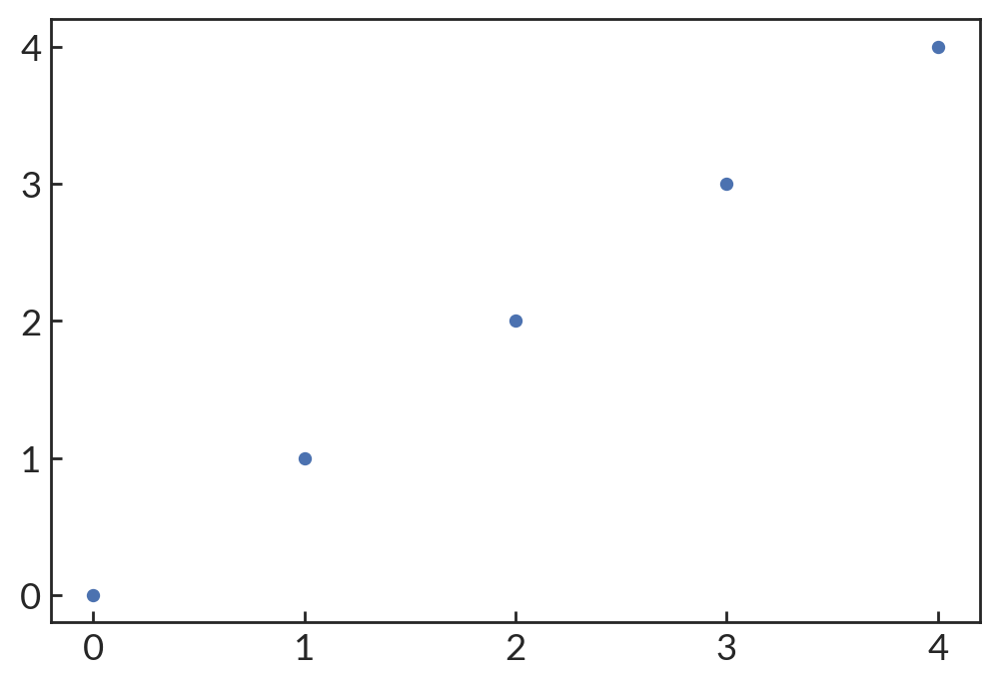

In [9]:
%matplotlib inline
x = np.arange(5)
plt.scatter(x,x)

In [10]:
# DISPLALY ALL CURRENT DEPENEDENCY
!pip freeze

absl-py==0.9.0
adjustText==0.7.3
aiohttp==3.6.2
alabaster==0.7.9
anaconda-client==1.2.2
anndata==0.7.4
annoy==1.16.3
appdirs==1.4.3
apptools==4.4.0
argcomplete==1.0.0
argon2-cffi==20.1.0
arrow==0.7.0
asn1crypto==0.24.0
astroid==1.4.7
astunparse==1.6.3
async-timeout==3.0.1
attrdict==2.0.0
attrs==19.3.0
awscli==1.18.114
Babel==2.3.4
backcall==0.2.0
backports.shutil-get-terminal-size==1.0.0
bcrypt==3.1.6
beautifulsoup4==4.7.1
bhtsne==0.1.9
biopython==1.73
bioservices==1.6.0
bitarray==0.8.1
blaze==0.10.1
bleach==3.1.5
bokeh==2.2.1
boto==2.42.0
boto3==1.14.37
botocore==1.17.23
Bottleneck==1.2.1
CacheControl==0.12.0
cachetools==4.1.1
cairocffi==0.8.0
CairoSVG==2.3.0
certifi==2020.6.20
cffi==1.12.2
chardet==3.0.4
charlotte==0.1.0
chest==0.2.3
click==7.1.2
cloudpickle==1.3.0
clyent==1.2.1
cmake==3.18.0
cmocean==2.0
colorama==0.3.9
colorlog==4.0.2
colors.py==0.2.2
ConcurrentLogHandler==0.9.1
configobj==5.0.6
contextlib2==0.5.3
contextvars==2.4
coverage==4.5.3
cronex==0.1.0
cryptography==2.6.1
c

In [11]:
#s=pd.HDFStore("/ifs/e63data/massaguelab/ashley/data/sc_RNAseq/h5/counts/Project_MB_07384/UVMEL_MERGED_noAdditionalLibSizeFilter.h5")
#s.keys()

In [12]:
#s.close()

In [13]:
#tmp = '/ifs/e63data/massaguelab/ashley/data/sc_RNAseq/h5/counts/Project_MB_07384/UVMEL_MERGED_noAdditionalLibSizeFilter.h5'
#!ls -l '/ifs/e63data/massaguelab/ashley/data/sc_RNAseq/h5/counts/Project_MB_07384/UVMEL_MERGED_noAdditionalLibSizeFilter.h5'

In [14]:
#h5_data = seqc.H5('/ifs/e63data/massaguelab/ashley/data/sc_RNAseq/h5/counts/Project_MB_07384/UVMEL_MERGED_noAdditionalLibSizeFilter.h5')
#h5_data.ls()

In [15]:
#help(seqc.H5)

In [16]:
#matplotlib.get_backend()

## LOAD SAMPLE DATA

### SAMPLE INFORMATION

In [17]:
DATA_PATH = os.path.expanduser('/workdir/uvmel_project/data/')
print(DATA_PATH)
FN  = 'UVMEL_MERGED.h5'#_noAdditionalLibSizeFilter
ORGANISM = 'human'

/workdir/uvmel_project/data/


### SET PATH TO SAVE DIRECTORIES

In [18]:
# TAG ANALYSIS OUTPUT FOLDERS WITH CURRENT DATE
tag = '_ARCHETYPES'
now = time.strftime("%x") 
now = str.replace(now,'/','_')

# SPECIFY OUTPUT STEMS FOR FIGURES/PATHWAY ANALYSIS
GSEA_output_stem = DATA_PATH.replace('/data/','/GSEA/') + FN.replace('.h5','{}_'.format(tag)) + now +'/'
print(GSEA_output_stem)
FIG_output_stem = DATA_PATH.replace('/data/','/figures/') + FN.replace('.h5','{}_'.format(tag)) + now +'/'
print(FIG_output_stem)
CNV_output_stem = DATA_PATH.replace('/data/','/CNV/') + FN.replace('.h5','{}_'.format(tag)) + now +'/'
print(CNV_output_stem)
CSV_output_stem = DATA_PATH.replace("/data/",'/CSV/') + FN.replace('.h5','{}_'.format(tag)) + now +'/'
print(CSV_output_stem)

# CREATE GSEA DIRECTORY IF IT DOES NOT EXIST
d = os.path.dirname(GSEA_output_stem)
if not os.path.exists(d):
        os.makedirs(d)

# CREATE FIGURE DIRECTORY IF IT DOES NOT EXIST     
d = os.path.dirname(FIG_output_stem)
if not os.path.exists(d):
        os.makedirs(d)
        
# CREATE CNV DIRECTORY IF IT DOES NOT EXIST     
d = os.path.dirname(CNV_output_stem)
if not os.path.exists(d):
        os.makedirs(d)
        
# CREATE CNV DIRECTORY IF IT DOES NOT EXIST     
d = os.path.dirname(CSV_output_stem)
if not os.path.exists(d):
        os.makedirs(d)

/workdir/uvmel_project/GSEA/UVMEL_MERGED_ARCHETYPES_11_09_20/
/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/
/workdir/uvmel_project/CNV/UVMEL_MERGED_ARCHETYPES_11_09_20/
/workdir/uvmel_project/CSV/UVMEL_MERGED_ARCHETYPES_11_09_20/


### LOAD PROCESSED DATAFRAME

In [19]:
h5_data = H5(DATA_PATH+FN)
h5_data.ls()

['/ARCHETYPE_DISTANCES_TUMOR', '/CNVt', '/CNVt_ALL', '/DF_ALL', '/DF_IMMUNE', '/DF_MACROPHAGE', '/DF_TUMOR', '/DIMENSIONS_ALL', '/DIMENSIONS_IMMUNE', '/DIMENSIONS_MACROPHAGE', '/DIMENSIONS_TUMOR', '/EMD_RANK_NEAREST_ARCHETYPE_TUMOR', '/EMD_RANK_TUMOR', '/GENE_RANK_ARCHETYPE_SOFT_CLUSTER_TUMOR', '/GENE_RANK_ARCHETYPE_TUMOR', '/GENE_RANK_MACROPHAGE', '/GENE_RANK_MAST_ALL', '/GENE_RANK_MAST_IMMUNE', '/GENE_RANK_MAST_TUMOR', '/GENE_RANK_NEAREST_ARCHETYPE_TUMOR', '/INDF_ALL', '/INDF_IMMUNE', '/INDF_MACROPHAGE', '/INDF_TUMOR', '/METADATA_ALL', '/METADATA_HARBOUR', '/METADATA_HARBOUR_PRIMARY', '/METADATA_IMMUNE', '/METADATA_MACROPHAGE', '/METADATA_TUMOR', '/NDF_ALL', '/NDF_IMMUNE', '/NDF_MACROPHAGE', '/NDF_TUMOR']
<class 'pandas.io.pytables.HDFStore'>
File path: /workdir/uvmel_project/data/UVMEL_MERGED.h5



### SPECIFY COLORMAP

In [20]:
# --- DEFINE ALL COLORMAPS UPFRONT FOR UNIFORMITY ---

# CATEGORICAL: SAMPLE
FLATUI_SAMPLE = [ 
                 'FF0000', #'UM01A'
                 'CC0066', #'UM01B'
                 'CC00CC', #'UM02'
                 '0000CD', #'UM03'
                 'FF8000', #'UM04'
                 '660066', #'UM05'
                 '7F00FF', #'UM06'
]

FLATUI_PATIENT = [ 
                 'DC143C', #'UM01'
                 'C71585', #'UM02'
                 '0000CD', #'UM03'
                 'FF1493', #'UM04'
                 'FF4500', #'UM05'
                 '330066', #'UM06'
]

FLATUI_CASTLE = [
                 '0000FF', # 1
                 'FF0000', # 2
]

FLATUI_STAGE = [
                 'C0C0C0', # 1
                 '000000', # 2
]

FLATUI_TYPE = [
                 '000099', # Epithelioid
                 '990099', # Mixed
                 '990000', # Spindle
]

FLATUI_VASCULO = [
                 'DC143C', # Absent
                 'B0C4DE', # Present
]

FLATUI_CLASS = [
                 '0000FF', # 0
                 'FF0000', # 1   
                 'FF8C00', # 2
                 'FFD700', # 3  
                 '808000', # 4
                 '9ACD32', # 5   
                 '006400', # 6
                 '20B2AA', # 7  
                 '2F4F4F', # 8
                 '00BFFF', # 9   
                 '1E90FF', # 10
                 '191970', # 11 
                 '4B0082', # 12
                 '8B008B', # 13  
                 'FF00FF', # 14
                 'FF1493', # 15 
                 '8B4513', # 16
                 'D2691E', # 17 
                 '708090', # 18
                 'B0C4DE', # 19  
                 '696969', # 20
                 'FFB6C1', # 21
                 'FAEBD7', # 22
                 'F5DEB3', # 23
                 'FFFACD', # 24
                 'D2B48C', # 25
                 'FFA07A', # 26                
]

FLATUI_META_CELL_TYPE = [
                 'B0C4DE', # IMMUNE
                 'FFA07A', # PHOTORECEPTOR  
                 '000000', # TUMOR 
]

# CONVERT HEX TO RGB (FLATUI_SAMPLE)
colors = np.zeros((len(FLATUI_META_CELL_TYPE),3))
for ind,hexcolor in enumerate(FLATUI_META_CELL_TYPE):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_META_CELL_TYPE = LinearSegmentedColormap.from_list('FLATUI_META_CELL_TYPE', colors, N=len(colors))

# CONVERT HEX TO RGB (FLATUI_SAMPLE)
colors = np.zeros((len(FLATUI_SAMPLE),3))
for ind,hexcolor in enumerate(FLATUI_SAMPLE):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_SAMPLES = LinearSegmentedColormap.from_list('FLATUI_SAMPLE', colors, N=len(colors))

# CONVERT HEX TO RGB (FLATUI_CASTLE)
colors = np.zeros((len(FLATUI_CASTLE),3))
for ind,hexcolor in enumerate(FLATUI_CASTLE):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_CASTLE = LinearSegmentedColormap.from_list('FLATUI_CASTLE', colors, N=len(colors))

# CONVERT HEX TO RGB (FLATUI_PATIENT)
colors = np.zeros((len(FLATUI_PATIENT),3))
for ind,hexcolor in enumerate(FLATUI_PATIENT):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_PATIENT = LinearSegmentedColormap.from_list('FLATUI_PATIENT', colors, N=len(colors))

# CONVERT HEX TO RGB (FLATUI_STAGE)
colors = np.zeros((len(FLATUI_STAGE),3))
for ind,hexcolor in enumerate(FLATUI_STAGE):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_STAGE = LinearSegmentedColormap.from_list('FLATUI_STAGE', colors, N=len(colors))

# CONVERT HEX TO RGB (FLATUI_SMOKING)
colors = np.zeros((len(FLATUI_TYPE),3))
for ind,hexcolor in enumerate(FLATUI_TYPE):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_TYPE = LinearSegmentedColormap.from_list('FLATUI_TYPE', colors, N=len(colors))

# CONVERT HEX TO RGB (FLATUI_TREATMENT)
colors = np.zeros((len(FLATUI_VASCULO),3))
for ind,hexcolor in enumerate(FLATUI_VASCULO):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_VASCULO = LinearSegmentedColormap.from_list('FLATUI_VASCULO', colors, N=len(colors))

# CONVERT HEX TO RGB (FLATUI_CLASS)
colors = np.zeros((len(FLATUI_CLASS),3))
for ind,hexcolor in enumerate(FLATUI_CLASS):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_CLASS = LinearSegmentedColormap.from_list('FLATUI_CLASS', colors, N=len(colors))

# CONTINUOUS: DIVERGING
CM_DIVERGING = plt.cm.RdBu_r

# CONTINUOUS: SEQUENTIAL
CM_SEQUENTIAL = cmocean.cm.thermal 

## CANCER CELLS ONLY

###### SPECIFY SUBSET TYPE

In [21]:
subset_type = 'TUMOR'

exec('DF_{} = h5_data.load(\'/DF_{}\')'.format(subset_type,subset_type))
exec('NDF_{} = h5_data.load(\'/NDF_{}\')'.format(subset_type,subset_type))
exec('INDF_{} = h5_data.load(\'/INDF_{}\')'.format(subset_type,subset_type))
exec('METADATA_{} = h5_data.load(\'/METADATA_{}\')'.format(subset_type,subset_type))
exec('DIMENSIONS_{} = h5_data.load(\'/DIMENSIONS_{}\')'.format(subset_type,subset_type))
exec('GENE_RANK_MAST_{} = h5_data.load(\'/GENE_RANK_MAST_{}\')'.format(subset_type,subset_type))
exec('ARCHETYPE_DISTANCES_{} = h5_data.load(\'/ARCHETYPE_DISTANCES_{}\')'.format(subset_type,subset_type))

### REPORT LIBRARY SIZE DISTRIBUTION OF SUBSET

In [22]:
# PRINT LIBRARY SIZE AND CELL COUNT STATISTICS
exec('median_libsize= DF_{}.sum(axis=1).median()'.format(subset_type))
exec('num_cells = len(DF_{}.sum(axis=1))'.format(subset_type))

print('All Samples, Count: {}, Median LibSize: {}'.format(num_cells, median_libsize))

exec('QUERY = DF_{}'.format(subset_type))
for index in np.unique(QUERY.index.get_level_values('Legend')):
    tmp = QUERY.loc[QUERY.index.map(lambda x: x[1] == index)]
    median_libsize= tmp.sum(axis=1).median()
    num_cells = len(tmp.sum(axis=1))
    print('Sample ID: {}, Count: {}, Median LibSize: {}'.format(index, num_cells, median_libsize))

All Samples, Count: 16077, Median LibSize: 1680.0
Sample ID: UM01A, Count: 3187, Median LibSize: 1994.0
Sample ID: UM01B, Count: 4249, Median LibSize: 2071.0
Sample ID: UM02, Count: 720, Median LibSize: 991.5
Sample ID: UM03, Count: 2375, Median LibSize: 1544.0
Sample ID: UM04, Count: 2780, Median LibSize: 1351.5
Sample ID: UM05, Count: 2587, Median LibSize: 1784.0
Sample ID: UM06, Count: 179, Median LibSize: 1021.0


/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_library_distribution_subset_TUMOR_log10.png


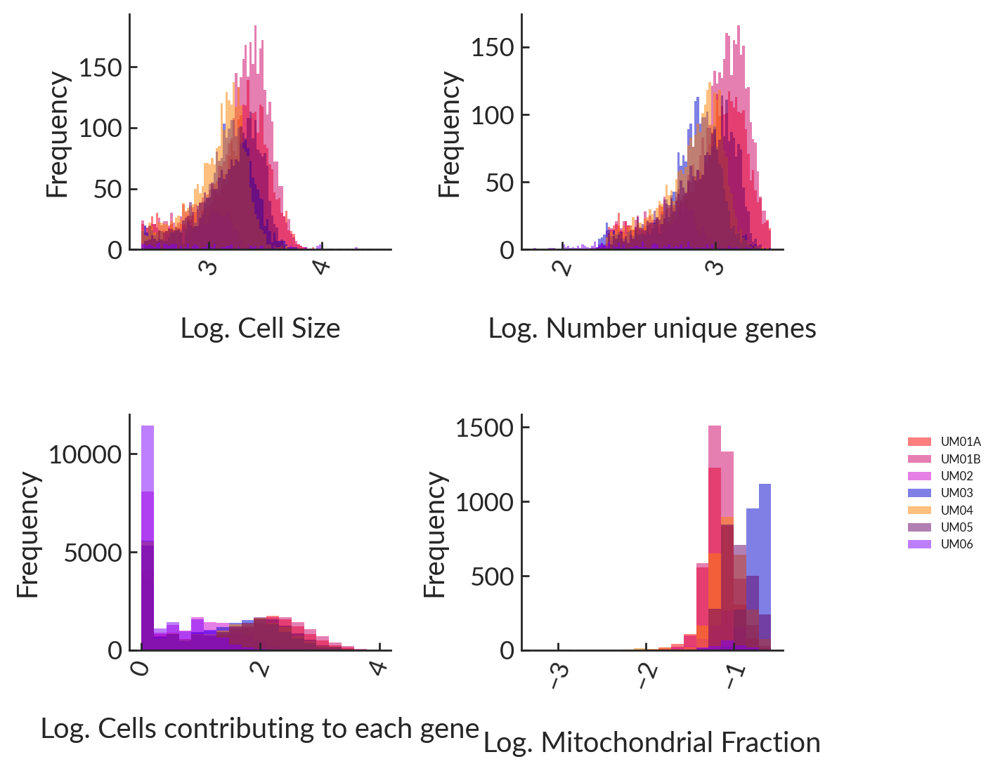

In [23]:
exec('QUERY = DF_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))

plt.figure(figsize = (6,6))
gs1 = gridspec.GridSpec(2,2)
gs1.update(wspace=0.5, hspace=0.7) # set the spacing between axes. 

# (1) PLOT LOG LIBRARY SIZE
ax = plt.subplot(gs1[0])
bins = np.linspace(np.log10(QUERY.values.sum(axis=1).min()), np.log10(QUERY.values.sum(axis=1).max())*0.95, 100)
for ind, label in enumerate(np.unique(QUERY.index.get_level_values('Legend'))):
    x = np.log10(QUERY.loc[QUERY.index.map(lambda x: x[1] == label)].values.sum(axis=1)) # log cell size
    plt.hist(x, bins, alpha=0.5, label=label,color = np.divide(tuple(hex(FLATUI_SAMPLE[ind]).rgb),255)) 
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('\nLog. Cell Size')
sns.despine()

# (2) PLOT LOG NUM UNIQUE GENES
ax = plt.subplot(gs1[1])
bins = np.linspace(np.log10((np.sum(QUERY > 0,axis=1)).min()), 
                   np.log10((np.sum(QUERY > 0,axis=1)).max())*0.95, 100)
for ind, label in enumerate(np.unique(QUERY.index.get_level_values('Legend'))):
    x = np.log10(np.sum(QUERY.loc[QUERY.index.map(lambda x: x[1] == label)] > 0,axis=1))
    plt.hist(x, bins, alpha=0.5, label=label,color = np.divide(tuple(hex(FLATUI_SAMPLE[ind]).rgb),255)) 
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('\nLog. Number unique genes')
sns.despine()

# (3) PLOT LOG NUMBER OF CELLS CONTRIBUTING TO EACH GENE
ax = plt.subplot(gs1[2])
data = np.log10(np.sum(QUERY.values > 0,axis=0))
bins = np.linspace(0, data.max()*0.95, 20)
for ind, label in enumerate(np.unique(QUERY.index.get_level_values('Legend'))):
    x = np.log10(np.sum(QUERY.loc[QUERY.index.map(lambda x: x[1] == label)] > 0,axis=0))
    x[(np.isinf(x)) | (np.isnan(x))] = 0
    plt.hist(x, bins, alpha=0.5, label=label,color = np.divide(tuple(hex(FLATUI_SAMPLE[ind]).rgb),255)) 
    
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('\nLog. Cells contributing to each gene')
sns.despine()

# (4) PLOT MITOCHONDRIAL FRACTION PER CELL 
ax = plt.subplot(gs1[3]) 
vals = META['mt_fraction']
vals = np.log10(META['mt_fraction'].astype(float))
vals[(np.isinf(vals)) | (np.isnan(vals))] = 0

bins = np.linspace(vals.min(),vals.max()*0.95, 20)
for ind, label in enumerate(np.unique(QUERY.index.get_level_values('Legend'))):
    x = vals.loc[vals.index.map(lambda x: x[1] == label)]
    x[(np.isinf(x)) | (np.isnan(x))] = 0
    plt.hist(x, bins, alpha=0.5, label=label,color = np.divide(tuple(hex(FLATUI_SAMPLE[ind]).rgb),255)) 
    
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('\nLog. Mitochondrial Fraction')
sns.despine()

# Add (abbreviated) legend bottom left
L = plt.legend(loc='upper right',prop={'size':6},bbox_to_anchor=(1.8, 0.95),fancybox=True) 

# SAVE FIGURE
figure_label = '_library_distribution_subset_{}_log10'.format(subset_type)
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label + '.png'
plt.savefig(fn, dpi=fig_dpi)
print(fn)

### FILTER LOW ABUNDANCE GENES

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_filter_genes.png
Count Gene Filter 1: 1665
Count Gene Filter 2: 4474
(16077, 14161)
(16077, 14161)
14161


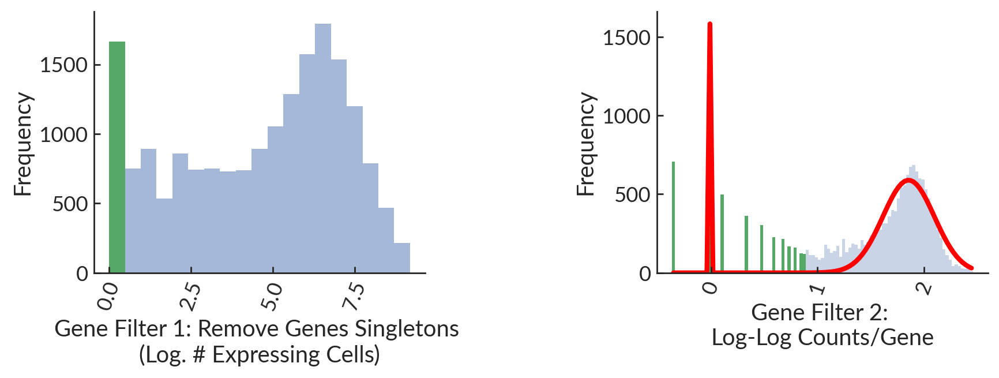

In [24]:
exec('QUERY = DF_{}'.format(subset_type))

# FIT BINOMIAL DISTRIBUTION AND FILTER BASED ON MEAN/STD OF SECOND
plt.figure(figsize = (10,3))
gs1 = gridspec.GridSpec(1, 2)
gs1.update(wspace=0.7, hspace=0.7) # set the spacing between axes. 

# (4) PLOT LOG NUMBER OF CELLS CONTRIBUTING TO EACH GENE
num_cells_per_gene = np.log(np.sum(QUERY.values > 0,axis=0))
num_cells_per_gene[(np.isinf(num_cells_per_gene)) | (np.isnan(num_cells_per_gene))] = 0
rmv_genes1 = np.where(num_cells_per_gene<=0)[0] # GENES MUST BE DETECTED IN AT LEAST 10 CELLS

ax = plt.subplot(gs1[0])
bins = np.linspace(num_cells_per_gene.min(), num_cells_per_gene.max()*0.95, 20)
plt.hist(num_cells_per_gene, bins, alpha=0.5, label='keep')

if rmv_genes1.any():
    plt.hist(num_cells_per_gene[rmv_genes1], bins, alpha=1, label='remove')
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('Gene Filter 1: Remove Genes Singletons \n(Log. # Expressing Cells)')
sns.despine()

# (5) PLOT LOG COUNTS PER GENE - REMOVE LOW ABUNDANCE GENES
log_counts_per_gene = np.log(np.log(np.sum(QUERY.values,axis=0)))
log_counts_per_gene[(np.isinf(log_counts_per_gene)) | (np.isnan(log_counts_per_gene))] = 0
data = log_counts_per_gene

ax = plt.subplot(gs1[1])
bins = np.linspace(data.min(), data.max()*0.95, 100)
y,x,_=hist(data,bins,alpha=.3,label='data')

x=(x[1:]+x[:-1])/2 
expected=(0,.2,3500,1.5,.2,500)
params,cov=curve_fit(bimodal,x,y,expected)
sigma=sqrt(diag(cov))
plot(x,bimodal(x,*params),color='red',lw=3,label='model')

mu1 = params[0]
std1 = params[1]
mu2 = params[3]
std2 = params[4]
rmv_genes_neg = np.where(data<mu2-4*std2)[0]
rmv_genes2 = np.sort(list(set(list(rmv_genes_neg))))

if rmv_genes2.any():
    plt.hist(data[rmv_genes2], bins, alpha=1, label='remove')
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('Gene Filter 2: \nLog-Log Counts/Gene')
sns.despine()

# SAVE FIGURE
figure_label = '_filter_genes'
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label + '.png'
plt.savefig(fn, dpi=fig_dpi)
print(fn)

# EVALUATE NUMBER OF CELLS/GENES REMOVED
print('Count Gene Filter 1: {}'.format(len(rmv_genes1)))
print('Count Gene Filter 2: {}'.format(len(rmv_genes2)))

# REMOVE SELECTED OUTLIER GENES(HIGHLIGHTED IN GREEN)
CUT_DF = deepcopy(QUERY)
rmv_genes = np.sort(list(set(list(rmv_genes1) + list(rmv_genes2))))
if rmv_genes.any():
    CUT_DF = CUT_DF.drop(CUT_DF.columns[rmv_genes],axis=1)
    print(CUT_DF.shape)
    
# Remove empty genes if they exist
drop_genes = np.where(CUT_DF.sum(axis=0)==0)[0]
CUT_DF = CUT_DF.drop(CUT_DF.columns[drop_genes],axis=1)
print(CUT_DF.shape)

# GENES EXCLUDING LOW ABUNDANCE GENES
goi = list(CUT_DF.columns)
print(len(goi))

###### LOAD KEY GENESETS

In [25]:
# LOAD GENE LIST FROM EXCEL
path_to_genesets = DATA_PATH + 'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')
genesets = genesets.apply(lambda x: x.astype(str).str.upper())
print(shape(genesets)[1])

56


### EVALUATE GENE EXPRESSION PER META CLASS

BAP1 CLASS1 vs. CLASS2
MannwhitneyuResult(statistic=2988854.0, pvalue=0.0)
/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20//BOXPLOTS/UVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Assignment_BAP1


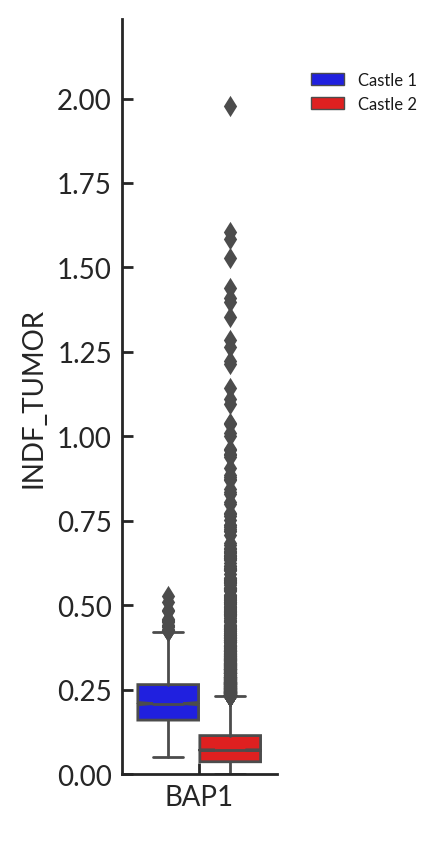

In [26]:
plot_type = 'box'
title = 'BAP1'
meta = 'Assignment'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

fig = plt.figure(figsize = (1,5))
ax = plt.gca()

scale_type = 'count'
palette = dict(zip(['Castle 1','Castle 2'],['#0000FF','#FF0000'])) 


genes = [title]
genes = np.unique([x for x in genes if str(x) != 'NAN'])
detected_genes = list(set(genes).intersection(set(QUERY.columns)))
vals = QUERY[detected_genes]
SCORE = np.nansum(vals,axis=1)

# Format data structure for violin plot
violin_data = []
for ind,v in enumerate(SCORE):
    violin_data.append({'gene': title, 'Z-normalized Expression': v,
                        meta:META[meta].values[ind]}) 
violin_data = pd.DataFrame(violin_data)  

# BOXPLOT GENE EXPRESSION
if plot_type == 'box':
    g = sns.boxplot(x="gene", y="Z-normalized Expression", hue=meta,data=violin_data, palette=palette,notch = True, 
                    hue_order = ['Castle 1','Castle 2'],
                    fliersize = 4, showmeans=False,linewidth = 1, ax = ax) #order = labels, 
    g.set_ylabel("{}".format(datatype),fontsize=10)
    g.set_xlabel(" ",fontsize=10,rotation = 90)
    g.tick_params(labelsize=10)
    sns.despine()
    ax.set(ylim=(0, SCORE.max()*0.95))
    g.legend(loc='upper right',prop={'size':6},bbox_to_anchor=(2.0, 0.95),fancybox=True) 


elif plot_type == 'violin':
    # VIOLIN GENE EXPRESSION
    g = sns.violinplot(x="gene", y="Z-normalized Expression", hue=meta,data=violin_data, palette=palette,notch = True,
                    hue_order = ['Castle 1','Castle 2'],fliersize = 4, showmeans=True,linewidth = 1) #order = labels, 

    g.set_ylabel("{}".format(datatype),fontsize=10)
    g.set_xlabel(" ",fontsize=10,rotation = 90)
    ax.set(ylim=(0, SCORE.max()*0.95))
    g.tick_params(labelsize=10)
    sns.despine()

# COMPARE DISTRIBUTIONS
CLASS1 = violin_data.loc[violin_data[meta].isin(['Castle 1'])]['Z-normalized Expression'].values
CLASS2 = violin_data.loc[violin_data[meta].isin(['Castle 2'])]['Z-normalized Expression'].values
print(title + ' CLASS1 vs. CLASS2')
print(stats.mannwhitneyu(CLASS1,CLASS2))

# SAVE FIGURE
figure_label = '_{}_{}PLOT_{}_{}_{}'.format(subset_type, plot_type,datatype,meta,title)
fn = FIG_output_stem + '/BOXPLOTS/' + FN.replace(".h5", "") + figure_label
    
# CREATE GSEA DIRECTORY IF IT DOES NOT EXIST
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
        
plt.savefig(fn + '.png', bbox_inches='tight',dpi=fig_dpi)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=fig_dpi)
print(fn)

## TUMOR CELL CLUSTERS AND INFERRED CASTLE CLASS

### VISUALIZE PHENOGRAPH CLUSTERS

findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_CLUSTERS_INDF_TUMOR_Phenograph_Class_ForceDirected


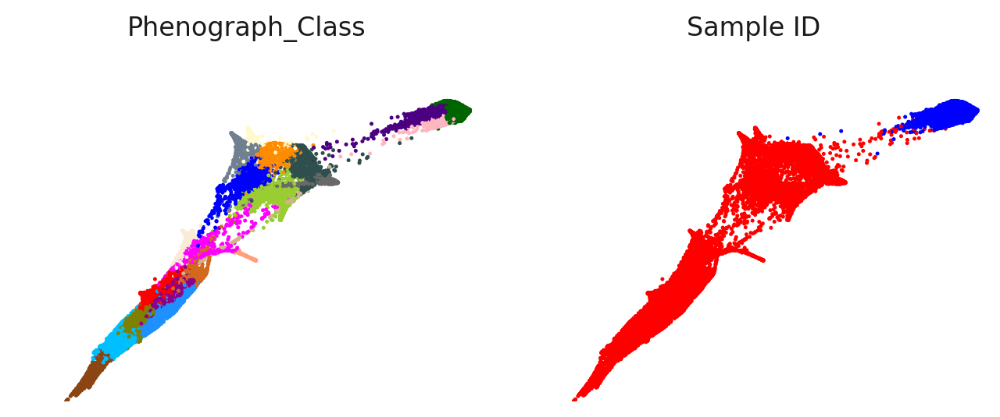

In [27]:
# PLOT CATEGORICAL CLUSTER ASSIGNMENTS
# Note: Any rows assigned -1 were identified as outliers and should not be considered as a member of any community.
plt.figure(figsize = (8,3))
nrow = 1
ncol = 2
dot_size = 1
gs1 = gridspec.GridSpec(nrow, ncol)
gs1.update(wspace=0.1, hspace=0.1) # set the spacing between axes. 

dimtype = 'ForceDirected' 
meta = 'Phenograph_Class'
exec('DIM = DIMENSIONS_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))
exec('QUERY = INDF_{}'.format(subset_type))
x = DIM['{}0'.format(dimtype)]
y = DIM['{}1'.format(dimtype)]
axis_min = -ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10
axis_max = ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10

# Cluster Assignment
ax = plt.subplot(gs1[0])
seqc.plot.scatter.categorical(x, y, c=META[meta].values, 
                              cmap= CM_CLASS,
                              legend_kwargs={'ncol': 1}, s=dot_size, ax=ax,randomize=True);
plt.rc('xtick', labelsize=6)
plt.rc('ytick', labelsize=6)
sns.despine()
plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.title('{}'.format(meta), fontname='Helvetica', size=12, weight='normal')
plt.axis('off')
ax.legend_.remove()

# Castle Class
ax = plt.subplot(gs1[1])
seqc.plot.scatter.categorical(x, y, c=META['Assignment'], cmap=CM_CASTLE,legend_kwargs={'ncol': 1}, s=dot_size, ax=ax);
sns.despine()
plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
plt.title('Sample ID', fontname='Helvetica', size=12, weight='normal')
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
ax.legend_.remove()

# SAVE FIGURE
figure_label = '_CLUSTERS_INDF_{}_{}_{}'.format(subset_type,meta,dimtype) 
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=fig_dpi)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=fig_dpi)
print(fn)

### MEAN EXPRESSION OF KEY GENES PER CLUSTER

In [28]:
meta = 'Phenograph_Class'
cluster_mean = QUERY.groupby(level = [meta],axis=0).mean()

In [29]:
genesets.columns

Index(['KEGG_NATURAL_KILLER_CELL_MEDIATED_CYTOTOXICITY',
       'LEE_NEURAL_CREST_STEM_CELL_UP', 'LEE_NEURAL_CREST_STEM_CELL_DN',
       'GO_NEURAL_CREST_CELL_DIFFERENTIATION', 'GO_NEURAL_TUBE_DEVELOPMENT',
       'Monosomy 3 Up', 'Monosomy 3 Down', 'Castle 2', 'Castle 1',
       'Class 1 Onken v2', 'Class 2 Onken v2', 'EHLERS_ANEUPLOIDY_UP',
       'EHLERS_ANEUPLOIDY_DN', 'GO_PCG_PROTEIN_COMPLEX',
       'DOUGLAS_BMI1_TARGETS_UP', 'DOUGLAS_BMI1_TARGETS_DN',
       'BENPORATH_PRC2_TARGETS', 'WIEDERSCHAIN_TARGETS_OF_BMI1_AND_PCGF2',
       'BENPORATH_SUZ12_TARGETS', 'BENPORATH_EED_TARGETS', 'BMI1_DN.V1_DN',
       'BMI1_DN.V1_UP', 'BMI1_DN_MEL18_DN.V1_DN', 'BMI1_DN_MEL18_DN.V1_UP',
       'GO_CHROMATIN_BINDING', 'GO_CHROMATIN_MODIFICATION',
       'GO_CHROMATIN_ORGANIZATION', 'GO_CHROMOSOME_ORGANIZATION',
       'GO_HISTONE_H2A_MONOUBIQUITINATION', 'GO_HISTONE_H2A_UBIQUITINATION',
       'GO_HISTONE_MONOUBIQUITINATION', 'GO_HISTONE_UBIQUITINATION',
       'GO_NUCLEAR_UBIQUITIN_LIGASE_CO

In [30]:
master_title = ['CIN_signature_Bakhoum','CIN_responsive_NC_NFKB_UP_Bakhoum',
                'CIN_responsive_NC_NFKB_DN_Bakhoum', 'NC_NFKB_REGULATORS_UP_Bakhoum',
                'NC_NFKB_REGULATORS_DN_Bakhoum']
class_genes = genesets.loc[:,master_title]
class_genes = [gene for gene in class_genes.values.flatten() if gene not in ['NAN']]
matster_title = 'NC_NFKB'
print(len(class_genes))

48


In [31]:
master_title = 'MANUAL'
class_genes = ['JARID2','TING1','TMEM173','BAP1','LPCAT1','HLA-A','HLA-B','HLA-C','HLA-E',
              'PMEL','MLANA','TYR','TYRP1','DCT','RING1']
print(len(class_genes))

15


/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGEDheatmaps/user_defined/INDF_TUMOR_MANUAL_HEATMAP_average_euclidean_colored_Phenograph_Class


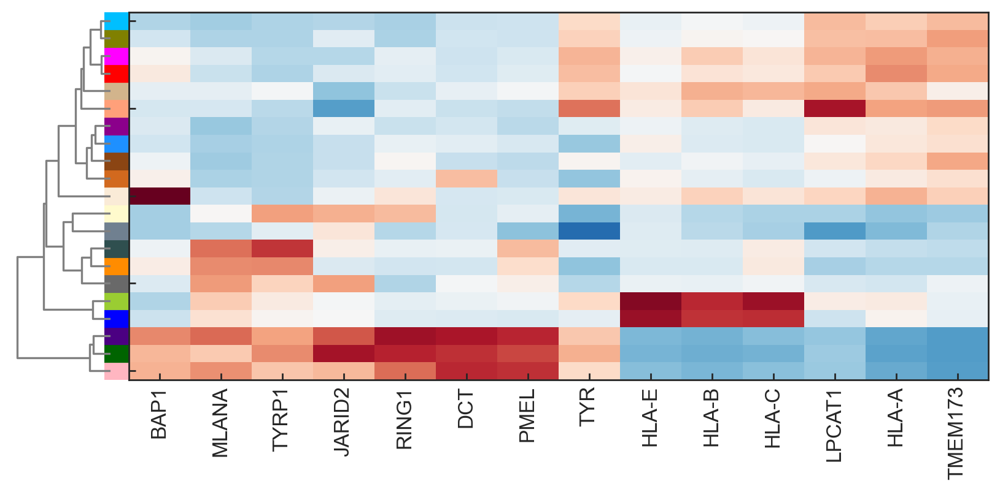

In [32]:
meta = 'Phenograph_Class'
FLATUI_PLOT = FLATUI_CLASS

datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
QUERY = QUERY.groupby(level = [meta],axis=0).median()

# GENERATE LUT FOR PHENOGRAPH CLSUTERS BEFORE DOWNSAMPLING MATRIX
# SPECIFY GENESET AND TITLE
ind = QUERY.index
# CONVERT HEX TO RGB (FLATUI_CLASS)
colors = np.zeros((len(FLATUI_PLOT),3))
for ii,hexcolor in enumerate(FLATUI_PLOT):
    colors[ii,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
# Palatte for Class METADATA
cix = (np.linspace(0,shape(colors)[0],len(np.unique(ind)))).astype(int)
if cix[len(cix)-1]==shape(colors)[0]:
    cix[len(cix)-1]=shape(colors)[0]-1
lut = dict(zip(np.unique(ind), colors[cix,:]))
row_colors = pd.Series(ind).map(lut)

# ONLY DISPLAY METASTASIS ASSOCIATED CLUSTERS
subset_key = meta
ix = [ind for ind, name in enumerate(QUERY.index.names) if name==subset_key][0]

genes = class_genes
genes = [gene for gene in genes if gene in goi]
genes = np.unique(genes)

# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame(data = zscore(QUERY[genes].values,axis=0),columns = genes)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'average' # average, single centroid/euclidean
metric = 'euclidean' # cosine
linkage = hc.linkage(heatmap_data, method=method, metric = metric)
row_linkage = deepcopy(linkage)
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)

# REORDER HEATMAP ACCORDING TO LINKAGE (OPTIONAL, STILL SLOW)
r1 = hc.leaves_list(row_linkage)
cl = hc.leaves_list(col_linkage)
mat = heatmap_data.iloc[r1,cl]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(10,5))

# ADD ROW COLOR INDEX (CELL OF ORIGIN)
ax1 = fig.add_axes([0.18,0.1,0.03,0.6]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors[r1]:
    pos = (x, y / len(r1))
    ax1.add_patch(patches.Rectangle(pos, 1, 1 / len(r1), color=c))
    if y >= len(r1)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')

# ADD MATRIX WITH GENE NAMES
axmatrix = fig.add_axes([0.2,0.1,0.7,0.6])
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=plt.cm.RdBu_r,vmin=-3,vmax=3)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 12,fontname='Arial')
axmatrix.grid(False)

# ADD DENDROGRAM
sch.set_link_color_palette(['#808080', '#808080', '#808080', '#808080','#808080','#808080','#808080'])
ax2 = fig.add_axes([0.105,0.1,0.08,0.6]) # [x0,y0,width,height]
Z1 = sch.dendrogram(row_linkage, orientation='left',above_threshold_color='#808080')
ax2.set_xticks([])
ax2.set_yticks([])
plt.axis('off')

# SAVE FIGURE
figure_label = 'heatmaps/user_defined/{}_{}_HEATMAP_{}_{}_colored_{}'.format(datatype,master_title,method,metric,meta).replace('-','_').replace(' ','_')
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### MEAN EXPRESSION OF KEY GENES PER CELL

In [33]:
QUERY.head()

,A1BG,A2M,A4GALT,AAAS,AACS,AADAT,AAED1,AAGAB,AAK1,AAMDC,...,ZWILCH,ZWINT,ZXDA,ZXDB,ZXDC,ZYG11A,ZYG11B,ZYX,ZZEF1,ZZZ3
Phenograph_Class,,,,,,,,,,,,,,,,,,,,,
0,0.382486,2.872816,0.139417,0.706601,0.176633,0.534319,0.605529,0.682277,0.483053,0.397476,...,0.203470,0.120408,0.583924,0.191804,0.413248,0.00000,0.384980,0.962286,0.462773,0.633339
1,0.470770,3.851409,2.174489,0.671377,0.355668,2.639479,0.643492,0.458559,1.188515,0.750638,...,0.100784,0.121680,0.518215,0.178169,0.292379,0.00263,0.145108,0.649496,0.711721,0.452172
2,0.267375,2.101861,0.031380,0.718050,0.189987,0.829030,0.695821,0.480362,0.418561,0.424329,...,0.163009,0.079189,0.321172,0.219933,0.419084,0.00000,0.291340,0.596090,0.645018,0.662719
3,0.421319,4.002202,1.480325,0.621936,0.369942,2.744307,0.707937,0.506432,1.186003,0.659440,...,0.139975,0.095248,0.580979,0.146168,0.375325,0.00000,0.185429,0.502218,0.712316,0.406167
4,0.400083,2.930733,0.258761,0.822089,0.181725,0.196157,0.596271,0.744345,0.744033,0.462091,...,0.273383,0.117917,0.241071,0.129909,0.451596,0.00000,0.307107,0.920597,0.328583,0.715338


In [34]:
# VIOLIN PLOTS
subset_type = 'TUMOR'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

np.unique(QUERY.index.get_level_values('Archetype'))

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10])

In [35]:
# CLASS RELATED GENES
class_genes = genesets.loc[:,['Castle 2', 'Castle 1']]
class_genes = [gene for gene in class_genes.values.flatten() if gene not in ['NAN']]
print(len(class_genes))

# COLUMN INDEX AND COLORS
genes = [gene for gene in class_genes if gene in QUERY.columns]#gene_array['Gene'].values
# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame(data = zscore(QUERY[genes].values,axis=0),columns = genes, index = QUERY.index)
print(heatmap_data.shape)

12
(16077, 12)


In [36]:
# ROW INDEX
meta = 'Archetype'

FLATUI_PLOT = [
                 'E6E6FA', # not assgined
                 'FF66FF', # pink 0 
                 '6600CC', # purple 1
                 '9ACD32', # Green 2
                 '00FFFF', # skye blue 3
                 'FF8800', # orange 4
                 '0000FF', # dark blue 5
                 'FFD700', # yellow 6
                 '20B2AA', # teal 7 
                 '008000', # forest green 8
                 '8B008B', # 9
    ]

ind = META.index.get_level_values(meta)

# CONVERT HEX TO RGB (FLATUI_CLASS)
colors = np.zeros((len(FLATUI_PLOT),3))
for ii,hexcolor in enumerate(FLATUI_PLOT):
    colors[ii,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
# Palatte for Class METADATA
cix = (np.linspace(0,shape(colors)[0],len(np.unique(ind)))).astype(int)
if cix[len(cix)-1]==shape(colors)[0]:
    cix[len(cix)-1]=shape(colors)[0]-1
lut = dict(zip(np.unique(ind), colors[cix,:]))
row_colors = pd.Series(ind).map(lut)

# COLUMN INDEX AND COLORS
genes = [gene for gene in class_genes if gene in QUERY.columns]#gene_array['Gene'].values
# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame(data = zscore(QUERY[genes].values,axis=0),columns = genes, index = QUERY.index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

In [37]:
heatmap_data

CDH1  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype             
0         UM01A  UM01    1       7                0         9                 0                      0                      1                 -0.409388   
                         2       7                0         3                 0                      0                      1                 -0.409366   
                         3       7                0         9                 0                      0                      1                 -0.539583   
                         4       19               0         4                 0                      0                      2                 -0.471742   
                         6       7                0         8                 0                      0                      1                 -0.208193   
...                                                                                                                                                 ...   
6         UM06   UM06    19435   12               5         5                 0                      5                      5                 -0.205677   
                         19437   12               0         5                 0                      5                      5                 -0.125055   
                         19440   12               0         5                 0                      5                      5                 -0.113775   
                         19441   12               0         5                 0                      5                      5                 -0.163357   
                         19450   0                0         1                 0                      0                      3                  0.460052   

                                                                                                                                                  EIF1B  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype             
0         UM01A  UM01    1       7                0         9                 0                      0                      1                 -0.802686   
                         2       7                0         3                 0                      0                      1                 -0.722648   
                         3       7                0         9                 0                      0                      1                 -0.203932   
                         4       19               0         4                 0                      0                      2                 -0.995851   
                         6       7                0         8                 0                      0                      1                 -0.950952   
...                                                                                                                                                 ...   
6         UM06   UM06    19435   12               5         5                 0                      5                      5                 -0.138196   
                         19437   12               0         5                 0                      5                      5                 -0.364458   
                         19440   12               0         5                 0                      5                      5                 -0.447142   
                         19441   12               0         5                 0                      5                      5                 -0.359640   
                         19450   0                0         1                 0                      0                      3                 -0.259202   

                                                                                                                   

In [38]:
# LINKAGE 
method = 'average' # average, single
metric = 'euclidean' # cosine
linkage = hc.linkage(heatmap_data, method=method, metric = metric)
row_linkage = deepcopy(linkage)
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)

In [39]:
QUERY

A1BG  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype             
0         UM01A  UM01    1       7                0         9                 0                      0                      1                  0.531591   
                         2       7                0         3                 0                      0                      1                  0.343387   
                         3       7                0         9                 0                      0                      1                  0.936652   
                         4       19               0         4                 0                      0                      2                  0.324074   
                         6       7                0         8                 0                      0                      1                  0.477145   
...                                                                                                                                                 ...   
6         UM06   UM06    19435   12               5         5                 0                      5                      5                  0.192484   
                         19437   12               0         5                 0                      5                      5                  0.184222   
                         19440   12               0         5                 0                      5                      5                  0.185264   
                         19441   12               0         5                 0                      5                      5                  0.202517   
                         19450   0                0         1                 0                      0                      3                  0.243951   

                                                                                                                                                    A2M  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype             
0         UM01A  UM01    1       7                0         9                 0                      0                      1                  3.445059   
                         2       7                0         3                 0                      0                      1                  3.113889   
                         3       7                0         9                 0                      0                      1                  5.807784   
                         4       19               0         4                 0                      0                      2                  4.580426   
                         6       7                0         8                 0                      0                      1                  3.816358   
...                                                                                                                                                 ...   
6         UM06   UM06    19435   12               5         5                 0                      5                      5                  3.492279   
                         19437   12               0         5                 0                      5                      5                  3.405190   
                         19440   12               0         5                 0                      5                      5                  3.454278   
                         19441   12               0         5                 0                      5                      5                  3.373100   
                         19450   0                0         1                 0                      0                      3                  3.205560   

                                                                                                                   

In [40]:
# REORDER HEATMAP ACCORDING TO LINKAGE (OPTIONAL, STILL SLOW)
r1 = hc.leaves_list(row_linkage)
c1 = hc.leaves_list(col_linkage)
mat = heatmap_data.iloc[r1,c1]

row_colors = pd.Series(mat.index.get_level_values(meta),index =mat.index.get_level_values(meta)).map(lut)

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGEDCASTLE_GENES


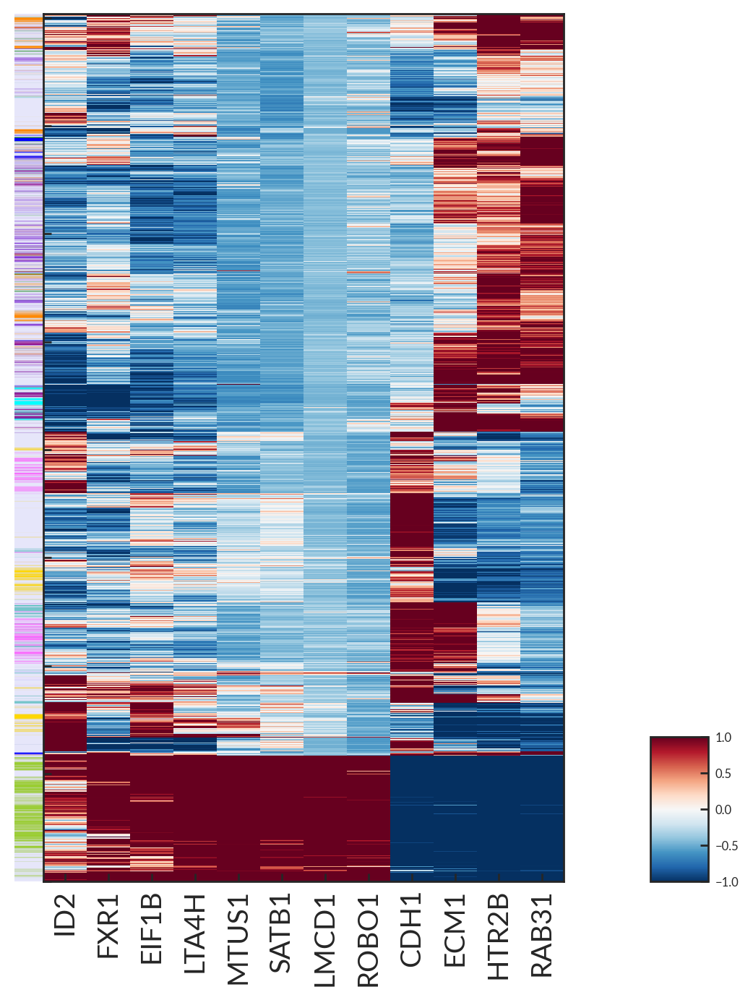

In [41]:
# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(4,10))
plt.rcParams["axes.grid"] = False

# ADD ROW COLOR INDEX 1 (PHENOGRAPH CLASS)
ax1 = fig.add_axes([0,0.1,0.05,0.6]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors:
    pos = (x, y / len(row_colors))
    ax1.add_patch(patches.Rectangle(pos, 1, 1 / len(row_colors), color=c))
    if y >= len(row_colors)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')

# ADD MATRIX WITH GENE NAMES
axmatrix = fig.add_axes([0.05,0.1,0.9,0.6])
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=plt.cm.RdBu_r,vmin=-1,vmax=1)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 14)

# ADD COLORBAR
axcolor = fig.add_axes([1.1,0.1,0.1,0.1])
cbar = plt.colorbar(im, cax=axcolor)
#cbar.ax.get_yaxis().set_ticks([])

# SAVE FIGURE
figure_label = 'CASTLE_GENES'.format(meta,subset_type,method,metric)
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

## ARCHETYPAL ANALYSIS

In [42]:
subset_type

'TUMOR'

### IDENTIFY OPTIMAL NUMBER OF ARCHETYPES

In [43]:
# Diffusion Eigenvalues
component_prefix = 'IPC'
exec('QUERY = DIMENSIONS_{}'.format(subset_type))
idx = QUERY.columns.to_series().str.contains('^{}((?!TSNE).)*$'.format(component_prefix)) # select from DIMS_NDF
exec('IPC = DIMENSIONS_{}.loc[:, idx.values]'.format(subset_type))
IPC = IPC.iloc[:,:22]
IPC.head()

IPC0  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype             
0         UM01A  UM01    1       7                0         9                 0                      0                      1                  0.091877   
                         2       7                0         3                 0                      0                      1                  0.113848   
                         3       7                0         9                 0                      0                      1                  0.132744   
                         4       19               0         4                 0                      0                      2                  0.040106   
                         6       7                0         8                 0                      0                      1                  0.099883   

                                                                                                                                                   IPC1  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype             
0         UM01A  UM01    1       7                0         9                 0                      0                      1                 -0.052081   
                         2       7                0         3                 0                      0                      1                 -0.053633   
                         3       7                0         9                 0                      0                      1                 -0.056475   
                         4       19               0         4                 0                      0                      2                 -0.009227   
                         6       7                0         8                 0                      0                      1                 -0.080946   

                                                                                                                                                   IPC2  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype             
0         UM01A  UM01    1       7                0         9                 0                      0                      1                  0.108878   
                         2       7                0         3                 0                      0                      1                  0.096976   
                         3       7                0         9                 0                      0                      1                  0.101737   
                         4       19               0         4                 0                      0                      2                  0.126917   
                         6       7                0         8                 0                      0                      1                  0.172487   

                                                                                                                                                   IPC3  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype             
0         UM01A  UM01    1       7                0         9                 0                      0                      1                 -0.001561   
                         2       7                0         3                 0                      0                      1                 -0.013031   
                         3       7                0         9                 0                      0                      1                 -0.025506   
                         4       19               0         4                 0                      0            

In [44]:
!pip freeze

absl-py==0.9.0
adjustText==0.7.3
aiohttp==3.6.2
alabaster==0.7.9
anaconda-client==1.2.2
anndata==0.7.4
annoy==1.16.3
appdirs==1.4.3
apptools==4.4.0
argcomplete==1.0.0
argon2-cffi==20.1.0
arrow==0.7.0
asn1crypto==0.24.0
astroid==1.4.7
astunparse==1.6.3
async-timeout==3.0.1
attrdict==2.0.0
attrs==19.3.0
awscli==1.18.114
Babel==2.3.4
backcall==0.2.0
backports.shutil-get-terminal-size==1.0.0
bcrypt==3.1.6
beautifulsoup4==4.7.1
bhtsne==0.1.9
biopython==1.73
bioservices==1.6.0
bitarray==0.8.1
blaze==0.10.1
bleach==3.1.5
bokeh==2.2.1
boto==2.42.0
boto3==1.14.37
botocore==1.17.23
Bottleneck==1.2.1
CacheControl==0.12.0
cachetools==4.1.1
cairocffi==0.8.0
CairoSVG==2.3.0
certifi==2020.6.20
cffi==1.12.2
chardet==3.0.4
charlotte==0.1.0
chest==0.2.3
click==7.1.2
cloudpickle==1.3.0
clyent==1.2.1
cmake==3.18.0
cmocean==2.0
colorama==0.3.9
colorlog==4.0.2
colors.py==0.2.2
ConcurrentLogHandler==0.9.1
configobj==5.0.6
contextlib2==0.5.3
contextvars==2.4
coverage==4.5.3
cronex==0.1.0
cryptography==2.6.1
c

In [45]:
# IDENTIFY OPTIMAL NUMBER OF ARCHETYPES BASED ON KNEE POINT OF THE MODEL EXPALINED VARIANCE
from py_pcha.PCHA import PCHA
n = 20
SSE = [0] * n
varexpl =[0]*n
for noc in np.arange(n):
    #SSE[noc] = noc
    XC, S, C, SSE[noc], varexpl[noc] = PCHA(IPC.T.values, noc=noc+1, delta=0.05)
    print('noc: {}, SSE: {}, EXPVAR: {}'.format(noc, SSE[noc], varexpl[noc]))

noc: 0, SSE: 478.9937098424564, EXPVAR: 0.6392193229559754
noc: 1, SSE: 372.2962649497374, EXPVAR: 0.7195844209025093
noc: 2, SSE: 319.07225722957094, EXPVAR: 0.7596730340631993
noc: 3, SSE: 277.0298871289476, EXPVAR: 0.7913395767291296
noc: 4, SSE: 245.08985587264874, EXPVAR: 0.8153969826296056
noc: 5, SSE: 220.59718095027642, EXPVAR: 0.8338449990848092
noc: 6, SSE: 188.74708250963454, EXPVAR: 0.8578346670975959
noc: 7, SSE: 180.49797636018707, EXPVAR: 0.8640479388806107
noc: 8, SSE: 149.37374088235197, EXPVAR: 0.88749088294738
noc: 9, SSE: 133.01251390116977, EXPVAR: 0.8998142484243157
noc: 10, SSE: 121.04566398099155, EXPVAR: 0.9088277451103288
noc: 11, SSE: 112.85123087266766, EXPVAR: 0.9149998368603133
noc: 12, SSE: 101.02879733979671, EXPVAR: 0.9239045583350484
noc: 13, SSE: 91.12066733709412, EXPVAR: 0.9313674159408215
noc: 14, SSE: 82.18716100797565, EXPVAR: 0.9380961816752535
noc: 15, SSE: 76.1702480588201, EXPVAR: 0.9426281533544334
noc: 16, SSE: 64.43272286199317, EXPVAR: 0.

In [46]:
varexpl

[0.6392193229559754,
 0.7195844209025093,
 0.7596730340631993,
 0.7913395767291296,
 0.8153969826296056,
 0.8338449990848092,
 0.8578346670975959,
 0.8640479388806107,
 0.88749088294738,
 0.8998142484243157,
 0.9088277451103288,
 0.9149998368603133,
 0.9239045583350484,
 0.9313674159408215,
 0.9380961816752535,
 0.9426281533544334,
 0.9514689214069519,
 0.9529764168018132,
 0.9515164947696229,
 0.963297485576566]

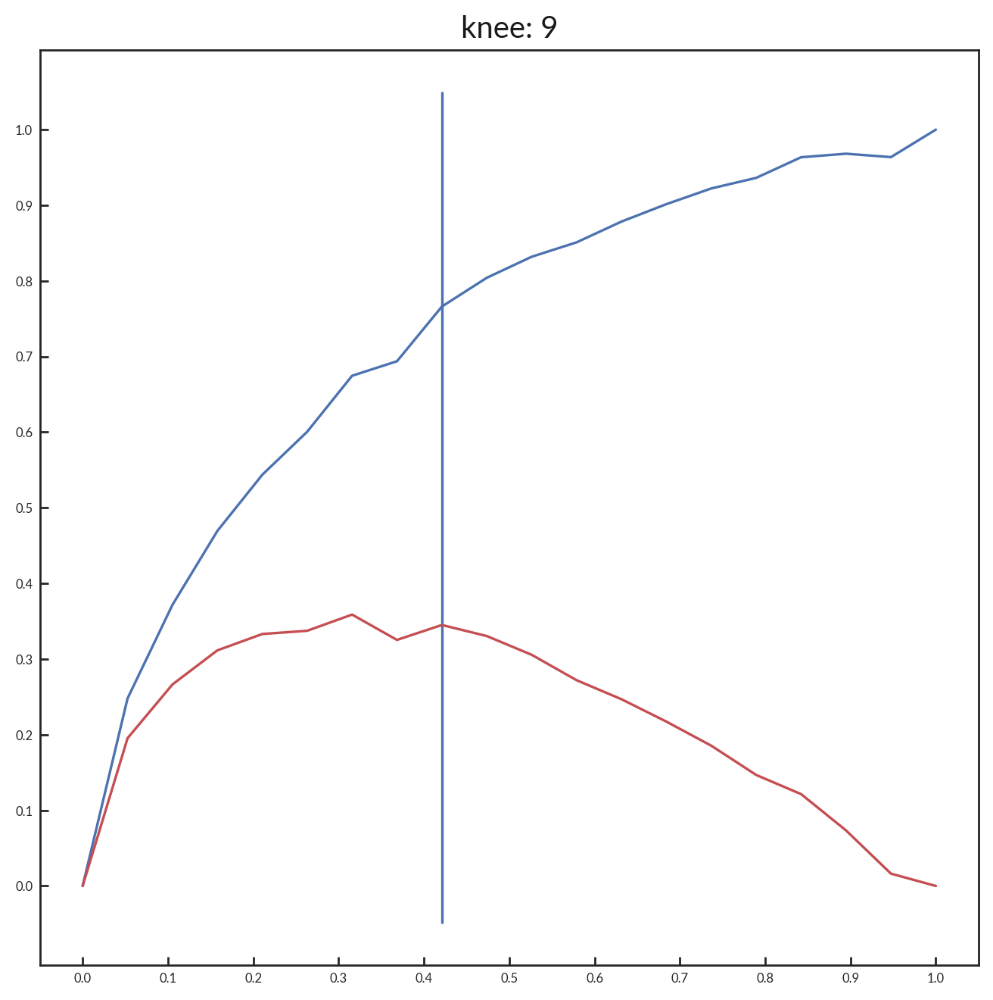

In [47]:
# IDENTIFY POINT OF MAXIMUM CURVATURE IN CUMULATIVE EXPLAINED VARIANCE
y = varexpl
x = np.arange(len(y))+1
kneedle = KneeLocator(x, y)
kneedle.plot_knee_normalized()
knee = ncomponents = kneedle.knee
plt.title('knee: {}'.format(knee))

# SAVE FIGURE
figure_label = '_{}_KNEEPOINT_ARCHETYPE_EXPLAINED_VARIANCE'.format(subset_type)
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)

### COMPUTE ARCHETYPES USING OPTIMAL NUMBER OF ARCHETYPES

In [48]:
# Compute Archeytpes on Imputed PCS
optimal_noc = 8
from py_pcha.PCHA import PCHA
XC, S, C, SSE, varexpl = PCHA(IPC.T.values, noc=optimal_noc, delta=0.05)
archetypes = pd.DataFrame(data = np.squeeze(np.asarray(XC)).T, columns = IPC.columns)

In [49]:
archetypes

,IPC0,IPC1,IPC2,IPC3,IPC4,IPC5,IPC6,IPC7,IPC8,IPC9,...,IPC12,IPC13,IPC14,IPC15,IPC16,IPC17,IPC18,IPC19,IPC20,IPC21
0,0.214687,-0.076371,0.126583,-0.158688,0.252158,0.255013,0.936082,0.131483,-0.068843,-0.030447,...,0.016875,-0.027920,0.087035,-0.027572,0.035963,-0.013709,0.029863,-0.012460,-0.001070,-0.029326
1,0.082176,-0.000491,0.097250,0.062431,0.016561,-0.043183,0.036767,0.033741,-0.166534,-0.103072,...,-0.030058,-0.019412,-0.029901,0.004608,0.009256,0.015779,-0.000678,0.011414,0.010840,0.002230
2,-0.052717,0.005766,0.054592,0.010104,0.078717,0.003498,0.023135,0.004277,-0.152562,-0.124305,...,-0.035427,-0.035706,-0.024937,-0.007288,0.014715,0.006197,-0.001725,-0.004342,0.007604,-0.009210
3,-0.133024,-0.072433,0.190468,-0.009880,0.026213,-0.032748,0.035422,0.055069,-0.158288,-0.107875,...,-0.030867,-0.027073,-0.022770,0.002136,-0.003681,0.004642,-0.004895,0.002514,0.005506,-0.001882
4,0.229279,-0.132661,0.190860,-0.062389,0.119830,0.035481,-0.050078,0.040212,-0.173355,-0.123771,...,-0.022618,-0.006875,-0.007024,-0.008145,0.015921,0.005145,0.012279,0.004302,0.002274,-0.010494
5,-0.014805,0.000420,0.026419,-0.019259,0.005369,0.003845,0.009856,0.096342,-0.144166,-0.092887,...,-0.037179,-0.008505,0.006063,0.005024,0.000906,0.000594,-0.002667,-0.005811,-0.003077,0.002670
6,0.115739,1.210305,0.740973,-0.378227,0.005966,0.146899,-0.043666,0.059149,0.020908,-0.143865,...,-0.061273,0.019913,0.009031,0.047257,-0.018802,0.003289,0.002558,0.011048,-0.033722,-0.001166
7,-0.049317,0.128414,0.123606,0.277597,0.617539,-0.208150,-0.046950,0.475513,0.037937,-0.031720,...,-0.102817,0.031872,-0.004660,0.030737,-0.012493,0.006465,-0.013577,0.053058,0.024817,-0.039830


### COMPUTE PAIRWISE DISTANCE BETWEEN ARCHETYPES

In [50]:
distance = np.zeros([archetypes.shape[0],archetypes.shape[0]])
for current_archetype_idx1 in np.arange(archetypes.shape[0]):
    current_archetype1 = archetypes.loc[current_archetype_idx1,:]

    for current_archetype_idx2 in np.arange(archetypes.shape[0]):
        current_archetype2 = archetypes.loc[current_archetype_idx2,:]

        distance[current_archetype_idx1,current_archetype_idx2] = \
        np.sqrt((current_archetype1-current_archetype2)**2).sum()

distance = pd.DataFrame(data = distance, columns = np.arange(archetypes.shape[0]),
                        index = np.arange(archetypes.shape[0]))

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGEDeuclidean_distance_btw_archetypes


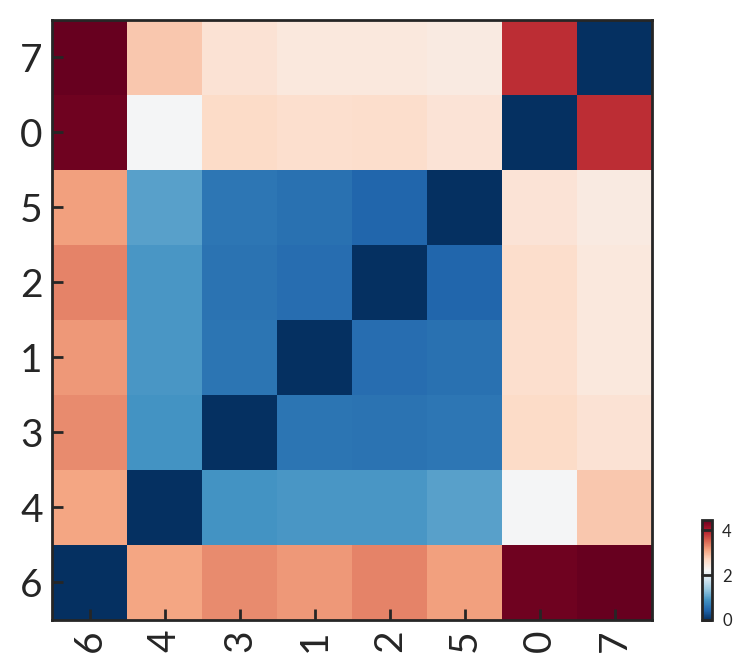

In [51]:
# Clustered heatmap of euclidean distance between archetypes
yticks = distance.index
xticks = distance.columns

# LINKAGE BASED ON NES OF SIGNIFICANT DIFFERENTIALLY EXPRESSED PATHWAYS
method = 'average'
metric = 'cosine'
linkage = hc.linkage(distance, method=method, metric = metric)
row_linkage = deepcopy(linkage)
linkage = hc.linkage(distance.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)

# REORDER HEATMAP ACCORDING TO LINKAGE (OPTIONAL, STILL SLOW)
r1 = hc.leaves_list(row_linkage)
cl = hc.leaves_list(col_linkage)
mat = distance.iloc[r1,cl]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(5,5))
plt.rcParams["axes.grid"] = False

# ADD MATRIX WITH GENE NAMES
axmatrix = fig.add_axes([0.1,0.1,0.6,0.6])
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=plt.cm.RdBu_r)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 14)

labels = list(mat.index)
axmatrix.yaxis.set_ticks_position('left')
ytick = plt.yticks(range(len(labels)), labels, rotation = 0, fontsize = 14)

#axmatrix.set_yticklabels([]);

# ADD COLORBAR
axcolor = fig.add_axes([0.75,0.1,0.01,0.1])
cbar = plt.colorbar(im, cax=axcolor)
#cbar.ax.get_yaxis().set_ticks([])

# SAVE FIGURE
figure_label = 'euclidean_distance_btw_archetypes'
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

###### FIND CELL NEAREST TO EACH ARCHETYPE BASED ON EUCLIDEAN DISTANCE

In [52]:
# Compute distance between each cell and archetype
archetype_distances = pd.DataFrame()
for current_archetype_idx in np.arange(archetypes.shape[0]):
    current_archetype = archetypes.loc[current_archetype_idx,:]
    distances = np.sqrt(((current_archetype-IPC)**2).sum(axis = 1)).to_frame(name = 'Distance_Archetype_{}'.format(current_archetype_idx))
    archetype_distances = pd.concat([archetype_distances, distances],axis=1)

### VISUALIZE CELL NEAREST TO EACH ARCHETYPE

In [53]:
np.arange(len(archetype_distances.columns))

array([0, 1, 2, 3, 4, 5, 6, 7])

In [54]:
list(genesets.columns)

['KEGG_NATURAL_KILLER_CELL_MEDIATED_CYTOTOXICITY',
 'LEE_NEURAL_CREST_STEM_CELL_UP',
 'LEE_NEURAL_CREST_STEM_CELL_DN',
 'GO_NEURAL_CREST_CELL_DIFFERENTIATION',
 'GO_NEURAL_TUBE_DEVELOPMENT',
 'Monosomy 3 Up',
 'Monosomy 3 Down',
 'Castle 2',
 'Castle 1',
 'Class 1 Onken v2',
 'Class 2 Onken v2',
 'EHLERS_ANEUPLOIDY_UP',
 'EHLERS_ANEUPLOIDY_DN',
 'GO_PCG_PROTEIN_COMPLEX',
 'DOUGLAS_BMI1_TARGETS_UP',
 'DOUGLAS_BMI1_TARGETS_DN',
 'BENPORATH_PRC2_TARGETS',
 'WIEDERSCHAIN_TARGETS_OF_BMI1_AND_PCGF2',
 'BENPORATH_SUZ12_TARGETS',
 'BENPORATH_EED_TARGETS',
 'BMI1_DN.V1_DN',
 'BMI1_DN.V1_UP',
 'BMI1_DN_MEL18_DN.V1_DN',
 'BMI1_DN_MEL18_DN.V1_UP',
 'GO_CHROMATIN_BINDING',
 'GO_CHROMATIN_MODIFICATION',
 'GO_CHROMATIN_ORGANIZATION',
 'GO_CHROMOSOME_ORGANIZATION',
 'GO_HISTONE_H2A_MONOUBIQUITINATION',
 'GO_HISTONE_H2A_UBIQUITINATION',
 'GO_HISTONE_MONOUBIQUITINATION',
 'GO_HISTONE_UBIQUITINATION',
 'GO_NUCLEAR_UBIQUITIN_LIGASE_COMPLEX',
 'GO_PROTEIN_MODIFICATION_BY_SMALL_PROTEIN_CONJUGATION_OR_REMOVA

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_TUMOR_MONOSOMY3_CASTLE2


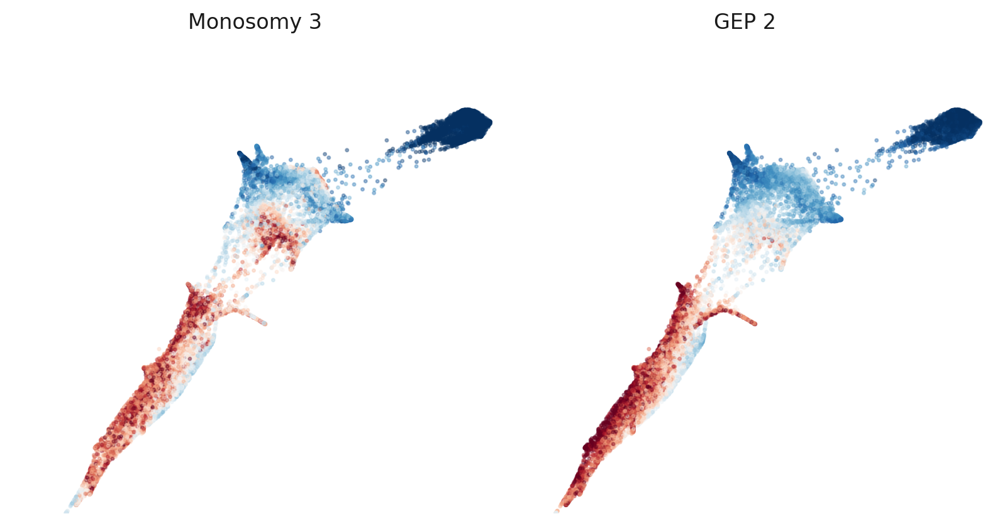

In [55]:
# Visuaulize distance to each archetype
# PLOT CATEGORICAL CLUSTER ASSIGNMENTS
# Note: Any rows assigned -1 were identified as outliers and should not be considered as a member of any community.
plt.figure(figsize = (10,5))
nrow = 1
ncol = 2
dot_size = 1
gs1 = gridspec.GridSpec(nrow, ncol)
gs1.update(wspace=0.01, hspace=0.1) # set the spacing between axes. 

cm = plt.cm.bwr 
dimtype = 'ForceDirected' 
meta = 'Phenograph_Class'
exec('DIM = DIMENSIONS_{}'.format(subset_type))
exec('QUERY= INDF_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))
x = DIM['{}0'.format(dimtype)]
y = DIM['{}1'.format(dimtype)]
axis_min = -ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10
axis_max = ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10

# MONOSOMY 3 SIGNATURE
ax = plt.subplot(gs1[0])
gene_sig = 'Monosomy 3 Up'
signature_genes = genesets[gene_sig].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
phase = zscore(np.nanmedian(QUERY[detected_genes],axis=1))
# Plot scatter map with phase score
mask = np.isnan(phase)
    
# Randomize/Sort Color Values before Plotting
color_values = np.array(phase)
i = np.random.permutation(len(color_values))
xx = np.array(x)[i]
yy = np.array(y)[i]
color_values = color_values[i]

plt.scatter(xx, yy, c = color_values, cmap = CM_DIVERGING, s=3, alpha =0.4)
plt.clim(-1.5,1.5)
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
plt.title('Monosomy 3', fontname='Helvetica', size=12, weight='normal')

# BAP1 SIGNATURE
ax = plt.subplot(gs1[1])
gene_sig = 'Castle 2'
signature_genes = genesets[gene_sig].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
phase = zscore(np.nanmedian(QUERY[detected_genes],axis=1))
# Plot scatter map with phase score
mask = np.isnan(phase)
    
# Randomize/Sort Color Values before Plotting
color_values = np.array(phase)
i = np.random.permutation(len(color_values))
xx = np.array(x)[i]
yy = np.array(y)[i]
color_values = color_values[i]

plt.scatter(xx, yy, c = color_values, cmap = CM_DIVERGING, s=3, alpha =0.4)
plt.clim(-1.5,1.5)
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
plt.title('GEP 2', fontname='Helvetica', size=12, weight='normal')

# SAVE FIGURE
figure_label = '_{}_MONOSOMY3_CASTLE2'.format(subset_type)
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_TUMOR_MONOSOMY3_ARCHETYPES_noText_Top5


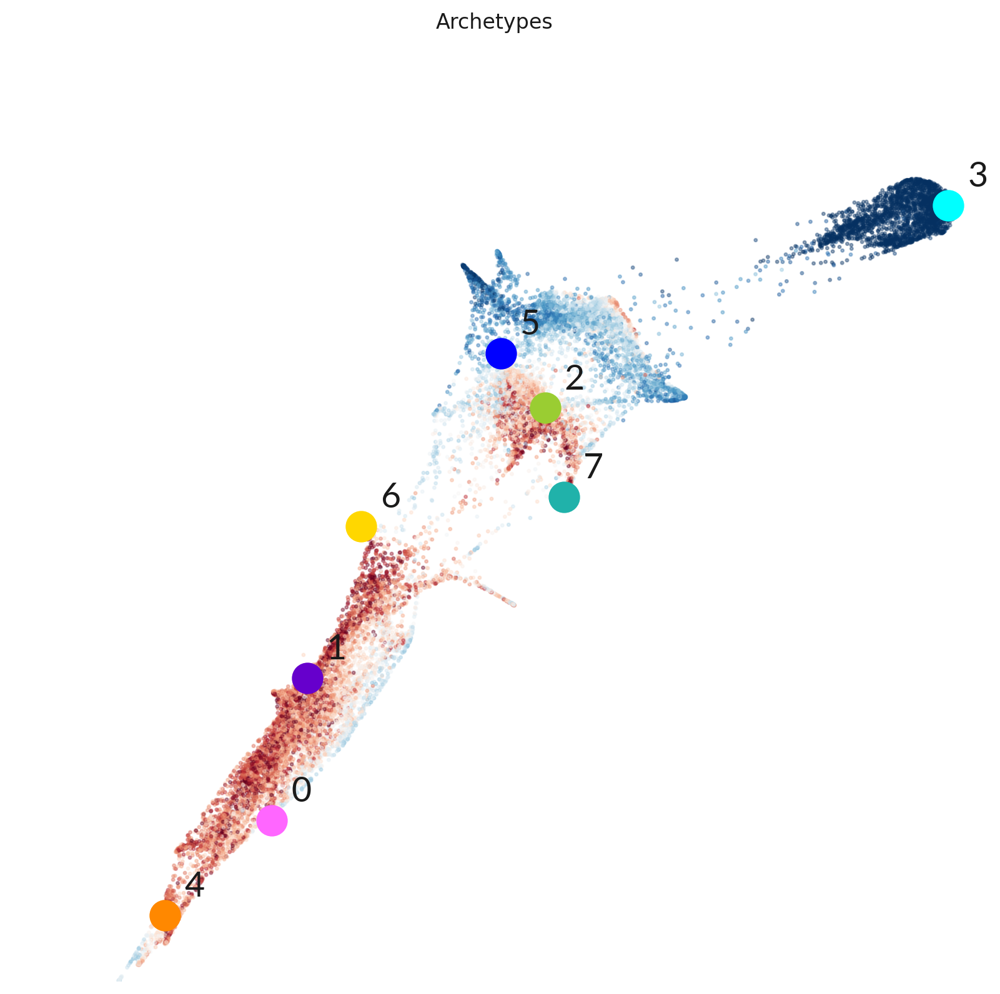

In [56]:
FLATUI_ARCHETYPES = [
                 'FF66FF', # pink
                 '6600CC', # purple
                 '9ACD32', # Green
                 '00FFFF', # skye blue
                 'FF8800', # orange
                 '0000FF', # dark blue
                 'FFD700', # yellow
                 '20B2AA', # teal
                 #'008000', # forest green
                 #'8B008B'
    ]

# Visuaulize distance to each archetype
# PLOT CATEGORICAL CLUSTER ASSIGNMENTS
# Note: Any rows assigned -1 were identified as outliers and should not be considered as a member of any community.
plt.figure(figsize = (20,10))
nrow = 1
ncol = 2
dot_size = 1
gs1 = gridspec.GridSpec(nrow, ncol)
gs1.update(wspace=0.01, hspace=0.1) # set the spacing between axes. 

cm = plt.cm.bwr 
dimtype = 'ForceDirected' 
meta = 'Phenograph_Class'
exec('DIM = DIMENSIONS_{}'.format(subset_type))
exec('QUERY= INDF_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))
x = DIM['{}0'.format(dimtype)]
y = DIM['{}1'.format(dimtype)]
axis_min = -ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10
axis_max = ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10

# MONOSOMY 3 SIGNATURE
ax = plt.subplot(gs1[0])
gene_sig = 'Monosomy 3 Up'
signature_genes = genesets[gene_sig].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
phase = zscore(np.nanmedian(QUERY[detected_genes],axis=1))
# Plot scatter map with phase score
mask = np.isnan(phase)
    
# Randomize/Sort Color Values before Plotting
color_values = np.array(phase)
i = np.random.permutation(len(color_values))
xx = np.array(x)[i]
yy = np.array(y)[i]
color_values = color_values[i]

plt.scatter(xx, yy, c = color_values, cmap = CM_DIVERGING, s=3, alpha =0.4)
plt.clim(-1.5,1.5)
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
plt.title('Monosomy 3', fontname='Helvetica', size=12, weight='normal')

# Distance to archeytpe
#ax = plt.subplot(gs1[1])
#archetype_distances['Archetype_Cluster'] = [0]*archetype_distances.shape[0]
#plt.scatter(x,y,c = '#E6E6FA',s = 3)
for ii in np.arange(len(archetype_distances.columns)):
    c = np.log10(archetype_distances['Distance_Archetype_{}'.format(ii)])
    #cc = c < c.mean()-2*c.std()
    c = c==c.min()
    #numcells = cc.sum()
    #print(numcells)    
    #text(x, y, s, fontsize=12)
    plt.scatter(x[c.values],y[c.values],s= 300, color = '#'+FLATUI_ARCHETYPES[ii])
    offset = 1000
    plt.text(x[c.values]+offset,y[c.values]+offset,s = '{}'.format(ii), fontsize = 20)#numcells/10)
    sns.despine()
    plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
    plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
    plt.title('Archetypes', fontname='Helvetica', size=12, weight='normal')
    plt.xlim(axis_min,axis_max)
    plt.ylim(axis_min,axis_max)
    plt.axis('off')

# SAVE FIGURE
figure_label = '_{}_MONOSOMY3_ARCHETYPES_noText_Top5'.format(subset_type)
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

(-24810.0, 24810.0, -24810.0, 24810.0)

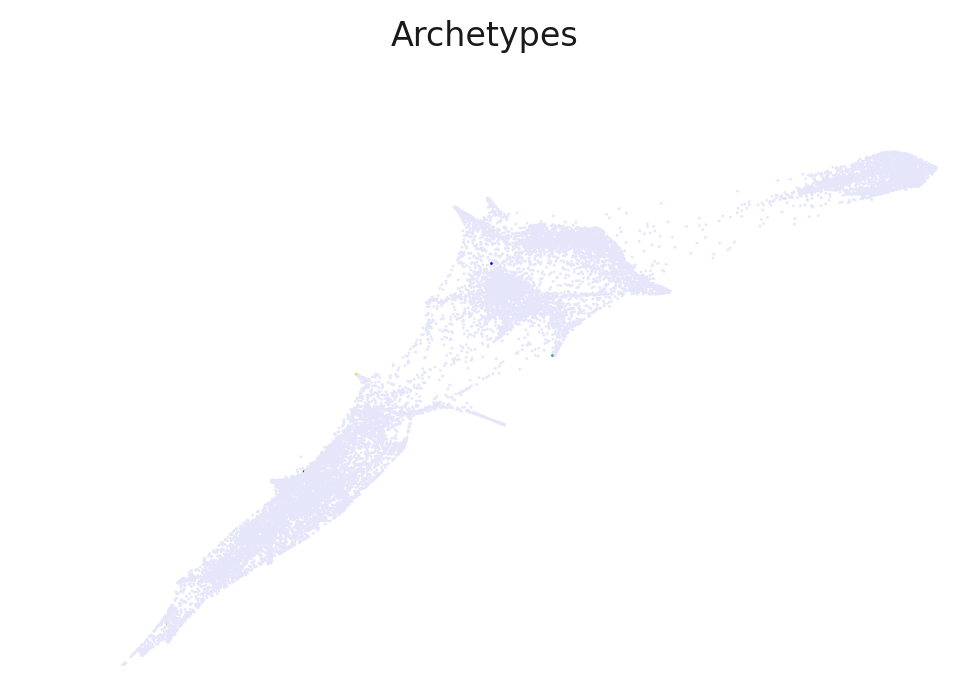

In [57]:
FLATUI_ARCHETYPES = [
                 'E6E6FA', # not assgined
                 'FF66FF', # pink
                 '6600CC', # purple
                 '9ACD32', # Green
                 '00FFFF', # skye blue
                 'FF8800', # orange
                 '0000FF', # dark blue
                 'FFD700', # yellow
                 '20B2AA', # teal
                 #'008000', # forest green
                 #'8B008B'
    ]

# CONVERT HEX TO RGB (FLATUI_SAMPLE)
colors = np.zeros((len(FLATUI_ARCHETYPES),3))
for ind,hexcolor in enumerate(FLATUI_ARCHETYPES):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_ARCHETYPES = LinearSegmentedColormap.from_list('FLATUI_ARCHETYPES', colors, N=len(colors))

num_archetypes = len(archetype_distances.columns)
ccc = [0]*archetype_distances.shape[0]
for ii in np.arange(num_archetypes):
    c = np.log10(archetype_distances['Distance_Archetype_{}'.format(ii)])
    cc = c == c.min()
    cc = cc*(ii+1)
    ccc=ccc+cc
    
ax = plt.gca()
seqc.plot.scatter.categorical(x, y, c= ccc, randomize = True,edgecolors='none',
                              cmap=CM_ARCHETYPES,legend_kwargs={'ncol': 1}, s=1, ax=ax);
plt.title('Archetypes', fontname='Helvetica', size=12, weight='normal')
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
sns.despine()
ax.legend_.remove()
plt.axis('off')
#ccc[ccc>num_archetypes] = 0 # remove cells assigned to more than one archetype

In [58]:
np.unique(ccc)

array([0, 1, 2, 3, 4, 5, 6, 7, 8], dtype=int64)

###### UPDATE INDEX

In [59]:
METADATA_TUMOR.head()

Legend  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype          
0         UM01A  UM01    1       7                0         9                 0                      0                      1                  UM01A   
                         2       7                0         3                 0                      0                      1                  UM01A   
                         3       7                0         9                 0                      0                      1                  UM01A   
                         4       19               0         4                 0                      0                      2                  UM01A   
                         6       7                0         8                 0                      0                      1                  UM01A   

                                                                                                                                              libsize  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype           
0         UM01A  UM01    1       7                0         9                 0                      0                      1                    2793   
                         2       7                0         3                 0                      0                      1                    1920   
                         3       7                0         9                 0                      0                      1                    1874   
                         4       19               0         4                 0                      0                      2                    1903   
                         6       7                0         8                 0                      0                      1                    2349   

                                                                                                                                              mt_fraction  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype               
0         UM01A  UM01    1       7                0         9                 0                      0                      1                    0.113856   
                         2       7                0         3                 0                      0                      1                   0.0838542   
                         3       7                0         9                 0                      0                      1                   0.0533618   
                         4       19               0         4                 0                      0                      2                    0.140305   
                         6       7                0         8                 0                      0                      1                    0.174542   

                                                                                                                                              Stage  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype         
0         UM01A  UM01    1       7                0         9                 0                      0                      1                     2   
                         2       7                0         3                 0                      0                      1                     2   
                         3       7                0         9                 0                      0                      1                     2   
                         4       19               0         4                 0                      0                      2                     2   

In [60]:
# Write fuzzy clusters to metadata
METADATA_TUMOR['Archetype_Nearest_Cell'] = ccc

# Update index
new_index = pd.MultiIndex.from_tuples(list(zip(METADATA_TUMOR.index.get_level_values('Sample ID'), 
                                               METADATA_TUMOR.index.get_level_values('Legend'),
                                               METADATA_TUMOR.index.get_level_values('Patient'),
                                               METADATA_TUMOR.index.get_level_values('Cell ID'),
                                               METADATA_TUMOR.index.get_level_values('Phenograph_Class'),
                                               METADATA_TUMOR.index.get_level_values('Archetype'),
                                               METADATA_TUMOR.index.get_level_values('Nearest Archetype'),
                                               METADATA_TUMOR['Archetype_Nearest_Cell'])), 
                                  names=['Sample ID','Legend', 'Patient','Cell ID','Phenograph_Class','Archetype',
                                        'Nearest Archetype','Archetype_Nearest_Cell'])

In [61]:
subset_type = 'TUMOR'
exec('DF_{} = pd.DataFrame(DF_{}.values, columns = DF_{}.columns, index = new_index)'\
     .format(subset_type,subset_type,subset_type))
exec('NDF_{} = pd.DataFrame(NDF_{}.values, columns = NDF_{}.columns, index = new_index)'\
     .format(subset_type,subset_type,subset_type))
exec('INDF_{} = pd.DataFrame(INDF_{}.values, columns = INDF_{}.columns, index = new_index)'\
     .format(subset_type,subset_type,subset_type))
exec('METADATA_{} = pd.DataFrame(METADATA_{}.values, columns = METADATA_{}.columns, index = new_index)'\
     .format(subset_type,subset_type,subset_type))
exec('DIMENSIONS_{} = pd.DataFrame(DIMENSIONS_{}.values, columns = DIMENSIONS_{}.columns, index = new_index)'\
     .format(subset_type,subset_type,subset_type))

### COMPUTE DIFFUSION DISTANCE BETWEEN EACH CELL AND EACH ARCHETYPE (NEAREST CELL)

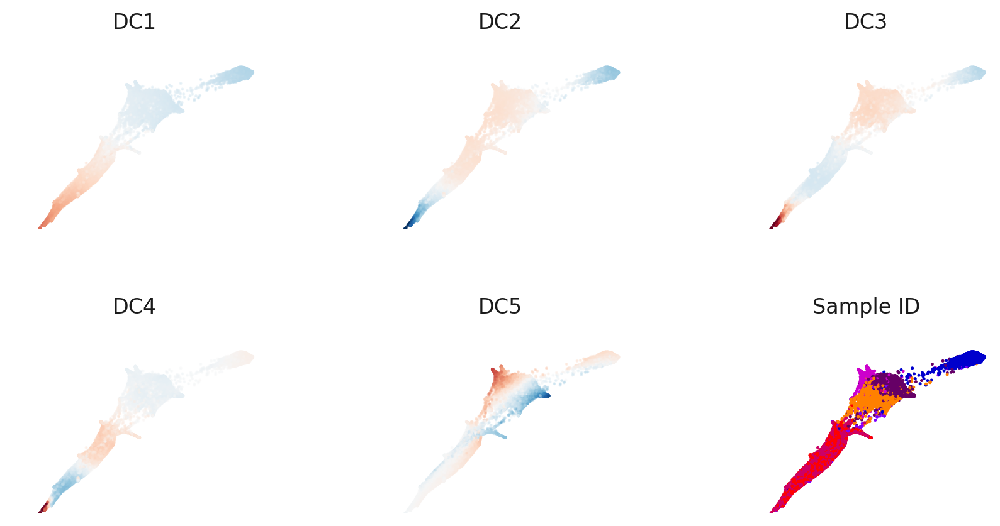

In [62]:
# PLOT DCS on TSNE, SELECT MOST RELEVANT PCS
dimtype = 'ForceDirected' 

exec('x = DIMENSIONS_{}[\'{}0\']'.format(subset_type,dimtype))
exec('y = DIMENSIONS_{}[\'{}1\']'.format(subset_type,dimtype))
xmax = np.abs(x).max()
ymax = np.abs(y).max()
axis_min = -ceil(ceil(max(xmax,ymax)/10)*10)
axis_max = ceil(ceil(max(xmax,ymax)/10)*10)

cm = plt.cm.bwr 
dot_size = 1

# Diffusion Eigenvalues
component_prefix = 'DC'
exec('QUERY = DIMENSIONS_{}'.format(subset_type))
idx = QUERY.columns.to_series().str.contains('^{}((?!TSNE).)*$'.format(component_prefix)) # select from DIMS_NDF
exec('DIFFUSION_EIGS = DIMENSIONS_{}.loc[:, idx.values]'.format(subset_type))

nrow = 2
ncol = 3
plt.figure(figsize = (10,5))
gs1 = gridspec.GridSpec(nrow, ncol)
gs1.update(wspace=0.5, hspace=0.5)  

# Plot scatter map with phase score
for ind,label in enumerate(DIFFUSION_EIGS.columns[:5]):
    c = DIFFUSION_EIGS[label].values
    # CURRENT AXIS
    ax = plt.subplot(gs1[ind])
    plt.scatter(x, y, c=c,cmap=CM_DIVERGING, s=dot_size, alpha =0.4)             # finite data
    plt.title(label, fontname='Helvetica', size=12, weight='normal')
    plt.axis('off')
    plt.clim(-0.04,0.04)
    plt.xlim(axis_min,axis_max)
    plt.ylim(axis_min,axis_max)
    
# PLOT SAMPLE_ID
ax = plt.subplot(gs1[ind+1])
exec('seqc.plot.scatter.categorical(x, y, c=NDF_{}.index.get_level_values(\'Legend\'), randomize = True, \
     cmap=CM_SAMPLES, s=dot_size, ax=ax)'.format(subset_type))
plt.title('Sample ID', fontname='Helvetica', size=12, weight='normal')
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
ax.legend_.remove()

# SAVE FIGURE
figure_label = '_{}_DIFFUSIONEIGS_{}'.format(subset_type,dimtype)
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)

### SELECT MOST IMPORTANT DIFFUSION EIGS FOR MULTISCALE DISTANCE

In [63]:
DIFFUSION_EIGS.head()

DC1  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.011340   
                         2       7                0         3                 0                       0.013910   
                         3       7                0         9                 0                       0.012884   
                         4       19               0         4                 0                       0.003814   
                         6       7                0         8                 0                       0.012105   

                                                                                                           DC2  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                      -0.004699   
                         2       7                0         3                 0                      -0.011048   
                         3       7                0         9                 0                      -0.008065   
                         4       19               0         4                 0                       0.002684   
                         6       7                0         8                 0                      -0.009142   

                                                                                                           DC3  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                      -0.002053   
                         2       7                0         3                 0                       0.004344   
                         3       7                0         9                 0                       0.001277   
                         4       19               0         4                 0                      -0.003476   
                         6       7                0         8                 0                       0.003781   

                                                                                                           DC4  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                      -0.013237   
                         2       7                0         3                 0                      -0.017593   
                         3       7                0         9                 0                      -0.015363   
                         4       19               0         4                 0                       0.003310   
                         6       7                0         8                 0                      -0.011222   

                                                                                                           DC5  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                      -0.001046   
                         2       7                0         3                 0                       0.000538   
                         3       7                0         9                 0                       0.001521   
                         4       19               0         4                 0                      -0.008808   
                         6       7                0         8                 0                      -0.003022   

                                                                                                           DC6  

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGEDTUMOR_DCeigengap


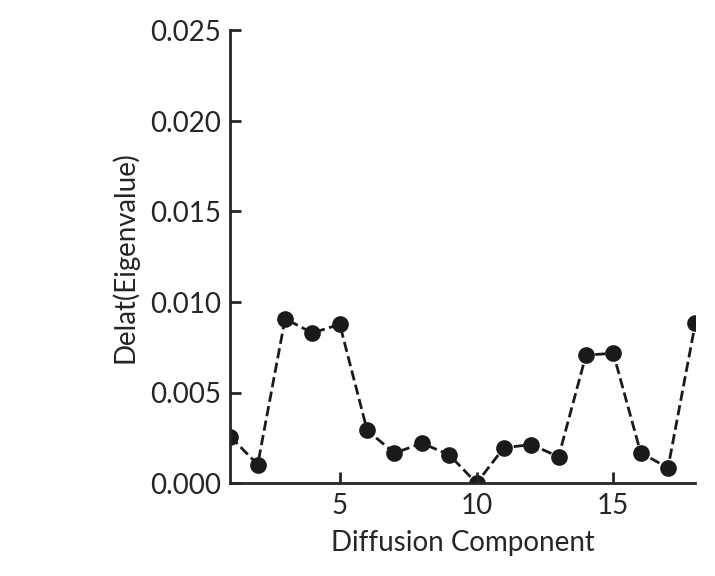

In [64]:
# SELECT EIGENVALUES, EXCLUDING ZEROITH
eigs = DIFFUSION_EIGS
eigs = [eig[0].astype(float) for eig in eigs.values]
eigs = np.array(eigs)
eigengap = np.abs(eigs[:-1]-eigs[1:])

# COMPUTE EIGENGAP
fig = plt.figure(figsize = (3,3))
ax = plt.gca()
ax.set_facecolor('white')
plt.plot(np.arange(len(eigengap))+1,eigengap, marker='.', linestyle='dashed',linewidth=1, markersize=10, color = 'k')
plt.xlim(1,18)
plt.ylim(0,0.025)

ax.set_ylabel("\n\n\n{}".format('Delat(Eigenvalue)'),fontsize=10)
ax.set_xlabel("Diffusion Component",fontsize=10)
ax.tick_params(labelsize=10)

plt.grid(False)
sns.despine()

# SAVE FIGURE
figure_label = '{}_DCeigengap'.format(subset_type)
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=fig_dpi)
print(fn)

### PAIRWISE DIFFUSION DISTANCE BETWEEN CELLS

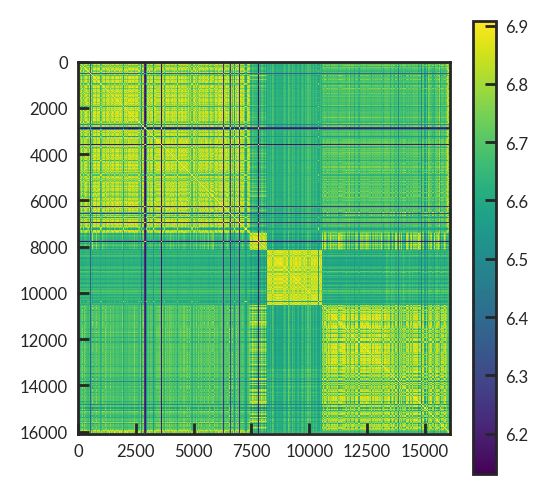

In [65]:
L = 5 # number of eigen vectors to include in multi-scale distance

from scipy.spatial.distance import pdist, squareform

vec = DIFFUSION_EIGS.iloc[:,:L]
scale_factor = (eigs/(1-eigs))#**2 # constant
scale_factor = scale_factor[:L]

distance_matrix = vec*scale_factor
pairwise_distances = squareform(pdist(distance_matrix, lambda u,v: np.sqrt(((u-v)**2).sum()))) # MS, remove sqrt?

diffusion_pairwise_distances= pd.DataFrame(index = DIFFUSION_EIGS.index, data=pairwise_distances, 
                                           columns = DIFFUSION_EIGS.index.get_level_values('Cell ID'))

fig = plt.figure(figsize = (3,3))
ax = plt.gca()
plt.imshow(-np.log(pairwise_distances+0.001))
plt.colorbar()

### ASSIGN SOFT CLUSTER TO ARCHETYPE BASED ON DIFFUSION DISTANCE

In [66]:
diffusion_pairwise_distances

Cell ID                                                                                                  1      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000000   
                         2       7                0         3                 0                       0.000129   
                         3       7                0         9                 0                       0.000074   
                         4       19               0         4                 0                       0.000178   
                         6       7                0         8                 0                       0.000102   
...                                                                                                        ...   
6         UM06   UM06    19435   12               5         5                 0                       0.000660   
                         19437   12               0         5                 0                       0.000634   
                         19440   12               0         5                 0                       0.000634   
                         19441   12               0         5                 0                       0.000619   
                         19450   0                0         1                 0                       0.000286   

Cell ID                                                                                                  2      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000129   
                         2       7                0         3                 0                       0.000000   
                         3       7                0         9                 0                       0.000061   
                         4       19               0         4                 0                       0.000284   
                         6       7                0         8                 0                       0.000061   
...                                                                                                        ...   
6         UM06   UM06    19435   12               5         5                 0                       0.000546   
                         19437   12               0         5                 0                       0.000519   
                         19440   12               0         5                 0                       0.000518   
                         19441   12               0         5                 0                       0.000503   
                         19450   0                0         1                 0                       0.000334   

Cell ID                                                                                                  3      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000074   
                         2       7                0         3                 0                       0.000061   
                         3       7                0         9                 0                       0.000000   
                         4       19               0         4                 0                       0.000242   
                         6       7                0         8                 0                       0.000069   
...                                                                                                        ...   
6         UM06   UM06    19435   12               5         5                 0                       0.000599   
        

In [67]:
# Get ID of cell nearest to each archetype
master_groupby = 'Archetype_Nearest_Cell'
ix = [ind for ind,name in enumerate(diffusion_pairwise_distances.index.names) if name==master_groupby][0]
cellid_archetype = np.zeros(len(np.unique(diffusion_pairwise_distances.index.get_level_values(master_groupby)))-1)
for arch_ind in np.unique(diffusion_pairwise_distances.index.get_level_values(master_groupby))[1:]:
    vals = diffusion_pairwise_distances.loc[diffusion_pairwise_distances.index.map(lambda x: x[ix] in [arch_ind])]
    cellid_archetype[int(arch_ind)-1] = vals.index.get_level_values('Cell ID')[0]
cellid_archetype

array([19273.,  5036., 12984., 10000.,  7901., 16872., 19070., 18863.])

In [68]:
# Assign soft cluster arround each archtype based on multi-scale diffusion distance
# Radius around each archetype define as 1/2 multiscale diffusion distance to nearest archetype
master_groupby = 'Archetype_Nearest_Cell'
ix = [ind for ind,name in enumerate(diffusion_pairwise_distances.index.names) if name==master_groupby][0]

assignments = pd.DataFrame(index = diffusion_pairwise_distances.index, 
                           columns = ['Archetype_Soft_Cluster'],
                           data = np.zeros(diffusion_pairwise_distances.shape[0]).astype(int))

for arch_ind in np.unique(diffusion_pairwise_distances.index.get_level_values(master_groupby))[1:]:
    
    vals = diffusion_pairwise_distances.loc[diffusion_pairwise_distances.index.map(lambda x: x[ix] in [arch_ind])]
    
    distance_to_other_archetypes = vals[cellid_archetype.astype(int)].\
                                   drop(vals.index.get_level_values('Cell ID')[0],axis=1)
    
    arch_radius = 0.5*distance_to_other_archetypes.min().min()
    tmp = (vals < arch_radius)*arch_ind
    assignments = pd.DataFrame(index = diffusion_pairwise_distances.index, 
                               columns = ['Archetype_Soft_Cluster'],
                               data = assignments['Archetype_Soft_Cluster'].values + tmp.values[0])

METADATA_TUMOR['Archetype_Soft_Cluster'] = assignments['Archetype_Soft_Cluster']

In [69]:
FLATUI_ARCHETYPES = [
                 'E6E6FA', # not assgined
                 'FF66FF', # pink
                 '6600CC', # purple
                 '9ACD32', # Green
                 '00FFFF', # skye blue
                 'FF8800', # orange
                 '0000FF', # dark blue
                 'FFD700', # yellow
                 '20B2AA', # teal
                 #'008000', # forest green
                 #'8B008B'
    ]

# CONVERT HEX TO RGB (FLATUI_SAMPLE)
colors = np.zeros((len(FLATUI_ARCHETYPES),3))
for ind,hexcolor in enumerate(FLATUI_ARCHETYPES):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_ARCHETYPES = LinearSegmentedColormap.from_list('FLATUI_ARCHETYPES', colors, N=len(colors))

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_CLUSTERS_INDF_TUMOR_Phenograph_Class_ForceDirected


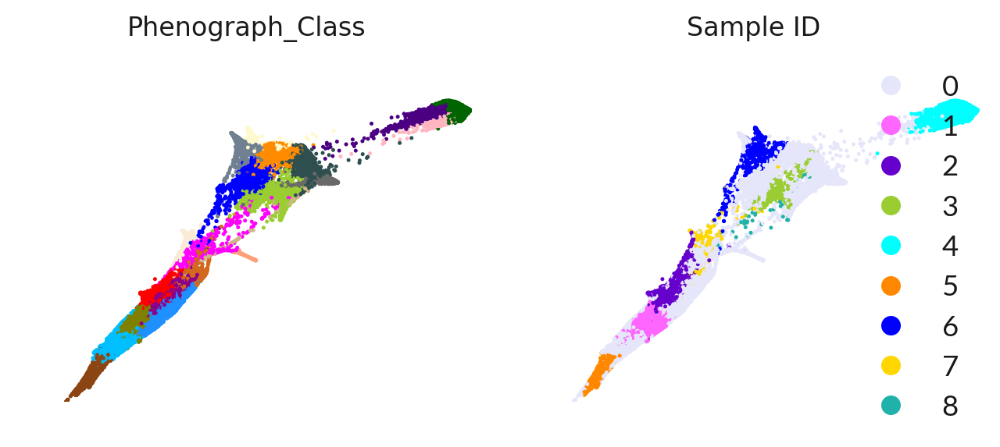

In [70]:
### PLOT CATEGORICAL CLUSTER ASSIGNMENTS
# Note: Any rows assigned -1 were identified as outliers and should not be considered as a member of any community.
plt.figure(figsize = (8,3))
nrow = 1
ncol = 2
dot_size = 1
gs1 = gridspec.GridSpec(nrow, ncol)
gs1.update(wspace=0.1, hspace=0.1) # set the spacing between axes. 

dimtype = 'ForceDirected' 
meta = 'Phenograph_Class'
exec('DIM = DIMENSIONS_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))
exec('QUERY = INDF_{}'.format(subset_type))
x = DIM['{}0'.format(dimtype)]
y = DIM['{}1'.format(dimtype)]
axis_min = -ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10
axis_max = ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10

# Cluster Assignment
ax = plt.subplot(gs1[0])
seqc.plot.scatter.categorical(x, y, c=META[meta].values, 
                              cmap= CM_CLASS,
                              legend_kwargs={'ncol': 1}, s=dot_size, ax=ax,randomize=True);
plt.rc('xtick', labelsize=6)
plt.rc('ytick', labelsize=6)
sns.despine()
plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.title('{}'.format(meta), fontname='Helvetica', size=12, weight='normal')
plt.axis('off')
ax.legend_.remove()

# Castle Class
ax = plt.subplot(gs1[1])
seqc.plot.scatter.categorical(x, y, c=META['Archetype_Soft_Cluster'], cmap=CM_ARCHETYPES,legend_kwargs={'ncol': 1}, s=dot_size, ax=ax);
sns.despine()
plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
plt.title('Sample ID', fontname='Helvetica', size=12, weight='normal')
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
#ax.legend_.remove()

# SAVE FIGURE
figure_label = '_CLUSTERS_INDF_{}_{}_{}'.format(subset_type,meta,dimtype) 
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=fig_dpi)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=fig_dpi)
print(fn)


###### ASSIGN ALL CELLS TO NEAREST ARCHETYPE

In [71]:
diffusion_pairwise_distances.head()

Cell ID                                                                                                  1      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000000   
                         2       7                0         3                 0                       0.000129   
                         3       7                0         9                 0                       0.000074   
                         4       19               0         4                 0                       0.000178   
                         6       7                0         8                 0                       0.000102   

Cell ID                                                                                                  2      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000129   
                         2       7                0         3                 0                       0.000000   
                         3       7                0         9                 0                       0.000061   
                         4       19               0         4                 0                       0.000284   
                         6       7                0         8                 0                       0.000061   

Cell ID                                                                                                  3      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000074   
                         2       7                0         3                 0                       0.000061   
                         3       7                0         9                 0                       0.000000   
                         4       19               0         4                 0                       0.000242   
                         6       7                0         8                 0                       0.000069   

Cell ID                                                                                                  4      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000178   
                         2       7                0         3                 0                       0.000284   
                         3       7                0         9                 0                       0.000242   
                         4       19               0         4                 0                       0.000000   
                         6       7                0         8                 0                       0.000232   

Cell ID                                                                                                  6      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000102   
                         2       7                0         3                 0                       0.000061   
                         3       7                0         9                 0                       0.000069   
                         4       19               0         4                 0                       0.000232   
                         6       7                0         8                 0                       0.000000   

Cell 

In [72]:
D = pd.DataFrame(index = diffusion_pairwise_distances.index)
for ind in np.unique(diffusion_pairwise_distances.index.get_level_values('Archetype_Nearest_Cell')):
    D[ind]=diffusion_pairwise_distances[\
           diffusion_pairwise_distances.index.get_level_values('Archetype_Nearest_Cell')==ind].mean(axis=0).values

METADATA_TUMOR['Nearest_Archetype'] = D.idxmin(axis=1)

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_CLUSTERS_INDF_TUMOR_Phenograph_Class_ForceDirected


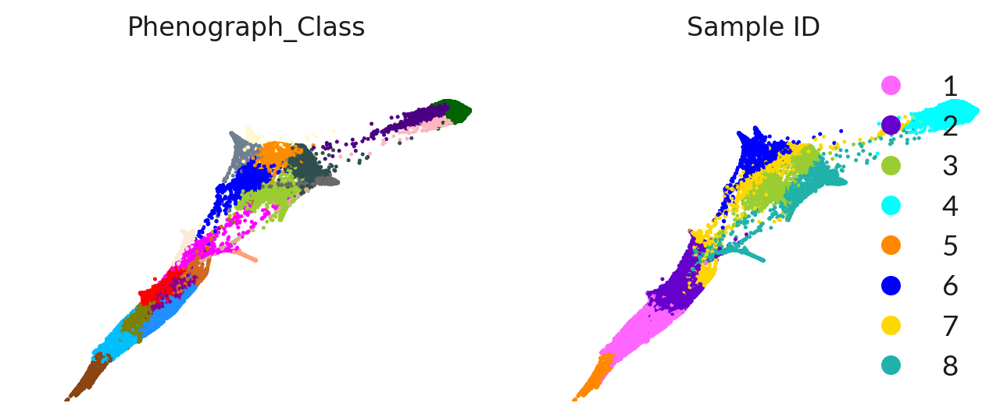

In [73]:
cm_flatui_1 = FLATUI_ARCHETYPES[1:]

# CONVERT HEX TO RGB (FLATUI_SAMPLE)
colors = np.zeros((len(cm_flatui_1),3))
for ind,hexcolor in enumerate(cm_flatui_1):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_ARCHETYPES = LinearSegmentedColormap.from_list('cm_flatui_1', colors, N=len(colors))

# PLOT CATEGORICAL CLUSTER ASSIGNMENTS
# Note: Any rows assigned -1 were identified as outliers and should not be considered as a member of any community.
plt.figure(figsize = (8,3))
nrow = 1
ncol = 2
dot_size = 1
gs1 = gridspec.GridSpec(nrow, ncol)
gs1.update(wspace=0.1, hspace=0.1) # set the spacing between axes. 

dimtype = 'ForceDirected' 
meta = 'Phenograph_Class'
exec('DIM = DIMENSIONS_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))
exec('QUERY = INDF_{}'.format(subset_type))
x = DIM['{}0'.format(dimtype)]
y = DIM['{}1'.format(dimtype)]
axis_min = -ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10
axis_max = ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10

# Cluster Assignment
ax = plt.subplot(gs1[0])
seqc.plot.scatter.categorical(x, y, c=META[meta].values, 
                              cmap= CM_CLASS,
                              legend_kwargs={'ncol': 1}, s=dot_size, ax=ax,randomize=True);
plt.rc('xtick', labelsize=6)
plt.rc('ytick', labelsize=6)
sns.despine()
plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.title('{}'.format(meta), fontname='Helvetica', size=12, weight='normal')
plt.axis('off')
ax.legend_.remove()

# Castle Class
ax = plt.subplot(gs1[1])
seqc.plot.scatter.categorical(x, y, c=META['Nearest_Archetype'], cmap=CM_ARCHETYPES,legend_kwargs={'ncol': 1}, s=dot_size, ax=ax);
sns.despine()
plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
plt.title('Sample ID', fontname='Helvetica', size=12, weight='normal')
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
#ax.legend_.remove()

# SAVE FIGURE
figure_label = '_CLUSTERS_INDF_{}_{}_{}'.format(subset_type,meta,dimtype) 
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=fig_dpi)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=fig_dpi)
print(fn)

###### UPDATE MULTI-INDEX

In [74]:
# Update index
new_index = pd.MultiIndex.from_tuples(list(zip(METADATA_TUMOR.index.get_level_values('Sample ID'), 
                                               METADATA_TUMOR.index.get_level_values('Legend'),
                                               METADATA_TUMOR.index.get_level_values('Patient'),
                                               METADATA_TUMOR.index.get_level_values('Cell ID'),
                                               METADATA_TUMOR.index.get_level_values('Phenograph_Class'),
                                               METADATA_TUMOR.index.get_level_values('Archetype'),
                                               METADATA_TUMOR.index.get_level_values('Nearest Archetype'),
                                               METADATA_TUMOR['Archetype_Nearest_Cell'],
                                               METADATA_TUMOR['Archetype_Soft_Cluster'],
                                               METADATA_TUMOR['Nearest_Archetype']
                                              )), 
                                  names=['Sample ID','Legend', 'Patient','Cell ID','Phenograph_Class','Archetype',
                                        'Nearest Archetype','Archetype_Nearest_Cell','Archetype_Soft_Cluster',
                                        'Nearest_Archetype'])

In [75]:
subset_type = 'TUMOR'
exec('DF_{} = pd.DataFrame(DF_{}.values, columns = DF_{}.columns, index = new_index)'.
     format(subset_type,subset_type,subset_type))
exec('NDF_{} = pd.DataFrame(NDF_{}.values, columns = NDF_{}.columns, index = new_index)'.
     format(subset_type,subset_type,subset_type))
exec('INDF_{} = pd.DataFrame(INDF_{}.values, columns = INDF_{}.columns, index = new_index)'.
     format(subset_type,subset_type,subset_type))
exec('METADATA_{} = pd.DataFrame(METADATA_{}.values, columns = METADATA_{}.columns, index = new_index)'.
     format(subset_type,subset_type,subset_type))
exec('DIMENSIONS_{} = pd.DataFrame(DIMENSIONS_{}.values, columns = DIMENSIONS_{}.columns, index = new_index)'.
     format(subset_type,subset_type,subset_type))

### FRACTION OF EACH ARCHETYPE PER PATIENT

In [76]:
subset_type

'TUMOR'

In [77]:
FLATUI_ARCHETYPES

['E6E6FA',
 'FF66FF',
 '6600CC',
 '9ACD32',
 '00FFFF',
 'FF8800',
 '0000FF',
 'FFD700',
 '20B2AA']

In [78]:
groupby_type = 'Archetype_Soft_Cluster' # specify grouping
cm_flatui = FLATUI_ARCHETYPES # specify colormap for grouping

datatype = 'METADATA_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

# UPDATE INDEX TO CONTAIN DE_CLASS
new_index = pd.MultiIndex.from_tuples(list(zip(META.index.get_level_values('Sample ID'), 
                                               META.index.get_level_values('Patient'),
                                               META.index.get_level_values('Cell ID'),
                                               META[groupby_type])), 
                                  names=['Sample ID','Patient', 'Cell ID',groupby_type])
META = pd.DataFrame(data =META.values, index = new_index, columns = META.columns)

exec('tissue_cluster_sizes = \
     META.groupby(level=[\'Patient\', \'{}\'], axis=0).size().unstack().fillna(0)'.format(groupby_type))

# PRINT NUMBER OF CELLS PER META-CELL TYPE
print(tissue_cluster_sizes.sum(axis=0))
print('\n')
print(tissue_cluster_sizes.sum(axis=0).sum())
# PRINT NUMBER OF CELLS PER PATIENT
print(tissue_cluster_sizes.sum(axis=1))

# CONVERT HEX TO RGB (FLATUI_CLASS)
colors = np.zeros((len(cm_flatui),3))
for ii,hexcolor in enumerate(cm_flatui):
    colors[ii,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
metacell_colors = [rgb2hex(int(color[0]*255), int(color[1]*255), int(color[2]*255)) for color in colors]

Archetype_Soft_Cluster
0    8173.0
1    1538.0
2    1894.0
3     694.0
4    2206.0
5     434.0
6     799.0
7     269.0
8      70.0
dtype: float64


16077.0
Patient
UM01    7436.0
UM02     720.0
UM03    2375.0
UM04    2780.0
UM05    2587.0
UM06     179.0
dtype: float64


/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_Phenograph_ClassDistribution_PerCellType_TUMOR_PathwayMerged_retainN_noaxis


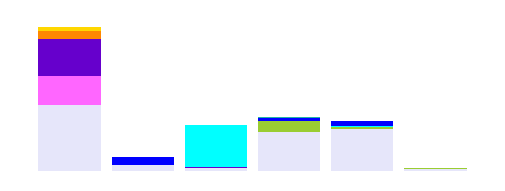

In [79]:
# Create a pie chart
D = tissue_cluster_sizes
plt.figure(figsize = (3,1))
ax = plt.gca()
D.plot.bar(stacked=True, color=metacell_colors, ax = ax, width = 0.85)
ax.legend_.remove()
plt.axis('off')

# SAVE FIGURE
figure_label = '_{}Distribution_PerCellType_{}_PathwayMerged_retainN_noaxis'.\
                format(meta,subset_type).replace('.','_')
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

In [80]:
tissue_cluster_sizes

Archetype_Soft_Cluster,0,1,2,3,4,5,6,7,8
Patient,,,,,,,,,
UM01,3426.0,1503.0,1872.0,0.0,0.0,419.0,7.0,203.0,6.0
UM02,297.0,4.0,1.0,4.0,0.0,2.0,398.0,11.0,3.0
UM03,179.0,1.0,1.0,1.0,2188.0,1.0,3.0,1.0,0.0
UM04,2007.0,1.0,2.0,573.0,1.0,1.0,131.0,30.0,34.0
UM05,2182.0,2.0,1.0,111.0,9.0,0.0,258.0,7.0,17.0
UM06,82.0,27.0,17.0,5.0,8.0,11.0,2.0,17.0,10.0


/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_Phenograph_ClassDistribution_PerCellType_TUMOR_PathwayMerged_fraction


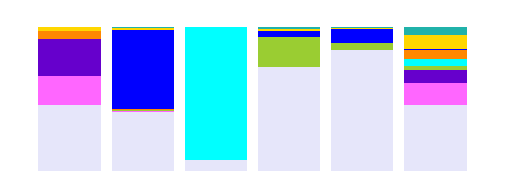

In [81]:
D = tissue_cluster_sizes
plt.figure(figsize = (3,1))
ax = plt.gca()
D.div(D.sum(axis=1),axis=0).plot.bar(stacked=True, color=metacell_colors, ax = ax, width = 0.85)
ax.legend_.remove()
plt.axis('off')

# SAVE FIGURE
figure_label = '_{}Distribution_PerCellType_{}_PathwayMerged_fraction'.format(meta,subset_type).replace('.','_')
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

In [82]:
D.div(D.sum(axis=1),axis=0)

Archetype_Soft_Cluster,0,1,2,3,4,5,6,7,8
Patient,,,,,,,,,
UM01,0.460732,0.202125,0.251748,0.000000,0.000000,0.056347,0.000941,0.027300,0.000807
UM02,0.412500,0.005556,0.001389,0.005556,0.000000,0.002778,0.552778,0.015278,0.004167
UM03,0.075368,0.000421,0.000421,0.000421,0.921263,0.000421,0.001263,0.000421,0.000000
UM04,0.721942,0.000360,0.000719,0.206115,0.000360,0.000360,0.047122,0.010791,0.012230
UM05,0.843448,0.000773,0.000387,0.042907,0.003479,0.000000,0.099729,0.002706,0.006571
UM06,0.458101,0.150838,0.094972,0.027933,0.044693,0.061453,0.011173,0.094972,0.055866


### REPRESENTATION OF EACH ARCHETYPE WITHIN EACH PATIENT

In [83]:
patient_fraction = np.log10(D.div(D.sum(axis=1),axis=0))

In [84]:
patient_fraction

Archetype_Soft_Cluster,0,1,2,3,4,5,6,7,8
Patient,,,,,,,,,
UM01,-0.336552,-0.694380,-0.599034,-inf,-inf,-1.249125,-3.026241,-1.563843,-3.093188
UM02,-0.384576,-2.255273,-2.857332,-2.255273,-inf,-2.556303,-0.257449,-1.815940,-2.380211
UM03,-1.122811,-3.375664,-3.375664,-3.375664,-0.035616,-3.375664,-2.898542,-3.375664,-inf
UM04,-0.141497,-3.444045,-3.143015,-0.685890,-3.444045,-3.444045,-1.326774,-1.966924,-1.912566
UM05,-0.073942,-3.111766,-3.412796,-1.367473,-2.458554,-inf,-1.001177,-2.567698,-2.182348
UM06,-0.339039,-0.821489,-1.022404,-1.553883,-1.349763,-1.211460,-1.951823,-1.022404,-1.252853


In [85]:
FLATUI_ARCHETYPES

['E6E6FA',
 'FF66FF',
 '6600CC',
 '9ACD32',
 '00FFFF',
 'FF8800',
 '0000FF',
 'FFD700',
 '20B2AA']

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGEDfraction_Archetype_Soft_Cluster_per_patient_ranked_size


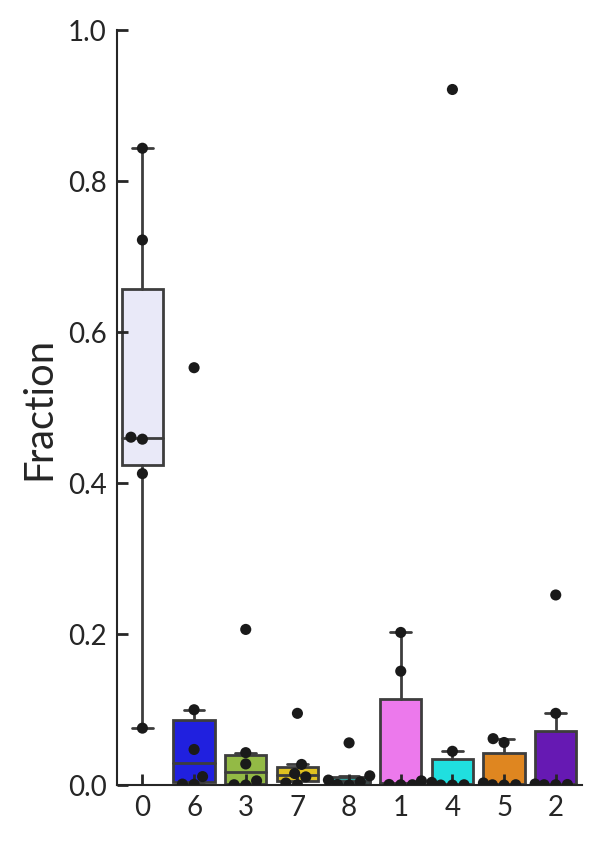

In [86]:
meta = 'Archetype_Soft_Cluster'
FLATUI_PLOT = FLATUI_ARCHETYPES

#meta = 'Nearest_Archetype'
#FLATUI_PLOT = FLATUI_NEAREST_ARCHETYPES

# Phenograph clusters
ind = META[meta].values
colors = np.zeros((len(FLATUI_PLOT),3))
for ii,hexcolor in enumerate(FLATUI_PLOT):
    colors[ii,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
# Palatte for Class METADATA
cix = (np.linspace(0,shape(colors)[0],len(np.unique(ind)))).astype(int)
if cix[len(cix)-1]==shape(colors)[0]:
    cix[len(cix)-1]=shape(colors)[0]-1
lut = dict(zip(np.unique(ind), colors[cix,:]))

exec('tissue_cluster_sizes = INDF_{}.groupby(level=[\'Patient\', \'{}\'], axis=0).size().unstack().fillna(0)'.format(subset_type,meta))
tissue_cluster_fraction = (tissue_cluster_sizes.div(tissue_cluster_sizes.sum(axis=1),axis =0))

#SCORE = tissue_cluster_fraction[cluster_rank]

violin_data = pd.DataFrame()
for class_name in tissue_cluster_fraction.columns:
    a = pd.DataFrame({'Archetype_Soft_Cluster':[class_name]*tissue_cluster_fraction.shape[0], 
             'Fraction':tissue_cluster_fraction[class_name].values,
             'Patient': tissue_cluster_fraction[class_name].index})
    violin_data = violin_data.append(a)

cluster_rank = violin_data.groupby('Archetype_Soft_Cluster').median().sort_values('Fraction',ascending = False).index#[0]+order

fig = plt.figure(figsize = (3,5))
ax = plt.gca()

# Plot violin plot
g = sns.boxplot(x='Archetype_Soft_Cluster', y="Fraction" ,data=violin_data,
                linewidth = 1, ax = ax, order = cluster_rank, notch = False,fliersize =1,
               palette = lut);
g.set_ylabel("{} Fraction per Patient".format(meta,fontsize=10))
g.set_xlabel(" ",fontsize=10,rotation = 90)
g.tick_params(labelsize=10)
sns.despine()

# Add in points to show each observation
sns.swarmplot(x='Archetype_Soft_Cluster', y="Fraction" ,data=violin_data,
              size=4, color="k", linewidth=0, order = cluster_rank, marker = 'o')

g.set_xlabel(" ",fontsize=10,rotation = 90)
plt.ylim((0,1))

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)
ax.spines['bottom'].set_linewidth(0.75)
ax.spines['left'].set_linewidth(0.75)


# SAVE FIGURE
figure_label = 'fraction_{}_per_patient_ranked_size'.format(meta)
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
print(fn)

In [87]:
violin_data.groupby(meta).mean().sort_values('Fraction',ascending = False)

,Fraction
Archetype_Soft_Cluster,
0,0.495349
4,0.161632
6,0.118835
1,0.060012
2,0.058273
3,0.047155
7,0.025245
5,0.020226
8,0.013274


### MULTI-SCALE DIFFUSION DISTANCE BETWEEN ARCHETYPES

In [88]:
diffusion_pairwise_distances.head()

Cell ID                                                                                                  1      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000000   
                         2       7                0         3                 0                       0.000129   
                         3       7                0         9                 0                       0.000074   
                         4       19               0         4                 0                       0.000178   
                         6       7                0         8                 0                       0.000102   

Cell ID                                                                                                  2      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000129   
                         2       7                0         3                 0                       0.000000   
                         3       7                0         9                 0                       0.000061   
                         4       19               0         4                 0                       0.000284   
                         6       7                0         8                 0                       0.000061   

Cell ID                                                                                                  3      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000074   
                         2       7                0         3                 0                       0.000061   
                         3       7                0         9                 0                       0.000000   
                         4       19               0         4                 0                       0.000242   
                         6       7                0         8                 0                       0.000069   

Cell ID                                                                                                  4      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000178   
                         2       7                0         3                 0                       0.000284   
                         3       7                0         9                 0                       0.000242   
                         4       19               0         4                 0                       0.000000   
                         6       7                0         8                 0                       0.000232   

Cell ID                                                                                                  6      \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell             
0         UM01A  UM01    1       7                0         9                 0                       0.000102   
                         2       7                0         3                 0                       0.000061   
                         3       7                0         9                 0                       0.000069   
                         4       19               0         4                 0                       0.000232   
                         6       7                0         8                 0                       0.000000   

Cell 

In [89]:
master_groupby = 'Archetype_Nearest_Cell'
ix = [ind for ind,name in enumerate(diffusion_pairwise_distances.index.names) if name==master_groupby][0]
distance_to_other_archetypes = pd.DataFrame()
for arch_ind in np.unique(diffusion_pairwise_distances.index.get_level_values(master_groupby))[1:]:
    vals = diffusion_pairwise_distances.loc[diffusion_pairwise_distances.index.map(lambda x: x[ix] in [arch_ind])]
    distance_to_other_archetypes = distance_to_other_archetypes.append(vals[cellid_archetype.astype(int)])

distance_to_other_archetypes = pd.DataFrame(index = \
                                            distance_to_other_archetypes.index.get_level_values(master_groupby), 
                                            data = \
                                            distance_to_other_archetypes.values,
                                            columns = \
                                            distance_to_other_archetypes.index.get_level_values(master_groupby))

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGEDdiffusion_distance_ongraph_btw_archetypes


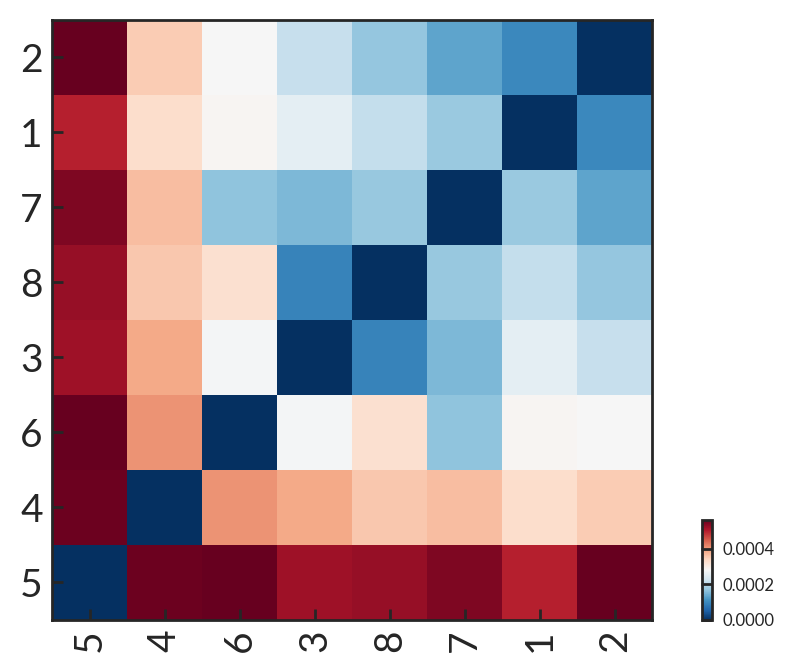

In [90]:
# Clustered heatmap of euclidean distance between archetypes
yticks = distance_to_other_archetypes.index
xticks = distance_to_other_archetypes.columns

# LINKAGE BASED ON NES OF SIGNIFICANT DIFFERENTIALLY EXPRESSED PATHWAYS
method = 'average'
metric = 'cosine'
linkage = hc.linkage(distance_to_other_archetypes, method=method, metric = metric)
row_linkage = deepcopy(linkage)
linkage = hc.linkage(distance_to_other_archetypes.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)

# REORDER HEATMAP ACCORDING TO LINKAGE (OPTIONAL, STILL SLOW)
r1 = hc.leaves_list(row_linkage)
cl = hc.leaves_list(col_linkage)
mat = distance_to_other_archetypes.iloc[r1,cl]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(5,5))
plt.rcParams["axes.grid"] = False

# ADD MATRIX WITH GENE NAMES
axmatrix = fig.add_axes([0.1,0.1,0.6,0.6])
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=plt.cm.RdBu_r)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 14)

labels = list(mat.index)
axmatrix.yaxis.set_ticks_position('left')
ytick = plt.yticks(range(len(labels)), labels, rotation = 0, fontsize = 14)

#axmatrix.set_yticklabels([]);

# ADD COLORBAR
axcolor = fig.add_axes([0.75,0.1,0.01,0.1])
cbar = plt.colorbar(im, cax=axcolor)
#cbar.ax.get_yaxis().set_ticks([])

# SAVE FIGURE
figure_label = 'diffusion_distance_ongraph_btw_archetypes'
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

In [91]:
distance_to_other_archetypes[4].sort_values().index

Int64Index([4, 1, 2, 8, 7, 3, 6, 5], dtype='int64', name='Archetype_Nearest_Cell')

In [92]:
distance_to_other_archetypes[5].sort_values().index

Int64Index([5, 1, 3, 8, 7, 4, 2, 6], dtype='int64', name='Archetype_Nearest_Cell')

In [93]:
distance_to_other_archetypes[3].sort_values().index

Int64Index([3, 8, 7, 2, 1, 6, 4, 5], dtype='int64', name='Archetype_Nearest_Cell')

### RANKED BOXPLOTS

In [94]:
# RANK BY DIFFUSION DISTANCE
order = distance_to_other_archetypes[4].sort_values().index
order = order.append(pd.Index([0])) 

In [95]:
order

Int64Index([4, 1, 2, 8, 7, 3, 6, 5, 0], dtype='int64')

In [96]:
genesets.columns

Index(['KEGG_NATURAL_KILLER_CELL_MEDIATED_CYTOTOXICITY',
       'LEE_NEURAL_CREST_STEM_CELL_UP', 'LEE_NEURAL_CREST_STEM_CELL_DN',
       'GO_NEURAL_CREST_CELL_DIFFERENTIATION', 'GO_NEURAL_TUBE_DEVELOPMENT',
       'Monosomy 3 Up', 'Monosomy 3 Down', 'Castle 2', 'Castle 1',
       'Class 1 Onken v2', 'Class 2 Onken v2', 'EHLERS_ANEUPLOIDY_UP',
       'EHLERS_ANEUPLOIDY_DN', 'GO_PCG_PROTEIN_COMPLEX',
       'DOUGLAS_BMI1_TARGETS_UP', 'DOUGLAS_BMI1_TARGETS_DN',
       'BENPORATH_PRC2_TARGETS', 'WIEDERSCHAIN_TARGETS_OF_BMI1_AND_PCGF2',
       'BENPORATH_SUZ12_TARGETS', 'BENPORATH_EED_TARGETS', 'BMI1_DN.V1_DN',
       'BMI1_DN.V1_UP', 'BMI1_DN_MEL18_DN.V1_DN', 'BMI1_DN_MEL18_DN.V1_UP',
       'GO_CHROMATIN_BINDING', 'GO_CHROMATIN_MODIFICATION',
       'GO_CHROMATIN_ORGANIZATION', 'GO_CHROMOSOME_ORGANIZATION',
       'GO_HISTONE_H2A_MONOUBIQUITINATION', 'GO_HISTONE_H2A_UBIQUITINATION',
       'GO_HISTONE_MONOUBIQUITINATION', 'GO_HISTONE_UBIQUITINATION',
       'GO_NUCLEAR_UBIQUITIN_LIGASE_CO

In [97]:
meta = 'Archetype_Soft_Cluster'

FLATUI_ARCHETYPES = [
                 'E6E6FA', # not assgined
                 'FF66FF', # pink
                 '6600CC', # purple
                 '9ACD32', # Green
                 '00FFFF', # skye blue
                 'FF8800', # orange
                 '0000FF', # dark blue
                 'FFD700', # yellow
                 '20B2AA', # teal
                 #'008000', # forest green
                 #'8B008B'
    ]

FLATUI_PLOT = FLATUI_ARCHETYPES

In [98]:
plot_genes = ['TMEM173', 'BAP1', 'JARID2', 'RING1', 'MYC','PRAME', 'JUN','CDH1', 'VIM', 'TYR', 
              'TYRP1','MLANA', 'PMEL', 'DCT','ASCL1', 'SOX10', 'CHD7', 'FOXD3', 'PAX3', 'NUMB',
              'SNAI1','SNAI2','NEUROG2','HLA-A','HLA-B','HLA-C', 'B2M', 'HLA-G', 'ABCG1','PPARG',
              'DDIT3','NUPR1','RAB3B','IGFBP4','LRRC8C','TCP11L2','MAFK','NRG1','F2R','KRT19','CTGF','ZFC3H1']

In [99]:
# INDIVIDUAL GENE EXPRESSION
meta = 'Archetype_Soft_Cluster'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

# Meta-Grouping
exec('ind = METADATA_{}[meta].values'.format(subset_type))
colors = np.zeros((len(FLATUI_PLOT),3))
for ii,hexcolor in enumerate(FLATUI_PLOT):
    colors[ii,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)

cix = (np.linspace(0,shape(colors)[0],len(np.unique(ind)))).astype(int)
if cix[len(cix)-1]==shape(colors)[0]:
    cix[len(cix)-1]=shape(colors)[0]-1
palette = dict(zip(np.unique(ind), colors[cix,:]))

for title in plot_genes: # PLOT INDIVIDUAL GENES
#for title in genesets:  # PLOT MEDIAN EXPRESSION OF PATHWAY
    
    # PLOT INDIVIDUAL GENES
    genes = [title]
    
    # PLOT MEDIAN EXPRESSION OF SIGNATURE
    #genes = genesets[title].values
    
    genes = np.unique([x for x in genes if str(x) != 'NAN'])
    detected_genes = list(set(genes).intersection(set(QUERY.columns)))
    vals = QUERY[detected_genes]
    SCORE = np.nanmedian(vals,axis=1)
    
    # Format data structure for violin plot
    violin_data = []
    for ind,v in enumerate(SCORE):
        violin_data.append({'gene': title, 'Z-normalized Expression': v,meta:META[meta].values[ind]}) 
    violin_data = pd.DataFrame(violin_data)
    
    # DENSITY PLOT
    fig = plt.figure(figsize = (10,3))
    gs1 = gridspec.GridSpec(2, 2)
    gs1.update(wspace=0.2, hspace=0) # set the spacing between axes. 

    # BGEP RANKED ARPLOTS
    ax_barplot = plt.subplot(gs1[:, 0])
    g = sns.boxplot(x="gene", y="Z-normalized Expression", hue=meta,data=violin_data, palette=palette,
                    notch = True, fliersize = 2, showmeans=False,linewidth = 1, hue_order = order, 
                    showfliers=True, whis = 0.95) 
    g.set_ylabel("{} {}".format(genes[0],datatype),fontsize=10)
    g.set_xlabel(" ",fontsize=10,rotation = 90)
    g.tick_params(labelsize=10)
    ax_barplot.legend_.remove()
    vs = violin_data.iloc[[ind for ind,val in enumerate(violin_data[meta]) if val in order]]['Z-normalized Expression']
    ax_barplot.set(ylim=(vs.min()*0.9, vs.max()*0.95))
    ax_barplot.spines['right'].set_visible(False)
    ax_barplot.spines['top'].set_visible(False)
    ax_barplot.spines['bottom'].set_visible(True)
    ax_barplot.spines['left'].set_visible(True)
    ax_barplot.spines['bottom'].set_linewidth(0.75)
    ax_barplot.spines['left'].set_linewidth(0.75)

    ax1 = plt.subplot(gs1[0, 1])
    ax1.spines['right'].set_visible(False)
    ax1.spines['top'].set_visible(False)
    ax1.spines['bottom'].set_visible(True)
    ax1.spines['left'].set_visible(True)
    ax1.spines['bottom'].set_linewidth(0.75)
    ax1.spines['left'].set_linewidth(0.75)
    bool_array = [val in order for val in violin_data[meta]]
    bins = np.linspace(violin_data['Z-normalized Expression'][bool_array].min(), \
                       violin_data['Z-normalized Expression'][bool_array].max()*0.90, 100)
    for archetype_ind in order:
        vals = violin_data[violin_data[meta]==archetype_ind]['Z-normalized Expression']
        plt.hist(vals,bins,density = False, alpha=0.75,color = palette[archetype_ind])
        plt.tick_params(labelsize=10)
        plt.xticks([])

    archetype_ind = 0
    vals = violin_data[violin_data[meta]==archetype_ind]['Z-normalized Expression']
    ax2 = plt.subplot(gs1[1, 1])
    plt.hist(vals,bins,density = False, alpha=1,color = palette[archetype_ind])
    ax2.set_ylim(ax2.get_ylim()[::-1])
    ax2.spines['right'].set_visible(False)
    ax2.spines['top'].set_visible(True)
    ax2.spines['bottom'].set_visible(False)
    ax2.spines['left'].set_visible(True)
    ax2.spines['top'].set_linewidth(0.75)
    ax2.spines['left'].set_linewidth(0.75)

    plt.xticks(rotation=70)
    plt.tick_params(labelsize=10)
    
    # SAVE FIGURE
    figure_label = '_{}_{}PLOT_{}_{}_{}'.format(subset_type, plot_type,datatype,meta,title)
    fn = FIG_output_stem + 'BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY/{}'.format(meta) + FN.replace(".h5", "") + \
    figure_label
    fn = fn.replace(' ','_')
    
    # CREATE GSEA DIRECTORY IF IT DOES NOT EXIST
    d = os.path.dirname(fn)
    if not os.path.exists(d):
        os.makedirs(d)
        
    plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
    #plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
    print(fn)
    
    # Close Figure
    plt.close(fig)

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_TMEM173
/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_BAP1
/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_JARID2
/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_RING1
/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_MYC
/workdir/uvmel_project/figures/UVMEL_MERGED_A

### NK CELL HETEROGENEITY

In [100]:
# Phenograph Cluster 19 = NK/NKT
exec('INDF_{} = h5_data.load(\'/INDF_{}\')'.format('ALL','ALL'))
groupby_type = 'Phenograph_Class'
exec('tissue_cluster_sizes = INDF_ALL.groupby(level=[\'Patient\', \'{}\'], axis=0).size().unstack().fillna(0)'.\
     format(groupby_type))
fraction_cell_detected = tissue_cluster_sizes.div(tissue_cluster_sizes.sum(axis=1),axis=0)
NK_CELL_FRACTION = fraction_cell_detected[19]

In [101]:
NK_CELL_FRACTION

Patient
1    0.010741
2    0.085427
3    0.000000
4    0.036480
5    0.026637
6    0.363914
Name: 19, dtype: float64

In [102]:
mat2 = pd.DataFrame(index = NK_CELL_FRACTION.index, columns = ['NK FRACTION'],data = (NK_CELL_FRACTION.values))

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGEDNK_NKT_FRACTION


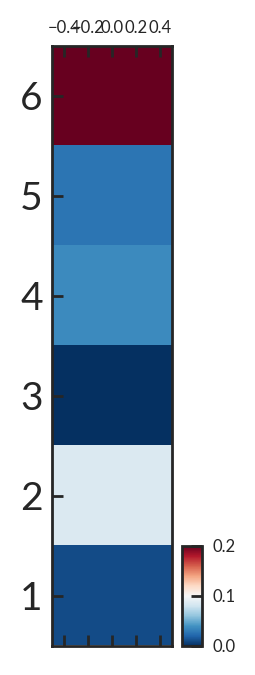

In [103]:
# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(1,5))
plt.rcParams["axes.grid"] = False

# ADD MATRIX WITH GENE NAMES
axmatrix = fig.add_axes([0.1,0.1,0.6,0.6])
im = axmatrix.matshow(mat2, aspect='auto', origin='lower', cmap=plt.cm.RdBu_r, vmin = 0, vmax = 0.2)

labels = list(mat2.index)
axmatrix.yaxis.set_ticks_position('left')
ytick = plt.yticks(range(len(labels)), labels, rotation = 0, fontsize = 14)

#axmatrix.set_yticklabels([]);

# ADD COLORBAR
axcolor = fig.add_axes([0.75,0.1,0.1,0.1])
cbar = plt.colorbar(im, cax=axcolor)
#cbar.ax.get_yaxis().set_ticks([])

# SAVE FIGURE
figure_label = 'NK_NKT_FRACTION'
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

In [104]:
# Fraction of each tumor cel archetype
groupby_type = 'Archetype_Soft_Cluster'
exec('tissue_cluster_sizes = QUERY.groupby(level=[\'Patient\', \'{}\'], axis=0).size().unstack().fillna(0)'.format(groupby_type))
fraction_cell_detected = tissue_cluster_sizes.div(tissue_cluster_sizes.sum(axis=1),axis=0)
fraction_cell_detected

Archetype_Soft_Cluster,0,1,2,3,4,5,6,7,8
Patient,,,,,,,,,
UM01,0.460732,0.202125,0.251748,0.000000,0.000000,0.056347,0.000941,0.027300,0.000807
UM02,0.412500,0.005556,0.001389,0.005556,0.000000,0.002778,0.552778,0.015278,0.004167
UM03,0.075368,0.000421,0.000421,0.000421,0.921263,0.000421,0.001263,0.000421,0.000000
UM04,0.721942,0.000360,0.000719,0.206115,0.000360,0.000360,0.047122,0.010791,0.012230
UM05,0.843448,0.000773,0.000387,0.042907,0.003479,0.000000,0.099729,0.002706,0.006571
UM06,0.458101,0.150838,0.094972,0.027933,0.044693,0.061453,0.011173,0.094972,0.055866


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Archetype4 vs NK/NKT Abundance, R: -0.8963521726313708, p: 0.03942795758835365
Archetype1 vs NK/NKT Abundance, R: 0.0773074983628676, p: 0.9016671686728508
Archetype2 vs NK/NKT Abundance, R: -0.03782772774190219, p: 0.9518477301689297
Archetype8 vs NK/NKT Abundance, R: 0.8172670046423546, p: 0.09115530572757471
Archetype7 vs NK/NKT Abundance, R: 0.6685372011801503, p: 0.2173288645479778
Archetype3 vs NK/NKT Abundance, R: 0.5671630248879111, p: 0.31870493290102403
Archetype6 vs NK/NKT Abundance, R: 0.8324031932197403, p: 0.08026045171661646
Archetype5 vs NK/NKT Abundance, R: 0.024026294412583613, p: 0.9694117152918067
Archetype0 vs NK/NKT Abundance, R: 0.8435619999232808, p: 0.07250773368535804


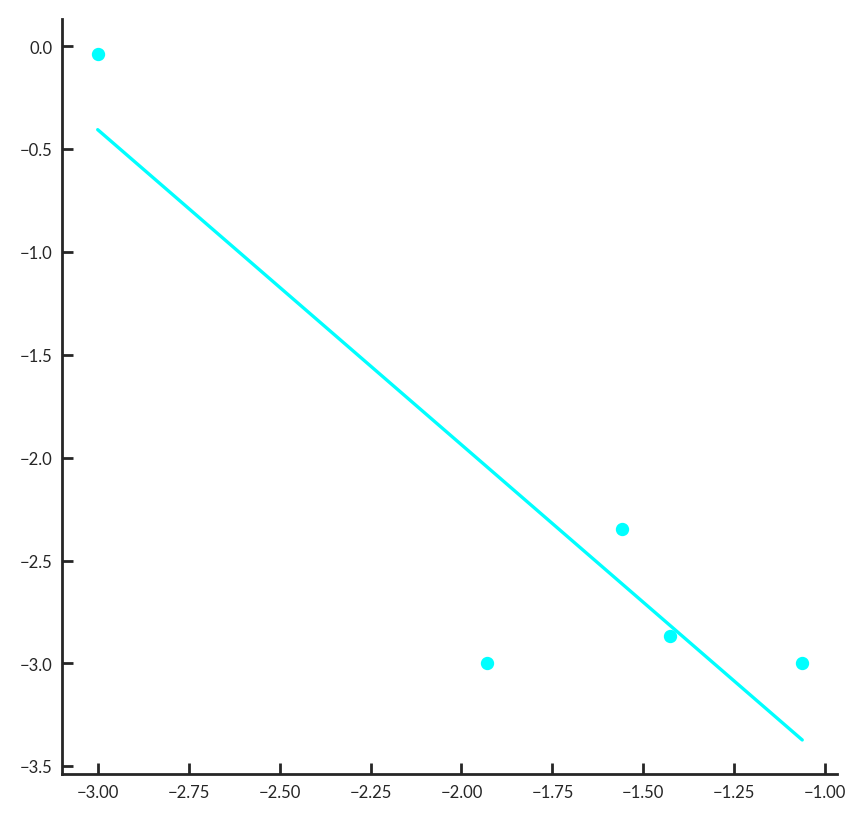

In [105]:
plt.figure(figsize = (5,5))
ax = plt.gca()
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

x = np.log10(NK_CELL_FRACTION+0.001)[:5]

for arch_ind in order:
    y = np.log10(fraction_cell_detected[arch_ind]+0.001)[:5]
     
    #(r, p) = stats.pearsonr(x, y)
    (slope, intercept, r, p, std_err) = stats.linregress(x,y)
    print('Archetype{} vs NK/NKT Abundance, R: {}, p: {}'.format(arch_ind,r,p))
    
    xi =np.linspace(x.min(),x.max(),20)
    yi = slope*xi+intercept
    
    if p < 0.05:
        plt.scatter(x,y,c = palette[arch_ind])
        plt.plot(xi,yi,c = palette[arch_ind])

###### SAVE TO DATAFRAME

In [106]:
subset_type = 'TUMOR'

# WRITE RANKED GENE LIST TO H5
exec('h5_data.save(DF_{}, \'DF_{}\')'.format(subset_type,subset_type)) # update directory
exec('h5_data.save(NDF_{}, \'NDF_{}\')'.format(subset_type,subset_type)) # update directory
exec('h5_data.save(INDF_{}, \'INDF_{}\')'.format(subset_type,subset_type)) # update directory
exec('h5_data.save(METADATA_{}, \'METADATA_{}\')'.format(subset_type,subset_type)) # update directory
exec('h5_data.save(DIMENSIONS_{}, \'DIMENSIONS_{}\')'.format(subset_type,subset_type)) # update directory
h5_data.ls() # list contents of directory

['/ARCHETYPE_DISTANCES_TUMOR', '/CNVt', '/CNVt_ALL', '/DF_ALL', '/DF_IMMUNE', '/DF_MACROPHAGE', '/DF_TUMOR', '/DIMENSIONS_ALL', '/DIMENSIONS_IMMUNE', '/DIMENSIONS_MACROPHAGE', '/DIMENSIONS_TUMOR', '/EMD_RANK_NEAREST_ARCHETYPE_TUMOR', '/EMD_RANK_TUMOR', '/GENE_RANK_ARCHETYPE_SOFT_CLUSTER_TUMOR', '/GENE_RANK_ARCHETYPE_TUMOR', '/GENE_RANK_MACROPHAGE', '/GENE_RANK_MAST_ALL', '/GENE_RANK_MAST_IMMUNE', '/GENE_RANK_MAST_TUMOR', '/GENE_RANK_NEAREST_ARCHETYPE_TUMOR', '/INDF_ALL', '/INDF_IMMUNE', '/INDF_MACROPHAGE', '/INDF_TUMOR', '/METADATA_ALL', '/METADATA_HARBOUR', '/METADATA_HARBOUR_PRIMARY', '/METADATA_IMMUNE', '/METADATA_MACROPHAGE', '/METADATA_TUMOR', '/NDF_ALL', '/NDF_IMMUNE', '/NDF_MACROPHAGE', '/NDF_TUMOR']
<class 'pandas.io.pytables.HDFStore'>
File path: /workdir/uvmel_project/data/UVMEL_MERGED.h5



In [107]:
METADATA_TUMOR.head()

Legend  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype          
0         UM01A  UM01    1       7                0         9                 0                      0                      1                  UM01A   
                         2       7                0         3                 0                      0                      1                  UM01A   
                         3       7                0         9                 0                      0                      1                  UM01A   
                         4       19               0         4                 0                      0                      2                  UM01A   
                         6       7                0         8                 0                      0                      1                  UM01A   

                                                                                                                                              libsize  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype           
0         UM01A  UM01    1       7                0         9                 0                      0                      1                    2793   
                         2       7                0         3                 0                      0                      1                    1920   
                         3       7                0         9                 0                      0                      1                    1874   
                         4       19               0         4                 0                      0                      2                    1903   
                         6       7                0         8                 0                      0                      1                    2349   

                                                                                                                                              mt_fraction  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype               
0         UM01A  UM01    1       7                0         9                 0                      0                      1                    0.113856   
                         2       7                0         3                 0                      0                      1                   0.0838542   
                         3       7                0         9                 0                      0                      1                   0.0533618   
                         4       19               0         4                 0                      0                      2                    0.140305   
                         6       7                0         8                 0                      0                      1                    0.174542   

                                                                                                                                              Stage  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype         
0         UM01A  UM01    1       7                0         9                 0                      0                      1                     2   
                         2       7                0         3                 0                      0                      1                     2   
                         3       7                0         9                 0                      0                      1                     2   
                         4       19               0         4                 0                      0                      2                     2   

## INTRA-PATIENT HETEROGENEITY

### ARCHETYPE DISTRIBUTION PER PATIENT

In [108]:
subset_type

'TUMOR'

In [109]:
groupby_type = 'Nearest_Archetype' # specify grouping
cm_flatui = FLATUI_ARCHETYPES[1:] # specify colormap for grouping

datatype = 'METADATA_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))


exec('tissue_cluster_sizes = \
     META.groupby(level=[\'Patient\', \'{}\'], axis=0).size().unstack().fillna(0)'.format(groupby_type))

# PRINT NUMBER OF CELLS PER META-CELL TYPE
print(tissue_cluster_sizes.sum(axis=0))
print('\n')
print(tissue_cluster_sizes.sum(axis=0).sum())
# PRINT NUMBER OF CELLS PER PATIENT
print(tissue_cluster_sizes.sum(axis=1))

# CONVERT HEX TO RGB (FLATUI_CLASS)
colors = np.zeros((len(cm_flatui),3))
for ii,hexcolor in enumerate(cm_flatui):
    colors[ii,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
metacell_colors = [rgb2hex(int(color[0]*255), int(color[1]*255), int(color[2]*255)) for color in colors]

Nearest_Archetype
1    2880.0
2    3184.0
3    2278.0
4    2269.0
5     531.0
6    1286.0
7    1863.0
8    1786.0
dtype: float64


16077.0
Patient
UM01    7436.0
UM02     720.0
UM03    2375.0
UM04    2780.0
UM05    2587.0
UM06     179.0
dtype: float64


In [110]:
tissue_cluster_sizes

Nearest_Archetype,1,2,3,4,5,6,7,8
Patient,,,,,,,,
UM01,2822.0,3139.0,4.0,0.0,503.0,10.0,524.0,434.0
UM02,6.0,6.0,20.0,0.0,6.0,610.0,63.0,9.0
UM03,6.0,2.0,13.0,2247.0,1.0,8.0,59.0,39.0
UM04,5.0,5.0,1495.0,1.0,1.0,214.0,583.0,476.0
UM05,3.0,3.0,730.0,13.0,2.0,442.0,603.0,791.0
UM06,38.0,29.0,16.0,8.0,18.0,2.0,31.0,37.0


In [111]:
tissue_cluster_sizes.div(tissue_cluster_sizes.sum(axis=1),axis=0)

Nearest_Archetype,1,2,3,4,5,6,7,8
Patient,,,,,,,,
UM01,0.379505,0.422136,0.000538,0.000000,0.067644,0.001345,0.070468,0.058365
UM02,0.008333,0.008333,0.027778,0.000000,0.008333,0.847222,0.087500,0.012500
UM03,0.002526,0.000842,0.005474,0.946105,0.000421,0.003368,0.024842,0.016421
UM04,0.001799,0.001799,0.537770,0.000360,0.000360,0.076978,0.209712,0.171223
UM05,0.001160,0.001160,0.282180,0.005025,0.000773,0.170854,0.233089,0.305760
UM06,0.212291,0.162011,0.089385,0.044693,0.100559,0.011173,0.173184,0.206704


/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_Archetype_Soft_ClusterDistribution_PerCellType_TUMOR_PathwayMerged_fraction


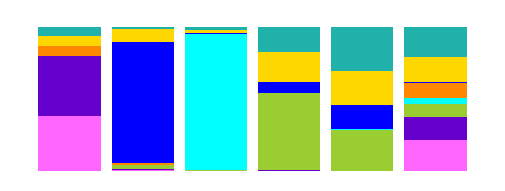

In [112]:
D = tissue_cluster_sizes
plt.figure(figsize = (3,1))
ax = plt.gca()
D.div(D.sum(axis=1),axis=0).plot.bar(stacked=True, color=metacell_colors, ax = ax, width = 0.85)
ax.legend_.remove()
plt.axis('off')

# SAVE FIGURE
figure_label = '_{}Distribution_PerCellType_{}_PathwayMerged_fraction'.format(meta,subset_type).replace('.','_')
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

In [113]:
metacell_colors

['#ff66ff',
 '#6600cc',
 '#9acd32',
 '#00ffff',
 '#ff8800',
 '#0000ff',
 '#ffd700',
 '#20b2aa']

### RANKED BOXPLOT PER PATIENT

In [114]:
# INDIVIDUAL GENE EXPRESSION
meta = 'Archetype_Soft_Cluster'#'Nearest_Archetype'
FLATUI_PLOT = FLATUI_ARCHETYPES#FLATUI_ARCHETYPES[1:]

#meta = 'Nearest_Archetype'
#FLATUI_PLOT = FLATUI_ARCHETYPES[1:]

patient_ind = 'UM02'
subset_key = 'Patient'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

# Meta-Grouping
ind = META[meta].values
colors = np.zeros((len(FLATUI_PLOT),3))
for ii,hexcolor in enumerate(FLATUI_PLOT):
    colors[ii,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)

cix = (np.linspace(0,shape(colors)[0],len(np.unique(ind)))).astype(int)
if cix[len(cix)-1]==shape(colors)[0]:
    cix[len(cix)-1]=shape(colors)[0]-1
palette = dict(zip(np.unique(ind), colors[cix,:]))

# SUBSET  PATIENT
ix = [ind for ind, name in enumerate(QUERY.index.names) if name==subset_key][0]
QUERY = QUERY.loc[QUERY.index.map(lambda x: x[ix] in [patient_ind])]
META = META.loc[META.index.map(lambda x: x[ix] in [patient_ind])]

ind = META[meta].values

new_order = [o for o in order if o in np.unique(META[meta])]

#for title in plot_genes: # LOT INDIVIDUAL GENES
for title in genesets: # PLOT MEDIAN EXPRESSION OF PATHWAY
    
    # PLOT INDIVIDUAL GENES
    #genes = [title]
    
    # PLOT MEDIAN EXPRESSION OF SIGNATURE
    genes = genesets[title].values
    
    genes = np.unique([x for x in genes if str(x) != 'NAN'])
    detected_genes = list(set(genes).intersection(set(QUERY.columns)))
    vals = QUERY[detected_genes]
    SCORE = np.nanmedian(vals,axis=1)
    
    # Format data structure for violin plot
    violin_data = []
    for ind,v in enumerate(SCORE):
        violin_data.append({'gene': title, 'Z-normalized Expression': v,meta:META[meta].values[ind]}) 
    violin_data = pd.DataFrame(violin_data)
    
    # DENSITY PLOT
    fig = plt.figure(figsize = (10,3))
    gs1 = gridspec.GridSpec(2, 2)
    gs1.update(wspace=0.2, hspace=0) # set the spacing between axes. 

    # BGEP RANKED ARPLOTS
    ax_barplot = plt.subplot(gs1[:, 0])
    g = sns.boxplot(x="gene", y="Z-normalized Expression", hue=meta, data=violin_data, palette=palette,
                    notch = False, fliersize = 2, showmeans=False,linewidth = 1, 
                    hue_order = new_order, 
                    showfliers=True, whis = 0.95) 
    g.set_ylabel("{} {}".format(genes[0],datatype),fontsize=10)
    g.set_xlabel(" ",fontsize=10,rotation = 90)
    g.tick_params(labelsize=10)
    ax_barplot.legend_.remove()
    vs = violin_data.iloc[[ind for ind,val in enumerate(violin_data[meta]) 
                           if val in order]]['Z-normalized Expression']
    ax_barplot.set(ylim=(vs.min()*0.9, vs.max()*0.95))
    ax_barplot.spines['right'].set_visible(False)
    ax_barplot.spines['top'].set_visible(False)
    ax_barplot.spines['bottom'].set_visible(True)
    ax_barplot.spines['left'].set_visible(True)
    ax_barplot.spines['bottom'].set_linewidth(0.75)
    ax_barplot.spines['left'].set_linewidth(0.75)

    ax1 = plt.subplot(gs1[0, 1])
    ax1.spines['right'].set_visible(False)
    ax1.spines['top'].set_visible(False)
    ax1.spines['bottom'].set_visible(True)
    ax1.spines['left'].set_visible(True)
    ax1.spines['bottom'].set_linewidth(0.75)
    ax1.spines['left'].set_linewidth(0.75)
    bool_array = [val in order for val in violin_data[meta]]
    bins = np.linspace(violin_data['Z-normalized Expression'][bool_array].min(), 
                       violin_data['Z-normalized Expression'][bool_array].max()*0.90, 100)#
    for archetype_ind in new_order:
        vals = violin_data[violin_data[meta]==archetype_ind]['Z-normalized Expression']
        plt.hist(vals,bins,density = False, alpha=0.75,color = palette[archetype_ind])
        plt.tick_params(labelsize=10)
        plt.xticks([])
    
    if (violin_data[meta]==0).sum()>0:
        archetype_ind = 0
        vals = violin_data[violin_data[meta]==archetype_ind]['Z-normalized Expression']
        ax2 = plt.subplot(gs1[1, 1])
        plt.hist(vals,bins,density =  False, alpha=1,color = palette[archetype_ind])
        ax2.set_ylim(ax1.get_ylim()[::-1])
        ax2.spines['right'].set_visible(False)
        ax2.spines['top'].set_visible(True)
        ax2.spines['bottom'].set_visible(False)
        ax2.spines['left'].set_visible(True)
        ax2.spines['top'].set_linewidth(0.75)
        ax2.spines['left'].set_linewidth(0.75)

    plt.xticks(rotation=70)
    plt.tick_params(labelsize=10)
    
    # SAVE FIGURE
    figure_label = '_{}_{}PLOT_{}_{}_{}_Patient{}'.format(subset_type, plot_type,datatype,meta,title,patient_ind)
    fn = FIG_output_stem + 'BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY_PATIENT{}/{}'.format(patient_ind,meta) + \
         FN.replace(".h5", "") + figure_label
    fn = fn.replace(' ','_')
    
    # CREATE GSEA DIRECTORY IF IT DOES NOT EXIST
    d = os.path.dirname(fn)
    if not os.path.exists(d):
        os.makedirs(d)
        
    plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
    #plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
    print(fn)
    
    # Close Figure
    plt.close(fig)

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY_PATIENTUM02/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_KEGG_NATURAL_KILLER_CELL_MEDIATED_CYTOTOXICITY_PatientUM02
/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY_PATIENTUM02/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_LEE_NEURAL_CREST_STEM_CELL_UP_PatientUM02
/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY_PATIENTUM02/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_LEE_NEURAL_CREST_STEM_CELL_DN_PatientUM02
/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY_PATIENTUM02/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_GO_NEURAL_CREST_CELL_DIFFERENTIATION_PatientUM02
/workdir/uvmel_proje

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY_PATIENTUM02/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_GO_PROTEIN_UBIQUITINATION_PatientUM02
/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY_PATIENTUM02/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_GO_UBIQUITIN_LIGASE_COMPLEX_PatientUM02
/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY_PATIENTUM02/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_STEGMEIER_PREMITOTIC_CELL_CYCLE_REGULATORS_PatientUM02
/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/BOXPLOTS_RANKED_MEDIAN_GEP2_NODENSITY_PATIENTUM02/Archetype_Soft_ClusterUVMEL_MERGED_TUMOR_boxPLOT_INDF_TUMOR_Archetype_Soft_Cluster_GO_HISTONE_H2A_ACETYLATION_PatientUM02
/workdir/uvmel_project/figures/UVMEL_MER

In [115]:
(violin_data[meta]==0).sum()

297

### RECREATING MIXTURE MODEL

#### MIXTURE MODEL FOR TCGA CLASSIFICATION

In [116]:
TCGA_CLASS_LIST = ['TCGA1', 'TCGA2', 'TCGA3', 'TCGA4']

In [117]:
# Make the TCGA marker_file dataframe containing the signature genes for each TCGA subtype:

TCGA_markerfile_df = pd.DataFrame()

TCGA_markerfile_df['TCGA1'] = [1 for x in range(15)] + [0 for x in range(45)]
TCGA_markerfile_df['TCGA2'] = [0 for x in range(15)] + [1 for x in range(15)] + [0 for x in range(30)]
TCGA_markerfile_df['TCGA3'] = [0 for x in range(30)] + [1 for x in range(15)] + [0 for x in range(15)]
TCGA_markerfile_df['TCGA4'] = [0 for x in range(45)] + [1 for x in range(15)]

TCGA_markerfile_df.index = ['PCDH20', 'CNTN3', 'CCDC68', 'ZNF204P', 'STXBP5L', 'PDE3A', 'ZNF883', 'CHL1', 'SLC25A27', 
                            'ZNF702P', 'ZNF667', 'ZNF391', 'KYNU', 'MPPED2', 'PCDHA13', 'PYY', 'CRYBB2', 'EYA2', 
                            'ERVFRDE1', 'MYO7B', 'LOC643719', 'C20orf26', 'DLL3', 'RHCG', 'COX6A2', 'SOSTDC1', 
                            'TMEM151A', 'FXYD1', 'LOC441869', 'LOC100188947', 'SSX5', 'C1orf116', 'GSG1L', 'VTN', 
                            'COL9A3', 'AMN', 'DYSF', 'NECAB2', 'CDH4', 'ADAM11', 'CAMK1G', 'NXPH4', 'NPAS1', 'SUSD2', 
                            'BAI1', 'CXCL13', 'RIMS2', 'KCNV2', 'GAD1', 'IDO1', 'GBP1', 'UBD', 'JAKMIP1', 
                            'SH2D1A', 'CXCL9', 'COL22A1', 'GBP5', 'TM7SF4', 'LOC96610', 'TIGIT']

In [118]:
# WORKING WITH TUMOR SUBSET:
subset_type = 'TUMOR'

# WORKING WITH IMPUTED NORMALIZED DATA:
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

# Get imputed normalized gene expression means for each TCGA subtype:

gene1 = 'TCGA1'
signature_genes = TCGA_markerfile_df.loc[TCGA_markerfile_df[gene1] == 1].index.values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals1 = (np.nanmean(QUERY[detected_genes],axis=1))

gene2 = 'TCGA2'
signature_genes = TCGA_markerfile_df.loc[TCGA_markerfile_df[gene2] == 1].index.values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals2 = (np.nanmean(QUERY[detected_genes],axis=1))

gene3 = 'TCGA3'
signature_genes = TCGA_markerfile_df.loc[TCGA_markerfile_df[gene3] == 1].index.values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals3 = (np.nanmean(QUERY[detected_genes],axis=1))

gene4 = 'TCGA4'
signature_genes = TCGA_markerfile_df.loc[TCGA_markerfile_df[gene4] == 1].index.values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals4 = (np.nanmean(QUERY[detected_genes],axis=1))

X = pd.DataFrame(data = {gene1: vals1, gene2: vals2, gene3: vals3, gene4: vals4}, index = QUERY.index)

In [119]:
X.head()

TCGA1  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype             
0         UM01A  UM01    1       7                0         9                 0                      0                      1                  0.282600   
                         2       7                0         3                 0                      0                      1                  0.231038   
                         3       7                0         9                 0                      0                      1                  0.084577   
                         4       19               0         4                 0                      0                      2                  0.074325   
                         6       7                0         8                 0                      0                      1                  0.218464   

                                                                                                                                                  TCGA2  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype             
0         UM01A  UM01    1       7                0         9                 0                      0                      1                  0.225400   
                         2       7                0         3                 0                      0                      1                  0.098043   
                         3       7                0         9                 0                      0                      1                  0.151876   
                         4       19               0         4                 0                      0                      2                  0.226464   
                         6       7                0         8                 0                      0                      1                  0.243683   

                                                                                                                                                  TCGA3  \
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype             
0         UM01A  UM01    1       7                0         9                 0                      0                      1                  0.930931   
                         2       7                0         3                 0                      0                      1                  0.566187   
                         3       7                0         9                 0                      0                      1                  0.957583   
                         4       19               0         4                 0                      0                      2                  1.210087   
                         6       7                0         8                 0                      0                      1                  0.994388   

                                                                                                                                                  TCGA4  
Sample ID Legend Patient Cell ID Phenograph_Class Archetype Nearest Archetype Archetype_Nearest_Cell Archetype_Soft_Cluster Nearest_Archetype            
0         UM01A  UM01    1       7                0         9                 0                      0                      1                  0.406450  
                         2       7                0         3                 0                      0                      1                  0.331625  
                         3       7                0         9                 0                      0                      1                  0.490584  
                         4       19               0         4                 0                      0                

###### RUN BGMM MODEL

In [120]:
# Fit BGMM using dataframe X:
bgmm = BayesianGaussianMixture(covariance_type='spherical', n_components=4, random_state=1)
bgmm.fit(X[['TCGA1','TCGA2','TCGA3','TCGA4']])

# Predict TCGA classification for each cell:
clusters = bgmm.predict(X[['TCGA1','TCGA2','TCGA3','TCGA4']])

# Use T-SNE to visualize cell classifications:
X_embedded = manifold.TSNE(n_components=2, random_state=34).fit_transform(X[['TCGA1','TCGA2','TCGA3','TCGA4']])
X['tsne1'] = X_embedded[:,0]
X['tsne2'] = X_embedded[:,1]

X['Assignment'] = clusters

/workdir/uvmel_project/figures/final_figures_10_27_20/MSK_BayesianGMM_TCGA


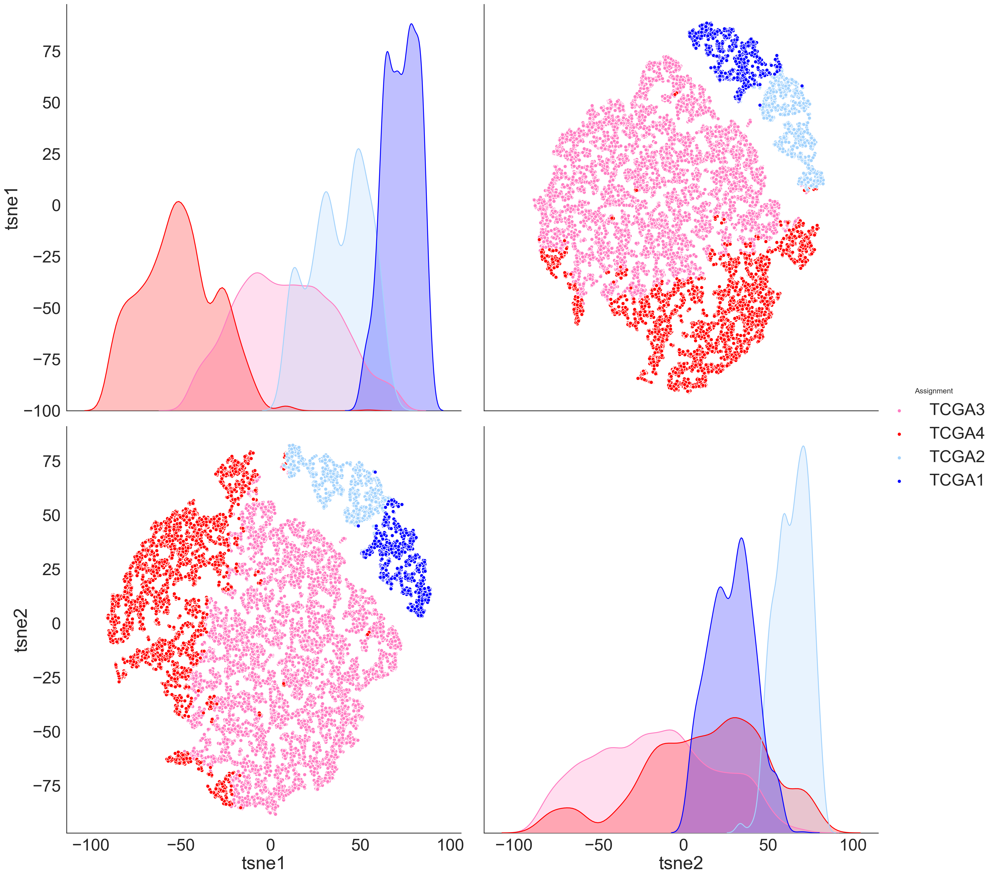

In [121]:
# Make Class Assignments
lut ={}
mean_array = []
for ii in np.unique(X['Assignment']):
    mean_array.append([X[X['Assignment']==ii][x].mean() for x in TCGA_CLASS_LIST])
mean_array = np.array(mean_array)

for i in range(len(np.unique(X['Assignment']))):
    max_ind = np.unravel_index(np.argmax(mean_array, axis=None), mean_array.shape)
    lut[max_ind[0]] = TCGA_CLASS_LIST[max_ind[1]]
    mean_array[:,max_ind[1]] = 0
    mean_array[max_ind[0],:] = 0

# MAP ASSIGNMENTS
X['Assignment'] = X['Assignment'].map(lut)

sns.set(font_scale=2.5)
sns.set_style("white")
g = sns.pairplot(X[['tsne1','tsne2','Assignment']], 
                 hue = 'Assignment',
                 palette={"TCGA1": "#0000FF",
                          "TCGA2": "#A4D3FC",
                          "TCGA3": "#FF7DC2", 
                          "TCGA4": "#FF0000",},
            diag_kind = 'kde', aspect = 1, size = 10);# SAVE FIGURE


# SAVE FIGURE
figure_label = 'MSK_BayesianGMM_TCGA'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
g.savefig(fn + '.png', dpi=400, transparent=True)
g.savefig(fn + '.pdf', dpi=400)
print(fn)

In [122]:
# UPDATE DIRECTORY
META['TCGA_Assignment'] = X.Assignment
METADATA_TUMOR = META.copy()
exec('h5_data.save(METADATA_{}, \'METADATA_{}\')'.format(subset_type,subset_type))

#### INTRATUMOR TCGA HETEROGENEITY

In [123]:
# Normalize mean TCGA signature gene expression for each cell:
X_norm = X[TCGA_CLASS_LIST].copy()
X_norm = X_norm.div(X_norm.sum(axis=1), axis=0)

###### TCGA DISTRIBUTION PER PATIENT

/workdir/uvmel_project/figures/final_figures_10_27_20/TCGA_Distribution_by_Patient_LOG


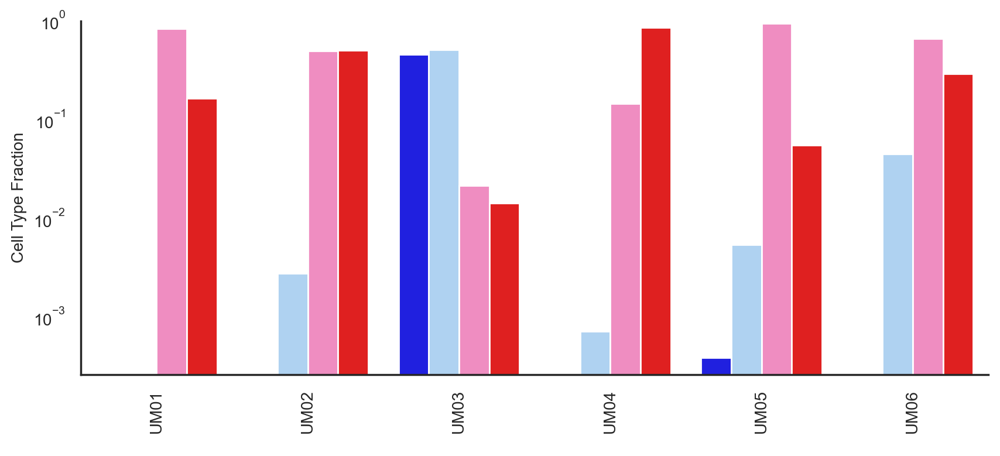

In [124]:
boxplot_patient_list = []
boxplot_fract_list = []
boxplot_class_list = []

for patient in METADATA_TUMOR.index.get_level_values('Patient').unique():
    tmp = [METADATA_TUMOR.loc[METADATA_TUMOR.index.get_level_values('Patient') == patient].\
           TCGA_Assignment.value_counts().reindex(METADATA_TUMOR.TCGA_Assignment.unique(), fill_value=0)[x] 
           for x in TCGA_CLASS_LIST]
    tmp = list(tmp/sum(tmp))
    
    boxplot_patient_list = boxplot_patient_list + [patient for x in range(len(TCGA_CLASS_LIST))]
    boxplot_fract_list = boxplot_fract_list + tmp
    boxplot_class_list = boxplot_class_list + TCGA_CLASS_LIST

boxplot_data = pd.DataFrame()
boxplot_data['Patient'] = boxplot_patient_list
boxplot_data['Fraction'] = boxplot_fract_list
boxplot_data['Class'] = boxplot_class_list

# Set plot
fig = plt.figure(figsize = (10,4))
ax = plt.gca()

# Plot bar plot
g = sns.barplot(data=boxplot_data,x = 'Patient', 
                y = 'Fraction', hue = 'Class', ci=95, capsize=.2,
                palette={"TCGA1": "#0000FF",
                         "TCGA2": "#A4D3FC",
                         "TCGA3": "#FF7DC2", 
                         "TCGA4": "#FF0000",},
                linewidth = 1, ax = ax);
fig.get_axes()[0].set_yscale('log')

plt.ylim((0,1))
g.set_ylabel("Cell Type Fraction",fontsize=10)
g.set_xlabel(" ",fontsize=10,rotation = 90)
g.tick_params(labelsize=10)
g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()

ax.legend_.remove()

# SAVE FIGURE
figure_label = 'TCGA_Distribution_by_Patient_LOG'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

#### MIXTURE MODEL FOR GEP CLASSIFICATION

In [125]:
# Create GEP marker_file dataframe containing gene signatures for each GEP class:

GEP_markerfile_df = pd.DataFrame() 
GEP_markerfile_df['GEP1'] = [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0] 
GEP_markerfile_df['GEP2'] = [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1] 
GEP_markerfile_df.index = ['ID2', 'FXR1', 'EIF1B', 'LTA4H', 'MTUS1', 'SATB1', 'LMCD1', 'ROBO1', 
                           'CDH1', 'ECM1', 'HTR2B', 'RAB31']

pd.DataFrame(columns=['GEP1','GEP2']).to_csv(DATA_PATH + 'cellAssign/GEP_markerfile.csv', index=False) 
GEP_markerfile_df.to_csv(DATA_PATH + 'cellAssign/GEP_markerfile.csv', header=None, mode='a')
GEP_markerfile_df

,GEP1,GEP2
ID2,1,0
FXR1,1,0
EIF1B,1,0
LTA4H,1,0
MTUS1,1,0
SATB1,1,0
LMCD1,1,0
ROBO1,1,0
CDH1,0,1
ECM1,0,1


In [126]:
subset_type = 'TUMOR'
# LOAD GENE LIST FROM EXCEL
path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')
genesets = genesets.apply(lambda x: x.astype(str).str.upper())
print(shape(genesets)[1])

# Using imputed. normalized data:
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

56


/workdir/uvmel_project/figures/final_figures_10_27_20/MSK_BayesianGMM


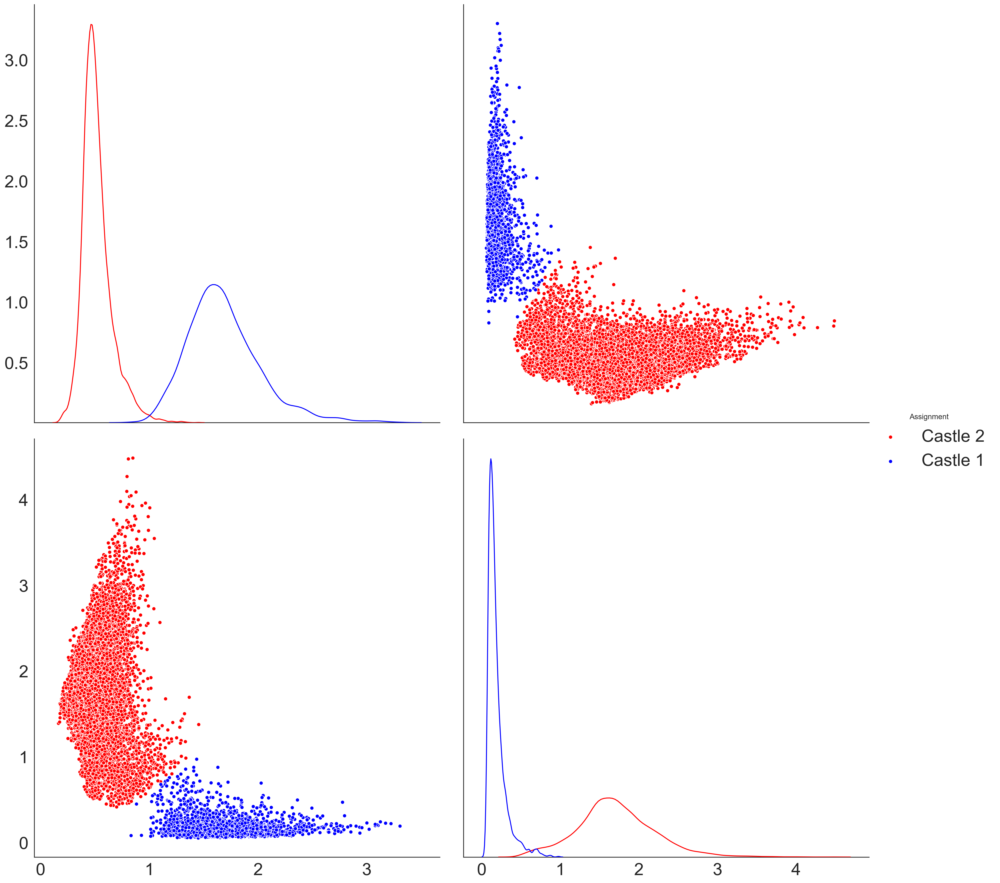

In [127]:
# Get mean gene expression for signature genes for each GEP class:
gene1 = 'Castle 1'
signature_genes = genesets[gene1].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals1 = (np.nanmean(QUERY[detected_genes],axis=1))

gene2 = 'Castle 2'
signature_genes = genesets[gene2].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals2 = (np.nanmean(QUERY[detected_genes],axis=1))

X = pd.DataFrame(data = {gene1: vals1, gene2: vals2}, index = QUERY.index)

# Train BGMM model:
bgmm = BayesianGaussianMixture(covariance_type='diag', n_components=2, random_state=1)
bgmm.fit(X[['Castle 1','Castle 2']])

# Use trained BGMM to make predictions:
clusters = bgmm.predict(X[['Castle 1','Castle 2']])
X['Assignment'] = clusters

# Make Class Assignments
lut ={}
for ii in np.unique(X['Assignment']):
    if X[X['Assignment']==ii]['Castle 1'].mean()>X[X['Assignment']==ii]['Castle 2'].mean():
        lut[ii] = 'Castle 1'
    else:
        lut[ii] = 'Castle 2'
    
X['Assignment'] = X['Assignment'].map(lut)


# Plot results:
sns.set(font_scale=2.5)
sns.set_style("white")
g = sns.pairplot(X[['Castle 1','Castle 2','Assignment']], 
                 hue = 'Assignment',
                 palette={"Castle 1": "#0000FF", "Castle 2": "#FF0000", 'Mixed': '#000000'},
                 diag_kind = 'kde', aspect = 1, size = 10,
                 diag_kws={"shade": False}) # SAVE FIGURE

g.set(xlabel='', ylabel='')

# SAVE FIGURE
figure_label = 'MSK_BayesianGMM'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
g.savefig(fn + '.png', dpi=400, transparent=True)
g.savefig(fn + '.pdf', dpi=400)
print(fn)

In [128]:
# UPDATE DIRECTORY
META['Assignment'] = X.Assignment
METADATA_TUMOR = META.copy()
exec('h5_data.save(METADATA_{}, \'METADATA_{}\')'.format(subset_type,subset_type))

###### COLOR GEP PLOT BY TCGA CLASS

/workdir/uvmel_project/figures/final_figures_10_27_20/MSK_Mixture_Model_FULL_TCGA_colored


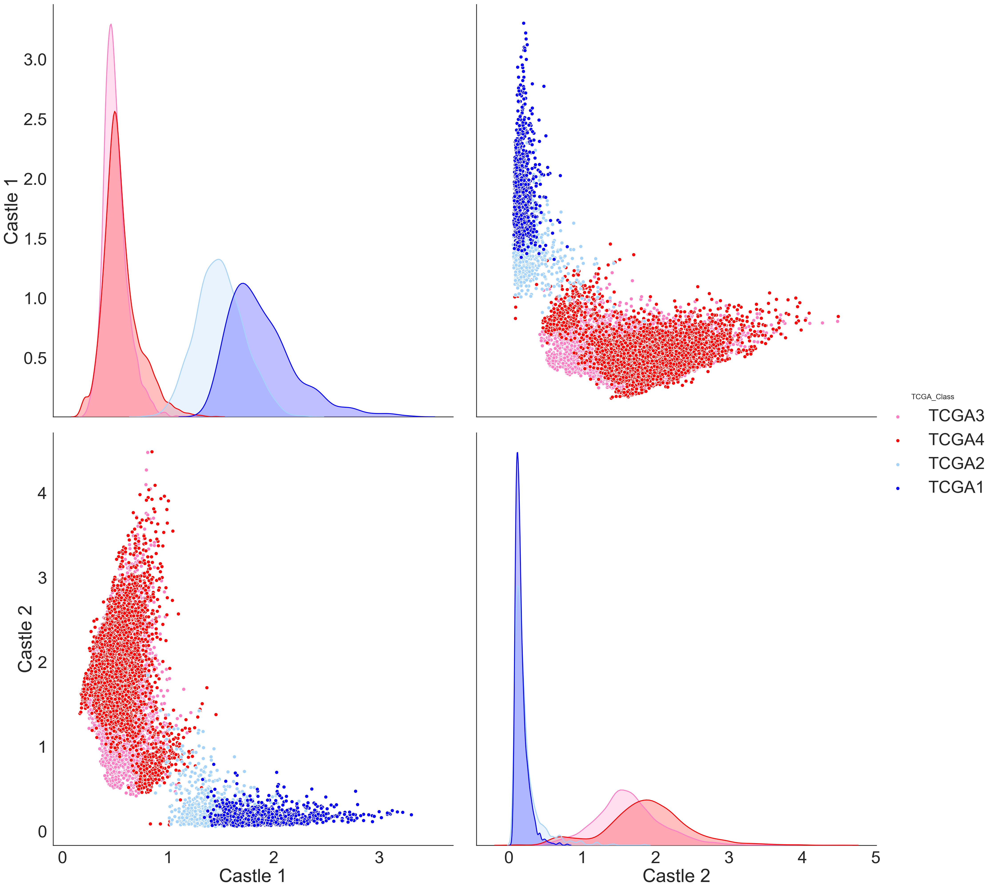

In [129]:
X['TCGA_Class'] = METADATA_TUMOR.TCGA_Assignment

sns.set(font_scale=2.5)
sns.set_style("white")
g = sns.pairplot(X[['Castle 1','Castle 2','Assignment', 'TCGA_Class']], 
                 hue = 'TCGA_Class',
                 palette={"TCGA1": "#0000FF",
                          "TCGA2": "#A4D3FC",
                          "TCGA3": "#FF7DC2", 
                          "TCGA4": "#FF0000",},
            diag_kind = 'kde', aspect = 1, size = 10);# SAVE FIGURE


# SAVE FIGURE
figure_label = 'MSK_Mixture_Model_FULL_TCGA_colored'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
g.savefig(fn + '.png', dpi=400, transparent=True)
g.savefig(fn + '.pdf', dpi=400)
print(fn)

###### MOVE ON WITH INTRATUMOR HETEROGENEITY FOR GEP

/workdir/uvmel_project/figures/final_figures_10_27_20/MSK_Mixture_Model


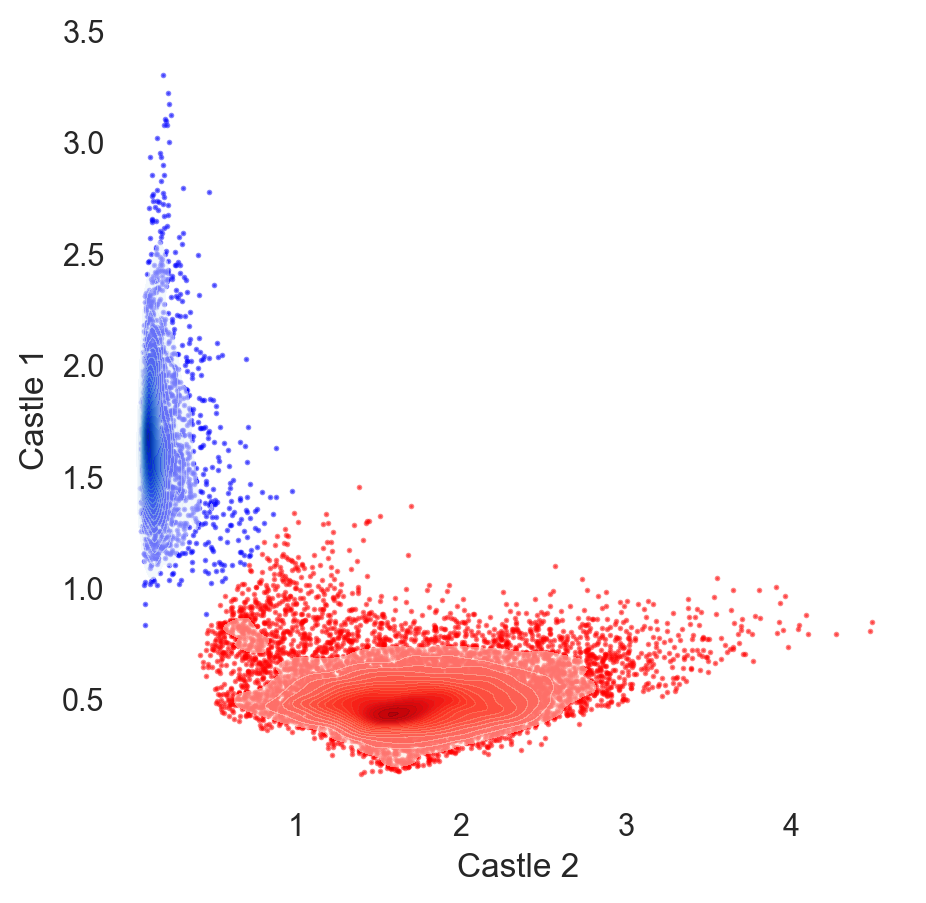

In [130]:
# Second GEP assignment scatter plot:

plt.figure(figsize = (5,5))
sns.despine()
sns.set(rc={'axes.facecolor':'white', 'figure.facecolor':'white'})
ax = plt.gca()

ax = plt.scatter(X[X['Assignment']=='Castle 1']['Castle 2'], X[X['Assignment']=='Castle 1']['Castle 1'],
                 s = 1, c ='blue',alpha = 0.5)
ax = sns.kdeplot(X[X['Assignment']=='Castle 1']['Castle 2'], X[X['Assignment']=='Castle 1']['Castle 1'],
                 cmap="Blues", shade=True, shade_lowest=False,n_levels = 20, alpha = 0.5)

ax = plt.scatter(X[X['Assignment']=='Castle 2']['Castle 2'], X[X['Assignment']=='Castle 2']['Castle 1'],
                 s = 1, c ='red',alpha = 0.5)
ax = sns.kdeplot(X[X['Assignment']=='Castle 2']['Castle 2'], X[X['Assignment']=='Castle 2']['Castle 1'],
                 cmap="Reds", shade=True, shade_lowest=False, n_levels = 20, alpha = 0.5)


# SAVE FIGURE
# SAVE FIGURE
figure_label = 'MSK_Mixture_Model'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP_Distribution_by_Patient


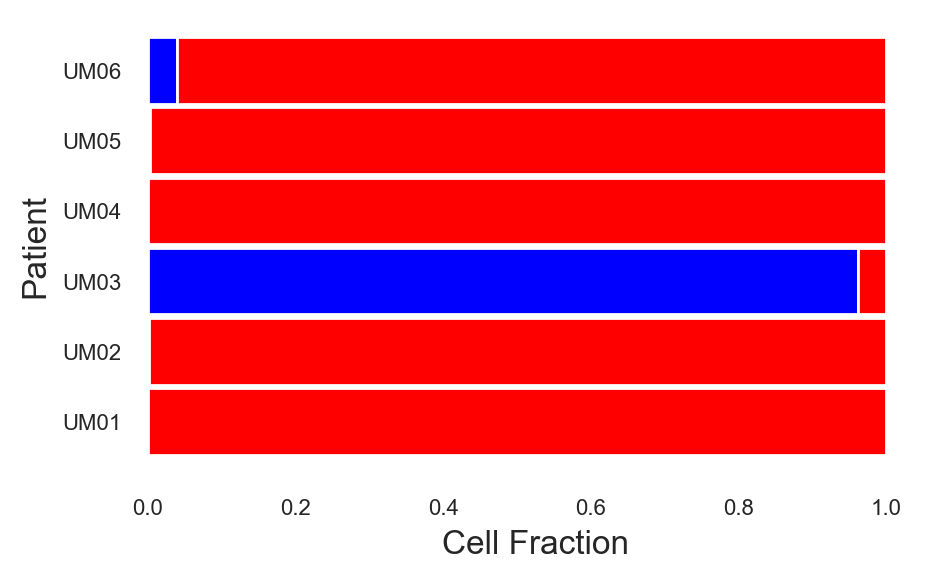

In [131]:
# Update multi-index
new_index = pd.MultiIndex.from_tuples(list(zip(X.index.get_level_values('Sample ID'), 
                                               X.index.get_level_values('Legend'),
                                               X.index.get_level_values('Patient'),
                                               X.index.get_level_values('Cell ID'),
                                               X.index.get_level_values('Phenograph_Class'),
                                               X['Assignment'])), 
                                  names=['Sample ID','Legend', 'Patient','Cell ID','Phenograph_Class','Assignment'])
X = pd.DataFrame(data = X.values, columns = X.columns, index = new_index)

# CLASS ASSIGNMENT BY PATIENT 
meta = 'Assignment'
exec('tmp = X.groupby(level=[\'Patient\', \'{}\'], axis=0).size().unstack().fillna(0)'.format(meta))
colors = ["#0000FF","#FF0000"]

plt.figure(figsize = (5,3))
ax = plt.gca()
tmp.div(tmp.sum(axis=1),axis=0).plot.barh(stacked=True, color=colors, ax = ax, width = 0.95)
ax.legend_.remove()
ax.set_frame_on(False)
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.xlabel('Cell Fraction', fontsize=12)
plt.ylabel('Patient', fontsize=12)

# SAVE FIGURE
figure_label = 'GEP_Distribution_by_Patient'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP_Distribution_by_Patient_LOG


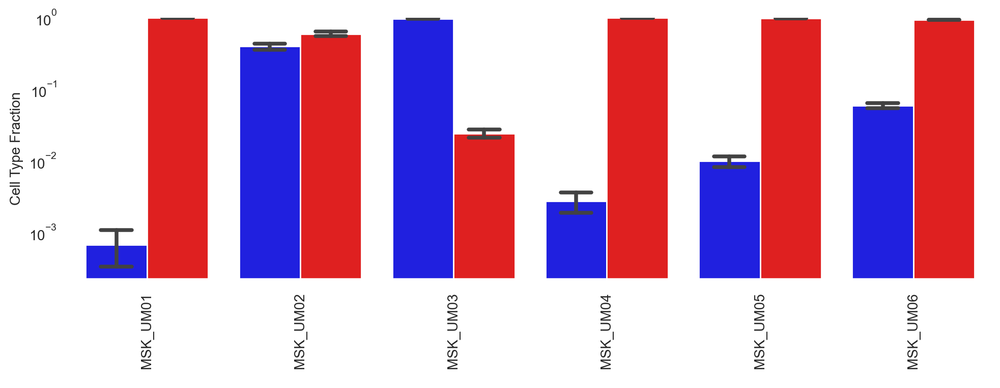

In [132]:
# Down sampled assignment distribution (not used in paper anymore) 

# GENE-GENE COVARIANCE WITHIN NORMAL SUBSET
n = 150
reps = np.arange(100)

master_groupby = 'Patient'
ix = [ind for ind,name in enumerate(X.index.names) if name==master_groupby][0]
fraction_castle1 = np.zeros((len(reps),len(np.unique(X.index.get_level_values(master_groupby)))))
fraction_castle2 = np.zeros((len(reps),len(np.unique(X.index.get_level_values(master_groupby)))))

for rep in reps:
    # RANDOMLY SAMPLE SAME NUMBER OF CELLS PER PATIENT
    SUBSET = pd.DataFrame()
    for class_selection in np.unique(X.index.get_level_values(master_groupby)):
        CSUBSET = X.loc[X.index.map(lambda x: x[ix] in [class_selection])].sample(n=n,replace=True)
        SUBSET = SUBSET.append(CSUBSET)
    
    bgmm = BayesianGaussianMixture(covariance_type='diag', n_components=2, random_state=1)
    bgmm.fit(SUBSET[['Castle 1','Castle 2']])
    clusters = bgmm.predict(SUBSET[['Castle 1','Castle 2']])
    SUBSET['Assignment'] = clusters

    # Make Class Assignments
    lut ={}
    for ii in np.unique(SUBSET['Assignment']):
        if SUBSET[SUBSET['Assignment']==ii]['Castle 1'].mean()>SUBSET[SUBSET['Assignment']==ii]['Castle 2'].mean():
            lut[ii] = 'Castle 1'
        else:
            lut[ii] = 'Castle 2'
    
    SUBSET['Assignment'] = SUBSET['Assignment'].map(lut)

    # Update multi-index
    new_index = pd.MultiIndex.from_tuples(list(zip(SUBSET.index.get_level_values('Sample ID'), 
                                                   SUBSET.index.get_level_values('Legend'),
                                                   SUBSET.index.get_level_values('Patient'),
                                                   SUBSET.index.get_level_values('Cell ID'),
                                                   SUBSET.index.get_level_values('Phenograph_Class'),
                                                   SUBSET['Assignment'])), 
                                          names=['Sample ID','Legend', 'Patient','Cell ID',
                                                 'Phenograph_Class','Assignment'])
    SUBSET = pd.DataFrame(data = SUBSET.values, columns = SUBSET.columns, index = new_index)

    # CASTLE ASSIGNMENT PER PATIENT
    meta = 'Assignment'
    exec('tmp = SUBSET.groupby(level=[\'Patient\', \'{}\'], axis=0).size().unstack().fillna(0)'.format(meta))

    # SAVE PER DOWNSAMPLE
    cell_type_fraction = tmp.div(tmp.sum(axis=1),axis=0)
    fraction_castle1[rep,:] = cell_type_fraction['Castle 1'].values
    fraction_castle2[rep,:] = cell_type_fraction['Castle 2'].values
    
# CONVER TO PANDAS DATAFRAME
boxplot_data_fraction_castle1 = pd.DataFrame(data = fraction_castle1, 
                                             columns = ['{}_{}'.format(master_groupby,ind) 
                                                        for ind in 
                                                        np.unique(X.index.get_level_values(master_groupby))])
boxplot_data_fraction_castle1 = boxplot_data_fraction_castle1.stack().rename_axis(('Rep', 'Patient')).\
                                                                      reset_index(name='Fraction')

boxplot_data_fraction_castle2 = pd.DataFrame(data = fraction_castle2, 
                                             columns = ['{}_{}'.format(master_groupby,ind) 
                                                        for ind in 
                                                        np.unique(X.index.get_level_values(master_groupby))])
boxplot_data_fraction_castle2 = boxplot_data_fraction_castle2.stack().rename_axis(('Rep', 'Patient')).\
                                                                      reset_index(name='Fraction')

boxplot_data_fraction_castle1['Class'] = ['Castle 1']*len(boxplot_data_fraction_castle1)
boxplot_data_fraction_castle2['Class'] = ['Castle 2']*len(boxplot_data_fraction_castle2)
boxplot_data = boxplot_data_fraction_castle1.append(boxplot_data_fraction_castle2)
boxplot_data['Patient'] = [x.replace('Patient','MSK') for x in boxplot_data.Patient]

# VIOLIN PLOT
fig = plt.figure(figsize = (10,4))
ax = plt.gca()

# Plot violin plot
g = sns.barplot(data=boxplot_data,x = 'Patient', 
                y = 'Fraction', hue = 'Class', ci=95, capsize=.2,
                palette={"Castle 1": "#0000FF", "Castle 2": "#FF0000", 'Mixed': '#000000'},
                linewidth = 1, ax = ax);
fig.get_axes()[0].set_yscale('log')

plt.ylim((0,1))
g.set_ylabel("Cell Type Fraction",fontsize=10)
g.set_xlabel(" ",fontsize=10,rotation = 90)
g.tick_params(labelsize=10)
g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()

ax.legend_.remove()
plt.tight_layout()

# SAVE FIGURE
figure_label = 'GEP_Distribution_by_Patient_LOG'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP_Distribution_by_Patient_LOG_NO_ds


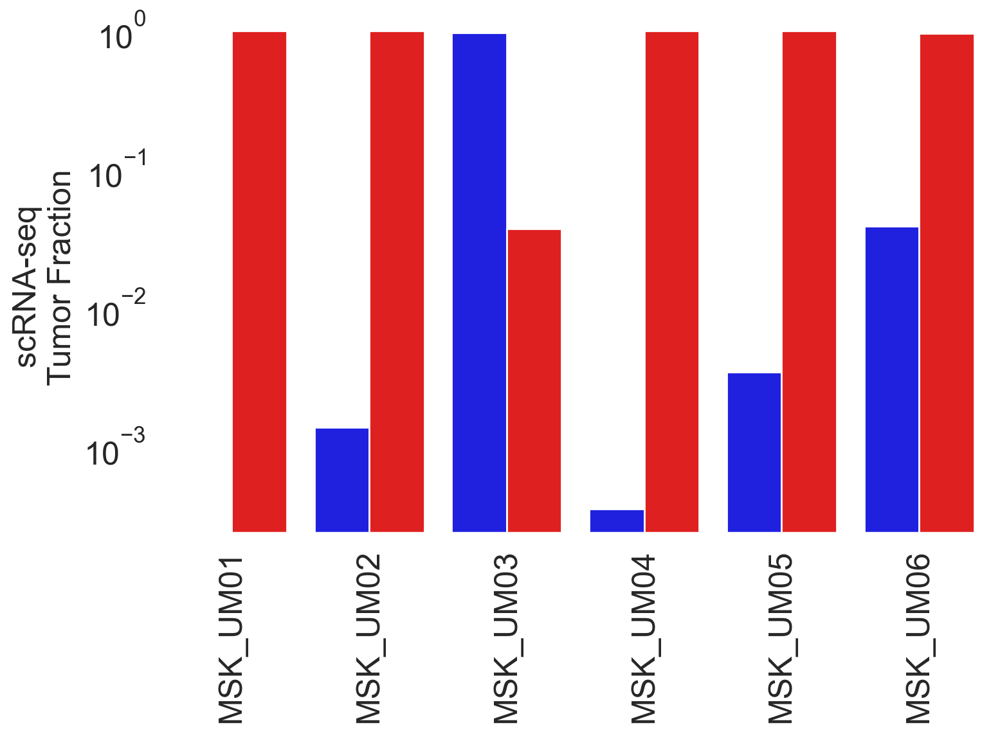

In [133]:
# Get GEP distributions per patient:

boxplot_patient_list = []
boxplot_fract_list = []
boxplot_class_list = []
GEP_CLASS_LIST = ['Castle 1', 'Castle 2']

for patient in METADATA_TUMOR.index.get_level_values('Patient').unique():
    tmp = [METADATA_TUMOR.loc[METADATA_TUMOR.index.get_level_values('Patient') == patient].\
           Assignment.value_counts().reindex(METADATA_TUMOR.Assignment.unique(), fill_value=0)[x] 
           for x in GEP_CLASS_LIST]
    tmp = list(tmp/sum(tmp))
    
    boxplot_patient_list = boxplot_patient_list + [patient for x in range(len(GEP_CLASS_LIST))]
    boxplot_fract_list = boxplot_fract_list + tmp
    boxplot_class_list = boxplot_class_list + GEP_CLASS_LIST

boxplot_data = pd.DataFrame()
boxplot_data['Patient'] = ['MSK_' + x for x in boxplot_patient_list]
boxplot_data['Fraction'] = boxplot_fract_list
boxplot_data['Class'] = boxplot_class_list

# VIOLIN PLOT
fig = plt.figure(figsize = (8,6))
ax = plt.gca()

# Plot violin plot
g = sns.barplot(data=boxplot_data,x = 'Patient', 
                y = 'Fraction', hue = 'Class', ci=95, capsize=.2,
                palette={"Castle 1": "#0000FF", "Castle 2": "#FF0000", 'Mixed': '#000000'},
                linewidth = 1, ax = ax);
fig.get_axes()[0].set_yscale('log')

plt.ylim((0,1))
g.set_ylabel("scRNA-seq \n Tumor Fraction", fontsize=18)
g.set_xlabel(" ", fontsize=10, rotation = 90)
g.tick_params(labelsize=18)
g.set_xticklabels(ax.get_xticklabels(),rotation=90)
#sns.set_style("noticks")
sns.despine()

ax.legend_.remove()
plt.tight_layout()
g.axis(True)

# SAVE FIGURE
figure_label = 'GEP_Distribution_by_Patient_LOG_NO_ds'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

In [134]:
boxplot_data.head()

,Patient,Fraction,Class
0,MSK_UM01,0.000000,Castle 1
1,MSK_UM01,1.000000,Castle 2
2,MSK_UM02,0.001389,Castle 1
3,MSK_UM02,0.998611,Castle 2
4,MSK_UM03,0.962526,Castle 1


###### TCGA DIAMOND PLOTS

In [135]:
# CONVERT HEX TO RGB (FLATUI_CASTLE)
ind_GEP = ['Castle 1', 'Castle 2']
colors = np.zeros((len(FLATUI_CASTLE),3))
for ii,hexcolor in enumerate(FLATUI_CASTLE):
    colors[ii,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
cix = (np.linspace(0,shape(colors)[0],len(np.unique(ind_GEP)))).astype(int)
if cix[len(cix)-1]==shape(colors)[0]:
    cix[len(cix)-1]=shape(colors)[0]-1
lut_CASTLE = dict(zip(np.unique(ind_GEP), colors[cix,:]))

In [136]:
GEP_color_set = [pd.Series(METADATA_TUMOR.loc[METADATA_TUMOR.index.map(lambda x: x[2] == y)].\
                           Assignment.values.tolist()).map(lut_CASTLE)
                 for y in METADATA_TUMOR.index.get_level_values('Patient').unique()]

/workdir/uvmel_project/figures/final_figures_10_27_20/TCGA_PROBS_DiamondPlot


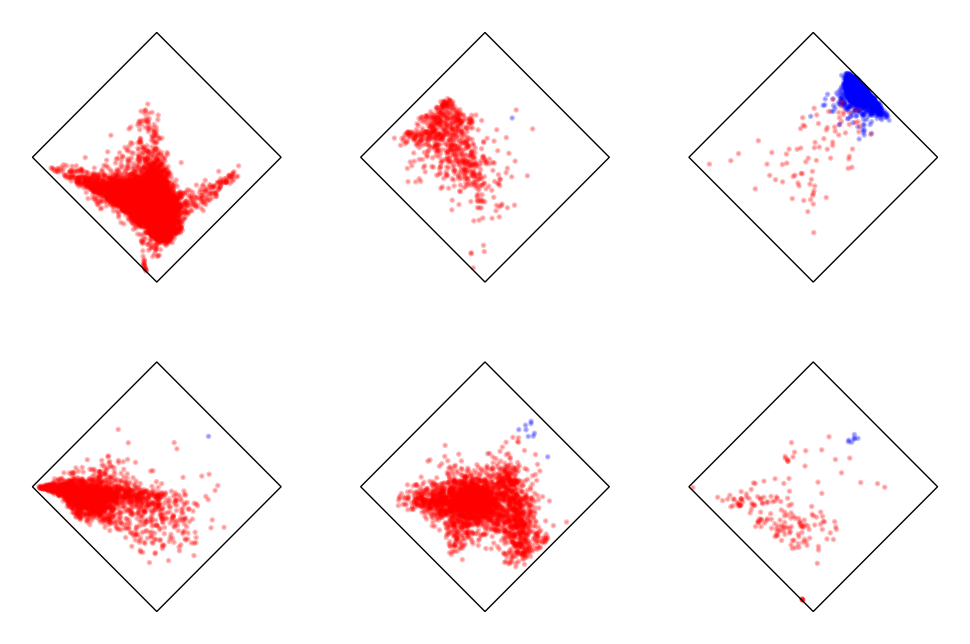

In [137]:
diamond_list = [plt.Rectangle((0,-1), np.sqrt(2), np.sqrt(2), 45, color='black', fill=False, linewidth=0.5) 
                for x in range(6)]

fig1, axes = plt.subplots(2,3)

TCGA_probs_x_MSK = [X_norm.loc[X_norm.index.map(lambda x: x[2] == y)].TCGA2.values - 
                    X_norm.loc[X_norm.index.map(lambda x: x[2] == y)].TCGA4.values
                    for y in X_norm.index.unique(level='Patient')]

TCGA_probs_y_MSK = [X_norm.loc[X_norm.index.map(lambda x: x[2] == y)].TCGA1.values - 
                    X_norm.loc[X_norm.index.map(lambda x: x[2] == y)].TCGA3.values
                    for y in X_norm.index.unique(level='Patient')]

TCGA_probs_per_patient_MSK = [[(TCGA_probs_x_MSK[x][y], TCGA_probs_y_MSK[x][y]) 
                               for y in range(len(TCGA_probs_x_MSK[x]))]
                               for x in range(len(TCGA_probs_x_MSK))]

for i, ax in enumerate(axes.flatten()):
    ax.scatter(*zip(*TCGA_probs_per_patient_MSK[i]), s=1, color=GEP_color_set[i],
               alpha=0.25)
    ax.set_frame_on(False)
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    ax.add_patch(diamond_list[i])

# SAVE FIGURE
figure_label = 'TCGA_PROBS_DiamondPlot'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig1.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig1.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/TCGA_PROBS_DiamondPlot_monochrome


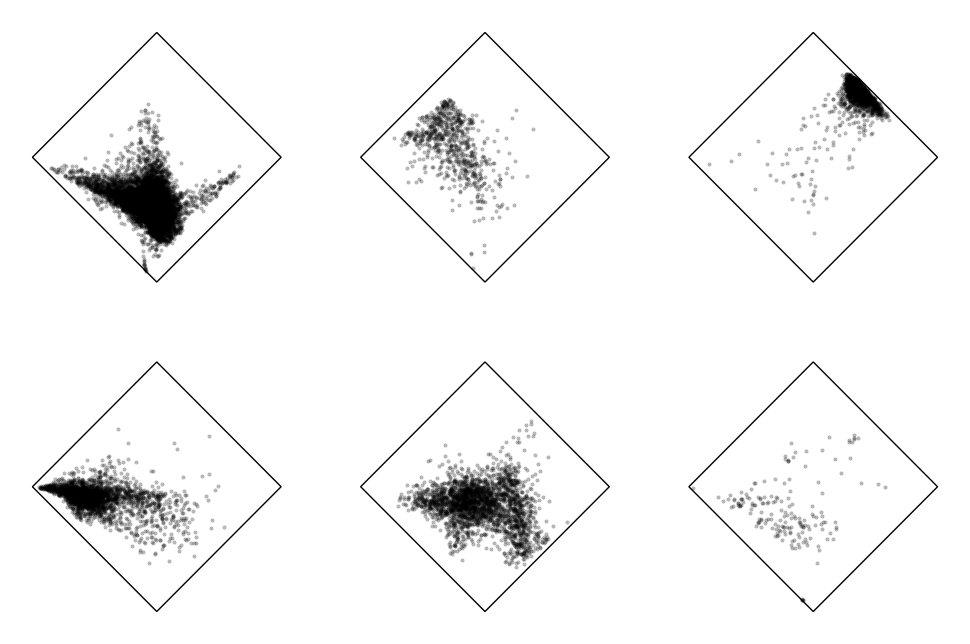

In [138]:
diamond_list = [plt.Rectangle((0,-1), np.sqrt(2), np.sqrt(2), 45, color='black', fill=False, linewidth=0.5)
                for x in range(6)]

fig1, axes = plt.subplots(2,3)

TCGA_probs_x_MSK = [X_norm.loc[X_norm.index.map(lambda x: x[2] == y)].TCGA2.values - 
                    X_norm.loc[X_norm.index.map(lambda x: x[2] == y)].TCGA4.values
                    for y in X_norm.index.unique(level='Patient')]

TCGA_probs_y_MSK = [X_norm.loc[X_norm.index.map(lambda x: x[2] == y)].TCGA1.values - 
                    X_norm.loc[X_norm.index.map(lambda x: x[2] == y)].TCGA3.values
                    for y in X_norm.index.unique(level='Patient')]

TCGA_probs_per_patient_MSK = [[(TCGA_probs_x_MSK[x][y], TCGA_probs_y_MSK[x][y]) 
                               for y in range(len(TCGA_probs_x_MSK[x]))]
                               for x in range(len(TCGA_probs_x_MSK))]

for i, ax in enumerate(axes.flatten()):
    ax.scatter(*zip(*TCGA_probs_per_patient_MSK[i]), s=0.2, color='black',
               alpha=0.3)
    ax.set_frame_on(False)
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    ax.add_patch(diamond_list[i])

# SAVE FIGURE
figure_label = 'TCGA_PROBS_DiamondPlot_monochrome'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig1.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig1.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

In [139]:
# CONVERT HEX TO RGB (FLATUI_CASTLE)
FLATUI_TCGA = ['0000FF', 'A4D3FC', 'FF7DC2', 'FF0000']

ind_TCGA = TCGA_CLASS_LIST
colors = np.zeros((len(FLATUI_TCGA),3))
for ii,hexcolor in enumerate(FLATUI_TCGA):
    colors[ii,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
cix = (np.linspace(0,shape(colors)[0],len(np.unique(ind_TCGA)))).astype(int)
if cix[len(cix)-1]==shape(colors)[0]:
    cix[len(cix)-1]=shape(colors)[0]-1
lut_TCGA = dict(zip(np.unique(ind_TCGA), colors[cix,:]))
CM_TCGA = LinearSegmentedColormap.from_list('FLATUI_TCGA', colors, N=len(colors))

In [140]:
TCGA_color_set = [pd.Series(METADATA_TUMOR.loc[METADATA_TUMOR.index.map(lambda x: x[2] == y)].\
                           TCGA_Assignment.values.tolist()).map(lut_TCGA)
                 for y in METADATA_TUMOR.index.get_level_values('Patient').unique()]

/workdir/uvmel_project/figures/final_figures_10_27_20/TCGA_PROBS_DiamondPlot_tcga_colored


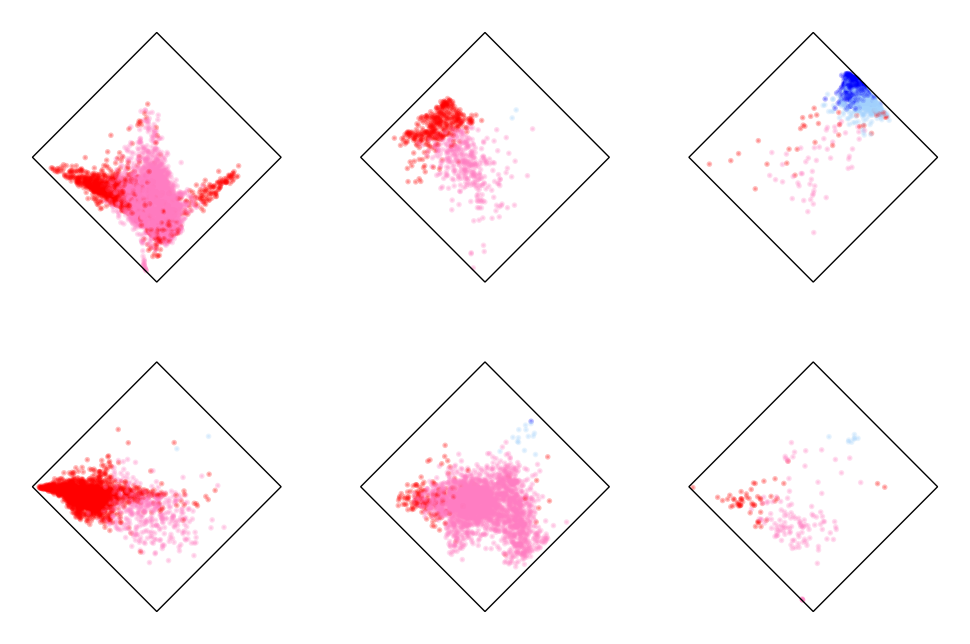

In [141]:
diamond_list = [plt.Rectangle((0,-1), np.sqrt(2), np.sqrt(2), 45, color='black', fill=False, linewidth=0.5)
                for x in range(6)]

fig1, axes = plt.subplots(2,3)

for i, ax in enumerate(axes.flatten()):
    ax.scatter(*zip(*TCGA_probs_per_patient_MSK[i]), s=1, color=TCGA_color_set[i],
               alpha=0.25)
    ax.set_frame_on(False)
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    ax.add_patch(diamond_list[i])

# SAVE FIGURE
figure_label = 'TCGA_PROBS_DiamondPlot_tcga_colored'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig1.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig1.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

## GEP CLINICAL PROGNOSTIFICATION OF INDIVIDUAL TUMOR CELLS

### GEP SIGNATURE CLUSTERED HEATMAP

In [142]:
class_genes = GEP_markerfile_df.index.values.tolist()

# Working with imputed normalized tumor cell data:
subset_type = 'TUMOR'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))

# COLUMN INDEX AND COLORS
genes = [gene for gene in class_genes if gene in QUERY.columns]#gene_array['Gene'].values
# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame(data = zscore(QUERY[genes].values,axis=0),columns = genes, index = QUERY.index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'average' # average, single
metric = 'euclidean' # cosine
linkage = hc.linkage(heatmap_data, method=method, metric = metric)
row_linkage = deepcopy(linkage)
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)

In [143]:
# REORDER HEATMAP ACCORDING TO LINKAGE (OPTIONAL, STILL SLOW)
r1 = hc.leaves_list(row_linkage)
c1 = hc.leaves_list(col_linkage)
mat = heatmap_data.iloc[r1,c1]

In [144]:
GEP_assignments_sorted = [METADATA_TUMOR.loc[METADATA_TUMOR.index.get_level_values('Cell ID') == x].\
                          Assignment.\
                          values[0] for x in mat.index.get_level_values('Cell ID').values]

row_colors = pd.Series(GEP_assignments_sorted, index=GEP_assignments_sorted).map(lut_CASTLE)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP_Heatmap_BayesianGMM


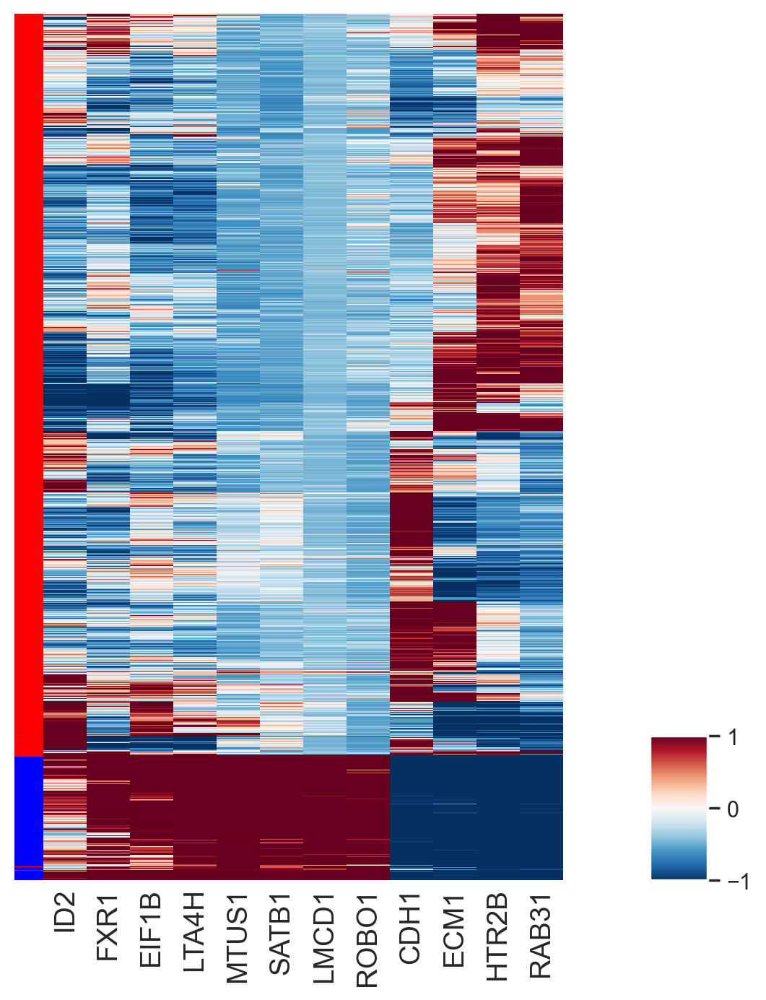

In [145]:
# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(4,10))
plt.rcParams["axes.grid"] = False

# ADD ROW COLOR INDEX 1 (PHENOGRAPH CLASS)
ax1 = fig.add_axes([0,0.1,0.05,0.6]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors:
    pos = (x, y / len(row_colors))
    ax1.add_patch(patches.Rectangle(pos, 1, 1 / len(row_colors), color=c))
    if y >= len(row_colors)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')

# ADD MATRIX WITH GENE NAMES
axmatrix = fig.add_axes([0.05,0.1,0.9,0.6])
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=plt.cm.RdBu_r,vmin=-1,vmax=1)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_frame_on(False)
axmatrix.set_yticklabels([]);
xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 14)
plt.tick_params(size=0)

# ADD COLORBAR
axcolor = fig.add_axes([1.1,0.1,0.1,0.1])
cbar = plt.colorbar(im, cax=axcolor)
#cbar.ax.get_yaxis().set_ticks([])

# SAVE FIGURE
figure_label = 'GEP_Heatmap_BayesianGMM'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### PAIRWISE CORRELATION BETWEEN MONOSOMY 3 SIGNATURE AND GEP2

In [146]:
# Using imputed normalized data for tumor cells:
subset_type = 'TUMOR'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

meta = 'Assignment'

gene1 = 'Castle 2'
signature_genes = genesets[gene1].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
G1 = (np.nansum(QUERY[detected_genes],axis=1))#*complexity

gene2 = 'Monosomy 3 Up'
signature_genes = genesets[gene2].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
G2 = (np.nansum(QUERY[detected_genes],axis=1))#*complexity

# ROW INDEX
meta = 'Assignment'
groupby_type = meta # 'Class', 'Meta-Source', 'Legend'
FLATUI = ['0000FF','FF0000']#FLATUI_CLASS, 'FLATUI_SOURCE, FLATUI_SAMPLES

violin_data = pd.DataFrame({
                            meta:list(META[meta]),
                            gene1: G1,
                            gene2: G2,
                           })

ind = violin_data[groupby_type]

# CONVERT HEX TO RGB (FLATUI_CLASS)
colors = np.zeros((len(FLATUI),3))
for ii,hexcolor in enumerate(FLATUI):
    colors[ii,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
# Palatte for Class METADATA
cix = (np.linspace(0,shape(colors)[0],len(np.unique(ind)))).astype(int)
if cix[len(cix)-1]==shape(colors)[0]:
    cix[len(cix)-1]=shape(colors)[0]-1
lut = dict(zip(np.unique(ind), colors[cix,:]))
dot_colors = pd.Series(ind).map(lut)
metacell_colors = [rgb2hex(int(color[0]*255), int(color[1]*255), int(color[2]*255)) for color in dot_colors]

Castle 2 vs Monosomy 3 Up, R: 0.8521972674504951, p: 0.0
/workdir/uvmel_project/figures/final_figures_10_27_20/M3_GEP2_Correlation_BGMM_UPDATED


<Figure size 1440x1440 with 0 Axes>

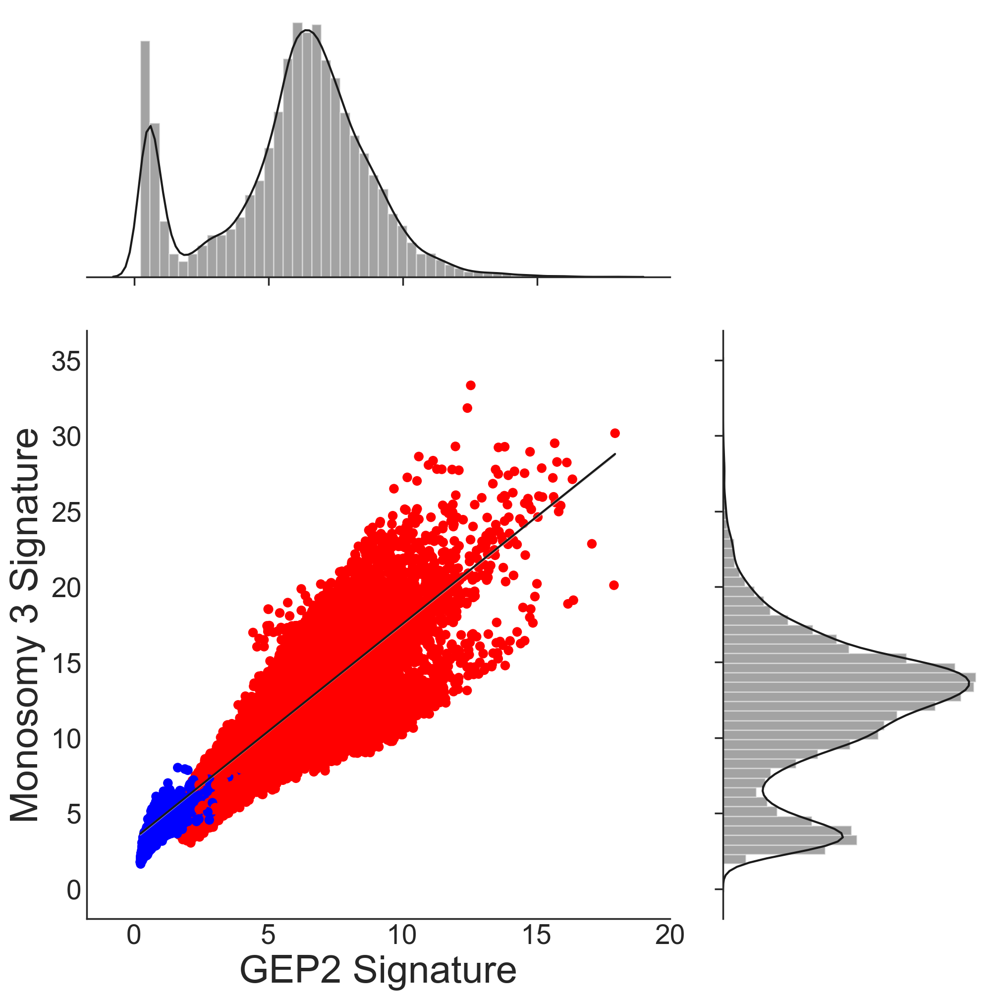

In [147]:
# DISTRIBUTION OF SOX2/SOX9
x = gene1
y = gene2

plt.figure(figsize = (20,20))
sns.despine()
sns.set(style='ticks')

# JOINTPLOT
g = sns.jointplot(x, y, data=violin_data.fillna(0), kind="reg", stat_func=None, ratio=2, color='k', size=10)
g.ax_joint.cla() # or g.ax_joint.collections[0].set_visible(False), as per mwaskom's comment

# REPLOT SCATTER WITH LINEAGE COLORED
plt.sca(g.ax_joint)
plt.scatter(violin_data[x], violin_data[y], c=dot_colors)

# ADD REGRESSION
xx = violin_data[x]
yy = violin_data[y]
f = lambda x, *p: polyval(p, x)
p, cov = curve_fit(f, xx, yy, [1, 1])

# simulated draws from the probability density function of the regression
xi = linspace(np.min(xx), np.max(xx), 100)
ps = np.random.multivariate_normal(p, cov, 10000)
ysample = np.asarray([f(xi, *pi) for pi in ps])
lower = percentile(ysample, 10, axis=0)
upper = percentile(ysample, 90, axis=0)

# regression estimate line
y_fit = poly1d(p)(xi)

# PLOT REGRESSION LINE
plt.fill_between(xi, lower, upper, facecolor='k', alpha=0.5)
plt.plot(xi, y_fit, 'k-')
plt.tick_params(size=0)
plt.yticks(ticks=[0, 5, 10, 15, 20, 25, 30, 35], 
           labels=['0', '5', '10', '15', '20', '25', '30', '35'], size=20)
plt.xticks(ticks=[0, 5, 10, 15, 20], labels=['0', '5', '10', '15', '20'], size=20)
#plt.xlim((0,5))
#plt.ylim((0,5))

# ADD AXIS LABELS
g.set_axis_labels('GEP2 Signature', 'Monosomy 3 Signature', fontsize=28, fontname = 'Arial')

# COMPUTE STATISTICS
(r, p) = stats.pearsonr(violin_data[x].fillna(0), violin_data[y].fillna(0))
print('{} vs {}, R: {}, p: {}'.format(x,y,r,p))

# SAVE FIGURE
figure_label = 'M3_GEP2_Correlation_BGMM_UPDATED'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### EVALUATE GENE EXPRESSION PER GEP CLASS

BAP1 CLASS1 vs. CLASS2
MannwhitneyuResult(statistic=2988854.0, pvalue=0.0)
/workdir/uvmel_project/figures/final_figures_10_27_20/BAP1_Expression_by_GEP_BGMM_UPDATED


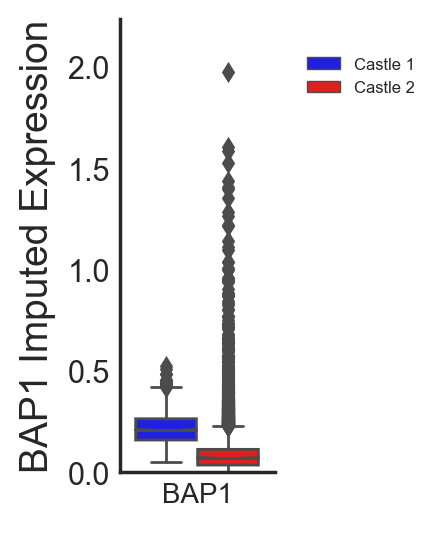

In [148]:
plot_type = 'box'
title = 'BAP1'
meta = 'Assignment'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

fig = plt.figure(figsize = (1,3))
ax = plt.gca()

scale_type = 'count'
palette = dict(zip(['Castle 1','Castle 2'],['#0000FF','#FF0000'])) 


genes = [title]
genes = np.unique([x for x in genes if str(x) != 'NAN'])
detected_genes = list(set(genes).intersection(set(QUERY.columns)))
vals = QUERY[detected_genes]
SCORE = np.nansum(vals,axis=1)

# Format data structure for violin plot
violin_data = []
for ind,v in enumerate(SCORE):
    violin_data.append({'gene': title, 'Z-normalized Expression': v,
                        meta:META[meta].values[ind]}) 
violin_data = pd.DataFrame(violin_data)  

# BOXPLOT GENE EXPRESSION
if plot_type == 'box':
    g = sns.boxplot(x="gene", y="Z-normalized Expression", 
                    hue=meta,data=violin_data, palette=palette,notch = True, 
                    hue_order = ['Castle 1','Castle 2'], 
                    fliersize = 4, showmeans=False,linewidth = 1, ax = ax) #order = labels, 
    g.set_ylabel('BAP1 Imputed Expression'.format(datatype),fontsize=14)
    g.set_xlabel(" ",fontsize=10,rotation = 90)
    g.tick_params(labelsize=10)
    sns.despine()
    ax.set(ylim=(0, SCORE.max()*0.95))
    g.legend(loc='upper right',prop={'size':6},bbox_to_anchor=(2.0, 0.95),fancybox=True) 


elif plot_type == 'violin':
    # VIOLIN GENE EXPRESSION
    g = sns.violinplot(x="gene", y="Z-normalized Expression", 
                       hue=meta,data=violin_data, palette=palette,notch = True, 
                    hue_order = ['Castle 1','Castle 2'],fliersize = 4, showmeans=True,linewidth = 1) #order = labels, 

    g.set_ylabel('BAP1 Imputed Expression'.format(datatype),fontsize=14)
    g.set_xlabel(" ",fontsize=10,rotation = 90)
    ax.set(ylim=(0, SCORE.max()*0.95))
    g.tick_params(labelsize=10)
    sns.despine()
    
plt.tick_params(size=0)
plt.yticks(ticks=[0, 0.5, 1, 1.5, 2.0], 
           labels=['0.0', '0.5', '1.0', '1.5', '2.0'], size=11)

# COMPARE DISTRIBUTIONS
CLASS1 = violin_data.loc[violin_data[meta].isin(['Castle 1'])]['Z-normalized Expression'].values
CLASS2 = violin_data.loc[violin_data[meta].isin(['Castle 2'])]['Z-normalized Expression'].values
print(title + ' CLASS1 vs. CLASS2')
print(stats.mannwhitneyu(CLASS1,CLASS2))

# SAVE FIGURE
figure_label = 'BAP1_Expression_by_GEP_BGMM_UPDATED'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### PHENOTYPIC VOLUME BY PATIENT

###### The commented out code produces the phenotypic volume results, which were then pickled using joblib and imported to save time

In [149]:
# Import phenotypic volume results per patient:

PHEN_VOL_UM01 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM01')
PHEN_VOL_UM02 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM02')
PHEN_VOL_UM03 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM03')
PHEN_VOL_UM04 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM04')
PHEN_VOL_UM05 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM05')
PHEN_VOL_UM06 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM06')

PHEN_VOL_LIST = [PHEN_VOL_UM01, PHEN_VOL_UM02, PHEN_VOL_UM03, PHEN_VOL_UM04, PHEN_VOL_UM05, PHEN_VOL_UM06]

phen_vol_data = pd.DataFrame()

phen_vol_data['Patient'] = ['MSK-UM01']*len(PHEN_VOL_LIST[0])+['MSK-UM02']*len(PHEN_VOL_LIST[1])+\
                           ['MSK-UM03']*len(PHEN_VOL_LIST[2])+['MSK-UM04']*len(PHEN_VOL_LIST[3])+\
                           ['MSK-UM05']*len(PHEN_VOL_LIST[4])+['MSK-UM06']*len(PHEN_VOL_LIST[5])

phen_vol_data['Log Phenotypic Volume'] = [x for l in PHEN_VOL_LIST for x in l]

phen_vol_data['Status'] = ['Alive' if x in ['MSK-UM01', 'MSK-UM05', 'MSK-UM03', 'MSK-UM04']
                            else 'Deceased' for x in phen_vol_data.Patient.values]

In [150]:
phen_vol_data.head()

,Patient,Log Phenotypic Volume,Status
0,MSK-UM01,-6.952244,Alive
1,MSK-UM01,-6.927642,Alive
2,MSK-UM01,-7.113213,Alive
3,MSK-UM01,-6.892573,Alive
4,MSK-UM01,-6.989863,Alive


/workdir/uvmel_project/figures/final_figures_10_27_20/Phenotypic_Volume_Violin_MSK_count_scale


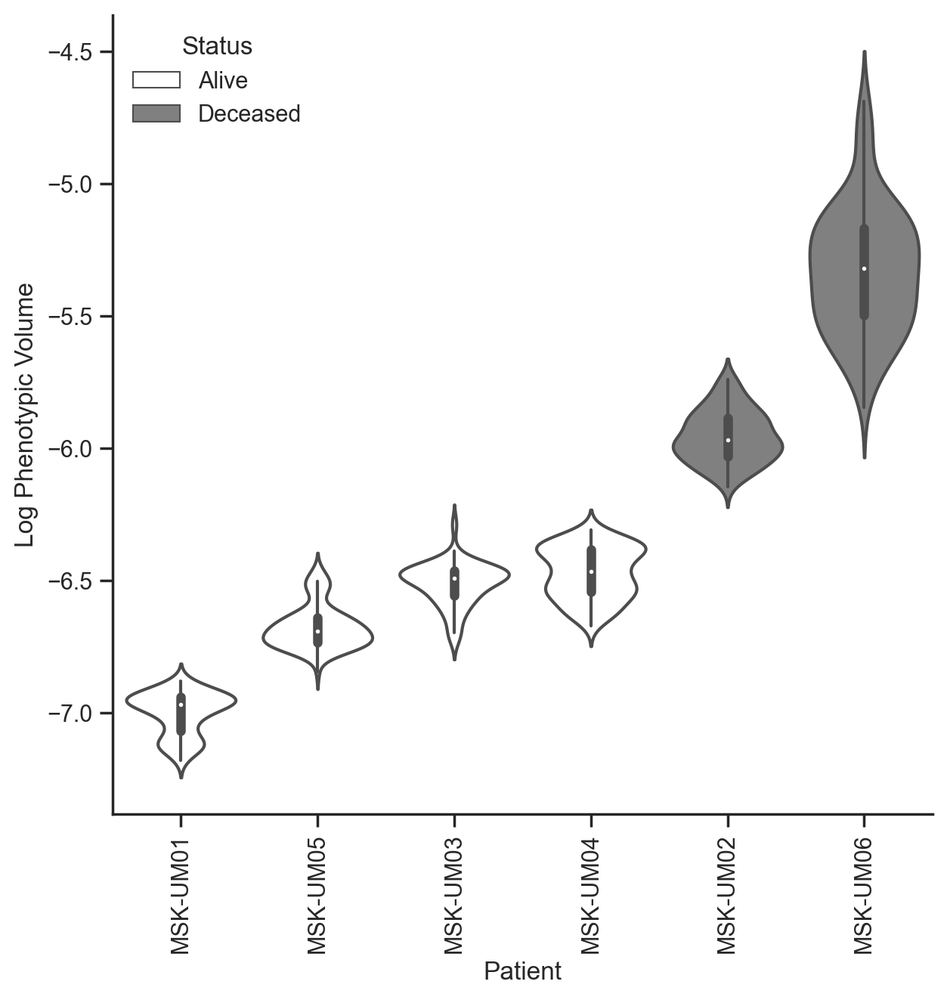

In [151]:
# Visualize using violin plot:

fig, ax = plt.subplots(figsize=(7,7))

ax = sns.violinplot(x='Patient', y='Log Phenotypic Volume', data=phen_vol_data,
                    order=phen_vol_data.groupby('Patient').mean().\
                          sort_values(by='Log Phenotypic Volume').index.values,
                    hue='Status',
                    palette={'Alive': 'white', 'Deceased': 'gray'},
                    dodge=False,
                    scale='count')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.xticks(rotation=90)

# SAVE FIGURE
figure_label = 'Phenotypic_Volume_Violin_MSK_count_scale'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### PHENOTYPIC VOLUME INTRAPATIENT

###### The commented out code produces the phenotypic volume results, which were then pickled using joblib and imported to save time

In [152]:
# IMport phenotypic volume results for GEP1 vs. GEP2 for UM03:

C1_UM03 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM03_GEP1')
C2_UM03 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM03_GEP2')

/workdir/uvmel_project/figures/final_figures_10_27_20/Log_Phenotypic_Volume_UM03


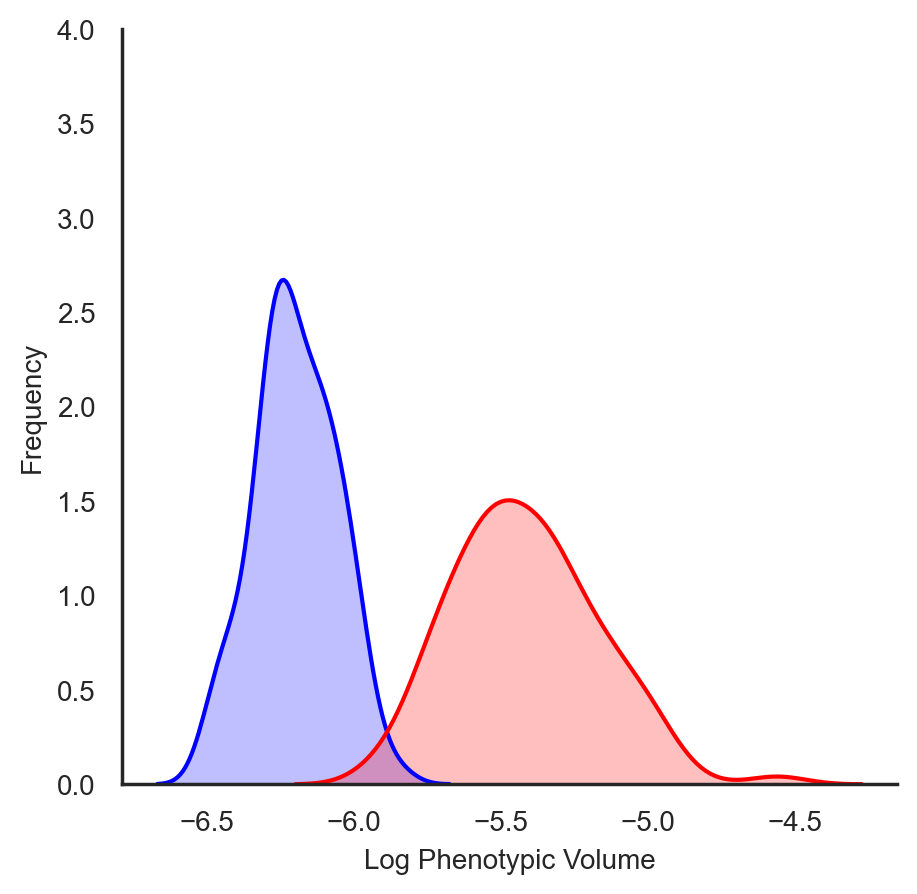

In [153]:
# PLot results:

sns.set_style("white")
fig = plt.figure(figsize = (5,5))
ax = plt.gca()

sns.kdeplot(C1_UM03, shade=True, color="#0000FF")
sns.kdeplot(C2_UM03, shade=True, color="#FF0000")

ax.set_ylabel("Frequency",fontsize=10)
ax.set_xlabel("Log Phenotypic Volume",fontsize=10)
ax.tick_params(labelsize=10)
#g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()
plt.ylim((0,4))

# SAVE FIGURE
figure_label = 'Log_Phenotypic_Volume_UM03'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)


## PRC1 TARGET GENES HEATMAPS

### GEP2 RANKED HEATMAP FOR PRC1 TARGET GENES

In [154]:
# RANK BY GEP 2
meta = 'Nearest_Archetype'#'Archetype_Soft_Cluster'
subset_type = 'TUMOR'
exec('QUERY = INDF_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))
rank_by = 'Castle 2'#'Class 2 Onken v2'
genes = np.unique(genesets[rank_by].values.ravel().tolist())
detected_genes = [gene for gene in genes if gene in list(QUERY.columns)]

vals = QUERY[detected_genes]
SCORE = np.nanmedian(vals,axis=1)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/PRC1_Targets_Heatmap_UPDATED_average_cosine


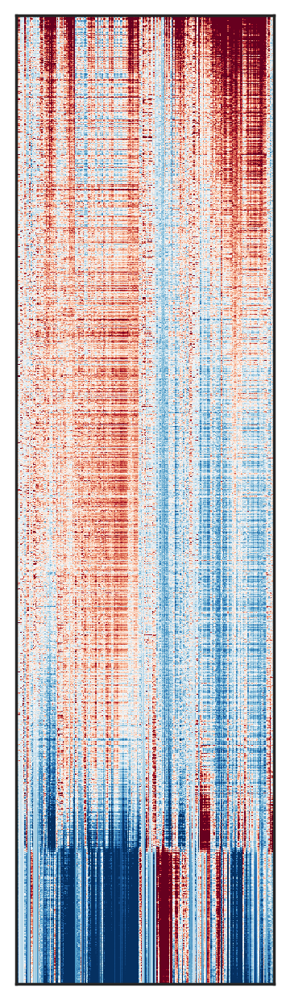

In [155]:
PRC1_target_genes = pd.read_csv(DATA_PATH+'PRC1_targets_Genesets_and_Chipseq.csv')
plot_genes = PRC1_target_genes['PRC1_targets_Genesets_and_Chipseq'].dropna().values.tolist()
plot_genes = [x for x in plot_genes if x in QUERY.columns.values.tolist()]

# LOAD GENESETS
path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')

subset_type = 'TUMOR'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))

# HEATMAP OF INDIVIDUAL CELLS RANKED BY LUNGE EP
rank_by = 'Castle 2'#
genesets_include = [rank_by]
genes = np.unique(genesets[genesets_include].values.ravel().tolist())
genes = [gene for gene in genes if gene in list(set(QUERY.columns))]
vals = QUERY[genes]
QUERY['GEP2_RANK'] =np.nanmean(vals,axis=1)

# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame( data = zscore(QUERY.sort_values(by=['GEP2_RANK'])[plot_genes],axis=0), 
                   columns = plot_genes, index = QUERY.sort_values(by=['GEP2_RANK']).index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'average' # average, single centroid/euclidean
metric = 'cosine' # cosine
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)
cl = hc.leaves_list(col_linkage)
mat = heatmap_data.iloc[:,cl]

window = 20
mat = mat.rolling(window, win_type='triang',center = True).sum()
half_window = int(window/2)
for ind in np.arange(half_window):
    mat.iloc[ind] = mat.iloc[half_window]    
for ind in np.arange(half_window):
    mat.iloc[-ind] = mat.iloc[-half_window]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(4,10))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.4,0.6])
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-10,vmax=10)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
axmatrix.set_xticklabels([]);
axmatrix.grid(False)
plt.tick_params(axis='both', size=0)

# SAVE FIGURE
figure_label = 'PRC1_Targets_Heatmap_UPDATED_average_cosine'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

###### GEP2 RANKED HEATMAP FOR NEW GENESET

In [156]:
# RANK BY GEP 2
meta = 'Nearest_Archetype'#'Archetype_Soft_Cluster'
subset_type = 'TUMOR'
exec('QUERY = INDF_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))
rank_by = 'Castle 2'#'Class 2 Onken v2'
genes = np.unique(genesets[rank_by].values.ravel().tolist())
detected_genes = [gene for gene in genes if gene in list(QUERY.columns)]

vals = QUERY[detected_genes]
SCORE = np.nanmedian(vals,axis=1)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/average_euclidean_heatmap_NEW_GENESET


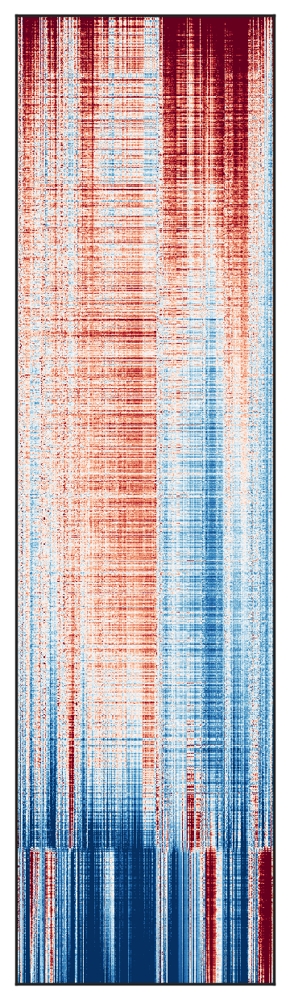

In [157]:
target_genes = pd.read_csv(DATA_PATH+'829_PRE_92_1_geneset.txt', 
                                sep='\t', header=None, names=['genes'])
plot_genes = target_genes['genes'].dropna().values.tolist()
plot_genes = [x for x in plot_genes if x in QUERY.columns.values.tolist()]

# LOAD GENESETS
path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')

subset_type = 'TUMOR'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))

# HEATMAP OF INDIVIDUAL CELLS RANKED BY LUNGE EP
rank_by = 'Castle 2'#
genesets_include = [rank_by]
genes = np.unique(genesets[genesets_include].values.ravel().tolist())
genes = [gene for gene in genes if gene in list(set(QUERY.columns))]
vals = QUERY[genes]
QUERY['GEP2_RANK'] =np.nanmean(vals,axis=1)

# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame( data = zscore(QUERY.sort_values(by=['GEP2_RANK'])[plot_genes],axis=0), 
                   columns = plot_genes, index = QUERY.sort_values(by=['GEP2_RANK']).index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'average' # average, single centroid/euclidean
metric = 'euclidean' # cosine
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)
cl = hc.leaves_list(col_linkage)
mat = heatmap_data.iloc[:,cl]

window = 20
mat = mat.rolling(window, win_type='triang',center = True).sum()
half_window = int(window/2)
for ind in np.arange(half_window):
    mat.iloc[ind] = mat.iloc[half_window]    
for ind in np.arange(half_window):
    mat.iloc[-ind] = mat.iloc[-half_window]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(4,10))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.4,0.6])
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-10,vmax=10)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
axmatrix.set_xticklabels([]);
axmatrix.grid(False)
plt.tick_params(axis='both', size=0)

# SAVE FIGURE
figure_label = 'average_euclidean_heatmap_NEW_GENESET'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

###### HEAT MAP FOR NC NFkB GENESETS

In [158]:
# RANK BY GEP 2
subset_type = 'TUMOR'
exec('QUERY = INDF_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/average_euclidean_heatmap_NC_NFkB


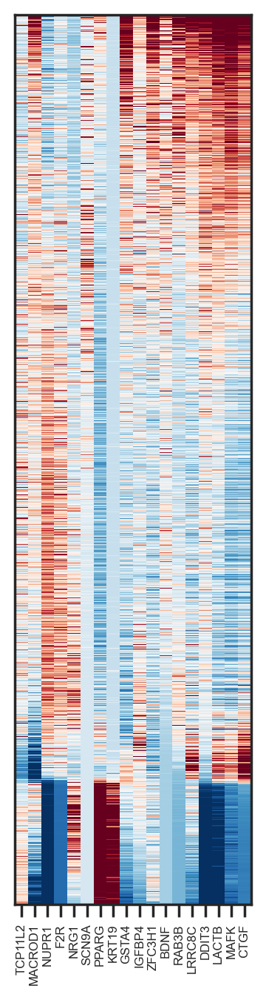

In [159]:
target_genes = pd.read_csv(DATA_PATH+'Genesets_NC_NFkB.txt', 
                                sep='\t', header=0)
plot_genes = target_genes['CIN-responsive-NC-NFkB'].dropna().values.tolist()
plot_genes = [x for x in plot_genes if x in QUERY.columns.values.tolist()]

# LOAD GENESETS
path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')

subset_type = 'TUMOR'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))

# HEATMAP OF INDIVIDUAL CELLS RANKED BY LUNGE EP
rank_by = 'Castle 2'#
genesets_include = [rank_by]
genes = np.unique(genesets[genesets_include].values.ravel().tolist())
genes = [gene for gene in genes if gene in list(set(QUERY.columns))]
vals = QUERY[genes]
QUERY['GEP2_RANK'] =np.nanmean(vals,axis=1)

# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame( data = zscore(QUERY.sort_values(by=['GEP2_RANK'])[plot_genes],axis=0), 
                   columns = plot_genes, index = QUERY.sort_values(by=['GEP2_RANK']).index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'average' # average, single centroid/euclidean
metric = 'euclidean' # cosine
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)
cl = hc.leaves_list(col_linkage)
mat = heatmap_data.iloc[:,cl]

window = 20
mat = mat.rolling(window, win_type='triang',center = True).sum()
half_window = int(window/2)
for ind in np.arange(half_window):
    mat.iloc[ind] = mat.iloc[half_window]    
for ind in np.arange(half_window):
    mat.iloc[-ind] = mat.iloc[-half_window]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(4,10))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.4,0.6])
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-10,vmax=10)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
#axmatrix.set_xticklabels([]);
xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 6,fontname='Arial')
axmatrix.grid(False)
plt.tick_params(axis='y', size=0)

# SAVE FIGURE
figure_label = 'average_euclidean_heatmap_NC_NFkB'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

###### GEP2 RANK CURVE

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/PRC1_Targets_UPDATED_GEP2_RANK_curve


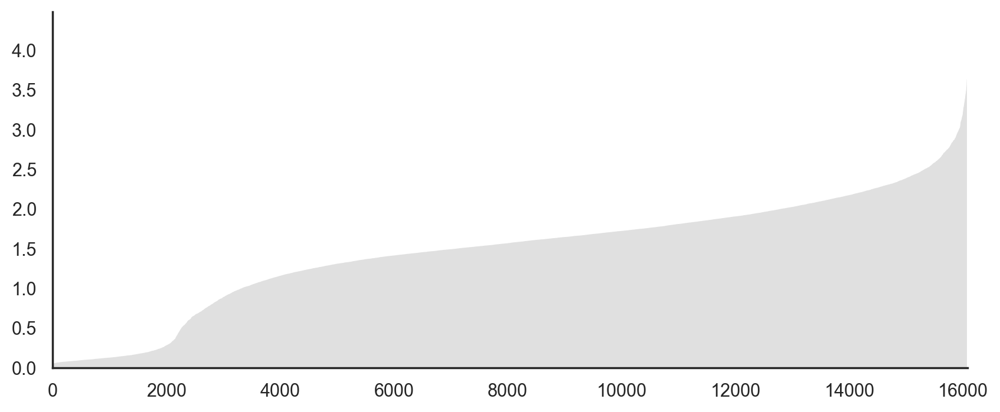

In [160]:
# LOAD GENESETS
plot_genes = ['IRF3', 'RELA', 'RELB', 'MB21D1', 'IKBKB', 'NFKB1', 'TMEM173', 'STAT2', 'CXCL10', 'NFKB2',
              'CCL5', 'TBK1', 'JAK1', 'JAK2', 'IRF9', 'TYK2', 'IRF7', 'IRF1', 'STAT1'
             ]

path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')

subset_type = 'TUMOR'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))

# HEATMAP OF INDIVIDUAL CELLS RANKED BY LUNGE EP
rank_by = 'Castle 2'#
genesets_include = [rank_by]
genes = np.unique(genesets[genesets_include].values.ravel().tolist())
genes = [gene for gene in genes if gene in list(set(QUERY.columns))]
vals = QUERY[genes]
QUERY['GEP2_RANK'] =np.nanmean(vals,axis=1)
heatmap_data = pd.DataFrame( data = QUERY.sort_values(by=['GEP2_RANK'])[plot_genes +['GEP2_RANK']], 
                   columns = plot_genes +['GEP2_RANK'], index = QUERY.sort_values(by=['GEP2_RANK']).index)

y = heatmap_data['GEP2_RANK'].values
x = np.arange(len(y))

fig = plt.figure(figsize=(10,4))
ax = plt.gca()

ax.fill_between(x, 0, y,facecolor='#E0E0E0', interpolate=True)
plt.xlim((0,x.max()))
plt.ylim((0,y.max()))
sns.despine()


# SAVE FIGURE
figure_label = 'PRC1_Targets_UPDATED_GEP2_RANK_curve'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### PRC1 TARGET GENE DEPREPRESSION IN HIGH RISK UM

#### ORIGINAL PRC1 TARGET GENES

In [161]:
# LOAD GENESETS
path_to_genesets = DATA_PATH + 'mRNA_BAP1_DELETED_INTACT.csv'
znormalized_data = pd.read_csv(path_to_genesets,header='infer')

In [162]:
# LOAD GENESETS
path_to_genesets = DATA_PATH + 'mRNA_cell_lines.csv'
znormalized_data_cells = pd.read_csv(path_to_genesets,header='infer')
znormalized_data_cells.set_index('Gene Symbol', inplace=True)
znormalized_data_cells  = znormalized_data_cells.T

znormalized_data_cells.fillna(0, inplace = True)
znormalized_data_cells = znormalized_data_cells.loc[(znormalized_data_cells.sum(axis=1) != 0), 
                                                    (znormalized_data_cells.sum(axis=0) != 0)]
znormalized_data_cells.head()

Gene Symbol,ABCA1,ABLIM3,ADAM12,ADAM19,ADGRE5,ADM,ADM2,ADRB2,ANXA3,APBB2,...,TUFT1,VEGFA,VEGFC,VLDLR,VNN1,WEE1,WNT5B,ZC3H12A,ZEB2,ZNF639
DM1_2592,0.031847,0.007699,0.083435,0.011932,1.92212,0.000000,0.00000,14.294900,0.000598,0.050887,...,0.249274,1.74290,0.121405,3.14058,0.000000,2.31212,0.000000,0.147079,0.625392,1.358870
DM2_2592,0.036214,0.009134,0.070424,0.009537,1.83315,0.012906,0.00000,13.642500,0.000000,0.045025,...,0.271530,1.75568,0.095095,3.00031,0.000000,2.23314,0.000000,0.099941,0.572565,1.430800
S_2538_22,0.051081,0.000522,0.202794,0.023795,4.25870,5.396960,4.38976,1.074150,0.002637,0.183709,...,0.042367,3.44637,0.000285,1.68883,0.004787,1.59343,0.002913,0.885421,1.214480,0.382673
S_2538_23,0.049495,0.001763,0.208372,0.027620,4.38999,4.810720,4.81924,0.966851,0.000000,0.191360,...,0.042962,3.40292,0.000000,1.63412,0.006467,1.54824,0.003578,0.826947,1.262230,0.398120


In [163]:
znormalized_data.set_index('BAP1: Putative copy-number alterations from GISTIC', inplace=True)
znormalized_data.head()

,ABCA1,ABLIM3,ADAM12,ADAM19,ADGB,ADGRE5,ADM,ADM2,ADRB2,ANXA3,...,TUFT1,VEGFA,VEGFC,VLDLR,VNN1,WEE1,WNT5B,ZC3H12A,ZEB2,ZNF639
BAP1: Putative copy-number alterations from GISTIC,,,,,,,,,,,,,,,,,,,,,
Shallow Deletion,-0.3280,-0.0081,0.0634,-0.1305,-0.3432,1.9611,2.5518,2.1589,-1.1838,-0.2386,...,-0.2466,0.8279,-0.2552,1.0116,-0.2527,1.5497,-0.3576,0.9726,1.3472,-0.5191
Shallow Deletion,-0.1285,0.0438,0.2369,0.7721,-0.3432,0.1536,0.2954,1.3015,-0.6970,-0.3340,...,-0.5826,0.1368,-0.3225,1.1743,-0.2164,-0.4010,-0.2423,-0.3334,0.3303,-0.3387
Diploid,-0.9617,1.7584,0.1449,-0.4394,-0.3432,0.1963,0.0200,-0.7803,1.3212,-0.2981,...,1.3306,-0.9067,0.0911,-0.9637,-0.4838,-0.7979,-0.2896,0.1725,-0.5413,-0.8179
Diploid,-0.8798,-0.3826,-1.1386,-0.3882,-0.3432,-0.8034,2.7017,-0.1387,-0.6897,0.4796,...,-0.4762,-0.3738,-0.3887,-1.2679,23.4834,0.6410,-0.2032,-0.9537,-1.4760,-1.0323
Shallow Deletion,-0.8199,-0.5260,1.4771,-0.4109,-0.3432,-0.0105,-0.2995,1.1287,-0.5915,-0.3385,...,-0.2186,-0.0714,0.5504,0.9216,-0.7506,-0.2826,0.3068,-0.1910,-0.4230,-0.7716


In [164]:
znormalized_data.fillna(0, inplace = True)
znormalized_data = znormalized_data.loc[(znormalized_data.sum(axis=1) != 0), (znormalized_data.sum(axis=0) != 0)]

In [165]:
znormalized_data_sorted = znormalized_data.sort_index(axis = 0)
znormalized_data_sorted.head()

,ABCA1,ABLIM3,ADAM12,ADAM19,ADGB,ADGRE5,ADM,ADM2,ADRB2,ANXA3,...,TUFT1,VEGFA,VEGFC,VLDLR,VNN1,WEE1,WNT5B,ZC3H12A,ZEB2,ZNF639
BAP1: Putative copy-number alterations from GISTIC,,,,,,,,,,,,,,,,,,,,,
Diploid,2.1053,-0.5956,-0.8422,-0.2897,-0.3432,-1.0548,1.9903,-0.4968,0.3451,0.1536,...,0.2366,0.8168,-0.5473,-0.0841,0.9863,0.9562,-0.4621,-0.4393,-1.1472,0.9122
Diploid,1.0004,-0.0548,-0.0935,-0.4110,-0.3432,0.2177,-0.8494,-0.5350,0.3888,-0.2771,...,1.0895,-0.9075,0.0258,0.2903,-0.4265,-1.3696,-0.4674,-0.7878,-0.2513,-0.6983
Diploid,-0.5224,-0.5833,-1.1199,-0.5036,-0.3432,-1.0312,0.4401,-0.7034,0.8613,-0.2941,...,-0.5842,-0.3996,-0.8073,-0.9744,-0.7506,-1.3727,-0.5592,-0.7199,-0.2920,-0.9121
Diploid,0.3000,-0.4830,0.0361,-0.4585,-0.3432,-1.3434,-0.6254,-0.8505,0.7757,-0.2981,...,-0.2500,0.2941,-0.5592,-1.0399,0.9100,0.0351,-0.6838,-0.3292,-0.2210,1.8738
Diploid,1.0185,-0.4323,-0.4308,-0.4157,-0.3432,-0.9868,-0.7485,-0.9527,1.7614,-0.1059,...,0.0252,-1.0115,-0.7267,-0.5188,-0.0388,-0.8893,-0.3314,-1.1090,-0.8144,-0.1613


In [166]:
znormalized_data.shape

(80, 140)

/workdir/uvmel_project/figures/final_figures_10_27_20/PRC1_Target_Genes//PRC1_Targets_Derepressed_highriskUM_ORIGINAL


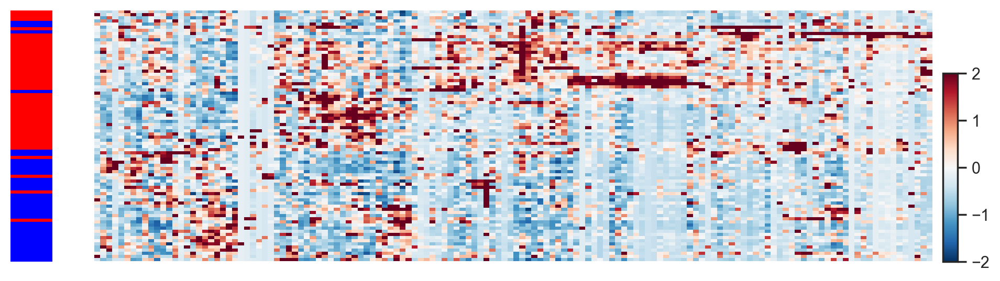

In [167]:
heatmap_data = znormalized_data

# CONSTRUCT HEATMAP DATA
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'average' # average, single centroid/euclidean
metric = 'correlation' # cosine
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)
cl = hc.leaves_list(col_linkage)
linkage = hc.linkage(heatmap_data, method=method, metric = metric)
row_linkage = deepcopy(linkage)
rl = hc.leaves_list(row_linkage)
mat = heatmap_data.iloc[rl,cl]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(20,3))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.4,0.8])
colors = [(1,1,1), np.divide(tuple(hex('FF0000').rgb),255)]
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-2,vmax=2)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
#axmatrix.set_xticklabels([]);
#xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 6,fontname='Arial')
xtick = plt.xticks([])
axmatrix.grid(False)
axmatrix.spines['top'].set_visible(False)
axmatrix.spines['right'].set_visible(False)
axmatrix.spines['bottom'].set_visible(False)
axmatrix.spines['left'].set_visible(False)
axmatrix.tick_params(axis=u'both', which=u'both',length=0)

# ROW1 COLORS
# COLORMAP LUT
lut = {
                 'Shallow Deletion':'red', # pink
                 'Diploid': 'blue'
    }

ind1 = mat.index
row_colors1 = pd.Series(ind1).map(lut)

# ADD ROW COLOR INDEX (CELL OF ORIGIN)
ax1 = fig.add_axes([0.08,0.1,0.02,0.8]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors1:
    pos = (x, y / len(row_colors1))
    ax1.add_patch(patches.Rectangle(pos, 1, 1 / len(row_colors1), color=c))
    if y >= len(row_colors1)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')


# ADD COLORBAR
axcolor = fig.add_axes([0.525,0.1,0.007,0.6])
cbar = plt.colorbar(im, cax=axcolor)

# SAVE FIGURE
figure_label = '/PRC1_Targets_Derepressed_highriskUM_ORIGINAL'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/PRC1_Target_Genes/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/PRC1_Target_Genes//PRC1_Targets_unsupervised_clustering_ORIGINAL


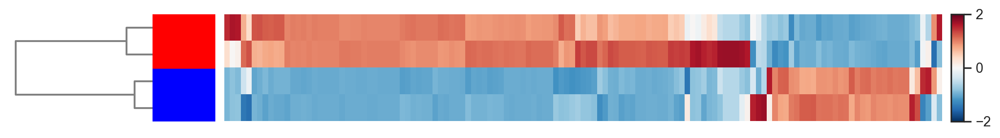

In [168]:
QUERY = znormalized_data_cells
heatmap_data = pd.DataFrame( data = zscore(QUERY,axis=0), columns = QUERY.columns, index = QUERY.index)

# CONSTRUCT HEATMAP DATA
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'average' # average, single centroid/euclidean
metric = 'correlation' # cosine
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)
cl = hc.leaves_list(col_linkage)
linkage = hc.linkage(heatmap_data, method=method, metric = metric)
row_linkage = deepcopy(linkage)
rl = hc.leaves_list(row_linkage)
mat = heatmap_data.iloc[rl,cl]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(20,2))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.4,0.6])
colors = [(1,1,1), np.divide(tuple(hex('FF0000').rgb),255)]
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-2,vmax=2)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
#axmatrix.set_xticklabels([]);
#xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 6,fontname='Arial')
xtick = plt.xticks([])
axmatrix.grid(False)
axmatrix.spines['top'].set_visible(False)
axmatrix.spines['right'].set_visible(False)
axmatrix.spines['bottom'].set_visible(False)
axmatrix.spines['left'].set_visible(False)
axmatrix.tick_params(axis=u'both', which=u'both',length=0)

# ROW1 COLORS
# COLORMAP LUT
lut = {
                 'DM1_2592':'blue', # pink
                 'DM2_2592': 'blue',
                 'S_2538_22':'red', # pink
                 'S_2538_23': 'red'
    }

ind1 = mat.index
row_colors1 = pd.Series(ind1).map(lut)

# ADD ROW COLOR INDEX (CELL OF ORIGIN)
ax1 = fig.add_axes([0.08,0.1,0.035,0.6]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors1:
    pos = (x, y / len(row_colors1))
    ax1.add_patch(patches.Rectangle(pos, 1, 1 / len(row_colors1), color=c))
    if y >= len(row_colors1)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')

# ADD DENDROGRAM
ax2 = fig.add_axes([0.00,0.1,0.08,0.6]) # [x0,y0,width,height]
Z1 = sch.dendrogram(row_linkage, orientation='left',color_threshold = 0, above_threshold_color='#808080')
ax2.set_xticks([])
ax2.set_yticks([])
plt.axis('off')

# ADD COLORBAR
axcolor = fig.add_axes([0.525,0.1,0.007,0.6])
cbar = plt.colorbar(im, cax=axcolor)

# SAVE FIGURE
figure_label = '/PRC1_Targets_unsupervised_clustering_ORIGINAL'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/PRC1_Target_Genes/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

#### UPDATED PRC1 TARGET GENES

In [169]:
# LOAD GENESETS
path_to_genesets = DATA_PATH + 'TCGA_new PRC1 targets.csv'
znormalized_data = pd.read_csv(path_to_genesets,header='infer')

In [170]:
# LOAD GENESETS
path_to_genesets = DATA_PATH + '921vsMP38.csv'
znormalized_data_cells = pd.read_csv(path_to_genesets,header='infer')
znormalized_data_cells.set_index('gene_name', inplace=True)
znormalized_data_cells  = znormalized_data_cells.T

znormalized_data_cells.fillna(0, inplace = True)
znormalized_data_cells = znormalized_data_cells.loc[(znormalized_data_cells.sum(axis=1) != 0), 
                                                    (znormalized_data_cells.sum(axis=0) != 0)]
znormalized_data_cells.head()

gene_name,AASS,ABCA1,ABLIM3,ADA,ADAM12,ADAM19,ADAMTS1,ADARB1,ADGRA2,ADGRE5,...,WASF1,WDFY1,WDR90,WNT5A,WNT5B,WWC3,ZC3H12A,ZEB2,ZIC2,ZYX
92.1,0.227046,0.031847,0.007699,0.466672,0.083435,0.011932,3.66314,0.238259,0.169207,1.92212,...,0.241382,0.693937,2.245790,0.184623,0.000000,0.439478,0.147079,0.625392,1.332140,3.28239
92.1.1,0.188598,0.036214,0.009134,0.535110,0.070424,0.009537,3.63388,0.237295,0.173736,1.83315,...,0.216111,0.687720,2.245910,0.186524,0.000000,0.365168,0.099941,0.572565,1.213260,3.43381
MP38,0.073808,0.051081,0.000522,0.506380,0.202794,0.023795,2.43788,0.137779,0.067115,4.25870,...,0.134877,1.991090,1.075870,0.045068,0.002913,0.494197,0.885421,1.214480,0.689662,8.00503
MP38.1,0.069475,0.049495,0.001763,0.491395,0.208372,0.027620,2.11974,0.155145,0.057728,4.38999,...,0.143617,2.032380,0.916997,0.062818,0.003578,0.506433,0.826947,1.262230,0.629534,7.87719


In [171]:
znormalized_data.set_index('Chromosome 3', inplace=True)
znormalized_data.drop(columns=['Sample name'], inplace=True)
znormalized_data.head()

,AASS,ABCA1,ABLIM3,ADA,ADAM12,ADAM19,ADAMTS1,ADARB1,ADGRA2,ADGRE5,...,WASF1,WDFY1,WDR90,WNT5A,WNT5B,WWC3,ZC3H12A,ZEB2,ZIC2,ZYX
Chromosome 3,,,,,,,,,,,,,,,,,,,,,
Diploid,-0.8339,-0.9617,1.7584,0.9504,0.1449,-0.4394,1.2682,0.1060,-0.2968,0.1963,...,0.9494,-1.1413,-0.2381,-0.2980,-0.2896,-0.0295,0.1725,-0.5413,-0.2697,0.6310
Diploid,-0.9200,-0.6201,-0.4080,2.3224,-1.0353,-0.4956,2.3595,-0.8420,-0.5019,-0.0505,...,-0.3998,-0.8279,0.1888,-0.2744,-0.5357,0.2005,-0.7004,-1.1395,-0.3623,0.4937
Diploid,-0.5040,0.1569,1.3480,4.3307,-0.9303,-0.2894,-0.9606,-0.4223,0.1404,-0.6549,...,-0.6343,-0.4218,0.0019,-0.1455,-0.3064,-0.7143,1.1313,1.0379,-0.3623,-0.2723
Diploid,-0.8973,-0.8218,3.9268,1.9495,-0.7946,-0.4535,-0.1552,-0.2129,-0.2654,1.6182,...,-0.9261,-1.5786,-0.4553,0.0602,1.2258,1.7007,-1.0082,-0.8881,0.1595,2.5382
Diploid,1.8733,0.9131,-0.3604,-0.0429,-0.5937,-0.5326,1.4150,4.7034,-0.4981,-1.5058,...,-0.5617,0.3850,-0.1695,0.9326,-0.6239,0.0446,-0.7919,0.3237,-0.2748,-0.7657


In [172]:
znormalized_data.fillna(0, inplace = True)
znormalized_data = znormalized_data.loc[(znormalized_data.sum(axis=1) != 0), (znormalized_data.sum(axis=0) != 0)]

In [173]:
znormalized_data_sorted = znormalized_data.sort_index(axis = 0)
znormalized_data_sorted.head()

,AASS,ABCA1,ABLIM3,ADA,ADAM12,ADAM19,ADAMTS1,ADARB1,ADGRA2,ADGRE5,...,WASF1,WDFY1,WDR90,WNT5A,WNT5B,WWC3,ZC3H12A,ZEB2,ZIC2,ZYX
Chromosome 3,,,,,,,,,,,,,,,,,,,,,
Diploid,-0.8339,-0.9617,1.7584,0.9504,0.1449,-0.4394,1.2682,0.1060,-0.2968,0.1963,...,0.9494,-1.1413,-0.2381,-0.2980,-0.2896,-0.0295,0.1725,-0.5413,-0.2697,0.6310
Diploid,-0.9200,-0.6201,-0.4080,2.3224,-1.0353,-0.4956,2.3595,-0.8420,-0.5019,-0.0505,...,-0.3998,-0.8279,0.1888,-0.2744,-0.5357,0.2005,-0.7004,-1.1395,-0.3623,0.4937
Diploid,-0.5040,0.1569,1.3480,4.3307,-0.9303,-0.2894,-0.9606,-0.4223,0.1404,-0.6549,...,-0.6343,-0.4218,0.0019,-0.1455,-0.3064,-0.7143,1.1313,1.0379,-0.3623,-0.2723
Diploid,-0.8973,-0.8218,3.9268,1.9495,-0.7946,-0.4535,-0.1552,-0.2129,-0.2654,1.6182,...,-0.9261,-1.5786,-0.4553,0.0602,1.2258,1.7007,-1.0082,-0.8881,0.1595,2.5382
Diploid,1.8733,0.9131,-0.3604,-0.0429,-0.5937,-0.5326,1.4150,4.7034,-0.4981,-1.5058,...,-0.5617,0.3850,-0.1695,0.9326,-0.6239,0.0446,-0.7919,0.3237,-0.2748,-0.7657


In [174]:
znormalized_data.shape

(80, 236)

/workdir/uvmel_project/figures/final_figures_10_27_20/PRC1_Target_Genes/PRC1_Targets_Derepressed_highriskUM_UPDATED


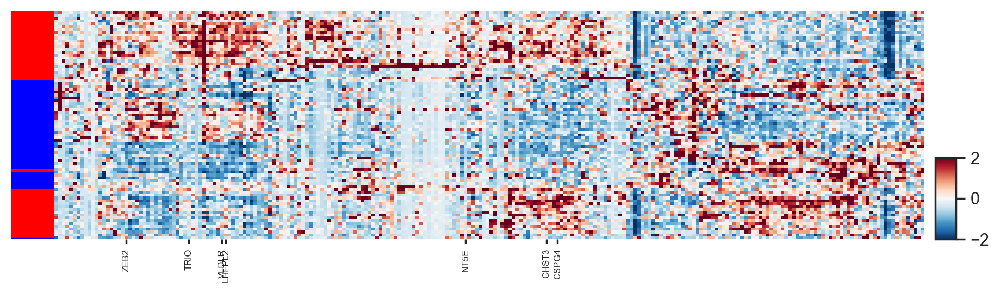

In [175]:
heatmap_data = znormalized_data#_sorted

# CONSTRUCT HEATMAP DATA
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'average' # average, single centroid/euclidean
metric = 'correlation' # cosine
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)
cl = hc.leaves_list(col_linkage)
linkage = hc.linkage(heatmap_data, method=method, metric = metric)
row_linkage = deepcopy(linkage)
rl = hc.leaves_list(row_linkage)
mat = heatmap_data.iloc[rl,cl]

genes_to_show = ['ZEB2', 'SLC1A4', 'CSPG4', 'FADS3', 'VLDLR', 'ASPH', 'LHFPL2', 'TRIO', 'CHST3', 'C2CD2', 'NT5E']
xlabel_list = [x if x in genes_to_show else '' for x in mat.columns.values]
xtick_list = [x for x in range(len(xlabel_list)) if xlabel_list[x] !='']
xlabel_list = [x for x in xlabel_list if x !='']

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(20,3))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.4,0.7])
colors = [(1,1,1), np.divide(tuple(hex('FF0000').rgb),255)]
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-2,vmax=2)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
#axmatrix.set_xticklabels([]);
xtick = plt.xticks(xtick_list, xlabel_list, rotation = 90, fontsize = 6,fontname='Arial')
#xtick = plt.xticks([])
axmatrix.grid(False)
axmatrix.spines['top'].set_visible(False)
axmatrix.spines['right'].set_visible(False)
axmatrix.spines['bottom'].set_visible(False)
axmatrix.spines['left'].set_visible(False)
axmatrix.tick_params(axis=u'both', which=u'both',length=3)

# ROW1 COLORS
# COLORMAP LUT
lut = {
                 'Monosomy 3':'red', # pink
                 'Diploid': 'blue'
    }

ind1 = mat.index
row_colors1 = pd.Series(ind1).map(lut)

# ADD ROW COLOR INDEX (CELL OF ORIGIN)
ax1 = fig.add_axes([0.1,0.1,0.02,0.7]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors1:
    pos = (x, y / len(row_colors1))
    ax1.add_patch(patches.Rectangle(pos, 1, 1 / len(row_colors1), color=c))
    if y >= len(row_colors1)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')

# ADD COLORBAR
axcolor = fig.add_axes([0.525,0.1,0.0095,0.25])
cbar = plt.colorbar(im, cax=axcolor)

# SAVE FIGURE
figure_label = 'PRC1_Targets_Derepressed_highriskUM_UPDATED'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/PRC1_Target_Genes/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/PRC1_Target_Genes/PRC1_Targets_unsupervised_clustering_UPDATED


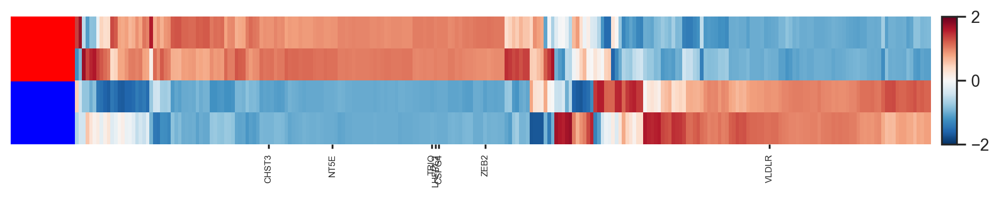

In [176]:
QUERY = znormalized_data_cells
heatmap_data = pd.DataFrame( data = zscore(QUERY,axis=0), columns = QUERY.columns, index = QUERY.index)

# CONSTRUCT HEATMAP DATA
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'average' # average, single centroid/euclidean
metric = 'correlation' # cosine
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)
cl = hc.leaves_list(col_linkage)
#linkage = hc.linkage(heatmap_data, method=method, metric = metric)
#row_linkage = deepcopy(linkage)
#rl = hc.leaves_list(row_linkage)
mat = heatmap_data.iloc[:,cl]

genes_to_show = ['ZEB2', 'SLC1A4', 'CSPG4', 'FADS3', 'VLDLR', 'ASPH', 'LHFPL2', 'TRIO', 'CHST3', 'C2CD2', 'NT5E']
xlabel_list = [x if x in genes_to_show else '' for x in mat.columns.values]
xtick_list = [x for x in range(len(xlabel_list)) if xlabel_list[x] !='']
xlabel_list = [x for x in xlabel_list if x !='']

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(20,2))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.4,0.6])
colors = [(1,1,1), np.divide(tuple(hex('FF0000').rgb),255)]
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-2,vmax=2)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
#axmatrix.set_xticklabels([]);
xtick = plt.xticks(xtick_list, xlabel_list, rotation = 90, fontsize = 6,fontname='Arial')
#xtick = plt.xticks([])
axmatrix.grid(False)
axmatrix.spines['top'].set_visible(False)
axmatrix.spines['right'].set_visible(False)
axmatrix.spines['bottom'].set_visible(False)
axmatrix.spines['left'].set_visible(False)
axmatrix.tick_params(axis=u'x', which=u'both',length=3)
axmatrix.tick_params(axis=u'y', which=u'both',length=0)

# ROW1 COLORS
# COLORMAP LUT
lut = {
                 '92.1':'blue', # pink
                 '92.1.1': 'blue',
                 'MP38':'red', # pink
                 'MP38.1': 'red'
    }

ind1 = mat.index
row_colors1 = pd.Series(ind1).map(lut)

# ADD ROW COLOR INDEX (CELL OF ORIGIN)
ax1 = fig.add_axes([0.09,0.1,0.03,0.6]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors1:
    pos = (x, y / len(row_colors1))
    ax1.add_patch(patches.Rectangle(pos, 1, 1 / len(row_colors1), color=c))
    if y >= len(row_colors1)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')

# ADD COLORBAR
axcolor = fig.add_axes([0.525,0.1,0.007,0.6])
cbar = plt.colorbar(im, cax=axcolor)

# SAVE FIGURE
figure_label = 'PRC1_Targets_unsupervised_clustering_UPDATED'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/PRC1_Target_Genes/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

In [177]:
heatmap_data

gene_name,AASS,ABCA1,ABLIM3,ADA,ADAM12,ADAM19,ADAMTS1,ADARB1,ADGRA2,ADGRE5,...,WASF1,WDFY1,WDR90,WNT5A,WNT5B,WWC3,ZC3H12A,ZEB2,ZIC2,ZYX
92.1,1.257211,-1.243493,0.789460,-1.339948,-0.896163,-0.821575,1.007748,1.001514,0.956287,-0.962626,...,1.254666,-0.995045,0.995886,0.981057,-0.989677,-0.212343,-0.933214,-0.914546,1.180051,-1.032557
92.1.1,0.703609,-0.716882,1.177376,1.420767,-1.097811,-1.134486,0.965592,0.980589,1.039161,-1.035276,...,0.702143,-1.004456,0.996078,1.009809,-0.989677,-1.544935,-1.061552,-1.079281,0.796751,-0.966509
MP38,-0.949216,1.075768,-1.151224,0.261830,0.953761,0.728161,-0.757496,-1.179527,-0.911842,0.945348,...,-1.073950,0.968499,-0.869335,-1.129667,0.787001,0.768926,1.076983,0.922462,-0.891467,1.027414
MP38.1,-1.011604,0.884607,-0.815612,-0.342649,1.040213,1.227900,-1.215844,-0.802577,-1.083607,1.052555,...,-0.882859,1.031001,-1.122629,-0.861199,1.192354,0.988352,0.917783,1.071365,-1.085335,0.971652


## STING PATHWAY GENES HEATMAP

32
/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/STING_PATHWAY_Heatmap_EXTENDED_CLUSTERED_average_cosine


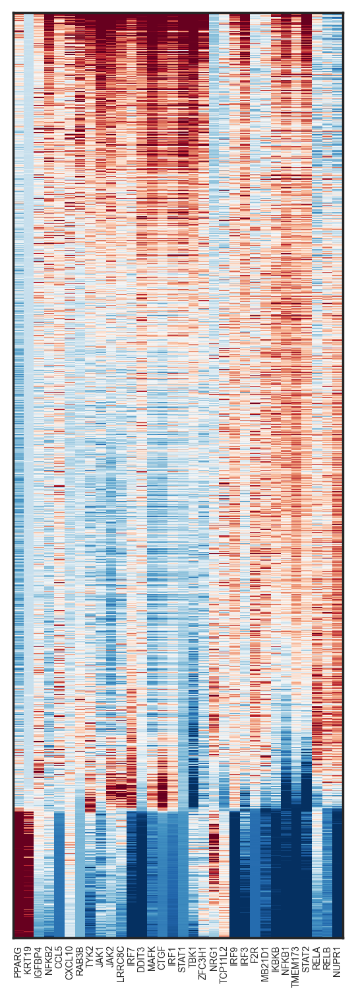

In [178]:
plot_genes = ['MB21D1','TMEM173','IRF3','RELA','RELB','IKBKB','NFKB1',
              'STAT2','CXCL10','NFKB2','CCL5',
              'TBK1','JAK1','JAK2','IRF9',
              'TYK2','IRF7','IRF1','STAT1',
              'PPARG','DDIT3','NUPR1','RAB3B','IGFBP4','LRRC8C',
              'TCP11L2','MAFK','NRG1','F2R','KRT19','CTGF','ZFC3H1']

print(len(plot_genes))

# LOAD GENESETS
path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')

subset_type = 'TUMOR'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))

# HEATMAP OF INDIVIDUAL CELLS RANKED BY LUNGE EP
rank_by = 'Castle 2'#
genesets_include = [rank_by]
genes = np.unique(genesets[genesets_include].values.ravel().tolist())
genes = [gene for gene in genes if gene in list(set(QUERY.columns))]
vals = QUERY[genes]
QUERY['GEP2_RANK'] =np.nanmean(vals,axis=1)

# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame( data = zscore(QUERY.sort_values(by=['GEP2_RANK'])[plot_genes],axis=0), 
                   columns = plot_genes, index = QUERY.sort_values(by=['GEP2_RANK']).index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'average' # average, single centroid/euclidean
metric = 'cosine' # cosine
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)
cl = hc.leaves_list(col_linkage)
mat = heatmap_data.iloc[:,cl]
#mat = heatmap_data.iloc[:,:]

window = 20
mat = mat.rolling(window, win_type='triang',center = True).sum()
half_window = int(window/2)
for ind in np.arange(half_window):
    mat.iloc[ind] = mat.iloc[half_window]    
for ind in np.arange(half_window):
    mat.iloc[-ind] = mat.iloc[-half_window]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(5,10))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.5,0.7])
colors = [(1,1,1), np.divide(tuple(hex('FF0000').rgb),255)]
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-10,vmax=10)
labels = list(mat.columns)
#labels[3] = 'CGAS'
#labels[6] = 'STING'
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
#axmatrix.set_xticklabels([]);
xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 5,fontname='Arial')
axmatrix.grid(False)
plt.tick_params(size=0)

# SAVE FIGURE
figure_label = 'STING_PATHWAY_Heatmap_EXTENDED_CLUSTERED_average_cosine'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

## HARBOUR DATASET

In [179]:
DATA_PATH_HARBOUR = DATA_PATH + '/uveal_melanoma_harbour2020/'

ADATA_HARBOUR = sc.read(DATA_PATH_HARBOUR+'merged_pipeline_out/filter2.h5ad')

In [180]:
ADATA_HARBOUR.X

<70245x33660 sparse matrix of type '<class 'numpy.float32'>'
	with 192547530 stored elements in Compressed Sparse Row format>

In [181]:
# Primary and metastatic sample sizes before filtering:
ADATA_HARBOUR.obs.sampleType.value_counts()

primary       52458
metastatic    17787
Name: sampleType, dtype: int64

In [182]:
# Sample sizes by patient before filtering:
ADATA_HARBOUR.obs['sample'].value_counts()

GSM4147095_UMM062      10702
GSM4147099_UMM066      10540
GSM4147091_BSSR0022     8805
GSM4147097_UMM064       8625
GSM4147098_UMM065       6571
GSM4147094_UMM061       6539
GSM4147092_UMM041L      5068
GSM4147093_UMM059       4229
GSM4147100_UMM067L      3914
GSM4147096_UMM063       3169
GSM4147101_UMM069       2083
Name: sample, dtype: int64

###### FILTER TO JUST TUMOR CELLS

In [183]:
DF_HARBOUR_CELLTYPES = pd.read_csv(DATA_PATH_HARBOUR+'scUM_NComms_Fig1B_metadata_MD.csv', 
                                   names=['Barcode', 'Patient', 'cellType'], header=0)
DF_HARBOUR_CELLTYPES.set_index('Barcode', inplace=True)

tumor_barcodes = DF_HARBOUR_CELLTYPES.loc[DF_HARBOUR_CELLTYPES.cellType.map(lambda x: 'Tumor' in x)].index.values

adata_harbour_barcode_list = [ADATA_HARBOUR.obs.index[x].split('-')[0] +'-'+ 
                              ADATA_HARBOUR.obs['sample'][x].split('_')[1] 
                              for x in range(len(ADATA_HARBOUR.obs))]

tumor_cell_indices = [ADATA_HARBOUR.obs.index.values[x] for x in range(len(adata_harbour_barcode_list)) 
                      if adata_harbour_barcode_list[x] in tumor_barcodes]

In [184]:
DF_HARBOUR_CELLTYPES.cellType.value_counts()

Class 2 PRAME+ Primary Tumor Cells    21292
Class 1A Primary Tumor Cells          13663
T-Cells                                9314
Macrophages/Monocytes                  5053
Class 1B PRAME+ Met Tumor Cells        4992
Class 2 PRAME- Primary Tumor Cells     2283
Plasma Cells                           1673
NK Cells                                456
Photoreceptor Cells                     265
Follicular B-Cells                      261
Endothelial Cells                       257
Fibroblasts                             241
RPE Cells                               107
Undetermined Lymphocytes                 58
Name: cellType, dtype: int64

In [185]:
ADATA_HARBOUR = ADATA_HARBOUR[tumor_cell_indices,:]

In [186]:
# Get cellTypes list for tumor cells:
adata_barcodes_cleaned = [ADATA_HARBOUR.obs.index[x].split('-')[0] +'-'+ 
                          ADATA_HARBOUR.obs['sample'][x].split('_')[1] 
                          for x in range(len(ADATA_HARBOUR.obs))]

cellTypes_list = [DF_HARBOUR_CELLTYPES.loc[DF_HARBOUR_CELLTYPES.index == x].cellType.values.tolist()[0]
                  for x in adata_barcodes_cleaned]

In [187]:
# Primary and metastatic sample sizes after filtering:
ADATA_HARBOUR.obs.sampleType.value_counts()

primary       23100
metastatic     2041
Name: sampleType, dtype: int64

In [188]:
# Show metastasis sample counts:
ADATA_HARBOUR.obs.loc[ADATA_HARBOUR.obs.sampleType.map(lambda x: x == 'metastatic')]['sample'].value_counts()

GSM4147091_BSSR0022    1335
GSM4147092_UMM041L      399
GSM4147100_UMM067L      307
GSM4147101_UMM069         0
GSM4147099_UMM066         0
GSM4147098_UMM065         0
GSM4147097_UMM064         0
GSM4147096_UMM063         0
GSM4147095_UMM062         0
GSM4147094_UMM061         0
GSM4147093_UMM059         0
Name: sample, dtype: int64

In [189]:
# Sample sizes by patient after filtering:
ADATA_HARBOUR.obs['sample'].value_counts()

GSM4147097_UMM064      5958
GSM4147094_UMM061      3810
GSM4147098_UMM065      3322
GSM4147099_UMM066      2646
GSM4147095_UMM062      2410
GSM4147093_UMM059      2380
GSM4147096_UMM063      1603
GSM4147091_BSSR0022    1335
GSM4147101_UMM069       971
GSM4147092_UMM041L      399
GSM4147100_UMM067L      307
Name: sample, dtype: int64

###### CREATE PANDAS DF TO WORK WITH

In [190]:
harbour_matrix = ADATA_HARBOUR.X.toarray()
harbour_gene_names = ADATA_HARBOUR.var.index.values.tolist()
DF_HARBOUR = pd.DataFrame(harbour_matrix, columns=harbour_gene_names)
    
DF_HARBOUR['Sample ID'] = ADATA_HARBOUR.obs['sample_num'].values.tolist()
DF_HARBOUR['Legend'] = ADATA_HARBOUR.obs['sampleType'].values.tolist()
DF_HARBOUR['Patient'] = [x.split('_')[1] for x in ADATA_HARBOUR.obs['sample'].values.tolist()]
DF_HARBOUR['Cell ID'] = DF_HARBOUR.index.values.tolist()
DF_HARBOUR['cellType'] = cellTypes_list
DF_HARBOUR.set_index(['Sample ID', 'Legend', 'Patient', 'Cell ID', 'cellType'], inplace=True)

In [191]:
DF_HARBOUR.index.get_level_values('cellType').value_counts()

Class 2 PRAME+ Primary Tumor Cells    16405
Class 1A Primary Tumor Cells           5857
Class 2 PRAME- Primary Tumor Cells     1585
Class 1B PRAME+ Met Tumor Cells        1294
Name: cellType, dtype: int64

In [192]:
DF_HARBOUR.head()

RP11-34P13.3  \
Sample ID Legend     Patient  Cell ID cellType                                        
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells           0.0   
                              1       Class 1B PRAME+ Met Tumor Cells           0.0   
                              2       Class 1B PRAME+ Met Tumor Cells           0.0   
                              3       Class 1B PRAME+ Met Tumor Cells           0.0   
                              4       Class 1B PRAME+ Met Tumor Cells           0.0   

                                                                       FAM138A  \
Sample ID Legend     Patient  Cell ID cellType                                   
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells      0.0   
                              1       Class 1B PRAME+ Met Tumor Cells      0.0   
                              2       Class 1B PRAME+ Met Tumor Cells      0.0   
                              3       Class 1B PRAME+ Met Tumor Cells      0.0   
                              4       Class 1B PRAME+ Met Tumor Cells      0.0   

                                                                       OR4F5  \
Sample ID Legend     Patient  Cell ID cellType                                 
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells    0.0   
                              1       Class 1B PRAME+ Met Tumor Cells    0.0   
                              2       Class 1B PRAME+ Met Tumor Cells    0.0   
                              3       Class 1B PRAME+ Met Tumor Cells    0.0   
                              4       Class 1B PRAME+ Met Tumor Cells    0.0   

                                                                       RP11-34P13.7  \
Sample ID Legend     Patient  Cell ID cellType                                        
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells           0.0   
                              1       Class 1B PRAME+ Met Tumor Cells           0.0   
                              2       Class 1B PRAME+ Met Tumor Cells           0.0   
                              3       Class 1B PRAME+ Met Tumor Cells           0.0   
                              4       Class 1B PRAME+ Met Tumor Cells           0.0   

                                                                       RP11-34P13.8  \
Sample ID Legend     Patient  Cell ID cellType                                        
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells           0.0   
                              1       Class 1B PRAME+ Met Tumor Cells           0.0   
                              2       Class 1B PRAME+ Met Tumor Cells           0.0   
                              3       Class 1B PRAME+ Met Tumor Cells           0.0   
                              4       Class 1B PRAME+ Met Tumor Cells           0.0   

                                                                       RP11-34P13.14  \
Sample ID Legend     Patient  Cell ID cellType                                         
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells            0.0   
                              1       Class 1B PRAME+ Met Tumor Cells            0.0   
                              2       Class 1B PRAME+ Met Tumor Cells            0.0   
                              3       Class 1B PRAME+ Met Tumor Cells            0.0   
                              4       Class 1B PRAME+ Met Tumor Cells            0.0   

                                                                       RP11-34P13.9  \
Sample ID Legend     Patient  Cell ID cellType                                        
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells           0.0   
                              1       Class 1B PRAME+ Met Tumor Cells           0.0   
                              2       Class 1B PRAME+ Met Tumor Cells           0.0   
                              3       Class 1B PRAME+

###### FILTER OUT GENES THAT AREN'T EXPRESSED IN ANY CELLS

In [193]:
DF_HARBOUR = DF_HARBOUR.loc[:, (DF_HARBOUR != 0).any(axis=0)]

###### GET DF OF JUST PRIMARY TUMOR CELLS:

In [194]:
DF_HARBOUR_PRIMARY = DF_HARBOUR.loc[DF_HARBOUR.index.map(lambda x: x[1] == 'primary')]
DF_HARBOUR_METASTASIS = DF_HARBOUR.loc[DF_HARBOUR.index.map(lambda x: x[1] == 'metastatic')]

###### WRITE DATAFRAMES TO h5 FOR CELLASSIGN

In [195]:
h5_data_harbour = seqc.H5(DATA_PATH_HARBOUR+'UVMEL_HARBOUR.h5')

#### NORMALIZE HARBOUR DATA

In [196]:
NDF_HARBOUR = DF_HARBOUR.copy()
molecule_sums = NDF_HARBOUR.sum(axis=1)

NDF_HARBOUR = NDF_HARBOUR.div(molecule_sums, axis=0).mul(np.median(molecule_sums), axis=0)

In [197]:
NDF_HARBOUR.to_hdf(DATA_PATH_HARBOUR+'UVMEL_HARBOUR.h5', key='NDF_TUMOR')

In [198]:
NDF_HARBOUR_PRIMARY = DF_HARBOUR_PRIMARY.copy()
molecule_sums_PRIMARY = NDF_HARBOUR_PRIMARY.sum(axis=1)

NDF_HARBOUR_PRIMARY = NDF_HARBOUR_PRIMARY.div(molecule_sums_PRIMARY, axis=0).mul(np.median(molecule_sums_PRIMARY), 
                                                                                 axis=0)

In [199]:
NDF_HARBOUR_PRIMARY.to_hdf(DATA_PATH_HARBOUR+'UVMEL_HARBOUR.h5', key='NDF_TUMOR_PRIMARY')

#### PERFORM IMPUTATION ON NDF_HARBOUR

###### FILTER LOW ABUNDANCE GENES

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_filter_genes.png
Count Gene Filter 1: 1771
Count Gene Filter 2: 4489
(25141, 22039)
(25141, 22039)
22039


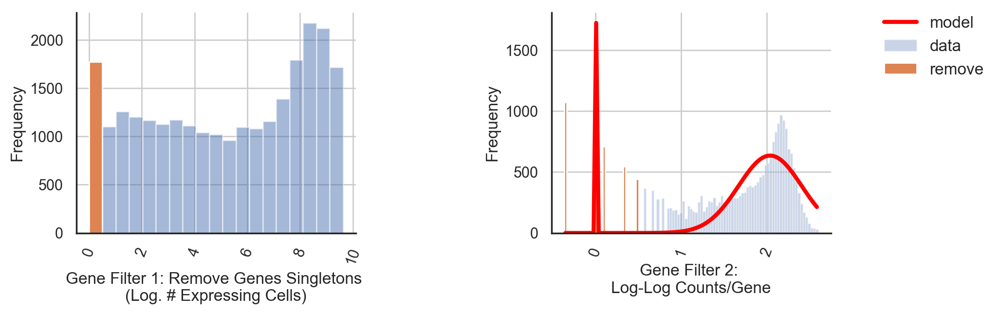

In [200]:
# FIT BINOMIAL DISTRIBUTION AND FILTER BASED ON MEAN/STD OF SECOND
plt.figure(figsize = (10,3))
gs1 = gridspec.GridSpec(1, 2)
gs1.update(wspace=0.7, hspace=0.7) # set the spacing between axes. 

# (4) PLOT LOG NUMBER OF CELLS CONTRIBUTING TO EACH GENE
num_cells_per_gene = np.log(np.sum(DF_HARBOUR.values > 0,axis=0))
num_cells_per_gene[(np.isinf(num_cells_per_gene)) | (np.isnan(num_cells_per_gene))] = 0
rmv_genes1 = np.where(num_cells_per_gene<=0)[0] # GENES MUST BE DETECTED IN AT LEAST 10 CELLS

ax = plt.subplot(gs1[0])
bins = np.linspace(num_cells_per_gene.min(), num_cells_per_gene.max()*0.95, 20)
plt.hist(num_cells_per_gene, bins, alpha=0.5, label='keep')

if rmv_genes1.any():
    plt.hist(num_cells_per_gene[rmv_genes1], bins, alpha=1, label='remove')
    
#ax.set_axis_facecolor('white')
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('Gene Filter 1: Remove Genes Singletons \n(Log. # Expressing Cells)')
plt.grid(True)
sns.despine()

# (5) PLOT LOG COUNTS PER GENE - REMOVE LOW ABUNDANCE GENES
log_counts_per_gene = np.log(np.log(np.sum(DF_HARBOUR.values,axis=0)))
log_counts_per_gene[(np.isinf(log_counts_per_gene)) | (np.isnan(log_counts_per_gene))] = 0
data = log_counts_per_gene

ax = plt.subplot(gs1[1])
bins = np.linspace(data.min(), data.max()*0.95, 100)
y,x,_=hist(data,bins,alpha=.3,label='data')

x=(x[1:]+x[:-1])/2 
expected=(0,.2,3500,1.5,.2,500)
params,cov=curve_fit(bimodal,x,y,expected)
sigma=sqrt(diag(cov))
plot(x,bimodal(x,*params),color='red',lw=3,label='model')

mu1 = params[0]
std1 = params[1]
mu2 = params[3]
std2 = params[4]
rmv_genes_neg = np.where(data<mu2-4*std2)[0]
rmv_genes2 = np.sort(list(set(list(rmv_genes_neg))))

if rmv_genes2.any():
    plt.hist(data[rmv_genes2], bins, alpha=1, label='remove')
    
#ax.set_axis_facecolor('white')
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('Gene Filter 2: \nLog-Log Counts/Gene')
plt.grid(True)
sns.despine()

# Add (abbreviated) legend bottom left
L = plt.legend(loc='upper right',prop={'size':12},bbox_to_anchor=(1.6, 1.05),fancybox=True) 

# SAVE FIGURE
figure_label = '_filter_genes'
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label + '.png'
plt.savefig(fn, dpi=fig_dpi)
print(fn)

# EVALUATE NUMBER OF CELLS/GENES REMOVED
print('Count Gene Filter 1: {}'.format(len(rmv_genes1)))
print('Count Gene Filter 2: {}'.format(len(rmv_genes2)))

# REMOVE SELECTED OUTLIER GENES(HIGHLIGHTED IN GREEN)
CUT_DF = deepcopy(DF_HARBOUR)
rmv_genes = np.sort(list(set(list(rmv_genes1) + list(rmv_genes2))))
if rmv_genes.any():
    CUT_DF = CUT_DF.drop(CUT_DF.columns[rmv_genes],axis=1)
    print(CUT_DF.shape)
    
# Remove empty genes if they exist
drop_genes = np.where(CUT_DF.sum(axis=0)==0)[0]
CUT_DF = CUT_DF.drop(CUT_DF.columns[drop_genes],axis=1)
print(CUT_DF.shape)

# GENES EXCLUDING LOW ABUNDANCE GENES
goi = list(CUT_DF.columns)
print(len(goi))

###### RANDOMIZED PCA

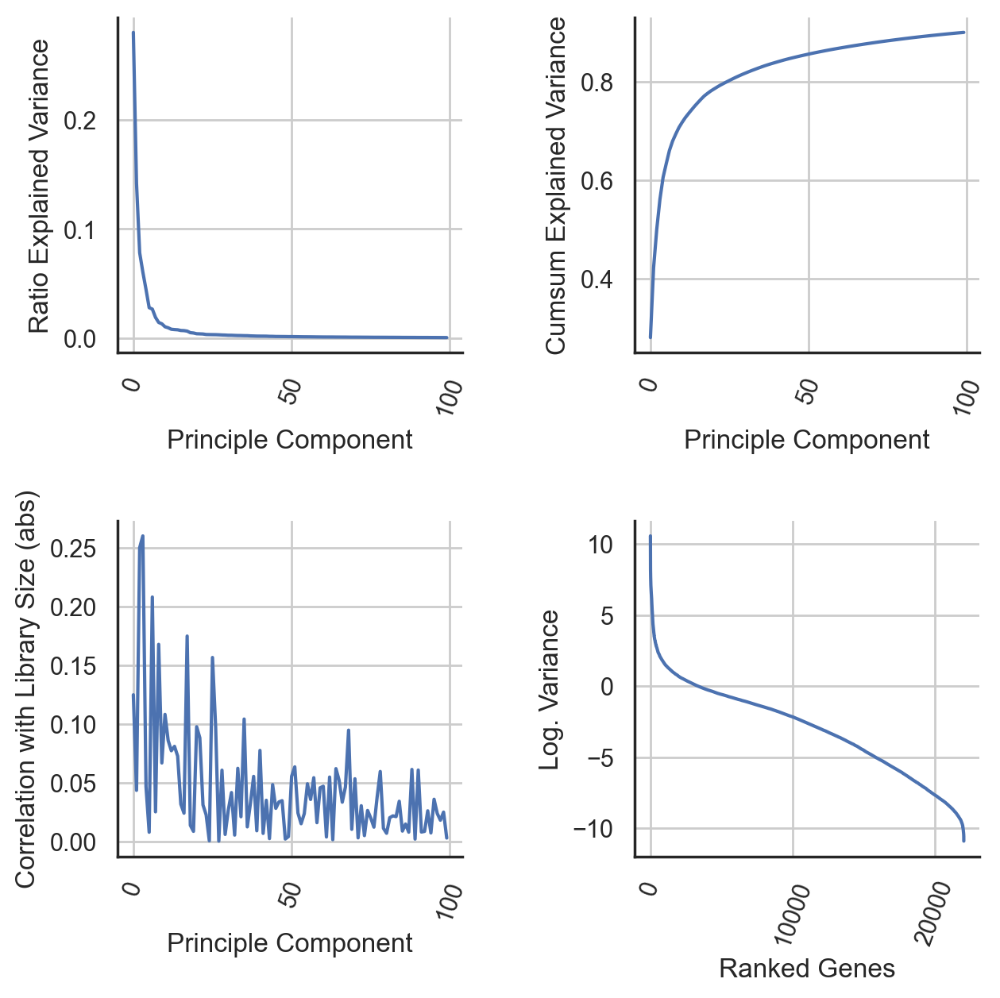

In [201]:
data = NDF_HARBOUR[goi]
pca = PCA(n_components=100, whiten = False, svd_solver='randomized')
PCA_FIT = pca.fit(data)# cells/observations x genes/features

explained_variance = PCA_FIT.explained_variance_ratio_ # explained variance
cumsum_explained_variance = np.cumsum(explained_variance) # cumulative sum of explained variance
PCA_DATA = PCA_FIT.transform(data) # transformed data

# Store output of pca in dictionary for WISHBONE
eigenvalues = pd.Series(pca.explained_variance_,index = np.arange(pca.n_components))
loadings = pd.DataFrame(PCA_FIT.components_.T, index = data.columns, columns = np.arange(pca.n_components))
pca_dict = {'eigenvalues':eigenvalues,'loadings':loadings}

# Correlation of each PC component with library size

x = molecule_sums.values.tolist()

R = np.zeros(PCA_DATA.shape[1])
for ind in np.arange(PCA_DATA.shape[1]):
    y = PCA_DATA[:,ind]
    R[ind] = np.corrcoef(x,y)[1,0] # correlation coefficient

nrow = 2
ncol = 2
plt.figure(figsize=(7,7))
gs1 = gridspec.GridSpec(nrow,ncol)
gs1.update(wspace = 0.5, hspace = 0.5)

# Variance of each gene
gene_variance = np.var(data, axis=0)
variance_sort_idx =gene_variance.argsort()[::-1]
ranked_gene_variance = gene_variance[variance_sort_idx]

# Plot explained variance
ax = plt.subplot(gs1[0])
plt.plot(explained_variance)
plt.xticks(rotation=70)
plt.ylabel('Ratio Explained Variance')
plt.xlabel('Principle Component')
plt.grid(True)
sns.despine()

# Plot cumulative sum of explained variance
ax = plt.subplot(gs1[1])
plt.plot(cumsum_explained_variance)
plt.xticks(rotation=70)
plt.ylabel('Cumsum Explained Variance')
plt.xlabel('Principle Component')
plt.grid(True)
sns.despine()

# Plot correlatin of library size with each PC
ax = plt.subplot(gs1[2])
plt.plot(np.abs(R))
plt.xticks(rotation=70)
plt.ylabel('Correlation with Library Size (abs)')
plt.xlabel('Principle Component')
plt.grid(True)
sns.despine()

# Plot ranked variance of each gene
ax = plt.subplot(gs1[3])
plt.plot(np.log(ranked_gene_variance.values))
plt.xticks(rotation=70)
plt.ylabel('Log. Variance')
plt.xlabel('Ranked Genes')
plt.grid(True)
sns.despine()

Text(0.5, 1.0, 'knee: 17')

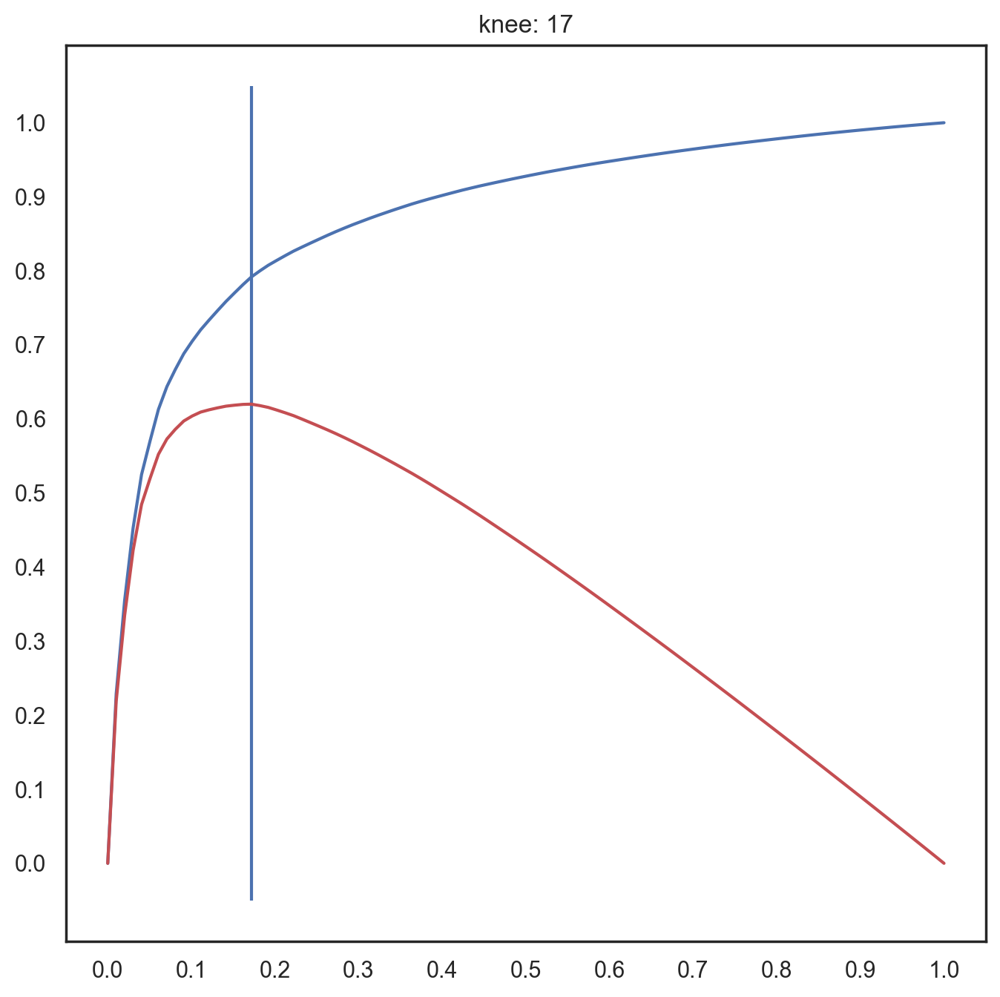

In [202]:
# IDENTIFY POINT OF MAXIMUM CURVATURE IN CUMULATIVE EXPLAINED VARIANCE
y = cumsum_explained_variance
x = np.arange(len(y))
kneedle = KneeLocator(x, y)
kneedle.plot_knee_normalized()
knee = kneedle.knee
plt.title('knee: {}'.format(knee))

In [203]:
cumsum_explained_variance[31]

0.8197878

In [204]:
PCA_DATA.shape

(25141, 100)

In [205]:
# SELECT DATA ASSOCIATED WITH RELEVANT PCS (REMOVE PC0 if highly correlated with cell size)
ncomponents = knee*2
COMPONENTS = np.arange(ncomponents)
print(COMPONENTS)

# LOADING PER COMPONENT
loadings = PCA_FIT.components_.T[:,COMPONENTS]

labels = []
for i in COMPONENTS:
    labels.append('PC{}'.format(i))

data = NDF_HARBOUR[goi]
data -= np.min(np.ravel(data))
data /= np.max(np.ravel(data))
data = pd.DataFrame(np.dot(data, loadings).astype(np.float64),index=data.index, columns = labels)


# WRITE TO H5
DIMENSIONS_HARBOUR_TUMOR = data.copy()
exec('h5_data_harbour.save(DIMENSIONS_HARBOUR_{}, \'DIMENSIONS_HARBOUR_{}\')'
     .format(subset_type,subset_type)) # update directory
h5_data_harbour.ls() # list contents of directory

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33]
<class 'pandas.io.pytables.HDFStore'>
File path: /workdir/uvmel_project/data//uveal_melanoma_harbour2020/UVMEL_HARBOUR.h5



###### REGRESS LIBRARY SIZE OUT OF PCS

In [206]:
exec('QUERY = DIMENSIONS_HARBOUR_{}'.format(subset_type))
idx = QUERY.columns.to_series().str.contains('^PC((?!TSNE).)*$') # select from DIMS_NDF
PCA_DATA = QUERY.loc[:, idx.values]
counts = DF_HARBOUR.copy()

num_comps = PCA_DATA.shape[1]

pca_regressed_out_lib_size = deepcopy(PCA_DATA)
for c in range(num_comps):
    lm = LinearRegression(normalize=False)
    X = counts.sum(axis=1).values.reshape(counts.shape[0], 1)
    Y = PCA_DATA.iloc[:, c]
    lm.fit(X, Y)
    pca_regressed_out_lib_size.iloc[:,c] = Y-lm.predict(X)
    
# Add SUFIX FOR REGRESSED LIB SIZE (RLS)
pca_regressed_out_lib_size = pca_regressed_out_lib_size.add_prefix('RLS_')

for label in pca_regressed_out_lib_size.columns:
    exec('DIMENSIONS_HARBOUR_{}[label]= pca_regressed_out_lib_size[label]'.format(subset_type))
    
# WRITE TO H5
exec('h5_data_harbour.save(DIMENSIONS_HARBOUR_{}, \'DIMENSIONS_HARBOUR_{}\')'.
     format(subset_type,subset_type)) # update directory
h5_data_harbour.ls() # list contents of directory

<class 'pandas.io.pytables.HDFStore'>
File path: /workdir/uvmel_project/data//uveal_melanoma_harbour2020/UVMEL_HARBOUR.h5



###### CALCULATE DIFFUSIONS COEFFICIENTS

In [207]:
knn = 27 # truncate the neighbors to the k closest points

component_prefix = 'RLS_PC'
exec('QUERY = DIMENSIONS_HARBOUR_{}'.format(subset_type))
idx = QUERY.columns.to_series().str.contains('^{}((?!TSNE).)*$'.format(component_prefix)) # select from DIMS_NDF
PCA_DATA = QUERY.loc[:, idx.values]

DIFFUSION_EIGS = palantir.utils.run_diffusion_maps(PCA_DATA.astype(np.float64), knn=knn)

Determing nearest neighbor graph...


In [208]:
DF_HARBOUR_PRIMARY.index.get_level_values('Patient').value_counts()

UMM064    5958
UMM061    3810
UMM065    3322
UMM066    2646
UMM062    2410
UMM059    2380
UMM063    1603
UMM069     971
Name: Patient, dtype: int64

In [209]:
DF_TUMOR.index.get_level_values('Patient').value_counts()

UM01    7436
UM04    2780
UM05    2587
UM03    2375
UM02     720
UM06     179
Name: Patient, dtype: int64

###### IMPUTE MISSING VALUES

In [210]:
imputed_data_matrix = palantir.utils.run_magic_imputation(NDF_HARBOUR, DIFFUSION_EIGS, n_steps=3)

In [211]:
INDF_HARBOUR = imputed_data_matrix.copy()
exec('h5_data_harbour.save(INDF_HARBOUR,\'INDF_HARBOUR\')')

#### PERFORM IMPUTATION ON NDF_HARBOUR_PRIMARY

###### FILTER LOW ABUNDANCE GENES

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_filter_genes.png
Count Gene Filter 1: 2104
Count Gene Filter 2: 5564
(23100, 20967)
(23100, 20967)
20967


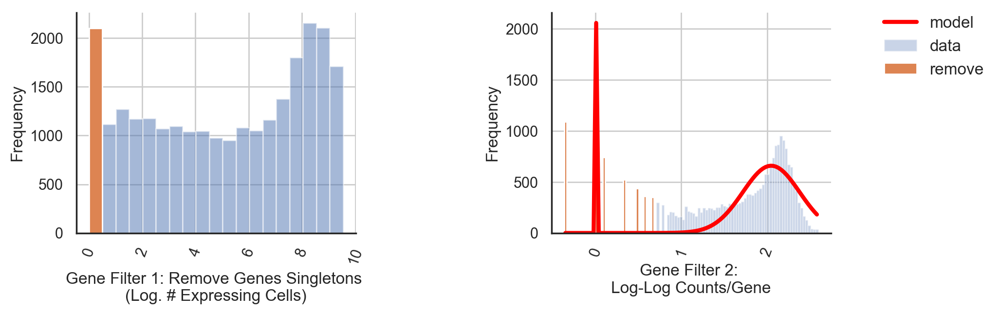

In [212]:
# FIT BINOMIAL DISTRIBUTION AND FILTER BASED ON MEAN/STD OF SECOND
plt.figure(figsize = (10,3))
gs1 = gridspec.GridSpec(1, 2)
gs1.update(wspace=0.7, hspace=0.7) # set the spacing between axes. 

# (4) PLOT LOG NUMBER OF CELLS CONTRIBUTING TO EACH GENE
num_cells_per_gene = np.log(np.sum(DF_HARBOUR_PRIMARY.values > 0,axis=0))
num_cells_per_gene[(np.isinf(num_cells_per_gene)) | (np.isnan(num_cells_per_gene))] = 0
rmv_genes1 = np.where(num_cells_per_gene<=0)[0] # GENES MUST BE DETECTED IN AT LEAST 10 CELLS

ax = plt.subplot(gs1[0])
bins = np.linspace(num_cells_per_gene.min(), num_cells_per_gene.max()*0.95, 20)
plt.hist(num_cells_per_gene, bins, alpha=0.5, label='keep')

if rmv_genes1.any():
    plt.hist(num_cells_per_gene[rmv_genes1], bins, alpha=1, label='remove')
    
#ax.set_axis_facecolor('white')
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('Gene Filter 1: Remove Genes Singletons \n(Log. # Expressing Cells)')
plt.grid(True)
sns.despine()

# (5) PLOT LOG COUNTS PER GENE - REMOVE LOW ABUNDANCE GENES
log_counts_per_gene = np.log(np.log(np.sum(DF_HARBOUR_PRIMARY.values,axis=0)))
log_counts_per_gene[(np.isinf(log_counts_per_gene)) | (np.isnan(log_counts_per_gene))] = 0
data = log_counts_per_gene

ax = plt.subplot(gs1[1])
bins = np.linspace(data.min(), data.max()*0.95, 100)
y,x,_=hist(data,bins,alpha=.3,label='data')

x=(x[1:]+x[:-1])/2 
expected=(0,.2,3500,1.5,.2,500)
params,cov=curve_fit(bimodal,x,y,expected)
sigma=sqrt(diag(cov))
plot(x,bimodal(x,*params),color='red',lw=3,label='model')

mu1 = params[0]
std1 = params[1]
mu2 = params[3]
std2 = params[4]
rmv_genes_neg = np.where(data<mu2-4*std2)[0]
rmv_genes2 = np.sort(list(set(list(rmv_genes_neg))))

if rmv_genes2.any():
    plt.hist(data[rmv_genes2], bins, alpha=1, label='remove')
    
#ax.set_axis_facecolor('white')
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('Gene Filter 2: \nLog-Log Counts/Gene')
plt.grid(True)
sns.despine()

# Add (abbreviated) legend bottom left
L = plt.legend(loc='upper right',prop={'size':12},bbox_to_anchor=(1.6, 1.05),fancybox=True) 

# SAVE FIGURE
figure_label = '_filter_genes'
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label + '.png'
plt.savefig(fn, dpi=fig_dpi)
print(fn)

# EVALUATE NUMBER OF CELLS/GENES REMOVED
print('Count Gene Filter 1: {}'.format(len(rmv_genes1)))
print('Count Gene Filter 2: {}'.format(len(rmv_genes2)))

# REMOVE SELECTED OUTLIER GENES(HIGHLIGHTED IN GREEN)
CUT_DF = deepcopy(DF_HARBOUR_PRIMARY)
rmv_genes = np.sort(list(set(list(rmv_genes1) + list(rmv_genes2))))
if rmv_genes.any():
    CUT_DF = CUT_DF.drop(CUT_DF.columns[rmv_genes],axis=1)
    print(CUT_DF.shape)
    
# Remove empty genes if they exist
drop_genes = np.where(CUT_DF.sum(axis=0)==0)[0]
CUT_DF = CUT_DF.drop(CUT_DF.columns[drop_genes],axis=1)
print(CUT_DF.shape)

# GENES EXCLUDING LOW ABUNDANCE GENES
goi = list(CUT_DF.columns)
print(len(goi))

###### RANDOMIZED PCA

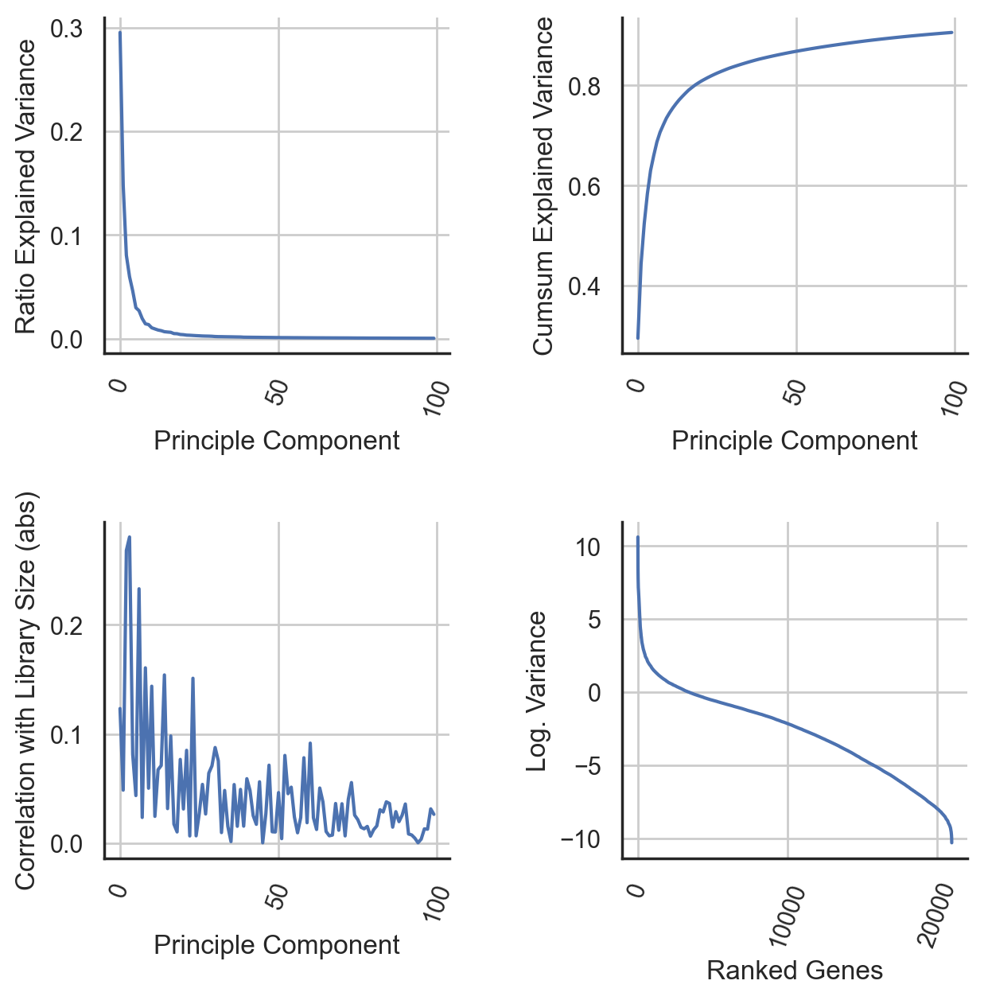

In [213]:
data = NDF_HARBOUR_PRIMARY[goi]
pca = PCA(n_components=100, whiten = False, svd_solver='randomized')
PCA_FIT = pca.fit(data)# cells/observations x genes/features

explained_variance = PCA_FIT.explained_variance_ratio_ # explained variance
cumsum_explained_variance = np.cumsum(explained_variance) # cumulative sum of explained variance
PCA_DATA = PCA_FIT.transform(data) # transformed data

# Store output of pca in dictionary for WISHBONE
eigenvalues = pd.Series(pca.explained_variance_,index = np.arange(pca.n_components))
loadings = pd.DataFrame(PCA_FIT.components_.T, index = data.columns, columns = np.arange(pca.n_components))
pca_dict = {'eigenvalues':eigenvalues,'loadings':loadings}

# Correlation of each PC component with library size

x = molecule_sums_PRIMARY.values.tolist()

R = np.zeros(PCA_DATA.shape[1])
for ind in np.arange(PCA_DATA.shape[1]):
    y = PCA_DATA[:,ind]
    R[ind] = np.corrcoef(x,y)[1,0] # correlation coefficient

nrow = 2
ncol = 2
plt.figure(figsize=(7,7))
gs1 = gridspec.GridSpec(nrow,ncol)
gs1.update(wspace = 0.5, hspace = 0.5)

# Variance of each gene
gene_variance = np.var(data, axis=0)
variance_sort_idx =gene_variance.argsort()[::-1]
ranked_gene_variance = gene_variance[variance_sort_idx]

# Plot explained variance
ax = plt.subplot(gs1[0])
plt.plot(explained_variance)
plt.xticks(rotation=70)
plt.ylabel('Ratio Explained Variance')
plt.xlabel('Principle Component')
plt.grid(True)
sns.despine()

# Plot cumulative sum of explained variance
ax = plt.subplot(gs1[1])
plt.plot(cumsum_explained_variance)
plt.xticks(rotation=70)
plt.ylabel('Cumsum Explained Variance')
plt.xlabel('Principle Component')
plt.grid(True)
sns.despine()

# Plot correlatin of library size with each PC
ax = plt.subplot(gs1[2])
plt.plot(np.abs(R))
plt.xticks(rotation=70)
plt.ylabel('Correlation with Library Size (abs)')
plt.xlabel('Principle Component')
plt.grid(True)
sns.despine()

# Plot ranked variance of each gene
ax = plt.subplot(gs1[3])
plt.plot(np.log(ranked_gene_variance.values))
plt.xticks(rotation=70)
plt.ylabel('Log. Variance')
plt.xlabel('Ranked Genes')
plt.grid(True)
sns.despine()

Text(0.5, 1.0, 'knee: 16')

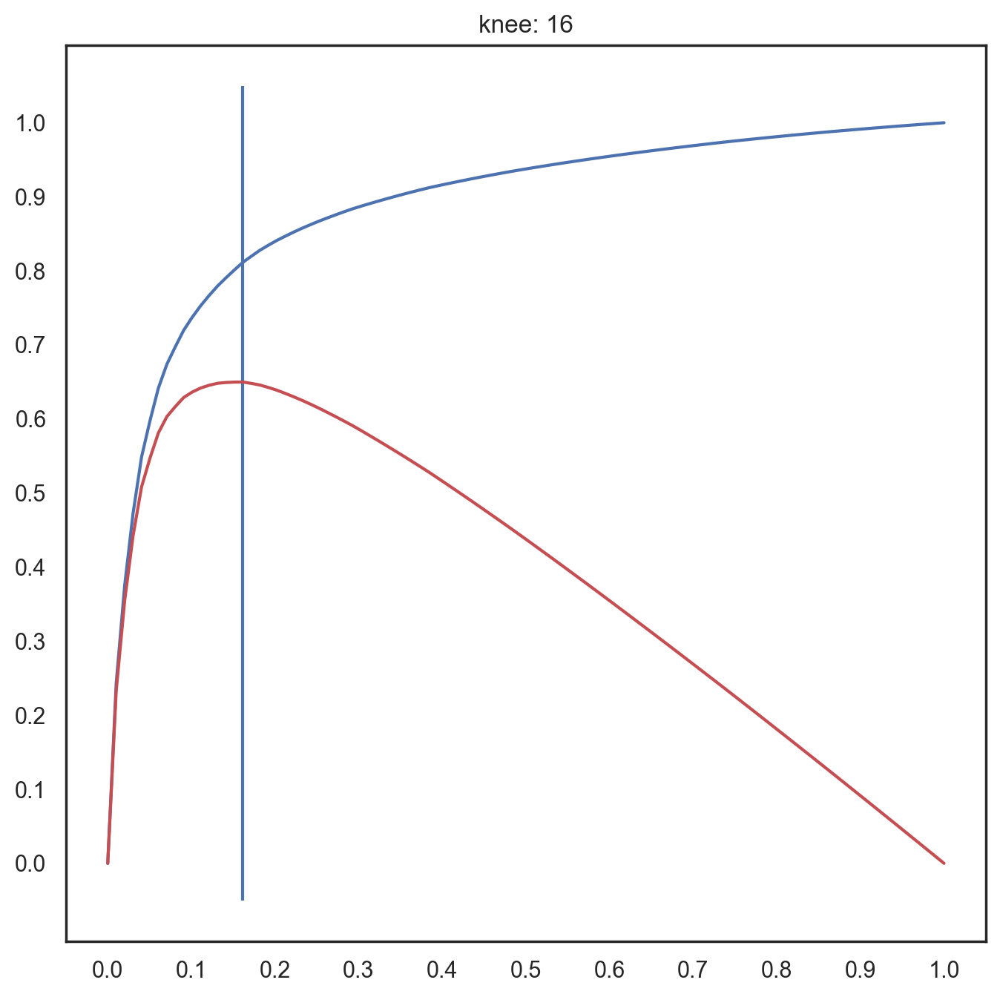

In [214]:
# IDENTIFY POINT OF MAXIMUM CURVATURE IN CUMULATIVE EXPLAINED VARIANCE
y = cumsum_explained_variance
x = np.arange(len(y))
kneedle = KneeLocator(x, y)
kneedle.plot_knee_normalized()
knee = kneedle.knee
plt.title('knee: {}'.format(knee))

In [215]:
# SELECT DATA ASSOCIATED WITH RELEVANT PCS (REMOVE PC0 if highly correlated with cell size)
ncomponents = knee*2
COMPONENTS = np.arange(ncomponents)
print(COMPONENTS)

# LOADING PER COMPONENT
loadings = PCA_FIT.components_.T[:,COMPONENTS]

labels = []
for i in COMPONENTS:
    labels.append('PC{}'.format(i))

data = NDF_HARBOUR_PRIMARY[goi]
data -= np.min(np.ravel(data))
data /= np.max(np.ravel(data))
data = pd.DataFrame(np.dot(data, loadings).astype(np.float64),index=data.index, columns = labels)


# WRITE TO H5
DIMENSIONS_HARBOUR_TUMOR_PRIMARY = data.copy()
exec('h5_data_harbour.save(DIMENSIONS_HARBOUR_TUMOR_PRIMARY, \'DIMENSIONS_HARBOUR_TUMOR_PRIMARY\')')# update directory
h5_data_harbour.ls() # list contents of directory

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31]
<class 'pandas.io.pytables.HDFStore'>
File path: /workdir/uvmel_project/data//uveal_melanoma_harbour2020/UVMEL_HARBOUR.h5



###### REGRESS LIBRARY SIZE OUT OF PCS

In [216]:
exec('QUERY = DIMENSIONS_HARBOUR_TUMOR_PRIMARY')
idx = QUERY.columns.to_series().str.contains('^PC((?!TSNE).)*$') # select from DIMS_NDF
PCA_DATA = QUERY.loc[:, idx.values]
counts = DF_HARBOUR_PRIMARY.copy()

num_comps = PCA_DATA.shape[1]

pca_regressed_out_lib_size = deepcopy(PCA_DATA)
for c in range(num_comps):
    lm = LinearRegression(normalize=False)
    X = counts.sum(axis=1).values.reshape(counts.shape[0], 1)
    Y = PCA_DATA.iloc[:, c]
    lm.fit(X, Y)
    pca_regressed_out_lib_size.iloc[:,c] = Y-lm.predict(X)
    
# Add SUFIX FOR REGRESSED LIB SIZE (RLS)
pca_regressed_out_lib_size = pca_regressed_out_lib_size.add_prefix('RLS_')

for label in pca_regressed_out_lib_size.columns:
    exec('DIMENSIONS_HARBOUR_TUMOR_PRIMARY[label]= pca_regressed_out_lib_size[label]')
    
# WRITE TO H5
exec('h5_data_harbour.save(DIMENSIONS_HARBOUR_TUMOR_PRIMARY, \'DIMENSIONS_HARBOUR_TUMOR_PRIMARY\')')# update directory
h5_data_harbour.ls() # list contents of directory

<class 'pandas.io.pytables.HDFStore'>
File path: /workdir/uvmel_project/data//uveal_melanoma_harbour2020/UVMEL_HARBOUR.h5



###### CALCULATE DIFFUSION COEFFICIENTS

In [217]:
knn = 27 # truncate the neighbors to the k closest points

component_prefix = 'RLS_PC'
exec('QUERY = DIMENSIONS_HARBOUR_TUMOR_PRIMARY')
idx = QUERY.columns.to_series().str.contains('^{}((?!TSNE).)*$'.format(component_prefix)) # select from DIMS_NDF
PCA_DATA = QUERY.loc[:, idx.values]

DIFFUSION_EIGS = palantir.utils.run_diffusion_maps(PCA_DATA.astype(np.float64), knn=knn)

Determing nearest neighbor graph...


###### IMPUTE MISSING VALUES 

In [218]:
imputed_data_matrix = palantir.utils.run_magic_imputation(NDF_HARBOUR_PRIMARY, DIFFUSION_EIGS, n_steps=3)
INDF_HARBOUR_PRIMARY = imputed_data_matrix.copy()
exec('h5_data_harbour.save(INDF_HARBOUR_PRIMARY,\'INDF_HARBOUR_PRIMARY\')')

### MIXTURE MODEL - HARBOUR DATASET

#### MIXTURE MODEL FOR TCGA CLASSIFICATION

In [369]:
# Using imputed normalized Harbour data:
datatype = 'INDF_HARBOUR'
exec('QUERY = {}'.format(datatype))

# Using tumor cell subset:
subset_type = 'TUMOR'

gene1 = 'TCGA1'
signature_genes = TCGA_markerfile_df.loc[TCGA_markerfile_df[gene1] == 1].index.values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals1 = (np.nanmean(QUERY[detected_genes],axis=1))

gene2 = 'TCGA2'
signature_genes = TCGA_markerfile_df.loc[TCGA_markerfile_df[gene2] == 1].index.values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals2 = (np.nanmean(QUERY[detected_genes],axis=1))

gene3 = 'TCGA3'
signature_genes = TCGA_markerfile_df.loc[TCGA_markerfile_df[gene3] == 1].index.values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals3 = (np.nanmean(QUERY[detected_genes],axis=1))

gene4 = 'TCGA4'
signature_genes = TCGA_markerfile_df.loc[TCGA_markerfile_df[gene4] == 1].index.values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals4 = (np.nanmean(QUERY[detected_genes],axis=1))

X = pd.DataFrame(data = {gene1: vals1, gene2: vals2, gene3: vals3, gene4: vals4}, index = QUERY.index)

In [370]:
# Find optimal random seed for knn initialization step of the BGMM:
rs_opt = 0
while rs in range(1,50) and rs_opt == 0:
    X_test = X.copy()
    bgmm = BayesianGaussianMixture(covariance_type='tied', n_components=4, random_state=rs)
    bgmm.fit(X_test[['TCGA1','TCGA2','TCGA3','TCGA4']])
    clusters = bgmm.predict(X_test[['TCGA1','TCGA2','TCGA3','TCGA4']])
    
    X_test['Assignment'] = clusters
    
    # Make Class Assignments
    lut ={}
    mean_array = []
    for ii in np.unique(X_test['Assignment']):
        mean_array.append([X_test[X_test['Assignment']==ii][x].mean() for x in TCGA_CLASS_LIST])
    mean_array = np.array(mean_array)

    for i in range(len(np.unique(X_test['Assignment']))):
        max_ind = np.unravel_index(np.argmax(mean_array, axis=None), mean_array.shape)
        lut[max_ind[0]] = TCGA_CLASS_LIST[max_ind[1]]
        mean_array[:,max_ind[1]] = 0
        mean_array[max_ind[0],:] = 0

    # MAP ASSIGNMENTS
    X_test['Assignment'] = X_test['Assignment'].map(lut)
    
    if (X_test.Assignment.value_counts().keys()[0] in ['TCGA3', 'TCGA4']):
        rs_opt = rs
        X_test = []

In [371]:
# Train BGMM:
# NOTE: Occasionally the bgmm results can vary here, changing the random_state value will help (recommend using: 33)

bgmm = BayesianGaussianMixture(covariance_type='tied', n_components=4, random_state=rs_opt)
bgmm.fit(X[['TCGA1','TCGA2','TCGA3','TCGA4']])
clusters = bgmm.predict(X[['TCGA1','TCGA2','TCGA3','TCGA4']])

# Create T-SNE:
X_embedded = manifold.TSNE(n_components=2, random_state=2).fit_transform(X[['TCGA1','TCGA2','TCGA3','TCGA4']])
X['tsne1'] = X_embedded[:,0]
X['tsne2'] = X_embedded[:,1]

X['Assignment'] = clusters

/workdir/uvmel_project/figures/final_figures_10_27_20/HARBOUR_BayesianGMM_TCGA


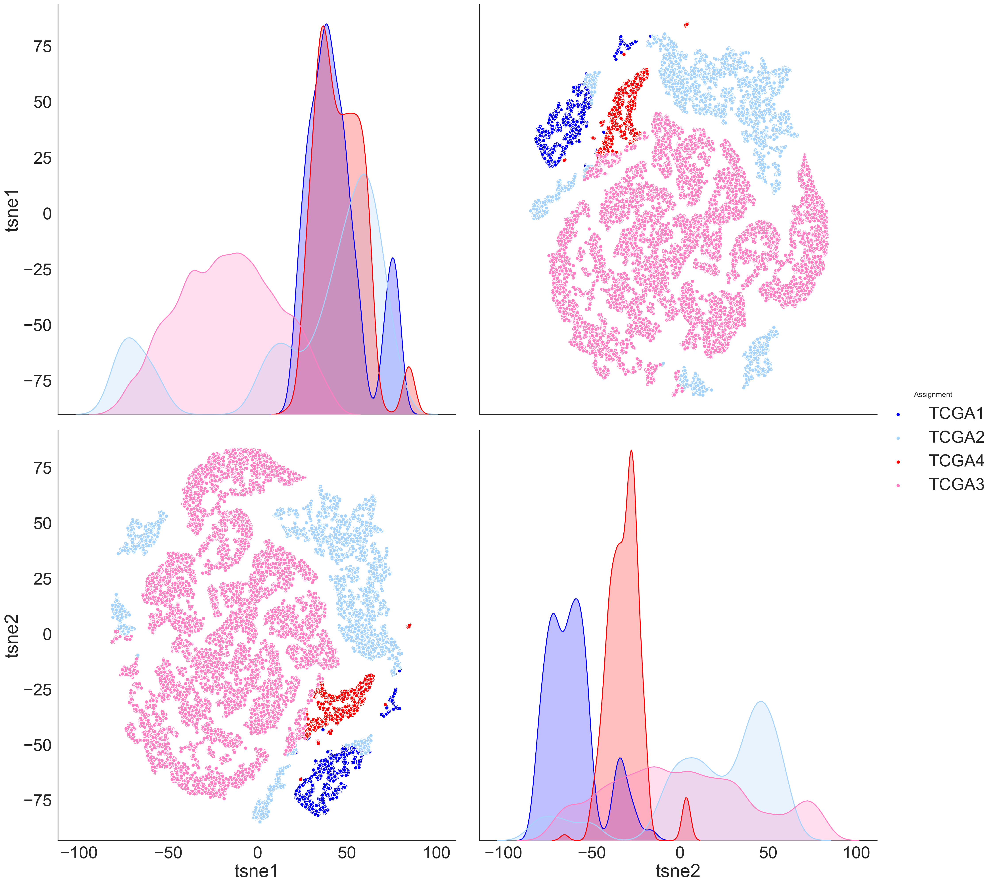

In [372]:
# Make Class Assignments
lut ={}
mean_array = []
for ii in np.unique(X['Assignment']):
    mean_array.append([X[X['Assignment']==ii][x].mean() for x in TCGA_CLASS_LIST])
mean_array = np.array(mean_array)

for i in range(len(np.unique(X['Assignment']))):
    max_ind = np.unravel_index(np.argmax(mean_array, axis=None), mean_array.shape)
    lut[max_ind[0]] = TCGA_CLASS_LIST[max_ind[1]]
    mean_array[:,max_ind[1]] = 0
    mean_array[max_ind[0],:] = 0

# MAP ASSIGNMENTS
X['Assignment'] = X['Assignment'].map(lut)

sns.set(font_scale=2.5)
sns.set_style("white")
g = sns.pairplot(X[['tsne1','tsne2','Assignment']], 
                 hue = 'Assignment',
                 palette={"TCGA1": "#0000FF",
                          "TCGA2": "#A4D3FC",
                          "TCGA3": "#FF7DC2", 
                          "TCGA4": "#FF0000",},
            diag_kind = 'kde', aspect = 1, size = 10);


# SAVE FIGURE
figure_label = 'HARBOUR_BayesianGMM_TCGA'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
g.savefig(fn + '.png', dpi=400, transparent=True)
g.savefig(fn + '.pdf', dpi=400)
print(fn)

In [373]:
# UPDATE DIRECTORY
X['TCGA_Assignment'] = X.Assignment.values
METADATA_HARBOUR = X[['TCGA_Assignment']].copy()
exec('h5_data_harbour.save(METADATA_HARBOUR, \'METADATA_HARBOUR\')')

#### INTRATUMOR TCGA HETEROGENEITY

###### TCGA DISTRIBUTION PER PATIENT

/workdir/uvmel_project/figures/final_figures_10_27_20/TCGA_Distribution_by_Patient_LOG_HARBOUR


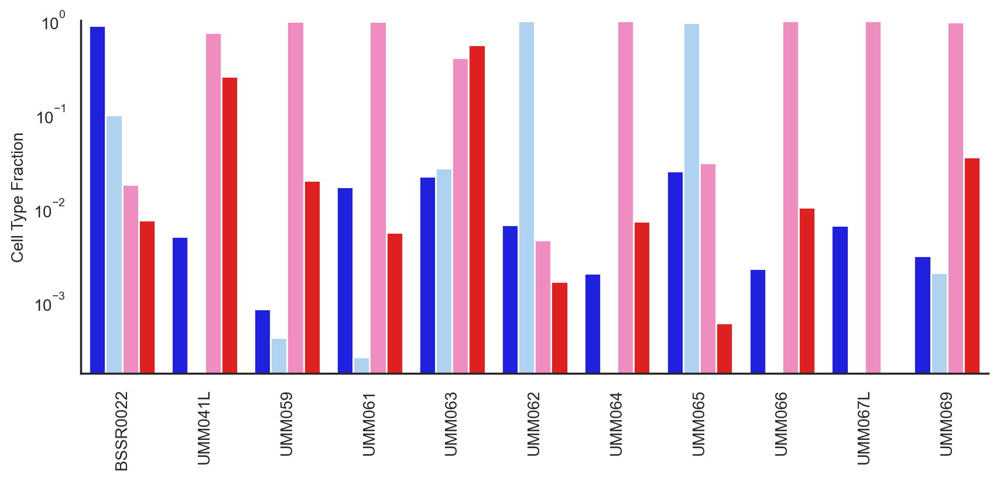

In [374]:
boxplot_patient_list = []
boxplot_fract_list = []
boxplot_class_list = []

for patient in METADATA_HARBOUR.index.get_level_values('Patient').unique():
    tmp = [METADATA_HARBOUR.loc[METADATA_HARBOUR.index.get_level_values('Patient') == patient].\
           TCGA_Assignment.value_counts().reindex(METADATA_HARBOUR.TCGA_Assignment.unique(), fill_value=0)[x] 
           for x in TCGA_CLASS_LIST]
    tmp = list(tmp/sum(tmp))
    
    boxplot_patient_list = boxplot_patient_list + [patient for x in range(len(TCGA_CLASS_LIST))]
    boxplot_fract_list = boxplot_fract_list + tmp
    boxplot_class_list = boxplot_class_list + TCGA_CLASS_LIST

boxplot_data = pd.DataFrame()
boxplot_data['Patient'] = boxplot_patient_list
boxplot_data['Fraction'] = boxplot_fract_list
boxplot_data['Class'] = boxplot_class_list

# VIOLIN PLOT
fig = plt.figure(figsize = (10,4))
ax = plt.gca()

# Plot violin plot
g = sns.barplot(data=boxplot_data,x = 'Patient', 
                y = 'Fraction', hue = 'Class', ci=95, capsize=.2,
                palette={"TCGA1": "#0000FF",
                         "TCGA2": "#A4D3FC",
                         "TCGA3": "#FF7DC2", 
                         "TCGA4": "#FF0000",},
                linewidth = 1, ax = ax);
fig.get_axes()[0].set_yscale('log')

plt.ylim((0,1))
g.set_ylabel("Cell Type Fraction",fontsize=10)
g.set_xlabel(" ",fontsize=10,rotation = 90)
g.tick_params(labelsize=10)
g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()

ax.legend_.remove()

# SAVE FIGURE
figure_label = 'TCGA_Distribution_by_Patient_LOG_HARBOUR'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

#### MIXTURE MODEL FOR GEP CLASSIFICATION

In [375]:
subset_type = 'TUMOR'
# LOAD GENE LIST FROM EXCEL
path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')
genesets = genesets.apply(lambda x: x.astype(str).str.upper())
print(shape(genesets)[1])

56


In [376]:
# VIOLIN PLOTS
datatype = 'INDF_HARBOUR'
exec('QUERY = {}'.format(datatype))

# VIOLIN PLOTS
gene1 = 'Castle 1'
signature_genes = genesets[gene1].values
signature_genes = [x for x in signature_genes if str(x).upper() != 'NAN']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals1 = (np.nanmean(QUERY[detected_genes],axis=1))

gene2 = 'Castle 2'
signature_genes = genesets[gene2].values
signature_genes = [x for x in signature_genes if str(x).upper() != 'NAN']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals2 = (np.nanmean(QUERY[detected_genes],axis=1))

X = pd.DataFrame(data = {gene1: vals1, gene2: vals2}, index = QUERY.index)

bgmm = BayesianGaussianMixture(covariance_type='diag', n_components=2, random_state=1)
bgmm.fit(X[['Castle 1','Castle 2']])
clusters = bgmm.predict(X[['Castle 1','Castle 2']])

/workdir/uvmel_project/figures/final_figures_10_27_20/HARBOUR_BayesianGMM


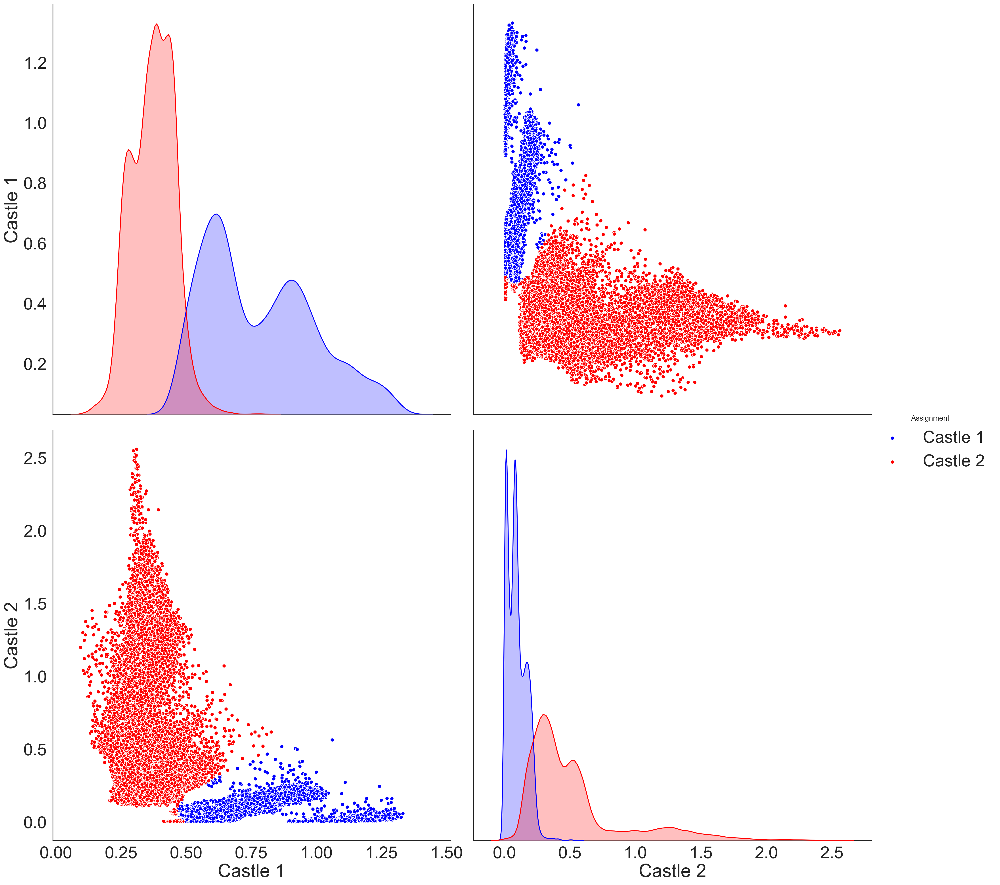

In [377]:
# VIOLIN PLOTS
datatype = 'INDF_HARBOUR'
exec('QUERY = {}'.format(datatype))

# VIOLIN PLOTS
gene1 = 'Castle 1'
signature_genes = genesets[gene1].values
signature_genes = [x for x in signature_genes if str(x).upper() != 'NAN']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals1 = (np.nanmean(QUERY[detected_genes],axis=1))

gene2 = 'Castle 2'
signature_genes = genesets[gene2].values
signature_genes = [x for x in signature_genes if str(x).upper() != 'NAN']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals2 = (np.nanmean(QUERY[detected_genes],axis=1))

X = pd.DataFrame(data = {gene1: vals1, gene2: vals2}, index = QUERY.index)

bgmm = BayesianGaussianMixture(covariance_type='diag', n_components=2)
bgmm.fit(X[['Castle 1','Castle 2']])
clusters = bgmm.predict(X[['Castle 1','Castle 2']])
X['Assignment'] = clusters

# Make Class Assignments
lut ={}
for ii in np.unique(X['Assignment']):
    if X[X['Assignment']==ii]['Castle 1'].mean()>X[X['Assignment']==ii]['Castle 2'].mean():
        lut[ii] = 'Castle 1'
    else:
        lut[ii] = 'Castle 2'
    
X['Assignment'] = X['Assignment'].map(lut)

sns.set(font_scale=2.5)
sns.set_style("white")
g = sns.pairplot(X[['Castle 1','Castle 2','Assignment']], 
                 hue = 'Assignment',
                 palette={"Castle 1": "#0000FF", "Castle 2": "#FF0000", 'Mixed': '#000000'},
                 diag_kind = 'kde', aspect = 1, size = 10); # SAVE FIGURE


# SAVE FIGURE
figure_label = 'HARBOUR_BayesianGMM'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
g.savefig(fn + '.png', dpi=400, transparent=True)
g.savefig(fn + '.pdf', dpi=400)
print(fn)

In [378]:
# UPDATE DIRECTORY
METADATA_HARBOUR['Assignment'] = X.Assignment
METADATA_HARBOUR.to_hdf(DATA_PATH_HARBOUR+'UVMEL_HARBOUR.h5', key='METADATA_HARBOUR')

###### COLOR GEP PLOT BY TCGA CLASS

/workdir/uvmel_project/figures/final_figures_10_27_20/HARBOUR_FULL_TCGA_colored


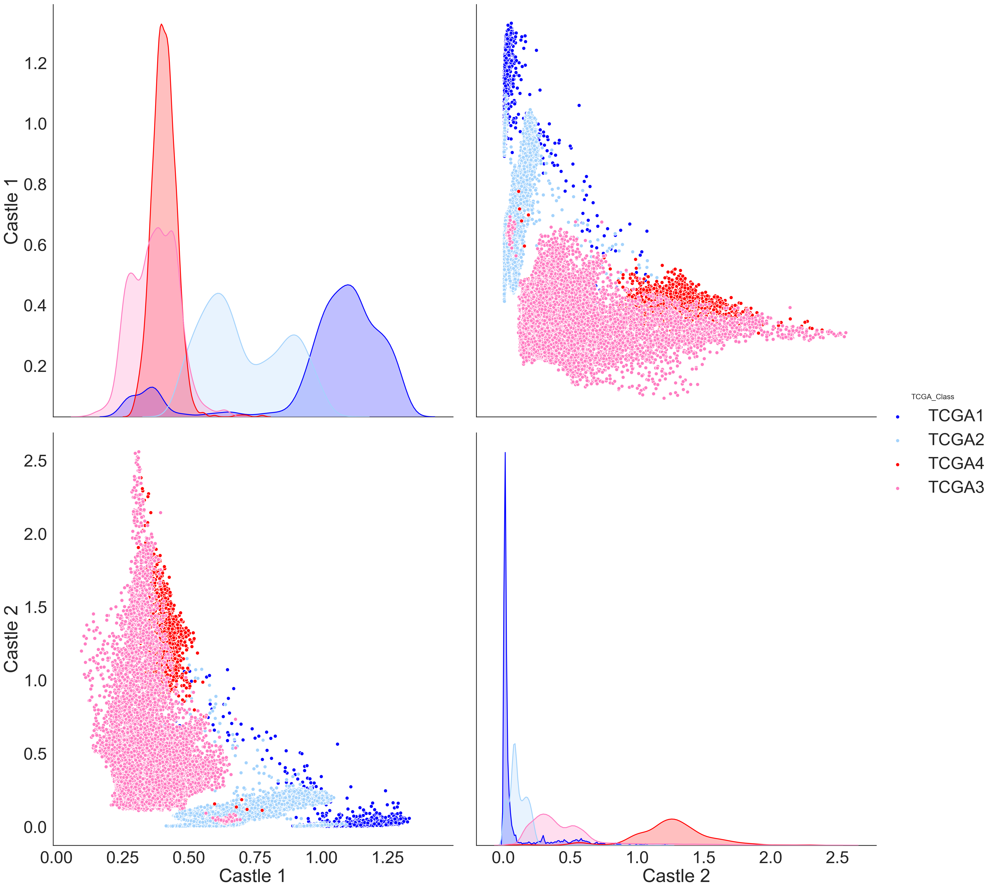

In [379]:
X['TCGA_Class'] = METADATA_HARBOUR.TCGA_Assignment

sns.set(font_scale=2.5)
sns.set_style("white")
g = sns.pairplot(X[['Castle 1', 'Castle 2', 'Assignment', 'TCGA_Class']], 
                 hue = 'TCGA_Class',
                 palette={"TCGA1": "#0000FF",
                          "TCGA2": "#A4D3FC",
                          "TCGA3": "#FF7DC2", 
                          "TCGA4": "#FF0000",},
                 diag_kind = 'kde', aspect = 1, size = 10);# SAVE FIGURE


# SAVE FIGURE
figure_label = 'HARBOUR_FULL_TCGA_colored'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
g.savefig(fn + '.png', dpi=400, transparent=True)
g.savefig(fn + '.pdf', dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/HABROUR_FULL_given_annotations


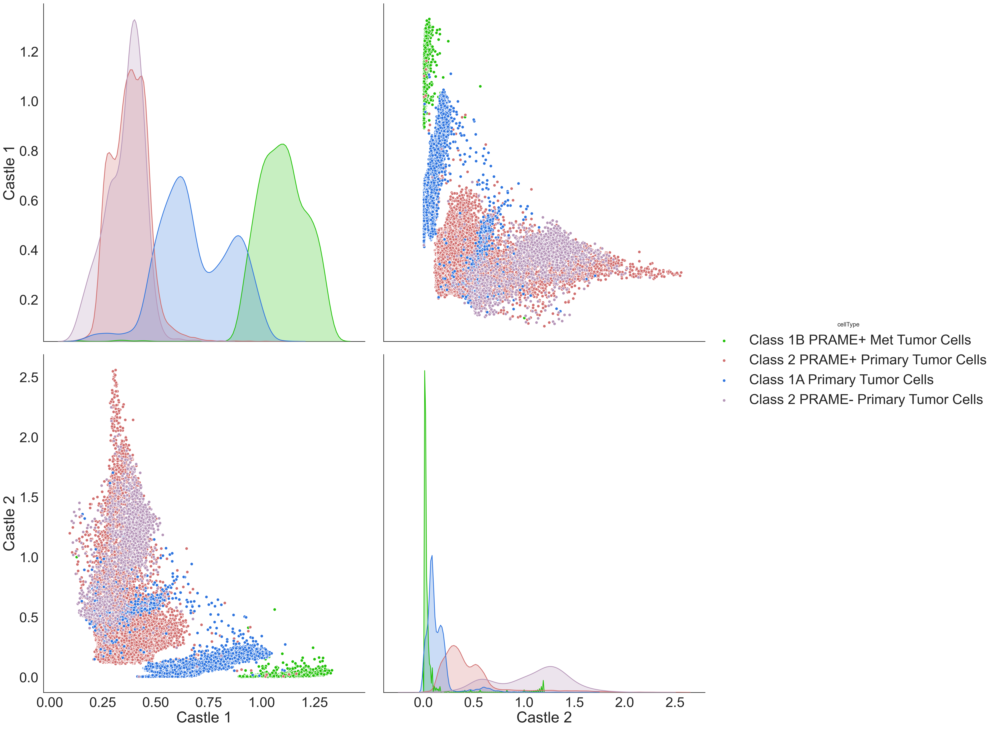

In [229]:
# Make Class Assignments
X['cellType'] = X.index.get_level_values('cellType').values

sns.set(font_scale=2.5)
sns.set_style("white")
g = sns.pairplot(X[['Castle 1', 'Castle 2', 'Assignment', 'cellType']], 
                 hue = 'cellType',
                 palette={"Class 1A Primary Tumor Cells": "#2F75DF",
                          "Class 1B PRAME+ Met Tumor Cells": "#21C108",
                          "Class 2 PRAME- Primary Tumor Cells": "#B696B9", 
                          "Class 2 PRAME+ Primary Tumor Cells": "#D17070",},
                 diag_kind = 'kde', aspect = 1, size = 10); # SAVE FIGURE


# SAVE FIGURE
figure_label = 'HABROUR_FULL_given_annotations'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
g.savefig(fn + '.png', dpi=400, transparent=True)
g.savefig(fn + '.pdf', dpi=400)
print(fn)

###### CONTINUE WITH INTRATUMOR HETEROGENEITY FOR GEP

/workdir/uvmel_project/figures/final_figures_10_27_20/Mixture_Model_HARBOUR


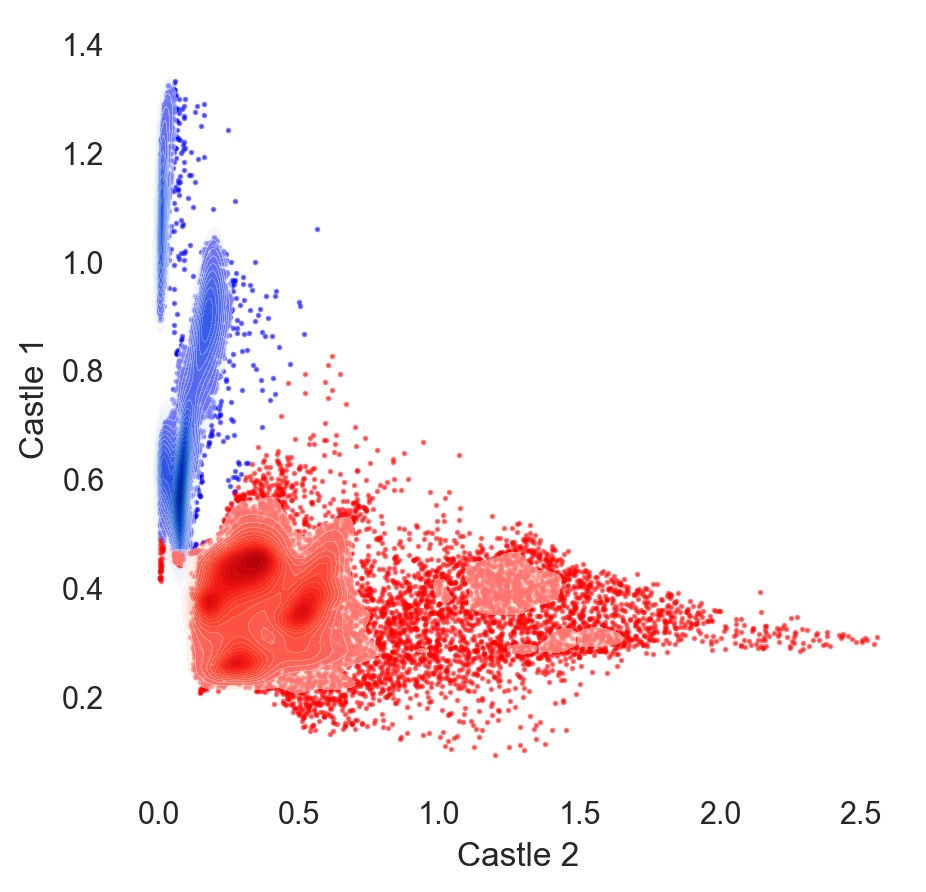

In [230]:
plt.figure(figsize = (5,5))
sns.despine()
sns.set(rc={'axes.facecolor':'white', 'figure.facecolor':'white'})
ax = plt.gca()

ax = plt.scatter(X[X['Assignment']=='Castle 1']['Castle 2'], X[X['Assignment']=='Castle 1']['Castle 1'],
                 s = 1, c ='blue',alpha = 0.5)
ax = sns.kdeplot(X[X['Assignment']=='Castle 1']['Castle 2'], X[X['Assignment']=='Castle 1']['Castle 1'],
                 cmap="Blues", shade=True, shade_lowest=False,n_levels = 20, alpha = 0.5)

ax = plt.scatter(X[X['Assignment']=='Castle 2']['Castle 2'], X[X['Assignment']=='Castle 2']['Castle 1'],
                 s = 1, c ='red',alpha = 0.5)
ax = sns.kdeplot(X[X['Assignment']=='Castle 2']['Castle 2'], X[X['Assignment']=='Castle 2']['Castle 1'],
                 cmap="Reds", shade=True, shade_lowest=False, n_levels = 20, alpha = 0.5)


# SAVE FIGURE
# SAVE FIGURE
figure_label = 'Mixture_Model_HARBOUR'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP_Distribution_by_Patient_HARBOUR


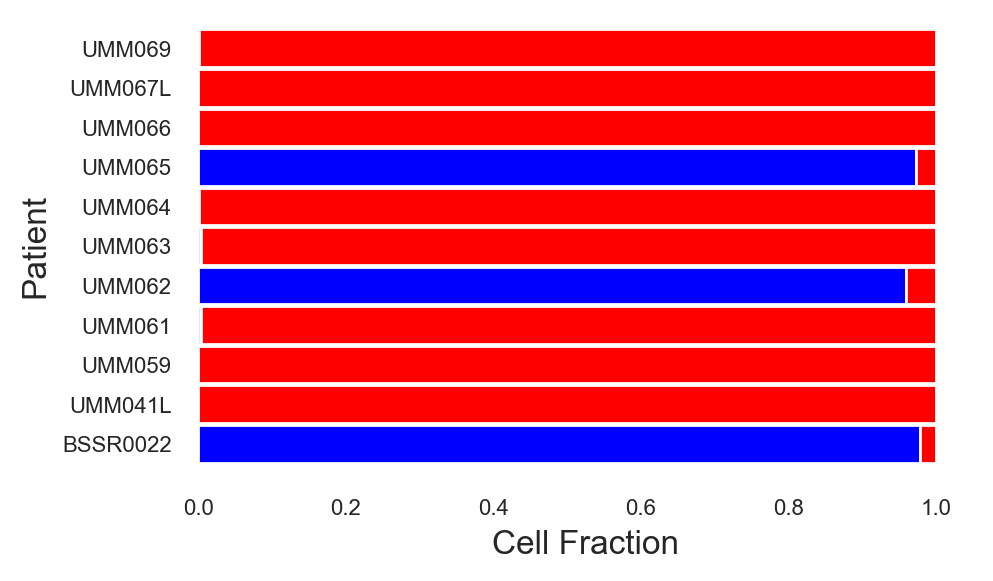

In [231]:
# Update multi-index
new_index = pd.MultiIndex.from_tuples(list(zip(X.index.get_level_values('Sample ID'), 
                                               X.index.get_level_values('Legend'),
                                               X.index.get_level_values('Patient'),
                                               X.index.get_level_values('Cell ID'),
                                               X['Assignment'])), 
                                  names=['Sample ID','Legend', 'Patient','Cell ID','Assignment'])
X = pd.DataFrame(data = X.values, columns = X.columns, index = new_index)

# CLASS ASSIGNMENT BY PATIENT 
meta = 'Assignment'
exec('tmp = X.groupby(level=[\'Patient\', \'{}\'], axis=0).size().unstack().fillna(0)'.format(meta))
colors = ["#0000FF","#FF0000"]

plt.figure(figsize = (5,3))
ax = plt.gca()
tmp.div(tmp.sum(axis=1),axis=0).plot.barh(stacked=True, color=colors, ax = ax, width = 0.95)
ax.legend_.remove()
ax.set_frame_on(False)
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.xlabel('Cell Fraction', fontsize=12)
plt.ylabel('Patient', fontsize=12)

# SAVE FIGURE
figure_label = 'GEP_Distribution_by_Patient_HARBOUR'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP_Distribution_by_Patient_LOG_HARBOUR


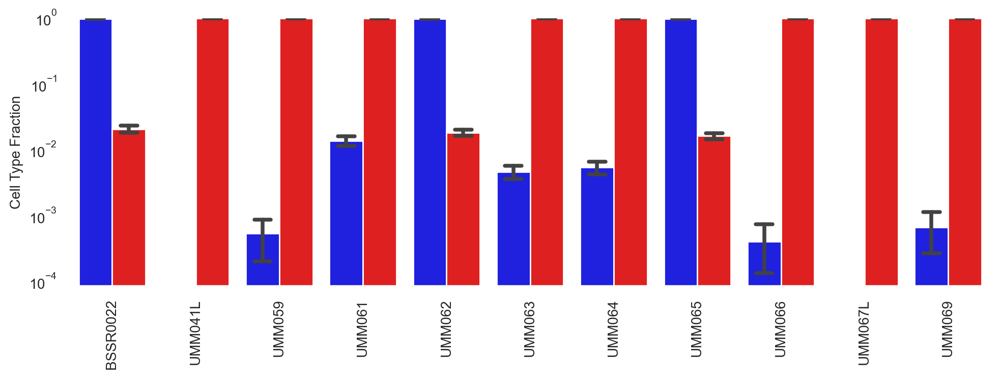

In [232]:
# GENE-GENE COVARIANCE WITHIN NORMAL SUBSET
n = 150
reps = np.arange(100)

master_groupby = 'Patient'
ix = [ind for ind,name in enumerate(X.index.names) if name==master_groupby][0]
fraction_castle1 = np.zeros((len(reps),len(np.unique(X.index.get_level_values(master_groupby)))))
fraction_castle2 = np.zeros((len(reps),len(np.unique(X.index.get_level_values(master_groupby)))))

for rep in reps:
    # RANDOMLY SAMPLE SAME NUMBER OF CELLS PER PATIENT
    SUBSET = pd.DataFrame()
    for class_selection in np.unique(X.index.get_level_values(master_groupby)):
        CSUBSET = X.loc[X.index.map(lambda x: x[ix] in [class_selection])].sample(n=n,replace=True)
        SUBSET = SUBSET.append(CSUBSET)
    
    bgmm = BayesianGaussianMixture(covariance_type='diag', n_components=2, random_state=1)
    bgmm.fit(SUBSET[['Castle 1','Castle 2']])
    clusters = bgmm.predict(SUBSET[['Castle 1','Castle 2']])
    SUBSET['Assignment'] = clusters

    # Make Class Assignments
    lut ={}
    for ii in np.unique(SUBSET['Assignment']):
        if SUBSET[SUBSET['Assignment']==ii]['Castle 1'].mean()>SUBSET[SUBSET['Assignment']==ii]['Castle 2'].mean():
            lut[ii] = 'Castle 1'
        else:
            lut[ii] = 'Castle 2'
    
    SUBSET['Assignment'] = SUBSET['Assignment'].map(lut)

    # Update multi-index
    new_index = pd.MultiIndex.from_tuples(list(zip(SUBSET.index.get_level_values('Sample ID'), 
                                                   SUBSET.index.get_level_values('Legend'),
                                                   SUBSET.index.get_level_values('Patient'),
                                                   SUBSET.index.get_level_values('Cell ID'),
                                                   SUBSET['Assignment'])), 
                                          names=['Sample ID','Legend', 'Patient','Cell ID',
                                                 'Assignment'])
    SUBSET = pd.DataFrame(data = SUBSET.values, columns = SUBSET.columns, index = new_index)

    # CASTLE ASSIGNMENT PER PATIENT
    meta = 'Assignment'
    exec('tmp = SUBSET.groupby(level=[\'Patient\', \'{}\'], axis=0).size().unstack().fillna(0)'.format(meta))

    # SAVE PER DOWNSAMPLE
    cell_type_fraction = tmp.div(tmp.sum(axis=1),axis=0)
    fraction_castle1[rep,:] = cell_type_fraction['Castle 1'].values
    fraction_castle2[rep,:] = cell_type_fraction['Castle 2'].values
    
# CONVER TO PANDAS DATAFRAME
boxplot_data_fraction_castle1 = pd.DataFrame(data = fraction_castle1, 
                                             columns = ['{}_{}'.format(master_groupby,ind) 
                                                        for ind in 
                                                        np.unique(X.index.get_level_values(master_groupby))])
boxplot_data_fraction_castle1 = boxplot_data_fraction_castle1.stack().rename_axis(('Rep', 'Patient')).\
                                                                      reset_index(name='Fraction')

boxplot_data_fraction_castle2 = pd.DataFrame(data = fraction_castle2, 
                                             columns = ['{}_{}'.format(master_groupby,ind) 
                                                        for ind in 
                                                        np.unique(X.index.get_level_values(master_groupby))])
boxplot_data_fraction_castle2 = boxplot_data_fraction_castle2.stack().rename_axis(('Rep', 'Patient')).\
                                                                      reset_index(name='Fraction')

boxplot_data_fraction_castle1['Class'] = ['Castle 1']*len(boxplot_data_fraction_castle1)
boxplot_data_fraction_castle2['Class'] = ['Castle 2']*len(boxplot_data_fraction_castle2)
boxplot_data = boxplot_data_fraction_castle1.append(boxplot_data_fraction_castle2)
boxplot_data['Patient'] = [x.replace('Patient_','') for x in boxplot_data.Patient]

# VIOLIN PLOT
fig = plt.figure(figsize = (10,4))
ax = plt.gca()

# Plot violin plot
g = sns.barplot(data=boxplot_data,x = 'Patient', 
                y = 'Fraction', hue = 'Class', ci=95, capsize=.2,
                palette={"Castle 1": "#0000FF", "Castle 2": "#FF0000", 'Mixed': '#000000'},
                linewidth = 1, ax = ax);
fig.get_axes()[0].set_yscale('log')

plt.ylim((0,1))
g.set_ylabel("Cell Type Fraction",fontsize=10)
g.set_xlabel(" ",fontsize=10,rotation = 90)
g.tick_params(labelsize=10)
g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()

ax.legend_.remove()
plt.tight_layout()

# SAVE FIGURE
figure_label = 'GEP_Distribution_by_Patient_LOG_HARBOUR'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP_Distribution_by_Patient_LOG_HARBOUR_NO_ds


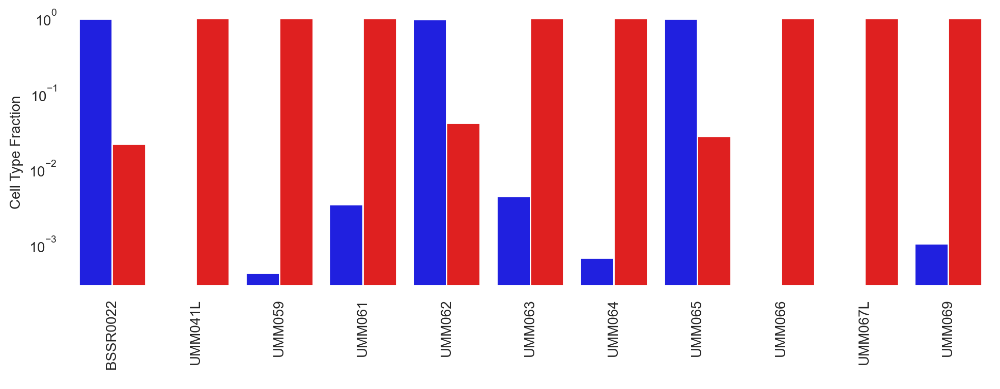

In [233]:
boxplot_patient_list = []
boxplot_fract_list = []
boxplot_class_list = []

for patient in sort(METADATA_HARBOUR.index.get_level_values('Patient').unique().tolist()):
    tmp = [METADATA_HARBOUR.loc[METADATA_HARBOUR.index.get_level_values('Patient') == patient].\
           Assignment.value_counts().reindex(METADATA_HARBOUR.Assignment.unique(), fill_value=0)[x] 
           for x in GEP_CLASS_LIST]
    tmp = list(tmp/sum(tmp))
    
    boxplot_patient_list = boxplot_patient_list + [patient for x in range(len(GEP_CLASS_LIST))]
    boxplot_fract_list = boxplot_fract_list + tmp
    boxplot_class_list = boxplot_class_list + GEP_CLASS_LIST

boxplot_data = pd.DataFrame()
boxplot_data['Patient'] = boxplot_patient_list
boxplot_data['Fraction'] = boxplot_fract_list
boxplot_data['Class'] = boxplot_class_list

# VIOLIN PLOT
fig = plt.figure(figsize = (10,4))
ax = plt.gca()

# Plot violin plot
g = sns.barplot(data=boxplot_data,x = 'Patient', 
                y = 'Fraction', hue = 'Class', ci=95, capsize=.2,
                palette={"Castle 1": "#0000FF", "Castle 2": "#FF0000", 'Mixed': '#000000'},
                linewidth = 1, ax = ax);
fig.get_axes()[0].set_yscale('log')

plt.ylim((0,1))
g.set_ylabel("Cell Type Fraction",fontsize=10)
g.set_xlabel(" ",fontsize=10,rotation = 90)
g.tick_params(labelsize=10)
g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()

ax.legend_.remove()
plt.tight_layout()

# SAVE FIGURE
figure_label = 'GEP_Distribution_by_Patient_LOG_HARBOUR_NO_ds'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

### MIXTURE MODEL - HARBOUR DATA PRIMARY ONLY

#### MIXTURE MODEL FOR TCGA CLASSIFICATION

In [234]:
# VIOLIN PLOTS
datatype = 'INDF_HARBOUR_PRIMARY'
exec('QUERY = {}'.format(datatype))

# VIOLIN PLOTS
subset_type = 'TUMOR'

gene1 = 'TCGA1'
signature_genes = TCGA_markerfile_df.loc[TCGA_markerfile_df[gene1] == 1].index.values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals1 = (np.nanmean(QUERY[detected_genes],axis=1))

gene2 = 'TCGA2'
signature_genes = TCGA_markerfile_df.loc[TCGA_markerfile_df[gene2] == 1].index.values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals2 = (np.nanmean(QUERY[detected_genes],axis=1))

gene3 = 'TCGA3'
signature_genes = TCGA_markerfile_df.loc[TCGA_markerfile_df[gene3] == 1].index.values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals3 = (np.nanmean(QUERY[detected_genes],axis=1))

gene4 = 'TCGA4'
signature_genes = TCGA_markerfile_df.loc[TCGA_markerfile_df[gene4] == 1].index.values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals4 = (np.nanmean(QUERY[detected_genes],axis=1))

X = pd.DataFrame(data = {gene1: vals1, gene2: vals2, gene3: vals3, gene4: vals4}, index = QUERY.index)

In [235]:
# Train BGMM Model:
bgmm = BayesianGaussianMixture(covariance_type='spherical', n_components=4, random_state=37)
bgmm.fit(X[['TCGA1','TCGA2','TCGA3','TCGA4']])
clusters = bgmm.predict(X[['TCGA1','TCGA2','TCGA3','TCGA4']])

# Create T-SNE:
X_embedded = manifold.TSNE(n_components=2, random_state=2).fit_transform(X[['TCGA1','TCGA2','TCGA3','TCGA4']])
X['tsne1'] = X_embedded[:,0]
X['tsne2'] = X_embedded[:,1]

X['Assignment'] = clusters

/workdir/uvmel_project/figures/final_figures_10_27_20/HARBOUR_PRIMARY_BayesianGMM_TCGA


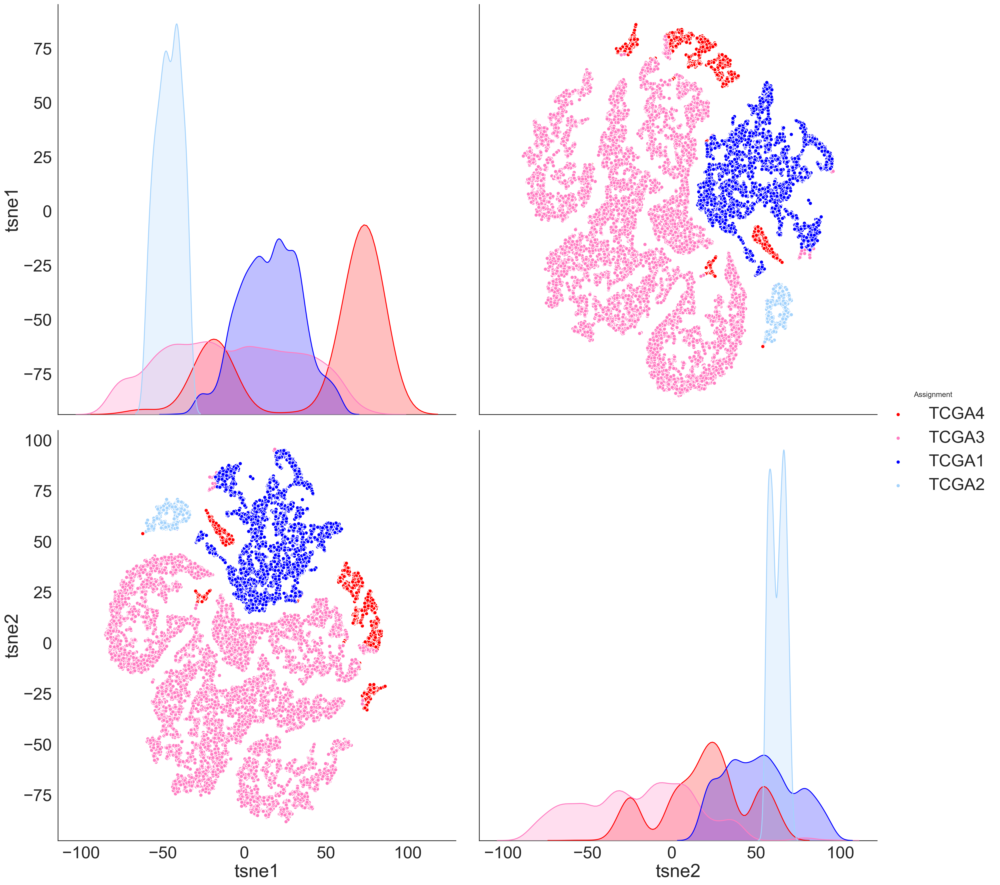

In [236]:
# Make Class Assignments
lut ={}
mean_array = []
for ii in np.unique(X['Assignment']):
    mean_array.append([X[X['Assignment']==ii][x].mean() for x in TCGA_CLASS_LIST])
mean_array = np.array(mean_array)

for i in range(len(np.unique(X['Assignment']))):
    max_ind = np.unravel_index(np.argmax(mean_array, axis=None), mean_array.shape)
    lut[max_ind[0]] = TCGA_CLASS_LIST[max_ind[1]]
    mean_array[:,max_ind[1]] = 0
    mean_array[max_ind[0],:] = 0

# MAP ASSIGNMENTS
X['Assignment'] = X['Assignment'].map(lut)

sns.set(font_scale=2.5)
sns.set_style("white")
g = sns.pairplot(X[['tsne1','tsne2','Assignment']], 
                 hue = 'Assignment',
                 palette={"TCGA1": "#0000FF",
                          "TCGA2": "#A4D3FC",
                          "TCGA3": "#FF7DC2", 
                          "TCGA4": "#FF0000",},
            diag_kind = 'kde', aspect = 1, size = 10);# SAVE FIGURE


# SAVE FIGURE
figure_label = 'HARBOUR_PRIMARY_BayesianGMM_TCGA'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
g.savefig(fn + '.png', dpi=400, transparent=True)
g.savefig(fn + '.pdf', dpi=400)
print(fn)

In [237]:
# UPDATE DIRECTORY
X['TCGA_Assignment'] = X.Assignment
METADATA_HARBOUR_PRIMARY = X[['TCGA_Assignment']].copy()
exec('h5_data_harbour.save(METADATA_HARBOUR_PRIMARY, \'METADATA_HARBOUR_PRIMARY\')')

In [238]:
X_norm = X[TCGA_CLASS_LIST].copy()
X_norm = X_norm.div(X_norm.sum(axis=1), axis=0)

#### MIXTURE MODEL FOR GEP CLASSIFICATION

In [239]:
subset_type = 'TUMOR'
# LOAD GENE LIST FROM EXCEL
path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')
genesets = genesets.apply(lambda x: x.astype(str).str.upper())
print(shape(genesets)[1])

56


/workdir/uvmel_project/figures/final_figures_10_27_20/HARBOUR_PRIMARY_BayesianGMM


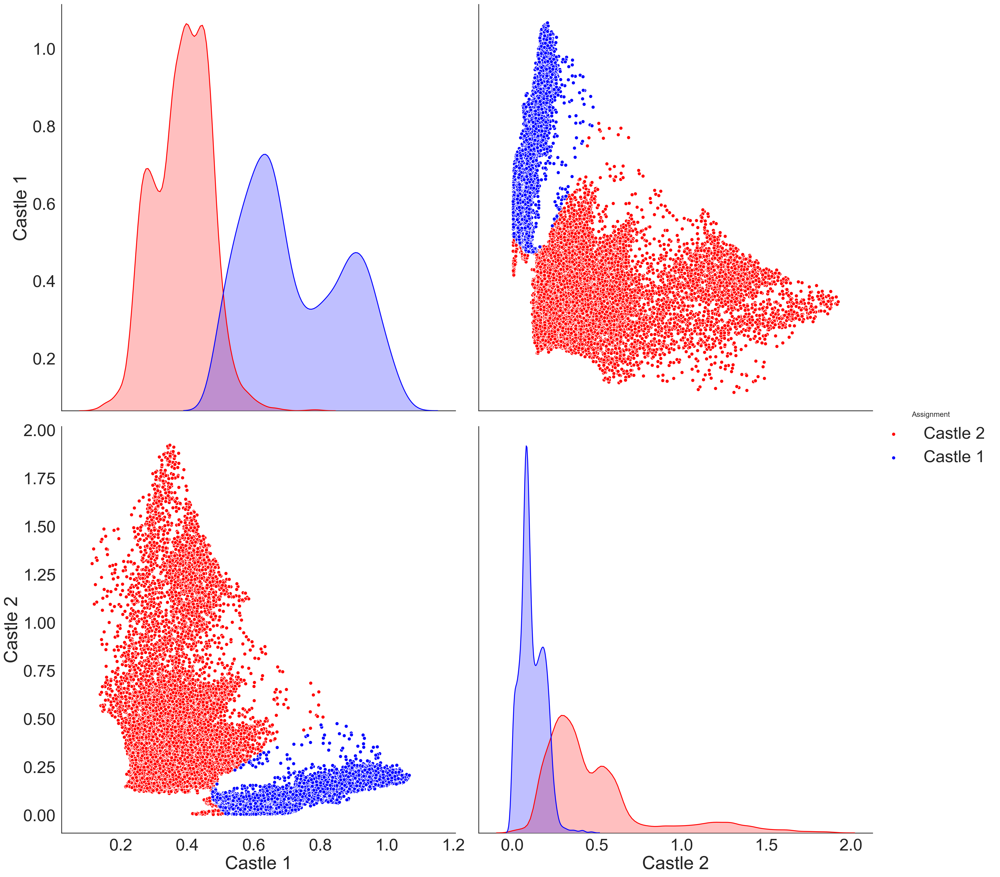

In [240]:
# VIOLIN PLOTS
datatype = 'INDF_HARBOUR_PRIMARY'
exec('QUERY = {}'.format(datatype))

# VIOLIN PLOTS
gene1 = 'Castle 1'
signature_genes = genesets[gene1].values
signature_genes = [x for x in signature_genes if str(x).upper() != 'NAN']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals1 = (np.nanmean(QUERY[detected_genes],axis=1))

gene2 = 'Castle 2'
signature_genes = genesets[gene2].values
signature_genes = [x for x in signature_genes if str(x).upper() != 'NAN']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
vals2 = (np.nanmean(QUERY[detected_genes],axis=1))

X = pd.DataFrame(data = {gene1: vals1, gene2: vals2}, index = QUERY.index)

bgmm = BayesianGaussianMixture(covariance_type='diag', n_components=2, random_state=1)
bgmm.fit(X[['Castle 1','Castle 2']])
clusters = bgmm.predict(X[['Castle 1','Castle 2']])
X['Assignment'] = clusters

# Make Class Assignments
lut ={}
for ii in np.unique(X['Assignment']):
    if X[X['Assignment']==ii]['Castle 1'].mean()>X[X['Assignment']==ii]['Castle 2'].mean():
        lut[ii] = 'Castle 1'
    else:
        lut[ii] = 'Castle 2'
    
X['Assignment'] = X['Assignment'].map(lut)

sns.set(font_scale=2.5)
sns.set_style("white")
g = sns.pairplot(X[['Castle 1','Castle 2','Assignment']], 
                 hue = 'Assignment',
                 palette={"Castle 1": "#0000FF", "Castle 2": "#FF0000", 'Mixed': '#000000'},
                 diag_kind = 'kde', aspect = 1, size = 10); # SAVE FIGURE


# SAVE FIGURE
figure_label = 'HARBOUR_PRIMARY_BayesianGMM'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
g.savefig(fn + '.png', dpi=400, transparent=True)
g.savefig(fn + '.pdf', dpi=400)
print(fn)

In [241]:
# UPDATE DIRECTORY
METADATA_HARBOUR_PRIMARY['Assignment'] = X.Assignment
exec('h5_data_harbour.save(METADATA_HARBOUR_PRIMARY, \'METADATA_HARBOUR_PRIMARY\')')

###### COLOR GEP PLOT BY TCGA CLASS

/workdir/uvmel_project/figures/final_figures_10_27_20/HARBOUR_PRIMARY_FULL_TCGA_colored


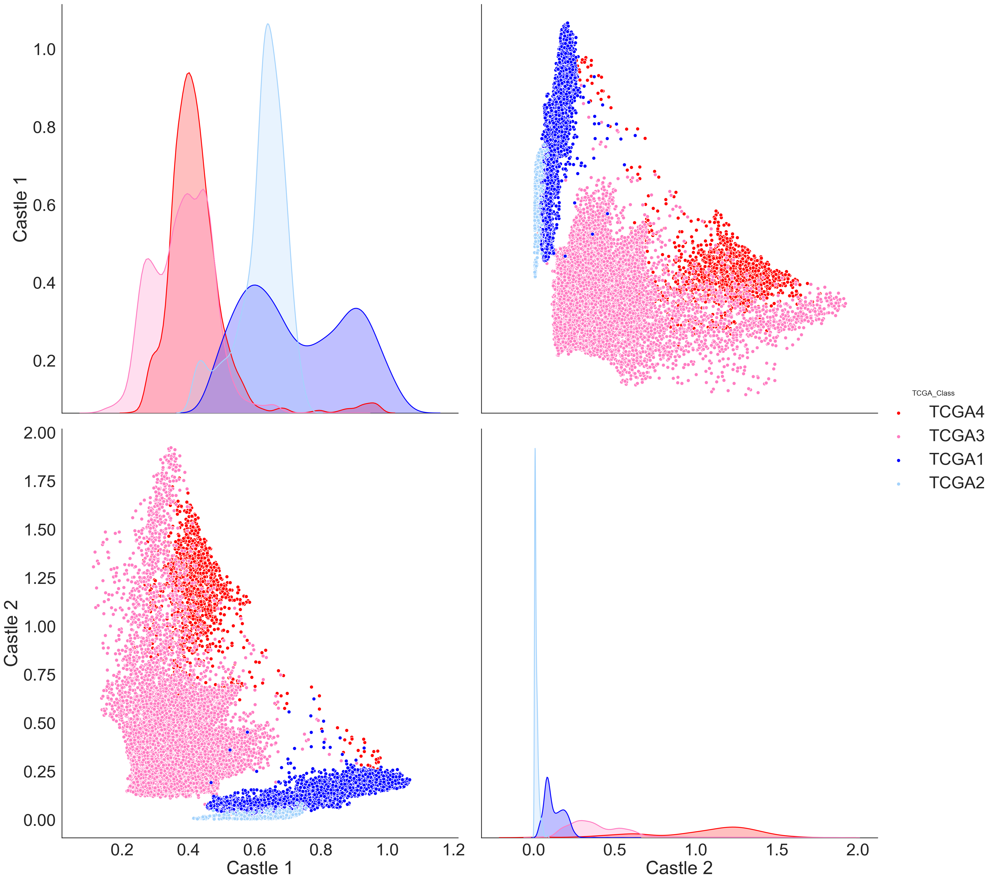

In [242]:
X['TCGA_Class'] = METADATA_HARBOUR_PRIMARY.TCGA_Assignment

sns.set(font_scale=2.5)
sns.set_style("white")
g = sns.pairplot(X[['Castle 1','Castle 2','Assignment', 'TCGA_Class']], 
                 hue = 'TCGA_Class',
                 palette={"TCGA1": "#0000FF",
                          "TCGA2": "#A4D3FC",
                          "TCGA3": "#FF7DC2", 
                          "TCGA4": "#FF0000",},
            diag_kind = 'kde', aspect = 1, size = 10); # SAVE FIGURE


# SAVE FIGURE
figure_label = 'HARBOUR_PRIMARY_FULL_TCGA_colored'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
g.savefig(fn + '.png', dpi=400, transparent=True)
g.savefig(fn + '.pdf', dpi=400)
print(fn)

###### COLOR BY CELLTYPE

/workdir/uvmel_project/figures/final_figures_10_27_20/HABROUR_PRIMARY_FULL_given_annotations


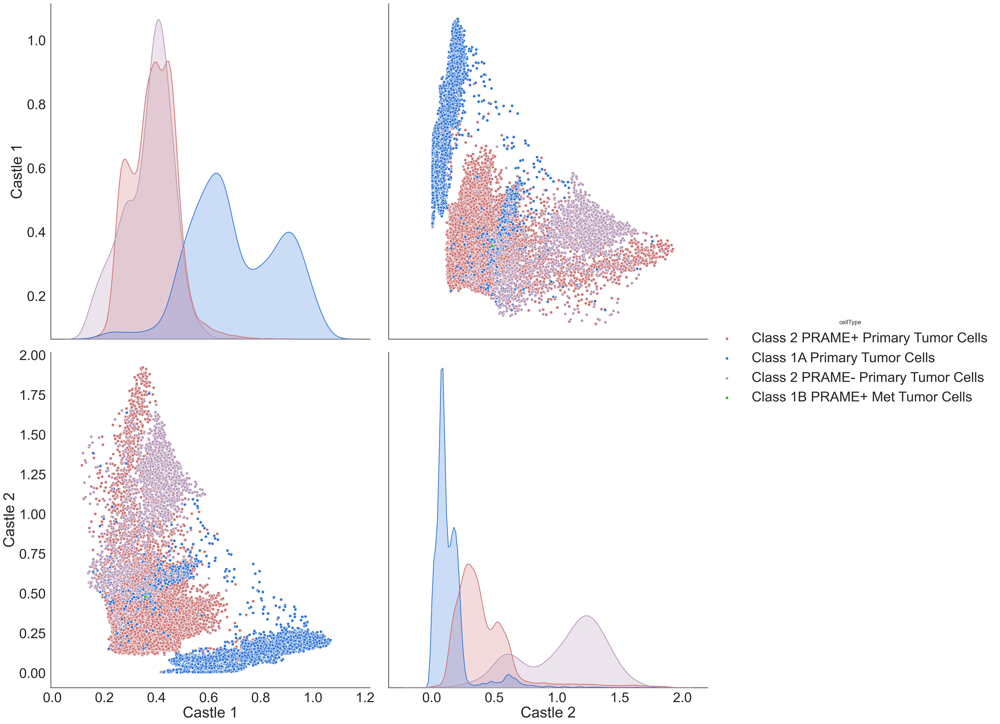

In [243]:
# Make Class Assignments
X['cellType'] = X.index.get_level_values('cellType').values

sns.set(font_scale=2.5)
sns.set_style("white")
g = sns.pairplot(X[['Castle 1', 'Castle 2', 'Assignment', 'cellType']], 
                 hue = 'cellType',
                 palette={"Class 1A Primary Tumor Cells": "#2F75DF",
                          "Class 1B PRAME+ Met Tumor Cells": "#21C108",
                          "Class 2 PRAME- Primary Tumor Cells": "#B696B9", 
                          "Class 2 PRAME+ Primary Tumor Cells": "#D17070",},
                 diag_kind = 'kde', aspect = 1, size = 10); # SAVE FIGURE


# SAVE FIGURE
figure_label = 'HABROUR_PRIMARY_FULL_given_annotations'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
g.savefig(fn + '.png', dpi=400, transparent=True)
g.savefig(fn + '.pdf', dpi=400)
print(fn)

###### CONTINUE WITH INTRATUMOR HETEROGENEITY WITH FOR GEP

/workdir/uvmel_project/figures/final_figures_10_27_20/HARBOUR_PRIMARY_Bayesian_GMM


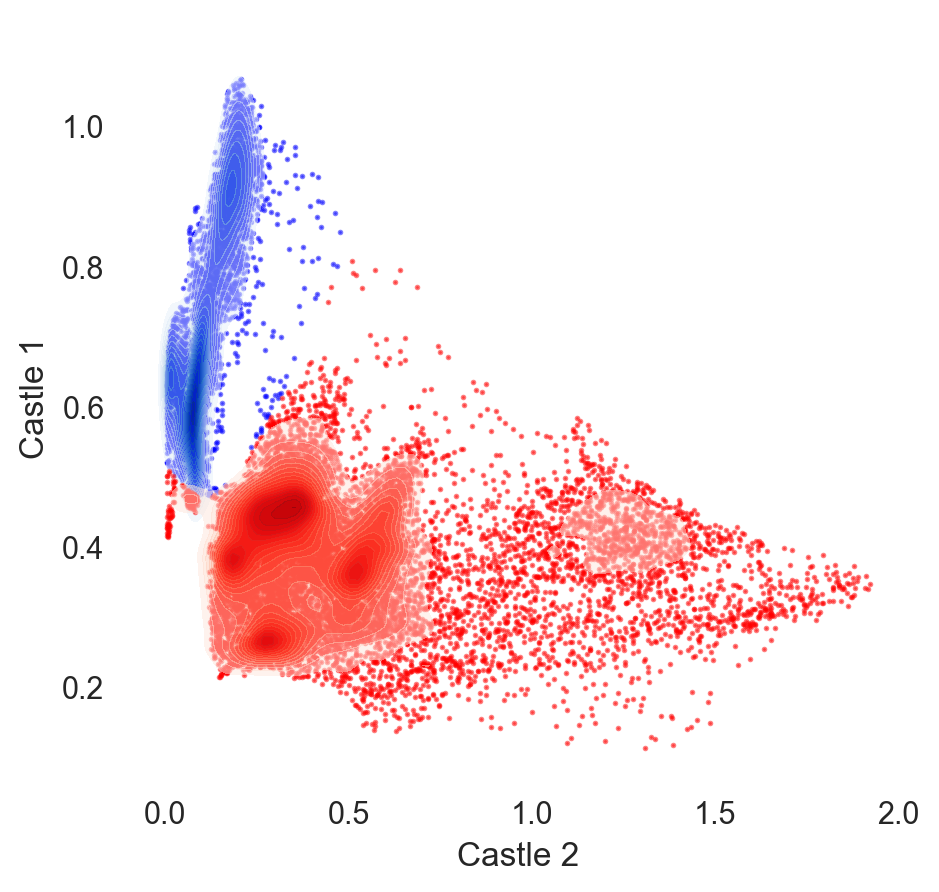

In [244]:
plt.figure(figsize = (5,5))
sns.despine()
sns.set(rc={'axes.facecolor':'white', 'figure.facecolor':'white'})
ax = plt.gca()

ax = plt.scatter(X[X['Assignment']=='Castle 1']['Castle 2'], X[X['Assignment']=='Castle 1']['Castle 1'],
                 s = 1, c ='blue',alpha = 0.5)
ax = sns.kdeplot(X[X['Assignment']=='Castle 1']['Castle 2'], X[X['Assignment']=='Castle 1']['Castle 1'],
                 cmap="Blues", shade=True, shade_lowest=False,n_levels = 20, alpha = 0.5)

ax = plt.scatter(X[X['Assignment']=='Castle 2']['Castle 2'], X[X['Assignment']=='Castle 2']['Castle 1'],
                 s = 1, c ='red',alpha = 0.5)
ax = sns.kdeplot(X[X['Assignment']=='Castle 2']['Castle 2'], X[X['Assignment']=='Castle 2']['Castle 1'],
                 cmap="Reds", shade=True, shade_lowest=False, n_levels = 20, alpha = 0.5)


# SAVE FIGURE
# SAVE FIGURE
figure_label = 'HARBOUR_PRIMARY_Bayesian_GMM'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 

d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP_Distribution_by_Patient_HARBOUR_PRIMARY


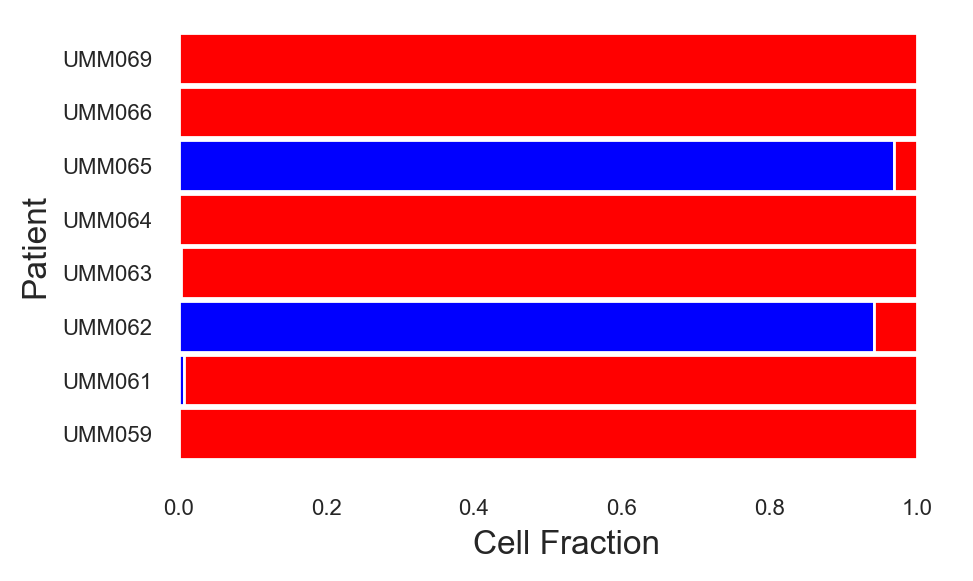

In [245]:
# Update multi-index
new_index = pd.MultiIndex.from_tuples(list(zip(X.index.get_level_values('Sample ID'), 
                                               X.index.get_level_values('Legend'),
                                               X.index.get_level_values('Patient'),
                                               X.index.get_level_values('Cell ID'),
                                               X['Assignment'])), 
                                  names=['Sample ID','Legend', 'Patient','Cell ID','Assignment'])
X = pd.DataFrame(data = X.values, columns = X.columns, index = new_index)

# CLASS ASSIGNMENT BY PATIENT 
meta = 'Assignment'
exec('tmp = X.groupby(level=[\'Patient\', \'{}\'], axis=0).size().unstack().fillna(0)'.format(meta))
colors = ["#0000FF","#FF0000"]

plt.figure(figsize = (5,3))
ax = plt.gca()
tmp.div(tmp.sum(axis=1),axis=0).plot.barh(stacked=True, color=colors, ax = ax, width = 0.95)
ax.legend_.remove()
ax.set_frame_on(False)
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.xlabel('Cell Fraction', fontsize=12)
plt.ylabel('Patient', fontsize=12)

# SAVE FIGURE
figure_label = 'GEP_Distribution_by_Patient_HARBOUR_PRIMARY'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP_Distribution_by_Patient_LOG_HARBOUR_PRIMARY


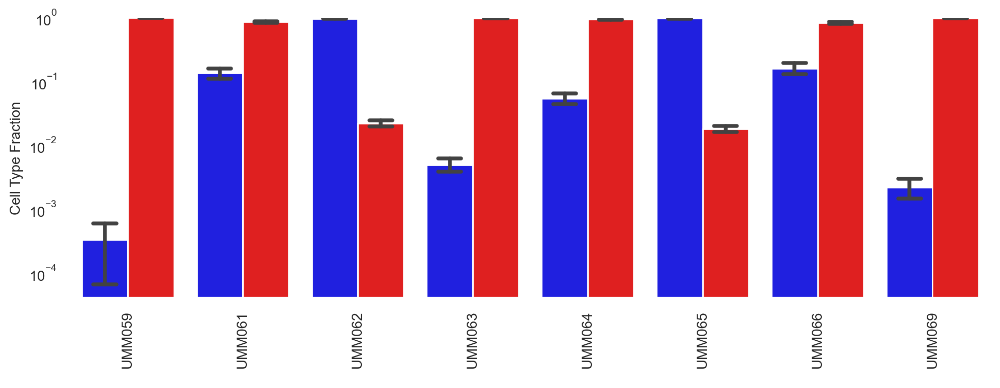

In [246]:
# GENE-GENE COVARIANCE WITHIN NORMAL SUBSET
n = 150
reps = np.arange(100)

master_groupby = 'Patient'
ix = [ind for ind,name in enumerate(X.index.names) if name==master_groupby][0]
fraction_castle1 = np.zeros((len(reps),len(np.unique(X.index.get_level_values(master_groupby)))))
fraction_castle2 = np.zeros((len(reps),len(np.unique(X.index.get_level_values(master_groupby)))))

for rep in reps:
    # RANDOMLY SAMPLE SAME NUMBER OF CELLS PER PATIENT
    SUBSET = pd.DataFrame()
    for class_selection in np.unique(X.index.get_level_values(master_groupby)):
        CSUBSET = X.loc[X.index.map(lambda x: x[ix] in [class_selection])].sample(n=n,replace=True)
        SUBSET = SUBSET.append(CSUBSET)
    
    bgmm = BayesianGaussianMixture(covariance_type='diag', n_components=2, random_state=1)
    bgmm.fit(SUBSET[['Castle 1','Castle 2']])
    clusters = bgmm.predict(SUBSET[['Castle 1','Castle 2']])
    SUBSET['Assignment'] = clusters

    # Make Class Assignments
    lut ={}
    for ii in np.unique(SUBSET['Assignment']):
        if SUBSET[SUBSET['Assignment']==ii]['Castle 1'].mean()>SUBSET[SUBSET['Assignment']==ii]['Castle 2'].mean():
            lut[ii] = 'Castle 1'
        else:
            lut[ii] = 'Castle 2'
    
    SUBSET['Assignment'] = SUBSET['Assignment'].map(lut)

    # Update multi-index
    new_index = pd.MultiIndex.from_tuples(list(zip(SUBSET.index.get_level_values('Sample ID'), 
                                                   SUBSET.index.get_level_values('Legend'),
                                                   SUBSET.index.get_level_values('Patient'),
                                                   SUBSET.index.get_level_values('Cell ID'),
                                                   SUBSET['Assignment'])), 
                                          names=['Sample ID','Legend', 'Patient','Cell ID',
                                                 'Assignment'])
    SUBSET = pd.DataFrame(data = SUBSET.values, columns = SUBSET.columns, index = new_index)

    # CASTLE ASSIGNMENT PER PATIENT
    meta = 'Assignment'
    exec('tmp = SUBSET.groupby(level=[\'Patient\', \'{}\'], axis=0).size().unstack().fillna(0)'.format(meta))

    # SAVE PER DOWNSAMPLE
    cell_type_fraction = tmp.div(tmp.sum(axis=1),axis=0)
    fraction_castle1[rep,:] = cell_type_fraction['Castle 1'].values
    fraction_castle2[rep,:] = cell_type_fraction['Castle 2'].values
    
# CONVER TO PANDAS DATAFRAME
boxplot_data_fraction_castle1 = pd.DataFrame(data = fraction_castle1, 
                                             columns = ['{}_{}'.format(master_groupby,ind) 
                                                        for ind in 
                                                        np.unique(X.index.get_level_values(master_groupby))])
boxplot_data_fraction_castle1 = boxplot_data_fraction_castle1.stack().rename_axis(('Rep', 'Patient')).\
                                                                      reset_index(name='Fraction')

boxplot_data_fraction_castle2 = pd.DataFrame(data = fraction_castle2, 
                                             columns = ['{}_{}'.format(master_groupby,ind) 
                                                        for ind in 
                                                        np.unique(X.index.get_level_values(master_groupby))])
boxplot_data_fraction_castle2 = boxplot_data_fraction_castle2.stack().rename_axis(('Rep', 'Patient')).\
                                                                      reset_index(name='Fraction')

boxplot_data_fraction_castle1['Class'] = ['Castle 1']*len(boxplot_data_fraction_castle1)
boxplot_data_fraction_castle2['Class'] = ['Castle 2']*len(boxplot_data_fraction_castle2)
boxplot_data = boxplot_data_fraction_castle1.append(boxplot_data_fraction_castle2)
boxplot_data['Patient'] = [x.replace('Patient_','') for x in boxplot_data.Patient]

# VIOLIN PLOT
fig = plt.figure(figsize = (10,4))
ax = plt.gca()

# Plot violin plot
g = sns.barplot(data=boxplot_data,x = 'Patient', 
                y = 'Fraction', hue = 'Class', ci=95, capsize=.2,
                palette={"Castle 1": "#0000FF", "Castle 2": "#FF0000", 'Mixed': '#000000'},
                linewidth = 1, ax = ax);
fig.get_axes()[0].set_yscale('log')

plt.ylim((0,1))
g.set_ylabel("Cell Type Fraction",fontsize=10)
g.set_xlabel(" ",fontsize=10,rotation = 90)
g.tick_params(labelsize=10)
g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()

ax.legend_.remove()
plt.tight_layout()

# SAVE FIGURE
figure_label = 'GEP_Distribution_by_Patient_LOG_HARBOUR_PRIMARY'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/TCGA_Distribution_COMBINED_BGMM_primary_trained


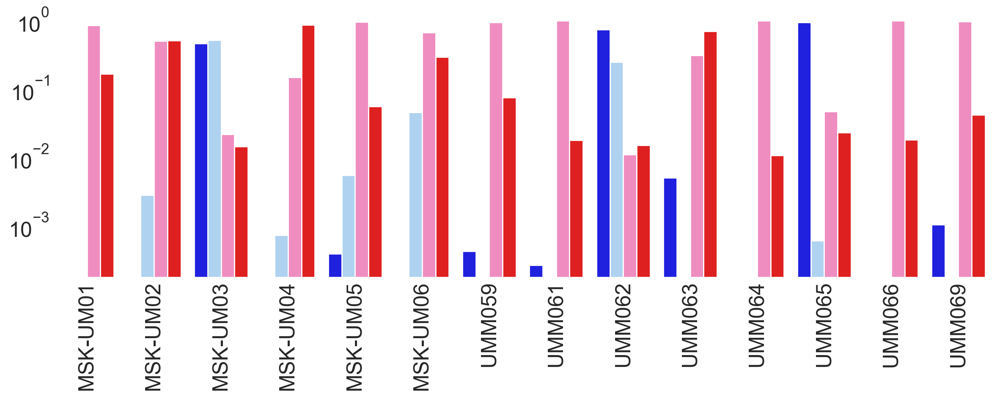

In [247]:
boxplot_patient_list = []
boxplot_fract_list = []
boxplot_class_list = []

for patient in METADATA_TUMOR.index.get_level_values('Patient').unique():
    tmp = [METADATA_TUMOR.loc[METADATA_TUMOR.index.get_level_values('Patient') == patient].\
           TCGA_Assignment.value_counts().reindex(METADATA_TUMOR.TCGA_Assignment.unique(), fill_value=0)[x] 
           for x in TCGA_CLASS_LIST]
    tmp = list(tmp/sum(tmp))
    
    boxplot_patient_list = boxplot_patient_list + ['MSK-' + patient for x in range(len(TCGA_CLASS_LIST))]
    boxplot_fract_list = boxplot_fract_list + tmp
    boxplot_class_list = boxplot_class_list + TCGA_CLASS_LIST

for patient in sort(METADATA_HARBOUR_PRIMARY.index.get_level_values('Patient').unique().tolist()):
    tmp = [METADATA_HARBOUR_PRIMARY.loc[METADATA_HARBOUR_PRIMARY.index.get_level_values('Patient') == patient].\
           TCGA_Assignment.value_counts().reindex(METADATA_HARBOUR_PRIMARY.TCGA_Assignment.unique(), fill_value=0)[x] 
           for x in TCGA_CLASS_LIST]
    tmp = list(tmp/sum(tmp))
    
    boxplot_patient_list = boxplot_patient_list + [patient for x in range(len(TCGA_CLASS_LIST))]
    boxplot_fract_list = boxplot_fract_list + tmp
    boxplot_class_list = boxplot_class_list + TCGA_CLASS_LIST

boxplot_data = pd.DataFrame()
boxplot_data['Patient'] = boxplot_patient_list
boxplot_data['Fraction'] = boxplot_fract_list
boxplot_data['Class'] = boxplot_class_list

# VIOLIN PLOT
fig = plt.figure(figsize = (12,5))
ax = plt.gca()

# Plot violin plot
g = sns.barplot(data=boxplot_data,x = 'Patient', 
                y = 'Fraction', hue = 'Class', ci=95, capsize=.2,
                palette={"TCGA1": "#0000FF",
                         "TCGA2": "#A4D3FC",
                         "TCGA3": "#FF7DC2", 
                         "TCGA4": "#FF0000"},
                linewidth = 1, ax = ax);
fig.get_axes()[0].set_yscale('log')

plt.ylim((0,1))
g.set_ylabel("",fontsize=10)
g.set_xlabel(" ",fontsize=10,rotation = 90)
g.tick_params(labelsize=18)
g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()
sns.set_style('ticks')
plt.tick_params(size=0)

ax.legend_.remove()
plt.tight_layout()
g.axis(True)

# SAVE FIGURE
figure_label = 'TCGA_Distribution_COMBINED_BGMM_primary_trained'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

In [248]:
# Set Harbour primary GEP assignments to results from combined model:
METADATA_HARBOUR_PRIMARY['Assignment'] = [METADATA_HARBOUR.loc[
                                          METADATA_HARBOUR.index.get_level_values('Legend') == 'primary'].loc[
                                          METADATA_HARBOUR.loc[
                                          METADATA_HARBOUR.index.get_level_values('Legend') == 'primary'].\
                                          index.get_level_values('Cell ID') == x].Assignment.values[0] 
                                          for x in METADATA_HARBOUR_PRIMARY.index.get_level_values('Cell ID').values]

# Set Harbour primary TCGA assignments to results from combined model:
METADATA_HARBOUR_PRIMARY['TCGA_Assignment'] = [METADATA_HARBOUR.loc[
                                          METADATA_HARBOUR.index.get_level_values('Legend') == 'primary'].loc[
                                          METADATA_HARBOUR.loc[
                                          METADATA_HARBOUR.index.get_level_values('Legend') == 'primary'].\
                                          index.get_level_values('Cell ID') == x].TCGA_Assignment.values[0] 
                                          for x in METADATA_HARBOUR_PRIMARY.index.get_level_values('Cell ID').values]

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP_Distribution_COMBINED


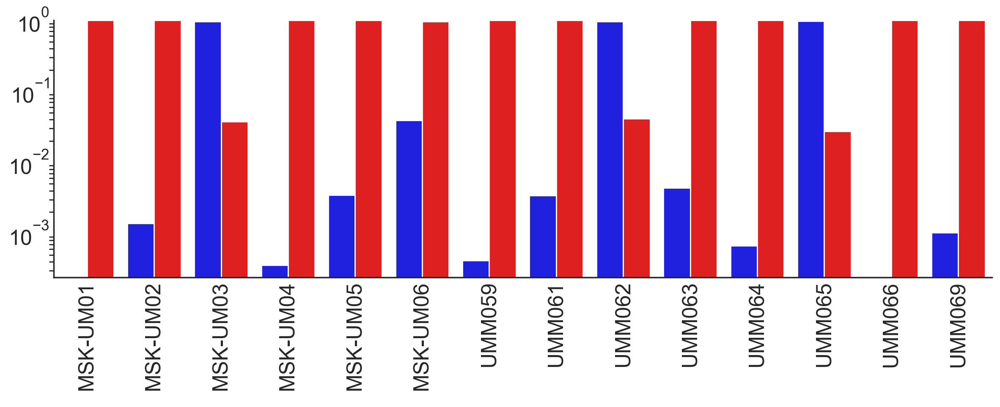

In [249]:
boxplot_patient_list = []
boxplot_fract_list = []
boxplot_class_list = []

for patient in METADATA_TUMOR.index.get_level_values('Patient').unique():
    tmp = [METADATA_TUMOR.loc[METADATA_TUMOR.index.get_level_values('Patient') == patient].\
           Assignment.value_counts().reindex(METADATA_TUMOR.Assignment.unique(), fill_value=0)[x] 
           for x in GEP_CLASS_LIST]
    tmp = list(tmp/sum(tmp))
    
    boxplot_patient_list = boxplot_patient_list + ['MSK-' + patient for x in range(len(GEP_CLASS_LIST))]
    boxplot_fract_list = boxplot_fract_list + tmp
    boxplot_class_list = boxplot_class_list + GEP_CLASS_LIST

for patient in sort(METADATA_HARBOUR_PRIMARY.index.get_level_values('Patient').unique().tolist()):
    tmp = [METADATA_HARBOUR_PRIMARY.loc[METADATA_HARBOUR_PRIMARY.index.get_level_values('Patient') == patient].\
           Assignment.value_counts().reindex(METADATA_HARBOUR_PRIMARY.Assignment.unique(), fill_value=0)[x] 
           for x in GEP_CLASS_LIST]
    tmp = list(tmp/sum(tmp))
    
    boxplot_patient_list = boxplot_patient_list + [patient for x in range(len(GEP_CLASS_LIST))]
    boxplot_fract_list = boxplot_fract_list + tmp
    boxplot_class_list = boxplot_class_list + GEP_CLASS_LIST

boxplot_data = pd.DataFrame()
boxplot_data['Patient'] = boxplot_patient_list
boxplot_data['Fraction'] = boxplot_fract_list
boxplot_data['Class'] = boxplot_class_list

# VIOLIN PLOT
fig = plt.figure(figsize = (12,5))
ax = plt.gca()

# Plot violin plot
g = sns.barplot(data=boxplot_data,x = 'Patient', 
                y = 'Fraction', hue = 'Class', ci=95, capsize=.2,
                palette={"Castle 1": "#0000FF", "Castle 2": "#FF0000", 'Mixed': '#000000'},
                linewidth = 1, ax = ax);
fig.get_axes()[0].set_yscale('log')

plt.ylim((0,1))
g.set_ylabel("",fontsize=10)
g.set_xlabel(" ",fontsize=10,rotation = 90)
g.tick_params(labelsize=18)
g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()
sns.set_style('white')
plt.tick_params(size=0)

ax.legend_.remove()
plt.tight_layout()
g.axis(True)

# SAVE FIGURE
figure_label = 'GEP_Distribution_COMBINED'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/TCGA_Distribution_COMBINED_BGMM_full_trained


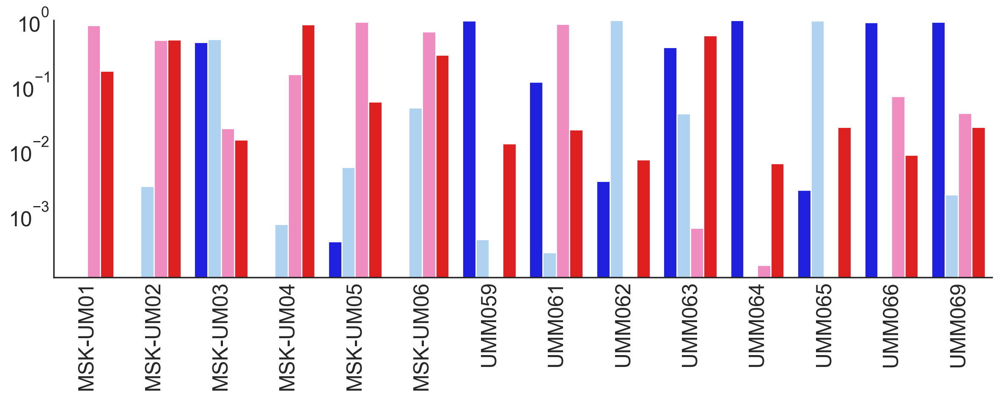

In [250]:
boxplot_patient_list = []
boxplot_fract_list = []
boxplot_class_list = []

for patient in METADATA_TUMOR.index.get_level_values('Patient').unique():
    tmp = [METADATA_TUMOR.loc[METADATA_TUMOR.index.get_level_values('Patient') == patient].\
           TCGA_Assignment.value_counts().reindex(METADATA_TUMOR.TCGA_Assignment.unique(), fill_value=0)[x] 
           for x in TCGA_CLASS_LIST]
    tmp = list(tmp/sum(tmp))
    
    boxplot_patient_list = boxplot_patient_list + ['MSK-' + patient for x in range(len(TCGA_CLASS_LIST))]
    boxplot_fract_list = boxplot_fract_list + tmp
    boxplot_class_list = boxplot_class_list + TCGA_CLASS_LIST

for patient in sort(METADATA_HARBOUR_PRIMARY.index.get_level_values('Patient').unique().tolist()):
    tmp = [METADATA_HARBOUR_PRIMARY.loc[METADATA_HARBOUR_PRIMARY.index.get_level_values('Patient') == patient].\
           TCGA_Assignment.value_counts().reindex(METADATA_HARBOUR_PRIMARY.TCGA_Assignment.unique(), fill_value=0)[x] 
           for x in TCGA_CLASS_LIST]
    tmp = list(tmp/sum(tmp))
    
    boxplot_patient_list = boxplot_patient_list + [patient for x in range(len(TCGA_CLASS_LIST))]
    boxplot_fract_list = boxplot_fract_list + tmp
    boxplot_class_list = boxplot_class_list + TCGA_CLASS_LIST

boxplot_data = pd.DataFrame()
boxplot_data['Patient'] = boxplot_patient_list
boxplot_data['Fraction'] = boxplot_fract_list
boxplot_data['Class'] = boxplot_class_list

# VIOLIN PLOT
fig = plt.figure(figsize = (12,5))
ax = plt.gca()

# Plot violin plot
g = sns.barplot(data=boxplot_data,x = 'Patient', 
                y = 'Fraction', hue = 'Class', ci=95, capsize=.2,
                palette={"TCGA1": "#0000FF",
                         "TCGA2": "#A4D3FC",
                         "TCGA3": "#FF7DC2", 
                         "TCGA4": "#FF0000"},
                linewidth = 1, ax = ax);
fig.get_axes()[0].set_yscale('log')

plt.ylim((0,1))
g.set_ylabel("",fontsize=10)
g.set_xlabel(" ",fontsize=10,rotation = 90)
g.tick_params(labelsize=18)
g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()
sns.set_style('ticks')
plt.tick_params(size=0)

ax.legend_.remove()
plt.tight_layout()
g.axis(True)

# SAVE FIGURE
figure_label = 'TCGA_Distribution_COMBINED_BGMM_full_trained'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
plt.savefig(fn + '.png', dpi=400, transparent=True)
plt.savefig(fn + '.pdf', dpi=400)
print(fn)

In [251]:
TCGA_probs_x_HARBOUR = [X_norm.loc[X_norm.index.map(lambda x: x[2] == y)].TCGA2.values - 
                        X_norm.loc[X_norm.index.map(lambda x: x[2] == y)].TCGA4.values
                        for y in X_norm.groupby(level='Patient').count().index]

TCGA_probs_y_HARBOUR = [X_norm.loc[X_norm.index.map(lambda x: x[2] == y)].TCGA1.values - 
                        X_norm.loc[X_norm.index.map(lambda x: x[2] == y)].TCGA3.values
                        for y in X_norm.groupby(level='Patient').count().index]

TCGA_probs_per_patient_HARBOUR = [[(TCGA_probs_x_HARBOUR[x][y], TCGA_probs_y_HARBOUR[x][y]) 
                                   for y in range(len(TCGA_probs_x_HARBOUR[x]))]
                                   for x in range(len(TCGA_probs_x_HARBOUR))]

/workdir/uvmel_project/figures/final_figures_10_27_20/TCGA_PROBS_DiamondPlot_HARBOUR_PRIMARY_1


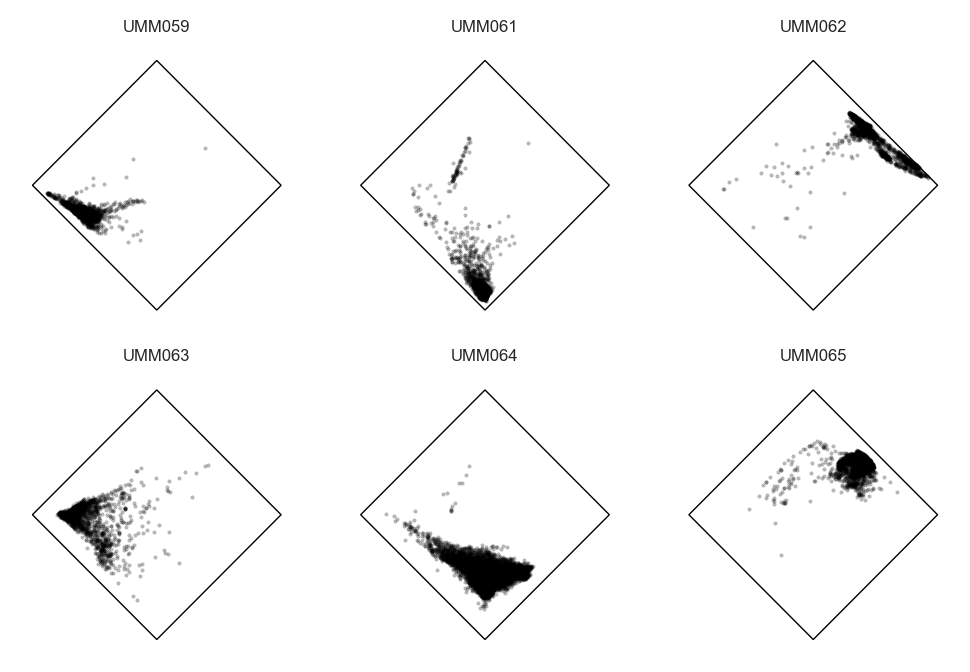

In [252]:
diamond_list = [plt.Rectangle((0,-1), np.sqrt(2), np.sqrt(2), 45, color='black', fill=False, linewidth=0.5) 
                for x in range(11)]

fig1, axes = plt.subplots(2,3)

for i, ax in enumerate(axes.flatten()):
    if i in range(len(TCGA_probs_per_patient_HARBOUR)):
        ax.scatter(*zip(*TCGA_probs_per_patient_HARBOUR[i]), s=0.2, color='black',
                   alpha=0.3)
        ax.set_frame_on(False)
        ax.axes.get_xaxis().set_visible(False)
        ax.axes.get_yaxis().set_visible(False)
        ax.add_patch(diamond_list[i])
        ax.set_title(X_norm.groupby(level='Patient').count().index[i], fontdict={'fontsize':6})
    else:
        ax.set_frame_on(False)
        ax.axes.get_xaxis().set_visible(False)
        ax.axes.get_yaxis().set_visible(False)

# SAVE FIGURE
figure_label = 'TCGA_PROBS_DiamondPlot_HARBOUR_PRIMARY_1'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig1.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig1.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/TCGA_PROBS_DiamondPlot_HARBOUR_PRIMARY_2


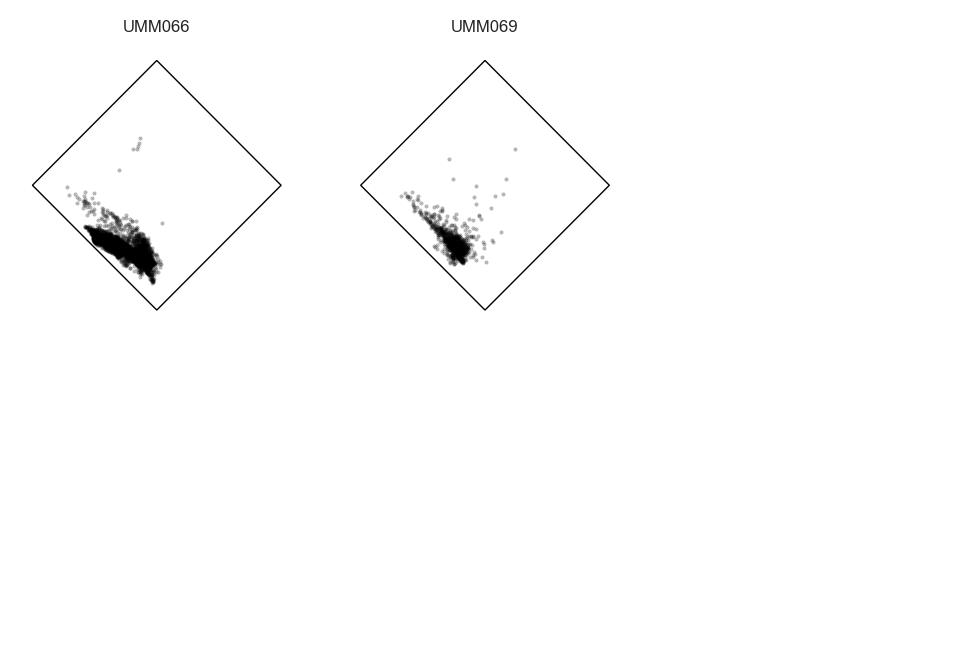

In [253]:
diamond_list = [plt.Rectangle((0,-1), np.sqrt(2), np.sqrt(2), 45, color='black', fill=False, linewidth=0.5) 
                for x in range(11)]

fig1, axes = plt.subplots(2,3)

for i, ax in enumerate(axes.flatten()):
    i = i + 6
    if i in range(len(TCGA_probs_per_patient_HARBOUR)):
        ax.scatter(*zip(*TCGA_probs_per_patient_HARBOUR[i]), s=0.2, color='black',
                   alpha=0.3)
        ax.set_frame_on(False)
        ax.axes.get_xaxis().set_visible(False)
        ax.axes.get_yaxis().set_visible(False)
        ax.add_patch(diamond_list[i])
        ax.set_title(X_norm.groupby(level='Patient').count().index[i], fontdict={'fontsize':6})
    else:
        ax.set_frame_on(False)
        ax.axes.get_xaxis().set_visible(False)
        ax.axes.get_yaxis().set_visible(False)

# SAVE FIGURE
figure_label = 'TCGA_PROBS_DiamondPlot_HARBOUR_PRIMARY_2'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig1.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig1.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### PRC1 TARGET GENES HEATMAPS - HARBOUR DATASET

#### GEP2 RANKED HEATMAP FOR PRC1 TARGET GENES

In [254]:
# RANK BY GEP 2
subset_type = 'TUMOR'
QUERY = INDF_HARBOUR

rank_by = 'Castle 2'#'Class 2 Onken v2'
genes = np.unique(genesets[rank_by].values.ravel().tolist())
detected_genes = [gene for gene in genes if gene in list(QUERY.columns)]

vals = QUERY[detected_genes]
SCORE = np.nanmedian(vals,axis=1)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/PRC1_Targets_Heatmap_UPDATED_HARBOUR


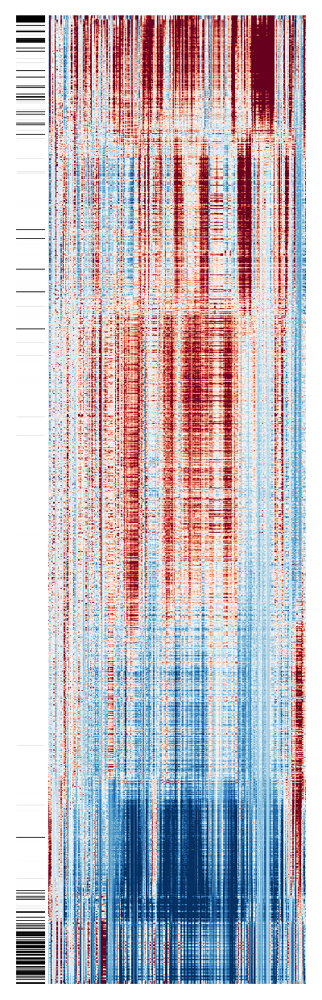

In [255]:
PRC1_target_genes = pd.read_csv(DATA_PATH+'PRC1_targets_Genesets_and_Chipseq.csv')
plot_genes = PRC1_target_genes['PRC1_targets_Genesets_and_Chipseq'].dropna().values.tolist()
plot_genes = [x for x in plot_genes if x in QUERY.columns.values.tolist()]

# LOAD GENESETS
path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')

# HEATMAP OF INDIVIDUAL CELLS RANKED BY LUNGE EP
rank_by = 'Castle 2'#
genesets_include = [rank_by]
genes = np.unique(genesets[genesets_include].values.ravel().tolist())
genes = [gene for gene in genes if gene in list(set(QUERY.columns))]
vals = QUERY[genes]
QUERY['GEP2_RANK'] =np.nanmean(vals,axis=1)

# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame( data = zscore(QUERY.sort_values(by=['GEP2_RANK'])[plot_genes],axis=0), 
                   columns = plot_genes, index = QUERY.sort_values(by=['GEP2_RANK']).index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'centroid' # average, single centroid/euclidean
metric = 'euclidean' # cosine
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)
cl = hc.leaves_list(col_linkage)
mat = heatmap_data.iloc[:,cl]

window = 20
mat = mat.rolling(window, win_type='triang',center = True).sum()
half_window = int(window/2)
for ind in np.arange(half_window):
    mat.iloc[ind] = mat.iloc[half_window]    
for ind in np.arange(half_window):
    mat.iloc[-ind] = mat.iloc[-half_window]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(4,10))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.4,0.6])
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-10,vmax=10)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
axmatrix.set_xticklabels([]);
axmatrix.grid(False)
axmatrix.spines['top'].set_visible(False)
axmatrix.spines['right'].set_visible(False)
axmatrix.spines['bottom'].set_visible(False)
axmatrix.spines['left'].set_visible(False)
plt.tick_params(axis='both', size=0)


# ADD ROW 1 COLOR BY SAMPLE TYPE
sample_status = [QUERY.loc[QUERY.index.get_level_values('Cell ID') == x].index.get_level_values('Legend').\
                          values[0] for x in mat.index.get_level_values('Cell ID').values]

lut_SAMPLE = dict({'primary': np.array([1, 1, 1]), 'metastatic': np.array([0, 0, 0])})

row_colors1 = pd.Series(sample_status, index=sample_status).map(lut_SAMPLE)
ax1 = fig.add_axes([0.07,0.1,0.045,0.6]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors1:
    pos = (x, y / len(row_colors1))
    ax1.add_patch(patches.Rectangle(pos, 1, 1 / len(row_colors1), color=c))
    if y >= len(row_colors1)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')


# SAVE FIGURE
figure_label = 'PRC1_Targets_Heatmap_UPDATED_HARBOUR'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/PRC1_Targets_UPDATED_GEP2_RANK__HARBOUR_curve


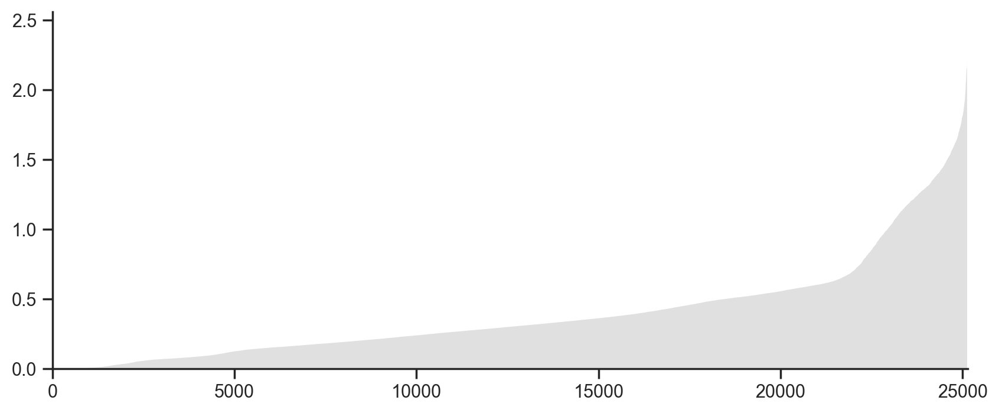

In [256]:
# LOAD GENESETS
plot_genes = ['IRF3', 'RELA', 'RELB', 'MB21D1', 'IKBKB', 'NFKB1', 'TMEM173', 'STAT2', 'CXCL10', 'NFKB2',
              'CCL5', 'TBK1', 'JAK1', 'JAK2', 'IRF9', 'TYK2', 'IRF7', 'IRF1', 'STAT1'
             ]

path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')

datatype = 'INDF_HARBOUR'
exec('QUERY = {}'.format(datatype))

# HEATMAP OF INDIVIDUAL CELLS RANKED BY LUNGE EP
rank_by = 'Castle 2'#
genesets_include = [rank_by]
genes = np.unique(genesets[genesets_include].values.ravel().tolist())
genes = [gene for gene in genes if gene in list(set(QUERY.columns))]
vals = QUERY[genes]
QUERY['GEP2_RANK'] =np.nanmean(vals,axis=1)
heatmap_data = pd.DataFrame( data = QUERY.sort_values(by=['GEP2_RANK'])[plot_genes +['GEP2_RANK']], 
                   columns = plot_genes +['GEP2_RANK'], index = QUERY.sort_values(by=['GEP2_RANK']).index)

y = heatmap_data['GEP2_RANK'].values
x = np.arange(len(y))

fig = plt.figure(figsize=(10,4))
ax = plt.gca()

ax.fill_between(x, 0, y,facecolor='#E0E0E0', interpolate=True)
plt.xlim((0,x.max()))
plt.ylim((0,y.max()))
sns.despine()


# SAVE FIGURE
figure_label = 'PRC1_Targets_UPDATED_GEP2_RANK__HARBOUR_curve'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

In [257]:
DF_HARBOUR.index.get_level_values('cellType').value_counts()

Class 2 PRAME+ Primary Tumor Cells    16405
Class 1A Primary Tumor Cells           5857
Class 2 PRAME- Primary Tumor Cells     1585
Class 1B PRAME+ Met Tumor Cells        1294
Name: cellType, dtype: int64

In [258]:
DF_HARBOUR_PRIMARY.index.get_level_values('cellType').value_counts()

Class 2 PRAME+ Primary Tumor Cells    15717
Class 1A Primary Tumor Cells           5839
Class 2 PRAME- Primary Tumor Cells     1543
Class 1B PRAME+ Met Tumor Cells           1
Name: cellType, dtype: int64

In [259]:
DF_HARBOUR_METASTASIS.index.get_level_values('cellType').value_counts()

Class 1B PRAME+ Met Tumor Cells       1293
Class 2 PRAME+ Primary Tumor Cells     688
Class 2 PRAME- Primary Tumor Cells      42
Class 1A Primary Tumor Cells            18
Name: cellType, dtype: int64

#### STING PATHWAY GENES HEATMAPS - HARBOUR DATASET

19
/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/STING_PATHWAY_Heatmap_HARBOUR


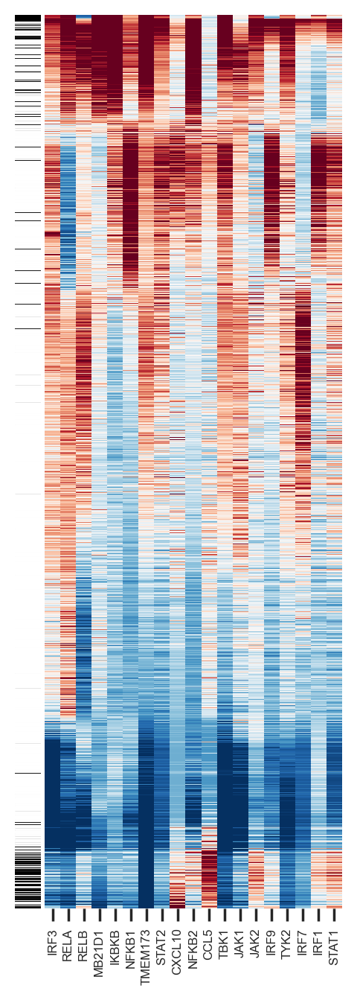

In [260]:
plot_genes = ['IRF3', 'RELA', 'RELB', 'MB21D1', 'IKBKB', 'NFKB1', 'TMEM173', 'STAT2', 'CXCL10', 'NFKB2',
              'CCL5', 'TBK1', 'JAK1', 'JAK2', 'IRF9', 'TYK2', 'IRF7', 'IRF1', 'STAT1'
             ]

print(len(plot_genes))

# LOAD GENESETS
path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')

subset_type = 'TUMOR'
QUERY = INDF_HARBOUR

# HEATMAP OF INDIVIDUAL CELLS RANKED BY LUNGE EP
rank_by = 'Castle 2'#
genesets_include = [rank_by]
genes = np.unique(genesets[genesets_include].values.ravel().tolist())
genes = [gene for gene in genes if gene in list(set(QUERY.columns))]
vals = QUERY[genes]
QUERY['GEP2_RANK'] =np.nanmean(vals,axis=1)

# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame( data = zscore(QUERY.sort_values(by=['GEP2_RANK'])[plot_genes],axis=0), 
                   columns = plot_genes, index = QUERY.sort_values(by=['GEP2_RANK']).index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
#method = 'average' # average, single centroid/euclidean
#metric = 'euclidean' # cosine
#linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
#col_linkage = deepcopy(linkage)
#cl = hc.leaves_list(col_linkage)
#mat = heatmap_data.iloc[:,cl]
mat = heatmap_data.copy()

window = 20
mat = mat.rolling(window, win_type='triang',center = True).sum()
half_window = int(window/2)
for ind in np.arange(half_window):
    mat.iloc[ind] = mat.iloc[half_window]    
for ind in np.arange(half_window):
    mat.iloc[-ind] = mat.iloc[-half_window]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(5,10))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.4,0.6])
colors = [(1,1,1), np.divide(tuple(hex('FF0000').rgb),255)]
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-10,vmax=10)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
#axmatrix.set_xticklabels([]);
xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 6,fontname='Arial')
ytick = plt.yticks([])
axmatrix.grid(False)
axmatrix.spines['top'].set_visible(False)
axmatrix.spines['right'].set_visible(False)
axmatrix.spines['bottom'].set_visible(False)
axmatrix.spines['left'].set_visible(False)


# ADD ROW 1 COLOR BY SAMPLE TYPE
sample_status = [QUERY.loc[QUERY.index.get_level_values('Cell ID') == x].index.get_level_values('Legend').\
                          values[0] for x in mat.index.get_level_values('Cell ID').values]

lut_SAMPLE = dict({'primary': np.array([1, 1, 1]), 'metastatic': np.array([0, 0, 0])})

row_colors1 = pd.Series(sample_status, index=sample_status).map(lut_SAMPLE)
ax1 = fig.add_axes([0.08,0.1,0.035,0.6]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors1:
    pos = (x, y / len(row_colors1))
    ax1.add_patch(patches.Rectangle(pos, 1, 1 / len(row_colors1), color=c))
    if y >= len(row_colors1)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')

# SAVE FIGURE
figure_label = 'STING_PATHWAY_Heatmap_HARBOUR'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### PRC1 TARGET GENES HEATMAPS - HARBOUR PRIMARY SAMPLES

#### GEP2 RANKED HEATMAP FOR PRC1 TARGET GENES

In [261]:
# RANK BY GEP 2
subset_type = 'TUMOR'
QUERY = INDF_HARBOUR_PRIMARY

rank_by = 'Castle 2'#'Class 2 Onken v2'
genes = np.unique(genesets[rank_by].values.ravel().tolist())
detected_genes = [gene for gene in genes if gene in list(QUERY.columns)]

vals = QUERY[detected_genes]
SCORE = np.nanmedian(vals,axis=1)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/PRC1_Targets_Heatmap_UPDATED_HARBOUR_PRIMARY


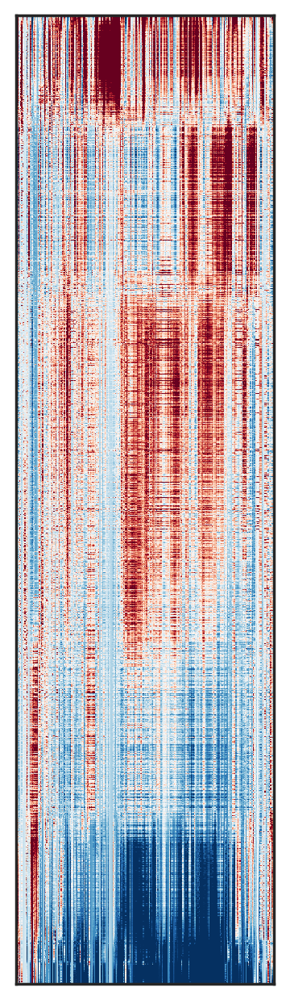

In [262]:
PRC1_target_genes = pd.read_csv(DATA_PATH+'PRC1_targets_Genesets_and_Chipseq.csv')
plot_genes = PRC1_target_genes['PRC1_targets_Genesets_and_Chipseq'].dropna().values.tolist()
plot_genes = [x for x in plot_genes if x in QUERY.columns.values.tolist()]

# LOAD GENESETS
path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')

# HEATMAP OF INDIVIDUAL CELLS RANKED BY LUNGE EP
rank_by = 'Castle 2'#
genesets_include = [rank_by]
genes = np.unique(genesets[genesets_include].values.ravel().tolist())
genes = [gene for gene in genes if gene in list(set(QUERY.columns))]
vals = QUERY[genes]
QUERY['GEP2_RANK'] =np.nanmean(vals,axis=1)

# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame( data = zscore(QUERY.sort_values(by=['GEP2_RANK'])[plot_genes],axis=0), 
                   columns = plot_genes, index = QUERY.sort_values(by=['GEP2_RANK']).index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'centroid' # average, single centroid/euclidean
metric = 'euclidean' # cosine
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)
cl = hc.leaves_list(col_linkage)
mat = heatmap_data.iloc[:,cl]

window = 20
mat = mat.rolling(window, win_type='triang',center = True).sum()
half_window = int(window/2)
for ind in np.arange(half_window):
    mat.iloc[ind] = mat.iloc[half_window]    
for ind in np.arange(half_window):
    mat.iloc[-ind] = mat.iloc[-half_window]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(4,10))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.4,0.6])
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-10,vmax=10)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
axmatrix.set_xticklabels([]);
axmatrix.grid(False)
plt.tick_params(axis='both', size=0)

# SAVE FIGURE
figure_label = 'PRC1_Targets_Heatmap_UPDATED_HARBOUR_PRIMARY'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

###### GEP2 RANKED HEATMAP NEW GENESET

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/average_euclidean_heatmap_NEW_GENESET_HARBOUR_PRIMARY


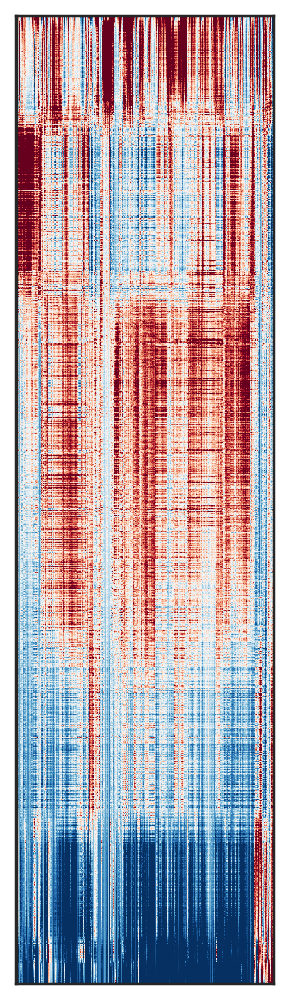

In [263]:
# RANK BY GEP 2
subset_type = 'HARBOUR_PRIMARY'
exec('QUERY = INDF_{}'.format(subset_type))
rank_by = 'Castle 2'#'Class 2 Onken v2'
genes = np.unique(genesets[rank_by].values.ravel().tolist())
detected_genes = [gene for gene in genes if gene in list(QUERY.columns)]

vals = QUERY[detected_genes]
SCORE = np.nanmedian(vals,axis=1)

target_genes = pd.read_csv(DATA_PATH+'829_PRE_92_1_geneset.txt', 
                                sep='\t', header=None, names=['genes'])
plot_genes = target_genes['genes'].dropna().values.tolist()
plot_genes = [x for x in plot_genes if x in QUERY.columns.values.tolist()]

# LOAD GENESETS
path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')

# HEATMAP OF INDIVIDUAL CELLS RANKED BY LUNGE EP
rank_by = 'Castle 2'#
genesets_include = [rank_by]
genes = np.unique(genesets[genesets_include].values.ravel().tolist())
genes = [gene for gene in genes if gene in list(set(QUERY.columns))]
vals = QUERY[genes]
QUERY['GEP2_RANK'] =np.nanmean(vals,axis=1)

# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame( data = zscore(QUERY.sort_values(by=['GEP2_RANK'])[plot_genes],axis=0), 
                   columns = plot_genes, index = QUERY.sort_values(by=['GEP2_RANK']).index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'average' # average, single centroid/euclidean
metric = 'euclidean' # cosine
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)
cl = hc.leaves_list(col_linkage)
mat = heatmap_data.iloc[:,cl]

window = 20
mat = mat.rolling(window, win_type='triang',center = True).sum()
half_window = int(window/2)
for ind in np.arange(half_window):
    mat.iloc[ind] = mat.iloc[half_window]    
for ind in np.arange(half_window):
    mat.iloc[-ind] = mat.iloc[-half_window]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(4,10))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.4,0.6])
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-10,vmax=10)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
axmatrix.set_xticklabels([]);
axmatrix.grid(False)
plt.tick_params(axis='both', size=0)

# SAVE FIGURE
figure_label = 'average_euclidean_heatmap_NEW_GENESET_HARBOUR_PRIMARY'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

###### GEP2 RANKED CURVE

In [264]:
INDF_HARBOUR_PRIMARY.index.get_level_values('cellType').value_counts()

Class 2 PRAME+ Primary Tumor Cells    15717
Class 1A Primary Tumor Cells           5839
Class 2 PRAME- Primary Tumor Cells     1543
Class 1B PRAME+ Met Tumor Cells           1
Name: cellType, dtype: int64

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/PRC1_Targets_UPDATED_GEP2_RANK__HARBOUR_PRIMARY_curve


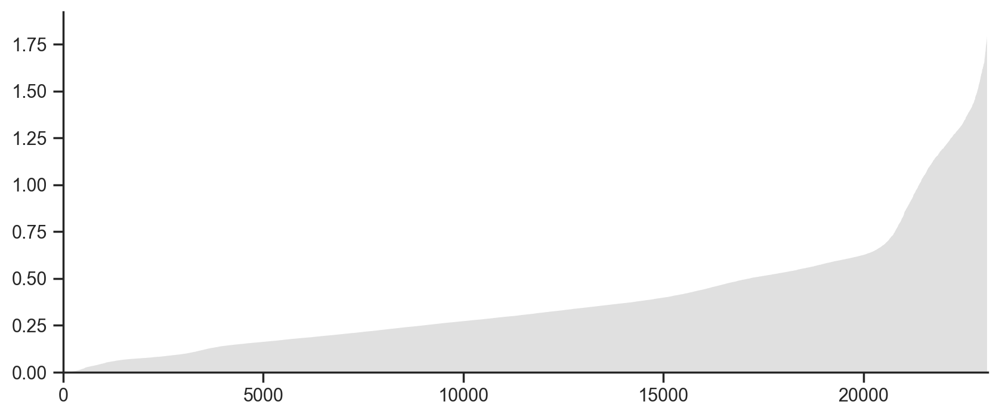

In [265]:
# LOAD GENESETS
plot_genes = ['IRF3', 'RELA', 'RELB', 'MB21D1', 'IKBKB', 'NFKB1', 'TMEM173', 'STAT2', 'CXCL10', 'NFKB2',
              'CCL5', 'TBK1', 'JAK1', 'JAK2', 'IRF9', 'TYK2', 'IRF7', 'IRF1', 'STAT1'
             ]

path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')

datatype = 'INDF_HARBOUR_PRIMARY'
exec('QUERY = {}'.format(datatype))

# HEATMAP OF INDIVIDUAL CELLS RANKED BY LUNGE EP
rank_by = 'Castle 2'#
genesets_include = [rank_by]
genes = np.unique(genesets[genesets_include].values.ravel().tolist())
genes = [gene for gene in genes if gene in list(set(QUERY.columns))]
vals = QUERY[genes]
QUERY['GEP2_RANK'] =np.nanmean(vals,axis=1)
heatmap_data = pd.DataFrame( data = QUERY.sort_values(by=['GEP2_RANK'])[plot_genes +['GEP2_RANK']], 
                   columns = plot_genes +['GEP2_RANK'], index = QUERY.sort_values(by=['GEP2_RANK']).index)

y = heatmap_data['GEP2_RANK'].values
x = np.arange(len(y))

fig = plt.figure(figsize=(10,4))
ax = plt.gca()

ax.fill_between(x, 0, y,facecolor='#E0E0E0', interpolate=True)
plt.xlim((0,x.max()))
plt.ylim((0,y.max()))
sns.despine()


# SAVE FIGURE
figure_label = 'PRC1_Targets_UPDATED_GEP2_RANK__HARBOUR_PRIMARY_curve'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

#### STING PATHWAY GENES HEATMAPS

32
/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps//STING_PATHWAY_Heatmap_HARBOUR_PRIMARY_EXTENDED_CLUSTERED_centroid_euclidean


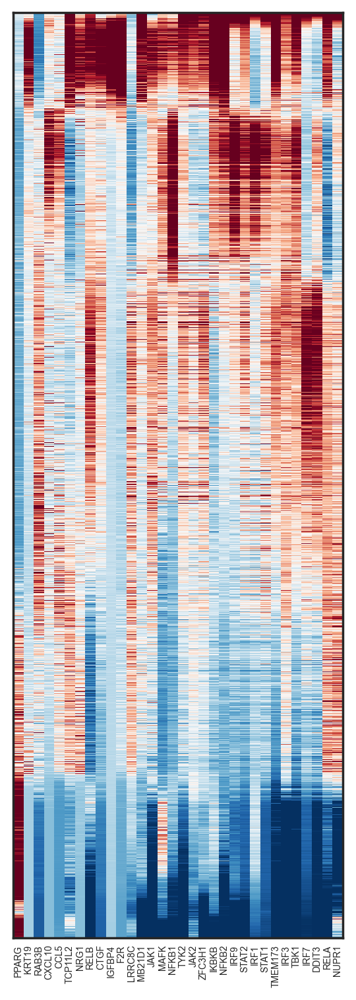

In [266]:
plot_genes = ['MB21D1','TMEM173','IRF3','RELA','RELB','IKBKB','NFKB1',
              'STAT2','CXCL10','NFKB2','CCL5',
              'TBK1','JAK1','JAK2','IRF9',
              'TYK2','IRF7','IRF1','STAT1',
              'PPARG','DDIT3','NUPR1','RAB3B','IGFBP4','LRRC8C',
              'TCP11L2','MAFK','NRG1','F2R','KRT19','CTGF','ZFC3H1']

print(len(plot_genes))

# LOAD GENESETS
path_to_genesets = DATA_PATH+'uveal_melanoma_MB_v3.csv'
genesets = pd.read_csv(path_to_genesets,header='infer')

subset_type = 'TUMOR'
QUERY = INDF_HARBOUR_PRIMARY

# HEATMAP OF INDIVIDUAL CELLS RANKED BY LUNGE EP
rank_by = 'Castle 2'#
genesets_include = [rank_by]
genes = np.unique(genesets[genesets_include].values.ravel().tolist())
genes = [gene for gene in genes if gene in list(set(QUERY.columns))]
vals = QUERY[genes]
QUERY['GEP2_RANK'] =np.nanmean(vals,axis=1)

# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame( data = zscore(QUERY.sort_values(by=['GEP2_RANK'])[plot_genes],axis=0), 
                   columns = plot_genes, index = QUERY.sort_values(by=['GEP2_RANK']).index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'centroid' # average, single centroid/euclidean
metric = 'euclidean' # cosine
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)
cl = hc.leaves_list(col_linkage)
mat = heatmap_data.iloc[:,cl]
#mat = heatmap_data.copy()

window = 20
mat = mat.rolling(window, win_type='triang',center = True).sum()
half_window = int(window/2)
for ind in np.arange(half_window):
    mat.iloc[ind] = mat.iloc[half_window]    
for ind in np.arange(half_window):
    mat.iloc[-ind] = mat.iloc[-half_window]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(5,10))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.5,0.7])
colors = [(1,1,1), np.divide(tuple(hex('FF0000').rgb),255)]
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-10,vmax=10)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
#axmatrix.set_xticklabels([]);
xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 5,fontname='Arial')
ytick = plt.yticks([])
axmatrix.grid(False)
plt.tick_params(size=0)

# SAVE FIGURE
figure_label = '/STING_PATHWAY_Heatmap_HARBOUR_PRIMARY_EXTENDED_CLUSTERED_centroid_euclidean'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/GEP2_Ranked_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### GEP PROGNOSTIFICATION OF INDIVIDUAL TUMOR CELLS - HARBOUR

#### GEP SIGNATURE CLUSTERED HEATMAP

In [267]:
class_genes = GEP_markerfile_df.index.values.tolist()

QUERY = INDF_HARBOUR

# COLUMN INDEX AND COLORS
genes = [gene for gene in class_genes if gene in QUERY.columns]#gene_array['Gene'].values
# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame(data = zscore(QUERY[genes].values,axis=0),columns = genes, index = QUERY.index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'average' # average, single
metric = 'euclidean' # cosine
linkage = hc.linkage(heatmap_data, method=method, metric = metric)
row_linkage = deepcopy(linkage)
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)

In [268]:
# REORDER HEATMAP ACCORDING TO LINKAGE (OPTIONAL, STILL SLOW)
r1 = hc.leaves_list(row_linkage)
mat = heatmap_data.iloc[r1,c1]

In [269]:
GEP_assignments_sorted = [METADATA_HARBOUR.loc
                          [METADATA_HARBOUR.index.get_level_values('Cell ID') == x].\
                          Assignment.\
                          values[0] for x in mat.index.get_level_values('Cell ID').values]

row_colors = pd.Series(GEP_assignments_sorted, index=GEP_assignments_sorted).map(lut_CASTLE)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP_HARBOUR_BayesianGMM


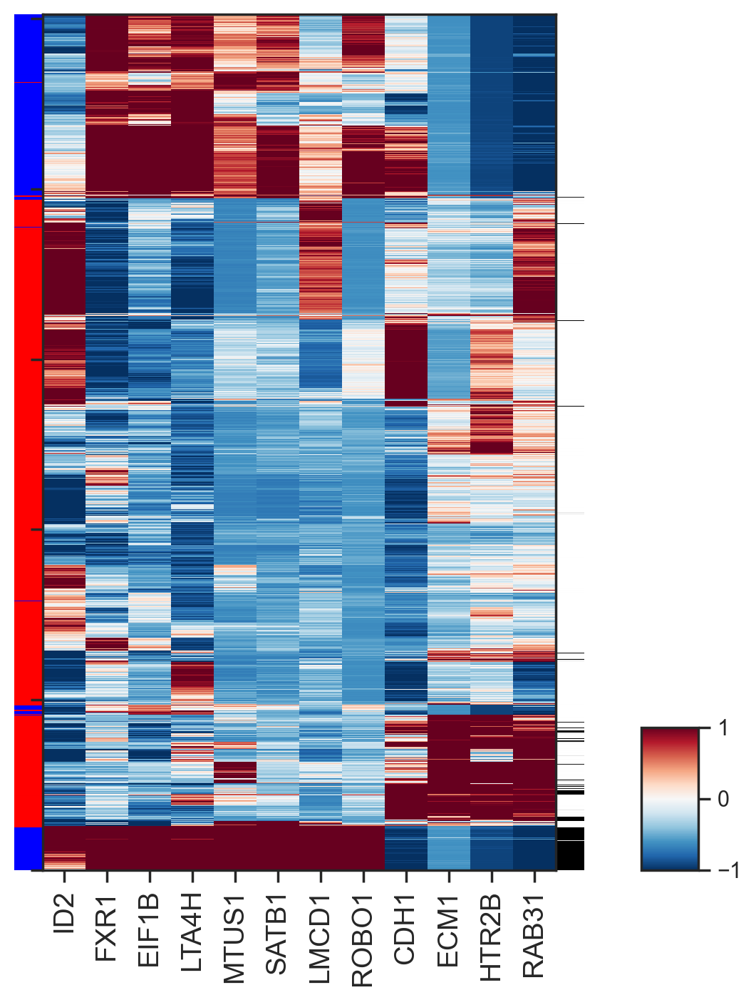

In [270]:
# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(4,10))
plt.rcParams["axes.grid"] = False

# ADD ROW COLOR INDEX 1 (GEP CLASS)
ax1 = fig.add_axes([0,0.1,0.05,0.6]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors:
    pos = (x, y / len(row_colors))
    ax1.add_patch(patches.Rectangle(pos, 1, 1 / len(row_colors), color=c))
    if y >= len(row_colors)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')

# ADD ROW 2 COLOR BY SAMPLE TYPE
sample_status = [QUERY.loc[QUERY.index.get_level_values('Cell ID') == x].index.get_level_values('Legend').\
                          values[0] for x in mat.index.get_level_values('Cell ID').values]

lut_SAMPLE = dict({'primary': np.array([1, 1, 1]), 'metastatic': np.array([0, 0, 0])})

row_colors2 = pd.Series(sample_status, index=sample_status).map(lut_SAMPLE)
ax2 = fig.add_axes([0.95,0.1,0.05,0.6]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors2:
    pos = (x, y / len(row_colors2))
    ax2.add_patch(patches.Rectangle(pos, 1, 1 / len(row_colors2), color=c))
    if y >= len(row_colors2)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')

# ADD MATRIX WITH GENE NAMES
axmatrix = fig.add_axes([0.05,0.1,0.9,0.6])
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=plt.cm.RdBu_r,vmin=-1,vmax=1)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 14)

# ADD COLORBAR
axcolor = fig.add_axes([1.1,0.1,0.1,0.1])
cbar = plt.colorbar(im, cax=axcolor)
#cbar.ax.get_yaxis().set_ticks([])

# SAVE FIGURE
figure_label = 'GEP_HARBOUR_BayesianGMM'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

#### PAIRWISE CORRELATION BETWEEN MONOSOMY 3 SIGNATURE AND GEP 2

In [271]:
# VIOLIN PLOTS
subset_type = 'HARBOUR'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

meta = 'Assignment'

gene1 = 'Castle 2'
signature_genes = genesets[gene1].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
G1 = (np.nansum(QUERY[detected_genes],axis=1))#*complexity

gene2 = 'Monosomy 3 Up'
signature_genes = genesets[gene2].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
G2 = (np.nansum(QUERY[detected_genes],axis=1))#*complexity

# ROW INDEX
meta = 'Assignment'
groupby_type = meta # 'Class', 'Meta-Source', 'Legend'
FLATUI = ['0000FF','FF0000']#FLATUI_CLASS, 'FLATUI_SOURCE, FLATUI_SAMPLES

violin_data = pd.DataFrame({
                            meta:list(META[meta]),
                            gene1: G1,
                            gene2: G2,
                           })

ind = violin_data[groupby_type]

# CONVERT HEX TO RGB (FLATUI_CLASS)
colors = np.zeros((len(FLATUI),3))
for ii,hexcolor in enumerate(FLATUI):
    colors[ii,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
# Palatte for Class METADATA
cix = (np.linspace(0,shape(colors)[0],len(np.unique(ind)))).astype(int)
if cix[len(cix)-1]==shape(colors)[0]:
    cix[len(cix)-1]=shape(colors)[0]-1
lut = dict(zip(np.unique(ind), colors[cix,:]))
dot_colors = pd.Series(ind).map(lut)
metacell_colors = [rgb2hex(int(color[0]*255), int(color[1]*255), int(color[2]*255)) for color in dot_colors]

Castle 2 vs Monosomy 3 Up, R: 0.5145947269130748, p: 0.0
/workdir/uvmel_project/figures/final_figures_10_27_20/M3_GEP2_Correlation_BGMM_HARBOUR


<Figure size 1440x1440 with 0 Axes>

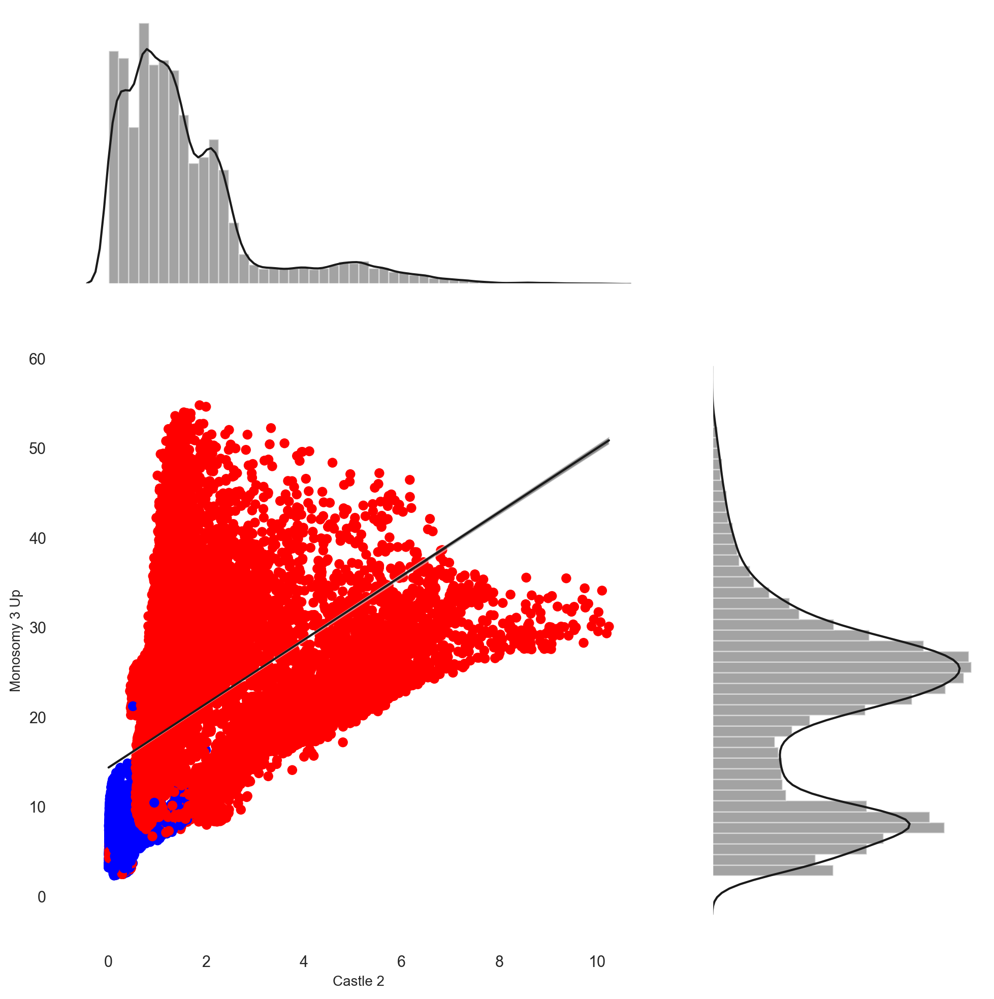

In [272]:
# DISTRIBUTION OF SOX2/SOX9
x = gene1
y = gene2

plt.figure(figsize = (20,20))
sns.despine()
sns.set(rc={'axes.facecolor':'white', 'figure.facecolor':'white'})

# JOINTPLOT
g = sns.jointplot(x,y, data=violin_data.fillna(0), kind="reg", stat_func=None,ratio=2, color='k', size=10)
g.ax_joint.cla() # or g.ax_joint.collections[0].set_visible(False), as per mwaskom's comment

# REPLOT SCATTER WITH LINEAGE COLORED
plt.sca(g.ax_joint)
plt.scatter(violin_data[x], violin_data[y], c=dot_colors)

# ADD REGRESSION
xx = violin_data[x]
yy = violin_data[y]
f = lambda x, *p: polyval(p, x)
p, cov = curve_fit(f, xx, yy, [1, 1])

# simulated draws from the probability density function of the regression
xi = linspace(np.min(xx), np.max(xx), 100)
ps = np.random.multivariate_normal(p, cov, 10000)
ysample = np.asarray([f(xi, *pi) for pi in ps])
lower = percentile(ysample, 10, axis=0)
upper = percentile(ysample, 90, axis=0)

# regression estimate line
y_fit = poly1d(p)(xi)

# PLOT REGRESSION LINE
plt.fill_between(xi, lower, upper, facecolor='k', alpha=0.5)
plt.plot(xi, y_fit, 'k-')
#plt.xlim((0,5))
#plt.ylim((0,5))

# ADD AXIS LABELS
g.set_axis_labels(x, y, fontsize=10,fontname = 'Arial')

# COMPUTE STATISTICS
(r, p) = stats.pearsonr(violin_data[x].fillna(0), violin_data[y].fillna(0))
print('{} vs {}, R: {}, p: {}'.format(x,y,r,p))

# SAVE FIGURE
figure_label = 'M3_GEP2_Correlation_BGMM_HARBOUR'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

#### EVALUATE GENE EXPRESSION PER GEP CLASS

BAP1 CLASS1 vs. CLASS2
MannwhitneyuResult(statistic=6414116.0, pvalue=0.0)
/workdir/uvmel_project/figures/final_figures_10_27_20/BAP1_Expression_by_GEP_BGMM_HARBOUR


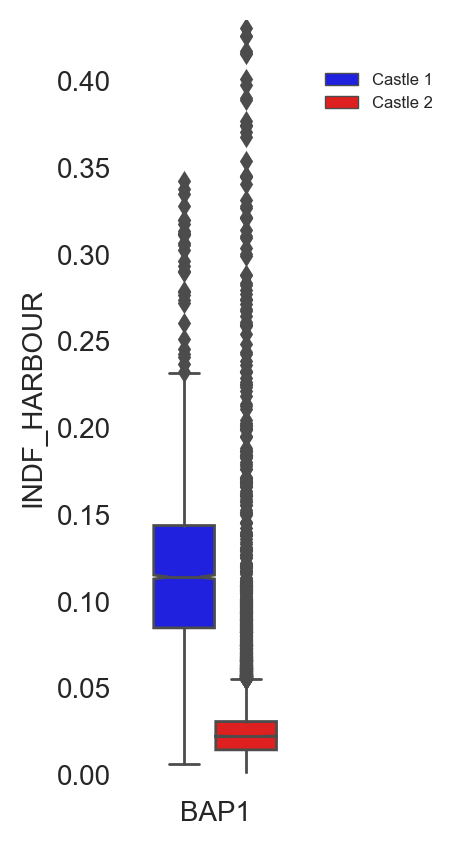

In [273]:
plot_type = 'box'
title = 'BAP1'
meta = 'Assignment'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

fig = plt.figure(figsize = (1,5))
ax = plt.gca()

scale_type = 'count'
palette = dict(zip(['Castle 1','Castle 2'],['#0000FF','#FF0000'])) 


genes = [title]
genes = np.unique([x for x in genes if str(x) != 'NAN'])
detected_genes = list(set(genes).intersection(set(QUERY.columns)))
vals = QUERY[detected_genes]
SCORE = np.nansum(vals,axis=1)

# Format data structure for violin plot
violin_data = []
for ind,v in enumerate(SCORE):
    violin_data.append({'gene': title, 'Z-normalized Expression': v,
                        meta:META[meta].values[ind]}) 
violin_data = pd.DataFrame(violin_data)  

# BOXPLOT GENE EXPRESSION
if plot_type == 'box':
    g = sns.boxplot(x="gene", y="Z-normalized Expression", 
                    hue=meta,data=violin_data, palette=palette,notch = True, 
                    hue_order = ['Castle 1','Castle 2'], 
                    fliersize = 4, showmeans=False,linewidth = 1, ax = ax) #order = labels, 
    g.set_ylabel("{}".format(datatype),fontsize=10)
    g.set_xlabel(" ",fontsize=10,rotation = 90)
    g.tick_params(labelsize=10)
    sns.despine()
    ax.set(ylim=(0, SCORE.max()*0.95))
    g.legend(loc='upper right',prop={'size':6},bbox_to_anchor=(2.0, 0.95),fancybox=True) 


elif plot_type == 'violin':
    # VIOLIN GENE EXPRESSION
    g = sns.violinplot(x="gene", y="Z-normalized Expression", 
                       hue=meta,data=violin_data, palette=palette,notch = True, 
                    hue_order = ['Castle 1','Castle 2'],fliersize = 4, showmeans=True,linewidth = 1) #order = labels, 

    g.set_ylabel("{}".format(datatype),fontsize=10)
    g.set_xlabel(" ",fontsize=10,rotation = 90)
    ax.set(ylim=(0, SCORE.max()*0.95))
    g.tick_params(labelsize=10)
    sns.despine()

# COMPARE DISTRIBUTIONS
CLASS1 = violin_data.loc[violin_data[meta].isin(['Castle 1'])]['Z-normalized Expression'].values
CLASS2 = violin_data.loc[violin_data[meta].isin(['Castle 2'])]['Z-normalized Expression'].values
print(title + ' CLASS1 vs. CLASS2')
print(stats.mannwhitneyu(CLASS1,CLASS2))

# SAVE FIGURE
figure_label = 'BAP1_Expression_by_GEP_BGMM_HARBOUR'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### GEP PROGNOSTIFICATION OF INDIVIDUAL TUMOR CELLS - HARBOUR PRIMARY

#### GEP SIGNATURE CLUSTERED HEATMAP

In [274]:
class_genes = GEP_markerfile_df.index.values.tolist()

QUERY = INDF_HARBOUR_PRIMARY

# COLUMN INDEX AND COLORS
genes = [gene for gene in class_genes if gene in QUERY.columns]#gene_array['Gene'].values
# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame(data = zscore(QUERY[genes].values,axis=0),columns = genes, index = QUERY.index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'centroid' # average, single
metric = 'euclidean' # cosine
linkage = hc.linkage(heatmap_data, method=method, metric = metric)
row_linkage = deepcopy(linkage)
linkage = hc.linkage(heatmap_data.T, method=method, metric = metric)
col_linkage = deepcopy(linkage)

In [275]:
# REORDER HEATMAP ACCORDING TO LINKAGE (OPTIONAL, STILL SLOW)
r1 = hc.leaves_list(row_linkage)
mat = heatmap_data.iloc[r1,c1]

In [276]:
GEP_assignments_sorted = [METADATA_HARBOUR.loc[METADATA_HARBOUR.index.get_level_values('Legend') == 'primary'].loc
                          [METADATA_HARBOUR.loc[METADATA_HARBOUR.index.get_level_values('Legend') == 'primary'].\
                           index.get_level_values('Cell ID') == x].Assignment.\
                          values[0] for x in mat.index.get_level_values('Cell ID').values]

row_colors = pd.Series(GEP_assignments_sorted, index=GEP_assignments_sorted).map(lut_CASTLE)

/workdir/uvmel_project/figures/final_figures_10_27_20/GEP_HARBOUR_PRIMARY_BayesianGMM


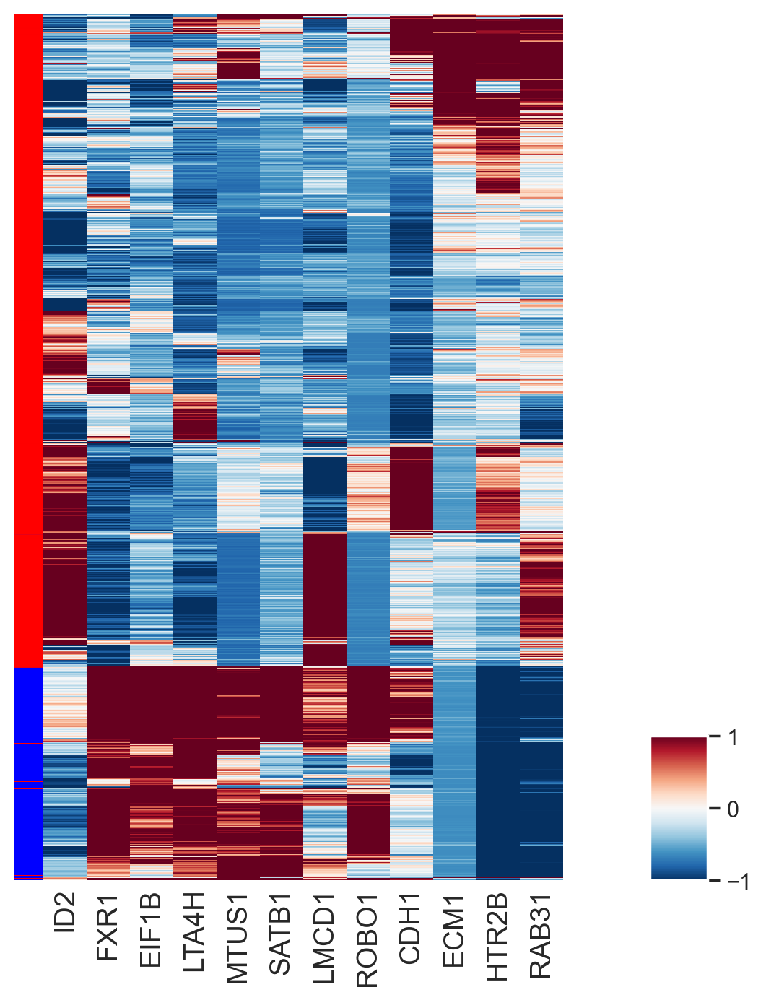

In [277]:
# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(4,10))
plt.rcParams["axes.grid"] = False

# ADD ROW COLOR INDEX 1 (PHENOGRAPH CLASS)
ax1 = fig.add_axes([0,0.1,0.05,0.6]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors:
    pos = (x, y / len(row_colors))
    ax1.add_patch(patches.Rectangle(pos, 1, 1 / len(row_colors), color=c))
    if y >= len(row_colors)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')

# ADD MATRIX WITH GENE NAMES
axmatrix = fig.add_axes([0.05,0.1,0.9,0.6], frameon=False)
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=plt.cm.RdBu_r,vmin=-1,vmax=1)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 14)
plt.tick_params(size=0)

# ADD COLORBAR
axcolor = fig.add_axes([1.1,0.1,0.1,0.1])
cbar = plt.colorbar(im, cax=axcolor)
#cbar.ax.get_yaxis().set_ticks([])

# SAVE FIGURE
figure_label = 'GEP_HARBOUR_PRIMARY_BayesianGMM'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

#### PAIRWISE CORRELATION BETWEEN MONOSOMY 3 AND GEP 2

In [278]:
METADATA_HARBOUR_PRIMARY['Assignment'] = [METADATA_HARBOUR.loc[
                                          METADATA_HARBOUR.index.get_level_values('Legend') == 'primary'].loc[
                                          METADATA_HARBOUR.loc[
                                          METADATA_HARBOUR.index.get_level_values('Legend') == 'primary'].\
                                          index.get_level_values('Cell ID') == x].Assignment.values[0] 
                                          for x in METADATA_HARBOUR_PRIMARY.index.get_level_values('Cell ID').values]

In [279]:
# VIOLIN PLOTS
subset_type = 'HARBOUR_PRIMARY'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

meta = 'Assignment'

gene1 = 'Castle 2'
signature_genes = genesets[gene1].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
G1 = (np.nansum(QUERY[detected_genes],axis=1))#*complexity

gene2 = 'Monosomy 3 Up'
signature_genes = genesets[gene2].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
G2 = (np.nansum(QUERY[detected_genes],axis=1))#*complexity

# ROW INDEX
meta = 'Assignment'
groupby_type = meta # 'Class', 'Meta-Source', 'Legend'
FLATUI = ['0000FF','FF0000']#FLATUI_CLASS, 'FLATUI_SOURCE, FLATUI_SAMPLES

violin_data = pd.DataFrame({
                            meta:list(META[meta]),
                            gene1: G1,
                            gene2: G2,
                           })

ind = violin_data[groupby_type]

# CONVERT HEX TO RGB (FLATUI_CLASS)
colors = np.zeros((len(FLATUI),3))
for ii,hexcolor in enumerate(FLATUI):
    colors[ii,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
# Palatte for Class METADATA
cix = (np.linspace(0,shape(colors)[0],len(np.unique(ind)))).astype(int)
if cix[len(cix)-1]==shape(colors)[0]:
    cix[len(cix)-1]=shape(colors)[0]-1
lut = dict(zip(np.unique(ind), colors[cix,:]))
dot_colors = pd.Series(ind).map(lut)
metacell_colors = [rgb2hex(int(color[0]*255), int(color[1]*255), int(color[2]*255)) for color in dot_colors]

Castle 2 vs Monosomy 3 Up, R: 0.47181012840617187, p: 0.0
/workdir/uvmel_project/figures/final_figures_10_27_20/M3_GEP2_Correlation_BGMM_HARBOUR_PRIMARY


<Figure size 1440x1440 with 0 Axes>

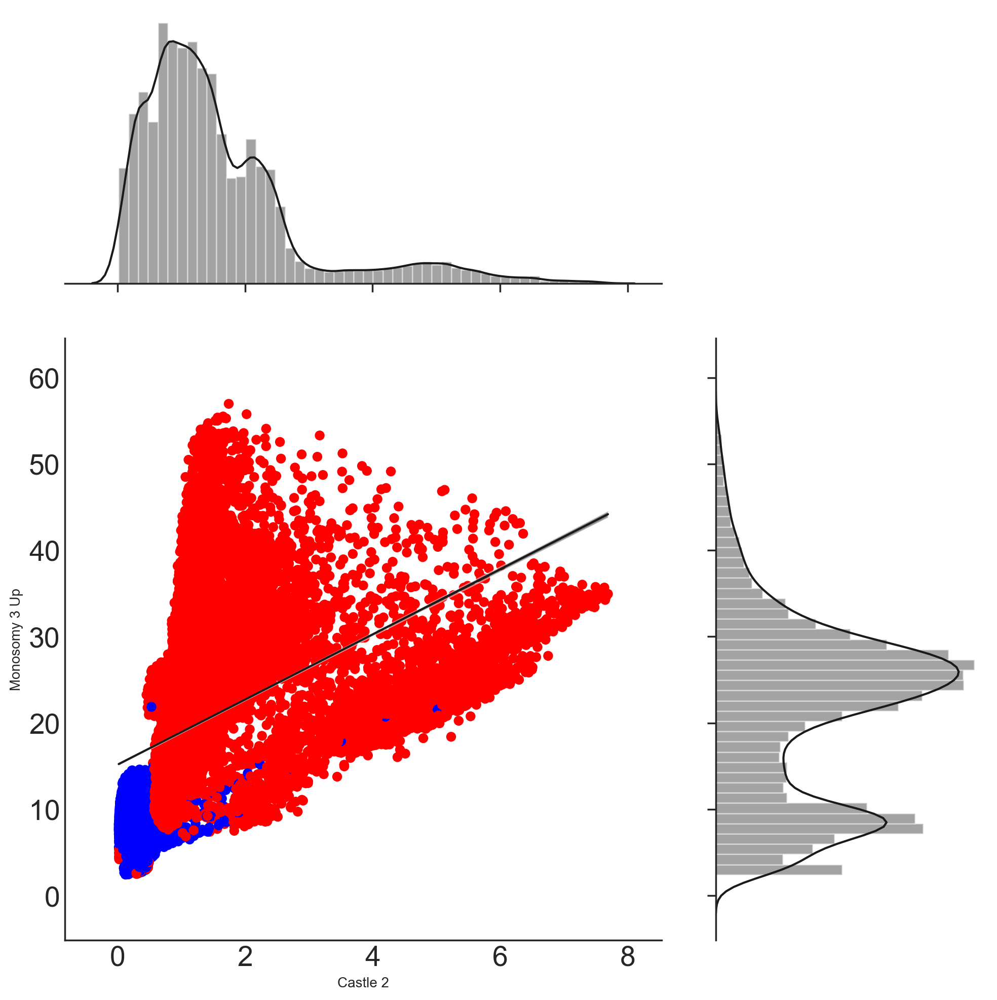

In [280]:
# DISTRIBUTION OF SOX2/SOX9
x = gene1
y = gene2

plt.figure(figsize = (20,20))
#sns.set(rc={'axes.facecolor':'white', 'figure.facecolor':'white'})
sns.set_style('ticks')

# JOINTPLOT
g = sns.jointplot(x,y, data=violin_data.fillna(0), kind="reg", stat_func=None,ratio=2, color='k', size=10)
g.ax_joint.cla() # or g.ax_joint.collections[0].set_visible(False), as per mwaskom's comment

# REPLOT SCATTER WITH LINEAGE COLORED
plt.sca(g.ax_joint)
plt.scatter(violin_data[x], violin_data[y], c=dot_colors)

# ADD REGRESSION
xx = violin_data[x]
yy = violin_data[y]
f = lambda x, *p: polyval(p, x)
p, cov = curve_fit(f, xx, yy, [1, 1])

# simulated draws from the probability density function of the regression
xi = linspace(np.min(xx), np.max(xx), 100)
ps = np.random.multivariate_normal(p, cov, 10000)
ysample = np.asarray([f(xi, *pi) for pi in ps])
lower = percentile(ysample, 10, axis=0)
upper = percentile(ysample, 90, axis=0)

# regression estimate line
y_fit = poly1d(p)(xi)

# PLOT REGRESSION LINE
plt.fill_between(xi, lower, upper, facecolor='k', alpha=0.5)
plt.plot(xi, y_fit, 'k-')
#plt.xlim((0,5))
#plt.ylim((0,5))
plt.tick_params(size=0)
plt.yticks(ticks=[0, 10, 20, 30, 40, 50, 60], 
           labels=['0', '10', '20', '30', '40', '50', '60'], size=20)
plt.xticks(ticks=[0, 2, 4, 6, 8], labels=['0', '2', '4', '6', '8'], size=20)

# ADD AXIS LABELS
g.set_axis_labels(x, y, fontsize=10,fontname = 'Arial')

# COMPUTE STATISTICS
(r, p) = stats.pearsonr(violin_data[x].fillna(0), violin_data[y].fillna(0))
print('{} vs {}, R: {}, p: {}'.format(x,y,r,p))

# SAVE FIGURE
figure_label = 'M3_GEP2_Correlation_BGMM_HARBOUR_PRIMARY'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

#### EVALUATE GENE EXPRESSION PER GEP CLASS

BAP1 CLASS1 vs. CLASS2
MannwhitneyuResult(statistic=5833581.0, pvalue=0.0)
/workdir/uvmel_project/figures/final_figures_10_27_20/BAP1_Expression_by_GEP_BGMM_HARBOUR_PRIMARY


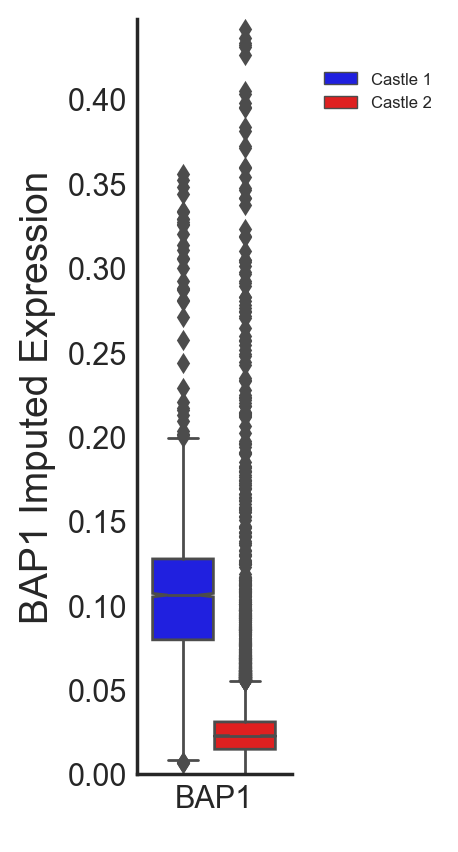

In [281]:
plot_type = 'box'
title = 'BAP1'
meta = 'Assignment'
datatype = 'INDF_{}'.format(subset_type)
exec('QUERY = {}'.format(datatype))
exec('META = METADATA_{}'.format(subset_type))

fig = plt.figure(figsize = (1,5))
ax = plt.gca()

scale_type = 'count'
palette = dict(zip(['Castle 1','Castle 2'],['#0000FF','#FF0000'])) 


genes = [title]
genes = np.unique([x for x in genes if str(x) != 'NAN'])
detected_genes = list(set(genes).intersection(set(QUERY.columns)))
vals = QUERY[detected_genes]
SCORE = np.nansum(vals,axis=1)

# Format data structure for violin plot
violin_data = []
for ind,v in enumerate(SCORE):
    violin_data.append({'gene': title, 'Z-normalized Expression': v,
                        meta:META[meta].values[ind]}) 
violin_data = pd.DataFrame(violin_data)  

# BOXPLOT GENE EXPRESSION
if plot_type == 'box':
    g = sns.boxplot(x="gene", y="Z-normalized Expression", 
                    hue=meta,data=violin_data, palette=palette,notch = True, 
                    hue_order = ['Castle 1','Castle 2'], 
                    fliersize = 4, showmeans=False,linewidth = 1, ax = ax) #order = labels, 
    g.set_ylabel("BAP1 Imputed Expression", fontsize=14)
    g.set_xlabel(" ",fontsize=10,rotation = 90)
    g.tick_params(labelsize=11)
    sns.despine()
    ax.set(ylim=(0, SCORE.max()*0.95))
    g.legend(loc='upper right',prop={'size':6},bbox_to_anchor=(2.0, 0.95),fancybox=True) 


elif plot_type == 'violin':
    # VIOLIN GENE EXPRESSION
    g = sns.violinplot(x="gene", y="Z-normalized Expression", 
                       hue=meta,data=violin_data, palette=palette,notch = True, 
                    hue_order = ['Castle 1','Castle 2'],fliersize = 4, showmeans=True,linewidth = 1) #order = labels, 

    g.set_ylabel("BAP1 Imputed Expression", fontsize=14)
    g.set_xlabel(" ",fontsize=10,rotation = 90)
    ax.set(ylim=(0, SCORE.max()*0.95))
    g.tick_params(labelsize=11)
    sns.despine()
    
plt.tick_params(size=0)

# COMPARE DISTRIBUTIONS
CLASS1 = violin_data.loc[violin_data[meta].isin(['Castle 1'])]['Z-normalized Expression'].values
CLASS2 = violin_data.loc[violin_data[meta].isin(['Castle 2'])]['Z-normalized Expression'].values
print(title + ' CLASS1 vs. CLASS2')
print(stats.mannwhitneyu(CLASS1,CLASS2))

# SAVE FIGURE
figure_label = 'BAP1_Expression_by_GEP_BGMM_HARBOUR_PRIMARY'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
plt.savefig(fn + '.png', bbox_inches='tight',dpi=400)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

#### PHENOTYPIC VOLUME BY PATIENT

In [282]:
subset_type = 'HARBOUR_PRIMARY'
meta ='Assignment'

exec('QUERY = h5_data_harbour.load(\'/NDF_TUMOR_PRIMARY\')')
exec('METADATA_HARBOUR = h5_data_harbour.load(\'/METADATA_HARBOUR\')')
META = METADATA_HARBOUR.loc[METADATA_HARBOUR.index.map(lambda x: x[1] == 'primary')]
new_index = pd.MultiIndex.from_tuples(list(zip(META.index.get_level_values('Sample ID'), 
                                               META.index.get_level_values('Legend'),
                                               META.index.get_level_values('Patient'),
                                               META.index.get_level_values('Cell ID'),
                                               META[meta])), 
                                  names=['Sample ID','Legend', 'Patient','Cell ID',meta])
QUERY = pd.DataFrame(data = QUERY.values, index = new_index, columns = QUERY.columns)

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_filter_genes.png
Count Gene Filter 1: 2104
Count Gene Filter 2: 7290
Count Gene Filter 3: 277
(23100, 19235)
(23100, 19235)
19235


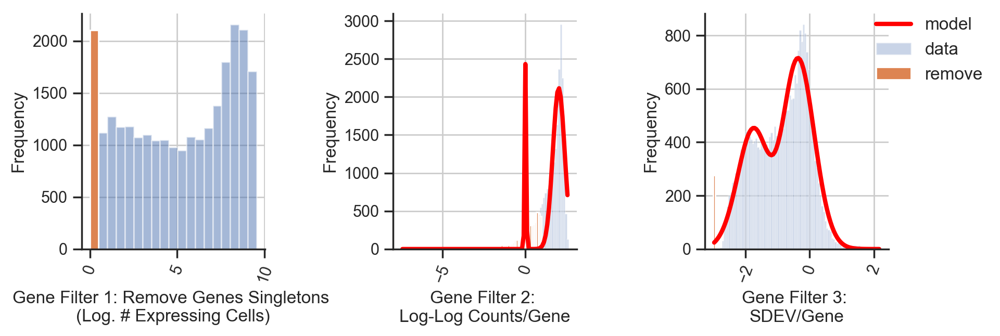

In [283]:
# SPECIFY SUBSET
fig_dpi = 400

# FIT BINOMIAL DISTRIBUTION AND FILTER BASED ON MEAN/STD OF SECOND
plt.figure(figsize = (10,3))
gs1 = gridspec.GridSpec(1, 3)
gs1.update(wspace=0.7, hspace=0.7) # set the spacing between axes. 

# (4) PLOT LOG NUMBER OF CELLS CONTRIBUTING TO EACH GENE
num_cells_per_gene = np.log(np.sum(QUERY.values > 0,axis=0))
num_cells_per_gene[(np.isinf(num_cells_per_gene)) | (np.isnan(num_cells_per_gene))] = 0
rmv_genes1 = np.where(num_cells_per_gene<=0)[0] # GENES MUST BE DETECTED IN AT LEAST 10 CELLS

ax = plt.subplot(gs1[0])
bins = np.linspace(num_cells_per_gene.min(), num_cells_per_gene.max()*0.95, 20)
plt.hist(num_cells_per_gene, bins, alpha=0.5, label='keep')

if rmv_genes1.any():
    plt.hist(num_cells_per_gene[rmv_genes1], bins, alpha=1, label='remove')
    
#ax.set_axis_bgcolor('white')
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('Gene Filter 1: Remove Genes Singletons \n(Log. # Expressing Cells)')
plt.grid(True)
sns.despine()

# (2) PLOT LOG COUNTS PER GENE - REMOVE LOW ABUNDANCE GENES
log_counts_per_gene = np.log(np.log(np.sum(QUERY.values,axis=0)))
log_counts_per_gene[(np.isinf(log_counts_per_gene)) | (np.isnan(log_counts_per_gene))] = 0
data = log_counts_per_gene

ax = plt.subplot(gs1[1])
bins = np.linspace(data.min(), data.max()*0.95, 100)
y,x,_=hist(data,bins,alpha=.3,label='data')

x=(x[1:]+x[:-1])/2 
expected=(0,.1,3500,1.75,.2,500)
params,cov=curve_fit(bimodal,x,y,expected)
sigma=sqrt(diag(cov))
plot(x,bimodal(x,*params),color='red',lw=3,label='model')

mu1 = params[0]
std1 = params[1]
mu2 = params[3]
std2 = params[4]
rmv_genes_neg = np.where(data<mu2-3*std2)[0]
rmv_genes2 = np.sort(list(set(list(rmv_genes_neg))))

if rmv_genes2.any():
    plt.hist(data[rmv_genes2], bins, alpha=1, label='remove')
    
#ax.set_axis_bgcolor('white')
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('Gene Filter 2: \nLog-Log Counts/Gene')
plt.grid(True)
sns.despine()

# (3) PLOT STDEV PER GENE
pseudocount = 0.001
std_per_gene = np.log10(QUERY.std(axis=0, skipna=False)+pseudocount)
data = std_per_gene

ax = plt.subplot(gs1[2])
bins = np.linspace(data.min(), data.max()*0.95, 100)
y,x,_=hist(data,bins,alpha=.3,label='data')

x=(x[1:]+x[:-1])/2 
expected=(0,-3,3000,-1,.2,500)
params,cov=curve_fit(bimodal,x,y,expected,maxfev=3000)
sigma=sqrt(diag(cov))
plot(x,bimodal(x,*params),color='red',lw=3,label='model')

mu1 = params[0]
std1 = params[1]
mu2 = params[3]
std2 = params[4]
rmv_genes_neg = np.where(data<mu2-3*abs(std2))[0]
rmv_genes3 = np.sort(list(set(list(rmv_genes_neg))))

if rmv_genes3.any():
    plt.hist(data[rmv_genes3], bins, alpha=1, label='remove')
    
#ax.set_axis_bgcolor('white')
plt.xticks(rotation=70)
plt.ylabel('Frequency')
plt.xlabel('Gene Filter 3: \nSDEV/Gene')
plt.grid(True)
sns.despine()

# Add (abbreviated) legend bottom left
L = plt.legend(loc='upper right',prop={'size':12},bbox_to_anchor=(1.6, 1.05),fancybox=True) 

# SAVE FIGURE
figure_label = '_filter_genes'
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label + '.png'
#plt.savefig(fn, dpi=fig_dpi)
print(fn)

# EVALUATE NUMBER OF CELLS/GENES REMOVED
print('Count Gene Filter 1: {}'.format(len(rmv_genes1)))
print('Count Gene Filter 2: {}'.format(len(rmv_genes2)))
print('Count Gene Filter 3: {}'.format(len(rmv_genes3)))

# REMOVE SELECTED OUTLIER GENES(HIGHLIGHTED IN GREEN)
CUT_DF = deepcopy(QUERY)
rmv_genes = np.sort(list(set(list(rmv_genes1) + list(rmv_genes2)+list(rmv_genes3))))
if rmv_genes.any():
    CUT_DF = CUT_DF.drop(CUT_DF.columns[rmv_genes],axis=1)
    print(CUT_DF.shape)
    
# Remove empty genes if they exist
drop_genes = np.where(CUT_DF.sum(axis=0)==0)[0]
CUT_DF = CUT_DF.drop(CUT_DF.columns[drop_genes],axis=1)
print(CUT_DF.shape)

# GENES EXCLUDING LOW ABUNDANCE GENES
variable_goi = list(CUT_DF.columns)
print(len(variable_goi))

In [284]:
C1_harbour = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UMM059')
C2_harbour = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UMM061')
C3_harbour = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UMM062')
C4_harbour = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UMM063')
C5_harbour = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UMM064')
C6_harbour = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UMM065')
C7_harbour = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UMM066')
C8_harbour = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UMM069')

/workdir/uvmel_project/figures/final_figures_10_27_20/Log_Phenotypic_Volume_BY_PATIENT_HARBOUR_PRIMARY


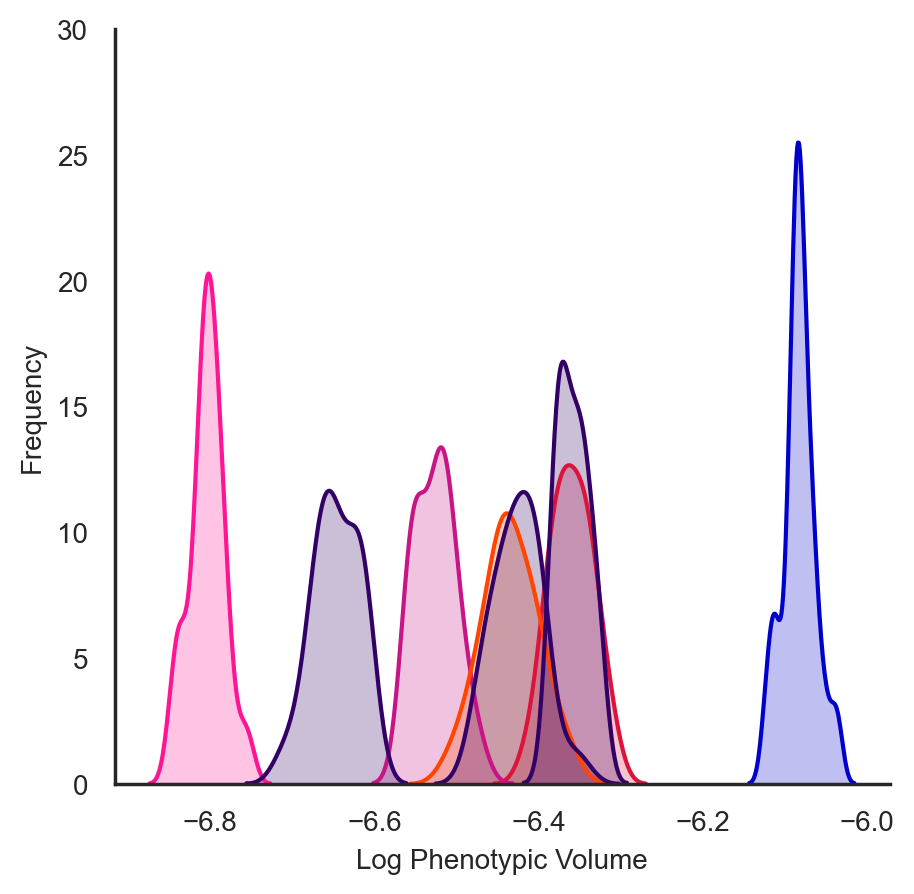

In [285]:
sns.set_style("white")
fig = plt.figure(figsize = (5,5))
ax = plt.gca()

#sns.kdeplot(IM, shade=True, color="#B0C4DE")
sns.kdeplot(C1_harbour, shade=True, color="#"+FLATUI_PATIENT[0])
sns.kdeplot(C2_harbour, shade=True, color="#"+FLATUI_PATIENT[1])
sns.kdeplot(C3_harbour, shade=True, color="#"+FLATUI_PATIENT[2])
sns.kdeplot(C4_harbour, shade=True, color="#"+FLATUI_PATIENT[3])
sns.kdeplot(C5_harbour, shade=True, color="#"+FLATUI_PATIENT[4])
sns.kdeplot(C6_harbour, shade=True, color="#"+FLATUI_PATIENT[5])
sns.kdeplot(C7_harbour, shade=True, color="#"+FLATUI_PATIENT[5])
sns.kdeplot(C8_harbour, shade=True, color="#"+FLATUI_PATIENT[5])

ax.set_ylabel("Frequency",fontsize=10)
ax.set_xlabel("Log Phenotypic Volume",fontsize=10)
ax.tick_params(labelsize=10)
#g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()
plt.ylim((0,30))

# SAVE FIGURE
figure_label = 'Log_Phenotypic_Volume_BY_PATIENT_HARBOUR_PRIMARY'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### PHENOTYPIC VOLUME INTRAPATIENT

In [286]:
# Patient UMM062:
QUERY_FULL = QUERY.copy()
QUERY = QUERY_FULL.loc[QUERY_FULL.index.map(lambda x: x[2] == 'UMM062')]

In [287]:
QUERY.index.get_level_values('Assignment').value_counts()

Castle 1    2311
Castle 2      99
Name: Assignment, dtype: int64

In [288]:
C1_UMM062 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UMM062_GEP1')
C2_UMM062 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UMM062_GEP2')

/workdir/uvmel_project/figures/final_figures_10_27_20/Log_Phenotypic_Volume_UMM062


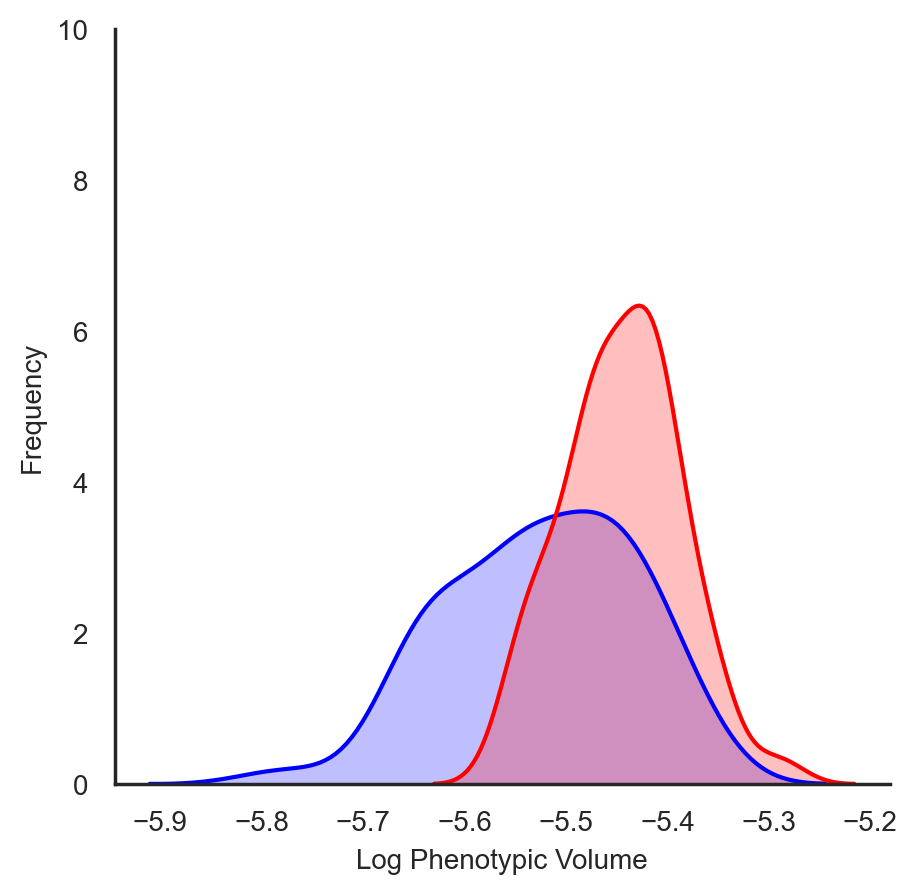

In [289]:
sns.set_style("white")
fig = plt.figure(figsize = (5,5))
ax = plt.gca()

#sns.kdeplot(IM, shade=True, color="#B0C4DE")
sns.kdeplot(C1_UMM062, shade=True, color="#0000FF")
sns.kdeplot(C2_UMM062, shade=True, color="#FF0000")

ax.set_ylabel("Frequency",fontsize=10)
ax.set_xlabel("Log Phenotypic Volume",fontsize=10)
ax.tick_params(labelsize=10)
#g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()
plt.ylim((0,10))

# SAVE FIGURE
figure_label = 'Log_Phenotypic_Volume_UMM062'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)


In [290]:
# Patient UMM065:
QUERY = QUERY_FULL.loc[QUERY_FULL.index.map(lambda x: x[2] == 'UMM065')]

In [291]:
QUERY.index.get_level_values('Assignment').value_counts()

Castle 1    3231
Castle 2      91
Name: Assignment, dtype: int64

In [292]:
C1_UMM065 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UMM065_GEP1')
C2_UMM065 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UMM065_GEP2')

/workdir/uvmel_project/figures/final_figures_10_27_20/Log_Phenotypic_Volume_UMM065


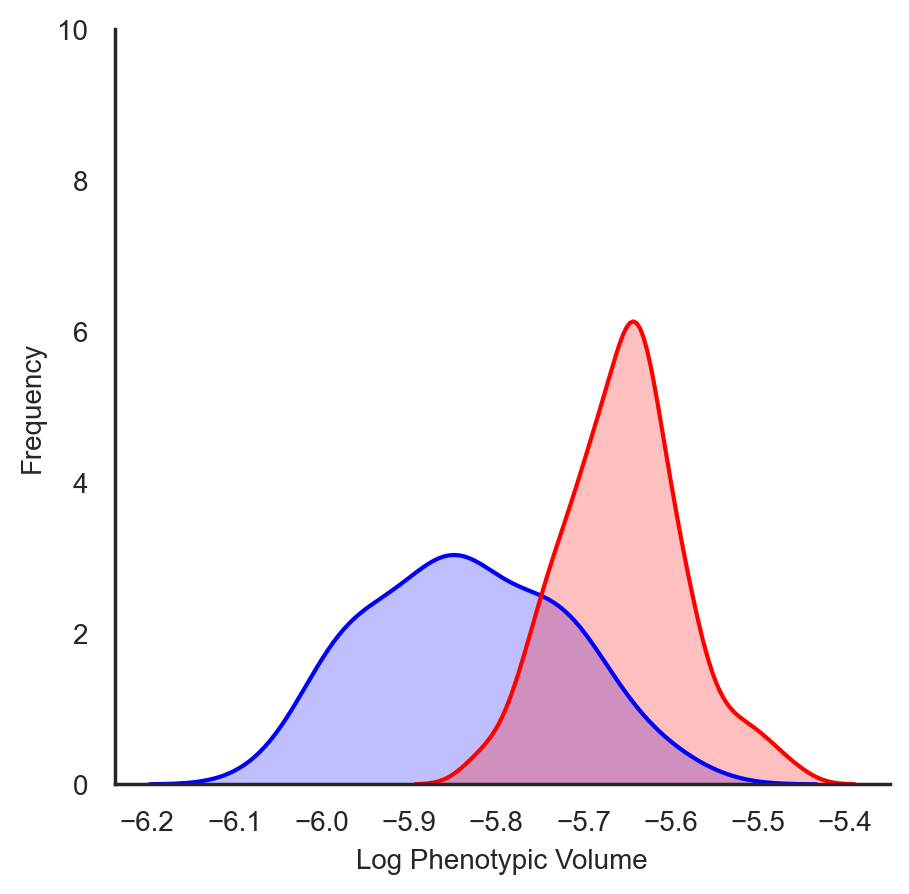

In [293]:
sns.set_style("white")
fig = plt.figure(figsize = (5,5))
ax = plt.gca()

#sns.kdeplot(IM, shade=True, color="#B0C4DE")
sns.kdeplot(C1_UMM065, shade=True, color="#0000FF")
sns.kdeplot(C2_UMM065, shade=True, color="#FF0000")

ax.set_ylabel("Frequency",fontsize=10)
ax.set_xlabel("Log Phenotypic Volume",fontsize=10)
ax.tick_params(labelsize=10)
#g.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()
plt.ylim((0,10))

# SAVE FIGURE
figure_label = 'Log_Phenotypic_Volume_UMM065'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)


## TESTING STING AND IFN IN CLASS 1 SAMPLES

In [294]:
INDF_HARBOUR_CLASS1 = INDF_HARBOUR.loc[INDF_HARBOUR.index.map(lambda x: x[2] in ['BSSR0022', 'UMM062', 'UMM065'])]

In [295]:
print(INDF_HARBOUR_CLASS1.shape)
INDF_HARBOUR_CLASS1.head()

(7067, 26538)


RP11-34P13.3  \
Sample ID Legend     Patient  Cell ID cellType                                        
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells           0.0   
                              1       Class 1B PRAME+ Met Tumor Cells           0.0   
                              2       Class 1B PRAME+ Met Tumor Cells           0.0   
                              3       Class 1B PRAME+ Met Tumor Cells           0.0   
                              4       Class 1B PRAME+ Met Tumor Cells           0.0   

                                                                       RP11-34P13.7  \
Sample ID Legend     Patient  Cell ID cellType                                        
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells           0.0   
                              1       Class 1B PRAME+ Met Tumor Cells           0.0   
                              2       Class 1B PRAME+ Met Tumor Cells           0.0   
                              3       Class 1B PRAME+ Met Tumor Cells           0.0   
                              4       Class 1B PRAME+ Met Tumor Cells           0.0   

                                                                       RP11-34P13.8  \
Sample ID Legend     Patient  Cell ID cellType                                        
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells           0.0   
                              1       Class 1B PRAME+ Met Tumor Cells           0.0   
                              2       Class 1B PRAME+ Met Tumor Cells           0.0   
                              3       Class 1B PRAME+ Met Tumor Cells           0.0   
                              4       Class 1B PRAME+ Met Tumor Cells           0.0   

                                                                       RP11-34P13.14  \
Sample ID Legend     Patient  Cell ID cellType                                         
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells            0.0   
                              1       Class 1B PRAME+ Met Tumor Cells            0.0   
                              2       Class 1B PRAME+ Met Tumor Cells            0.0   
                              3       Class 1B PRAME+ Met Tumor Cells            0.0   
                              4       Class 1B PRAME+ Met Tumor Cells            0.0   

                                                                       FO538757.3  \
Sample ID Legend     Patient  Cell ID cellType                                      
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells    0.001426   
                              1       Class 1B PRAME+ Met Tumor Cells    0.000200   
                              2       Class 1B PRAME+ Met Tumor Cells    0.004415   
                              3       Class 1B PRAME+ Met Tumor Cells    0.000134   
                              4       Class 1B PRAME+ Met Tumor Cells    0.000557   

                                                                       FO538757.2  \
Sample ID Legend     Patient  Cell ID cellType                                      
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells    0.160610   
                              1       Class 1B PRAME+ Met Tumor Cells    0.135168   
                              2       Class 1B PRAME+ Met Tumor Cells    0.162193   
                              3       Class 1B PRAME+ Met Tumor Cells    0.117363   
                              4       Class 1B PRAME+ Met Tumor Cells    0.151217   

                                                                       AP006222.2  \
Sample ID Legend     Patient  Cell ID cellType                                      
0         metastatic BSSR0022 0       Class 1B PRAME+ Met Tumor Cells    0.086971   
                              1       Class 1B PRAME+ Met Tumor Cells    0.111097   
                              2       Class 1B PRAME+ Met Tumor Cells    0.074493   
       

25
/workdir/uvmel_project/figures/final_figures_10_27_20/TEST_Heatmaps//STING_IFN_Heatmap_HARBOUR_Class1


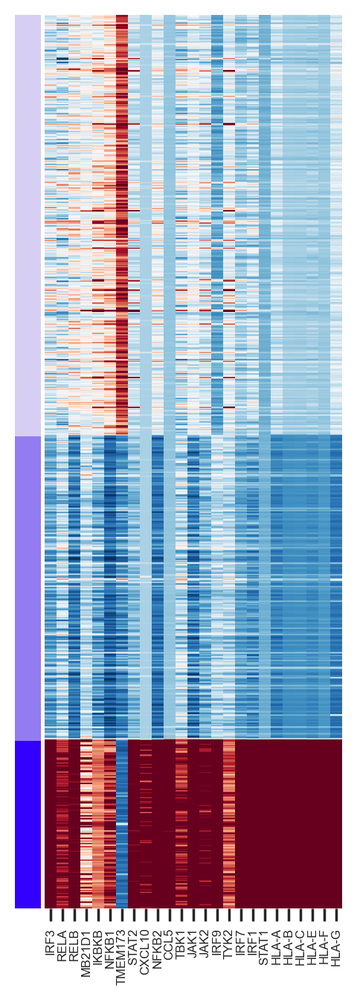

In [296]:
plot_genes = ['IRF3', 'RELA', 'RELB', 'MB21D1', 'IKBKB', 'NFKB1', 'TMEM173', 'STAT2', 'CXCL10', 'NFKB2',
              'CCL5', 'TBK1', 'JAK1', 'JAK2', 'IRF9', 'TYK2', 'IRF7', 'IRF1', 'STAT1',
              'HLA-A', 'HLA-B', 'HLA-C', 'HLA-E', 'HLA-F', 'HLA-G'
             ]

print(len(plot_genes))

subset_type = 'TUMOR'
QUERY = INDF_HARBOUR_CLASS1

# CONSTRUCT HEATMAP DATA
heatmap_data = pd.DataFrame(data = zscore(QUERY[plot_genes],axis=0), 
                            columns = plot_genes, index = QUERY.index)
yticks = heatmap_data.index
xticks = heatmap_data.columns

# LINKAGE 
method = 'centroid' # average, single centroid/euclidean
metric = 'euclidean' # cosine
#linkage = hc.linkage(heatmap_data, method=method, metric = metric)
#row_linkage = deepcopy(linkage)
#rl = hc.leaves_list(row_linkage)
#mat = heatmap_data.iloc[rl,:]
mat = heatmap_data.copy()

window = 20
mat = mat.rolling(window, win_type='triang',center = True).sum()
half_window = int(window/2)
for ind in np.arange(half_window):
    mat.iloc[ind] = mat.iloc[half_window]    
for ind in np.arange(half_window):
    mat.iloc[-ind] = mat.iloc[-half_window]

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(5,10))

# ADD MATRIX WITH LINEAGE NAMES
axmatrix = fig.add_axes([0.12,0.1,0.4,0.6])
colors = [(1,1,1), np.divide(tuple(hex('FF0000').rgb),255)]
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=CM_DIVERGING,vmin=-10,vmax=10)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
#axmatrix.set_xticklabels([]);
xtick = plt.xticks(range(len(labels)), labels, rotation = 90, fontsize = 6,fontname='Arial')
ytick = plt.yticks([])
axmatrix.grid(False)
axmatrix.spines['top'].set_visible(False)
axmatrix.spines['right'].set_visible(False)
axmatrix.spines['bottom'].set_visible(False)
axmatrix.spines['left'].set_visible(False)

# ADD ROW 1 COLOR BY SAMPLE TYPE
patient_status = [QUERY.loc[QUERY.index.get_level_values('Cell ID') == x].index.get_level_values('Patient').\
                          values[0] for x in mat.index.get_level_values('Cell ID').values]

lut_PATIENT_STATUS_TEMP = dict({'BSSR0022': np.array([51, 0, 255])/255, 
                                'UMM062': np.array([147, 124, 242])/255,
                                'UMM065': np.array([214, 207, 243])/255})

row_colors1 = pd.Series(patient_status, index=patient_status).map(lut_PATIENT_STATUS_TEMP)
ax1 = fig.add_axes([0.08,0.1,0.035,0.6]) # [x0,y0,width,height]
x = 0
y = 0
for c in row_colors1:
    pos = (x, y / len(row_colors1))
    ax1.add_patch(patches.Rectangle(pos, 1, 1 / len(row_colors1), color=c))
    if y >= len(row_colors1)-1:
        x += 1
        y = 0
    else:
        y += 1
plt.axis('off')

# SAVE FIGURE
figure_label = '/STING_IFN_Heatmap_HARBOUR_Class1'.format(meta,subset_type,method,metric)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/TEST_Heatmaps/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

## KARYOTYPIC ANALYSIS PER ARCHETYPE

### LOAD CNV RESULTS FROM CaSpER

In [297]:
mat_input = pd.read_csv('/workdir/uvmel_project/data/CNV_data/uvmel2_cnv_data_075.csv', index_col=0)

In [298]:
mat_input.head()

,1p,1q,2p,2q,3p,3q,4p,4q,5p,5q,...,18p,18q,19p,19q,20p,20q,21p,21q,22p,22q
7634,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7635,0,0,0,0,-1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7636,0,0,0,0,0,0,0,1,0,1,...,0,0,0,-1,0,0,0,0,0,0
7637,0,0,0,0,-1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7638,0,0,0,-1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### VISUALIZE RESULTS

/workdir/uvmel_project/figures/final_figures_10_27_20/CNV_FIGURES/UM02_CLUSTERED_075


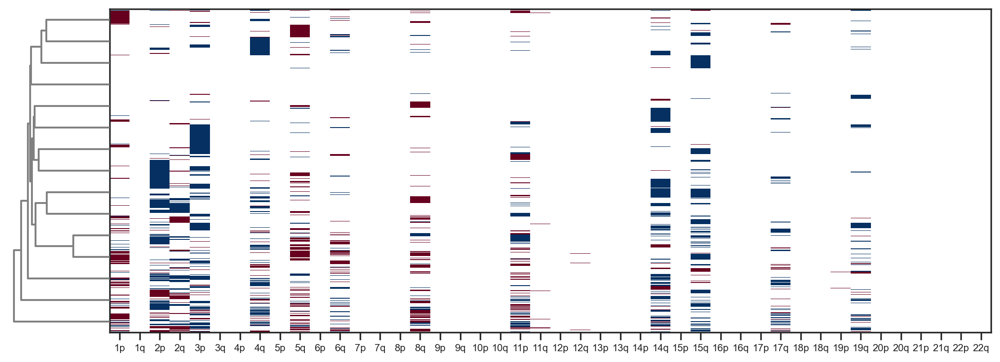

In [299]:
# CONSTRUCT HEATMAP DATA
heatmap_data = mat_input

# LINKAGE 
method = 'average' # average, single centroid/euclidean
metric = 'euclidean' # cosine
linkage = hc.linkage(heatmap_data, method=method, metric = metric)
row_linkage = deepcopy(linkage)

# REORDER HEATMAP ACCORDING TO LINKAGE (OPTIONAL, STILL SLOW)
r1 = hc.leaves_list(row_linkage)
#mat = heatmap_data                                                # Not Clustered
mat = heatmap_data.iloc[r1,:]                                      # Clustered

# VIEW CLUSTERED LABELED HEATMAP AND DENDROGRAM 
fig = plt.figure(figsize=(14,6))


# ADD MATRIX WITH GENE NAMES
axmatrix = fig.add_axes([0.08,0.1,0.7,0.6])
cnv_colormap = mcolors.ListedColormap([plt.cm.RdBu_r(0),
                                       'white',
                                       plt.cm.RdBu(0)])

norm = mcolors.TwoSlopeNorm(vmin=-1, vmax = 1, vcenter=0)
im = axmatrix.matshow(mat, aspect='auto', origin='lower', cmap=cnv_colormap)
labels = list(mat.columns)
axmatrix.xaxis.set_ticks_position('bottom')
axmatrix.set_yticklabels([]);
xtick = plt.xticks(range(len(labels)), labels, rotation = 0, fontsize = 8, fontname='Arial')
axmatrix.grid(False)
axmatrix.tick_params(axis=u'y', which=u'both',length=0)

# ADD DENDROGRAM
ax1 = fig.add_axes([0.00,0.1,0.08,0.6]) # [x0,y0,width,height]
Z1 = sch.dendrogram(row_linkage, orientation='left', color_threshold = 0, above_threshold_color='#808080',
                    p=6, truncate_mode='level')
ax1.set_xticks([])
ax1.set_yticks([])
plt.axis('off')

fig.axes.facecolor:'white'

# SAVE FIGURE
figure_label = 'UM02_CLUSTERED_075'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/CNV_FIGURES/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### VISUALIZE ADJACENCY GRAPH

In [300]:
patientNum = 2
CNVadjMatx = pd.read_csv('/workdir/uvmel_project/data/CNV_data/uvmel'+str(patientNum)+'_adjMatx_data_075.csv', 
                         index_col=0)
CNVvarFreq = pd.read_csv('/workdir/uvmel_project/data/CNV_data/uvmel'+str(patientNum)+'_varFreq_data_075.csv', 
                         index_col=0)

In [301]:
max_p = 0.01
min_freq = 0.10

CNVadjMatxFiltered = CNVadjMatx.copy()

CNVadjMatxFiltered[abs(CNVadjMatxFiltered) > max_p] = 0

filterVars = [x for x in CNVvarFreq[CNVvarFreq.varFreq < min_freq].V1.values if x in CNVadjMatxFiltered.columns]
CNVadjMatxFiltered.loc[:,filterVars] = 0
CNVadjMatxFiltered.loc[filterVars,:] = 0

CNVadjMatxFiltered = CNVadjMatxFiltered.loc[:, (CNVadjMatxFiltered != 0).any(axis=0)]
CNVadjMatxFiltered = CNVadjMatxFiltered.loc[(CNVadjMatxFiltered.T != 0).any(axis=0)]

/workdir/uvmel_project/figures/final_figures_10_27_20/CNV_FIGURES/UM02_Network_10_075


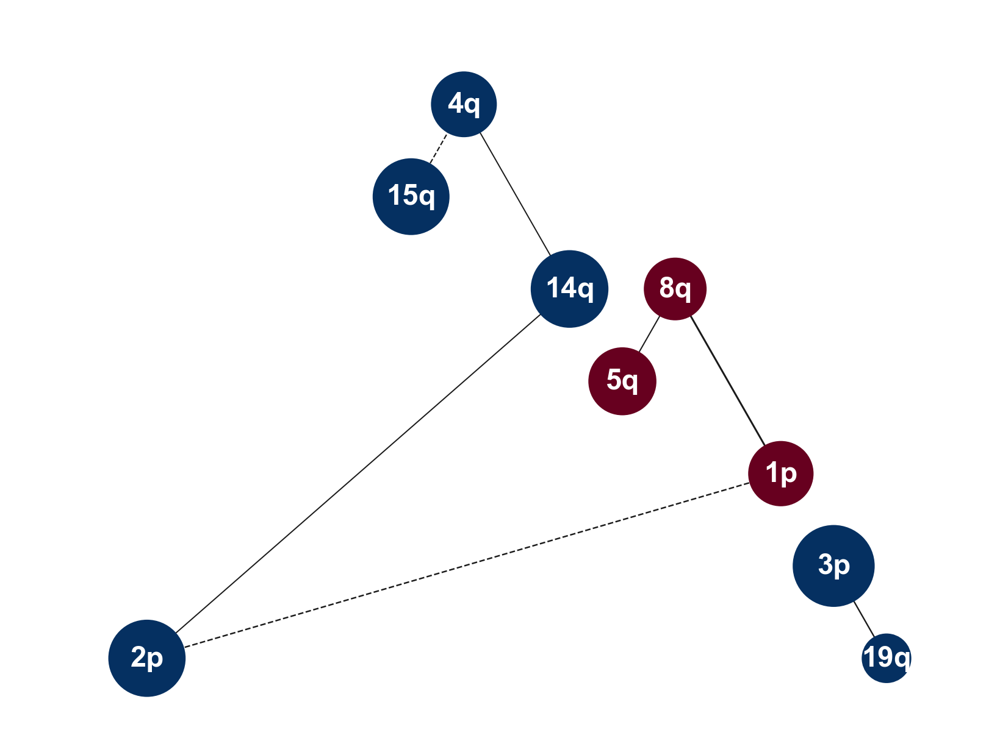

In [302]:
G = nx.from_pandas_adjacency(CNVadjMatxFiltered)

weights = [G[u][v]['weight'] for u,v in G.edges()]
label_dict = dict(zip(list(G.nodes),[x[:2] if len(x) == 5 else x[:3] for x in list(G.nodes)]))

fig = plt.figure(figsize=(8, 6))
plt.tight_layout()

try:
    nx.draw_planar(G, 
            with_labels=True,
            labels=label_dict,
            font_color='white',
            font_size=17,
            font_weight='bold',
            node_color=[plt.cm.RdBu(0) if 'amp' in node else plt.cm.RdBu_r(0) for node in G],
            node_size=[8000.0*(CNVvarFreq.loc[CNVvarFreq.V1 == label].varFreq.values[0])
                       for label in G],
            width=[-0.1*np.log2(abs(x)) for x in weights],
            style=['solid' if x < 0 else 'dashed' for x in weights])
    
    
except:
    nx.draw_shell(G, 
            with_labels=True,
            labels=label_dict,
            font_color='white',
            font_size=17,
            font_weight='bold',
            node_color=[plt.cm.RdBu(0) if 'amp' in node else plt.cm.RdBu_r(0) for node in G],
            node_size=[8000.0*(CNVvarFreq.loc[CNVvarFreq.V1 == label].varFreq.values[0])
                       for label in G],
            width=[-0.1*np.log2(abs(x)) for x in weights],
            style=['solid' if x < 0 else 'dashed' for x in weights])

    
plt.axis('off')
axis = plt.gca()
axis.set_xlim([1.2*x for x in axis.get_xlim()])
axis.set_ylim([1.2*y for y in axis.get_ylim()])
plt.tight_layout()

# SAVE FIGURE
figure_label = 'UM0'+str(patientNum)+'_Network_10_075'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/CNV_FIGURES/' + figure_label 
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### KARYOTYPIC VOLUME

In [303]:
patientNum = 3
chr_smoothed_map = pd.DataFrame()
current_list = [patientNum]

for i in current_list:
    chr_smoothed_map = chr_smoothed_map.append(pd.read_csv('/workdir/uvmel_project/data/CNV_data/uvmel'+
                                           str(i)+'_chrSmoothedExp_data.csv', 
                                           index_col=0))

chr_smoothed_map.index = DF_TUMOR.loc[DF_TUMOR.index.map(lambda x: x[2] in ['UM0'+str(x) for x in current_list
                                                                    ])].index
chr_smoothed_map['Assignment'] = METADATA_TUMOR.loc[METADATA_TUMOR.index.map(lambda x: x[2] in 
                                                                     ['UM0'+str(x) for x in current_list
                                                                     ])].Assignment
chr_smoothed_map.set_index('Assignment', append=True, inplace=True)

In [304]:
chr_smoothed_map.index.get_level_values('Assignment').value_counts()

Castle 1    2286
Castle 2      89
Name: Assignment, dtype: int64

In [305]:
n = 50
reps = np.arange(100)

In [306]:
mat = chr_smoothed_map.copy()

# CLASS I TUMORS
logvolume_tumor_class1 = np.zeros(len(reps))
class_selection = 'Castle 1'
SUBSET = mat.loc[mat.index.map(lambda x: x[10] == class_selection)]

for rep in reps:
    CSUBSET = SUBSET.sample(n=n,replace=True)
    GENE_COV = CSUBSET.cov(min_periods=None)
    eigenvalues = np.linalg.eigvals(GENE_COV)
    logvolume = np.float(np.sum(0.5*np.log10(eigenvalues[eigenvalues>0]**2))/len(eigenvalues))
    logvolume_tumor_class1[rep] = logvolume
    
# CLASS II TUMORS
logvolume_tumor_class2 = np.zeros(len(reps))
class_selection = 'Castle 2'
SUBSET = mat.loc[mat.index.map(lambda x: x[10] == class_selection)]

for rep in reps:
    CSUBSET = SUBSET.sample(n=n,replace=True)
    GENE_COV = CSUBSET.cov(min_periods=None)
    eigenvalues = np.linalg.eigvals(GENE_COV)
    logvolume = np.float(np.sum(0.5*np.log10(eigenvalues[eigenvalues>0]**2))/len(eigenvalues))
    logvolume_tumor_class2[rep] = logvolume


# WRITE RESULTS TO DATAFRAME
boxplot_data_goi = pd.DataFrame()
boxplot_data_goi['Meta-Source'] = ['Group 1']*len(logvolume_tumor_class1)+['Group 2']*len(logvolume_tumor_class2)
boxplot_data_goi['Log Karyotypic Volume'] = np.concatenate([logvolume_tumor_class1,logvolume_tumor_class2],axis = 0)

# STATISTIC
T1 = boxplot_data_goi.loc[boxplot_data_goi['Meta-Source'].isin(['Group 1'])]['Log Karyotypic Volume'].values
T2 = boxplot_data_goi.loc[boxplot_data_goi['Meta-Source'].isin(['Group 2'])]['Log Karyotypic Volume'].values

In [307]:
len(T1)

100

In [308]:
# CLASS I vs. CLASS 2
print('Castle 1 vs. Castle 2')
print(stats.mannwhitneyu(T1, T2))

Castle 1 vs. Castle 2
MannwhitneyuResult(statistic=40.0, pvalue=4.240831530336165e-34)


/workdir/uvmel_project/figures/final_figures_10_27_20/Log_Karyotypic_Volume_KDE_PATIENT_3


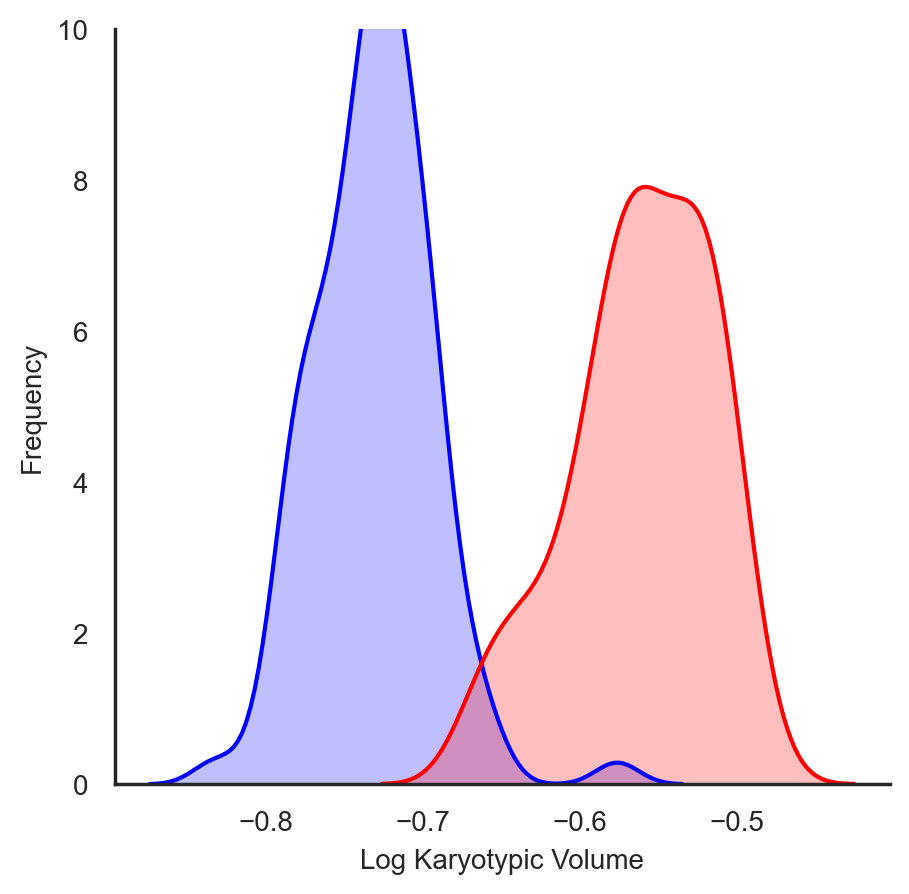

In [309]:
sns.set_style("white")
fig = plt.figure(figsize = (5,5))
ax = plt.gca()

sns.kdeplot(T1, shade=True, color="#0000FF")
sns.kdeplot(T2, shade=True, color="#FF0000")
#sns.kdeplot(T3, shade=True, color="#FF0000")
#sns.kdeplot(T4, shade=True, color="#FF0000")

ax.set_ylabel("Frequency",fontsize=10)
ax.set_xlabel("Log Karyotypic Volume",fontsize=10)
ax.tick_params(labelsize=10)
#ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()
plt.ylim((0,10))
#plt.xlim((-0.95,-0.4))

# SAVE FIGURE
figure_label = 'Log_Karyotypic_Volume_KDE_PATIENT_'+str(patientNum)
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)


/workdir/uvmel_project/figures/final_figures_10_27_20/Karyotypic_Volume_Scatter_UM03


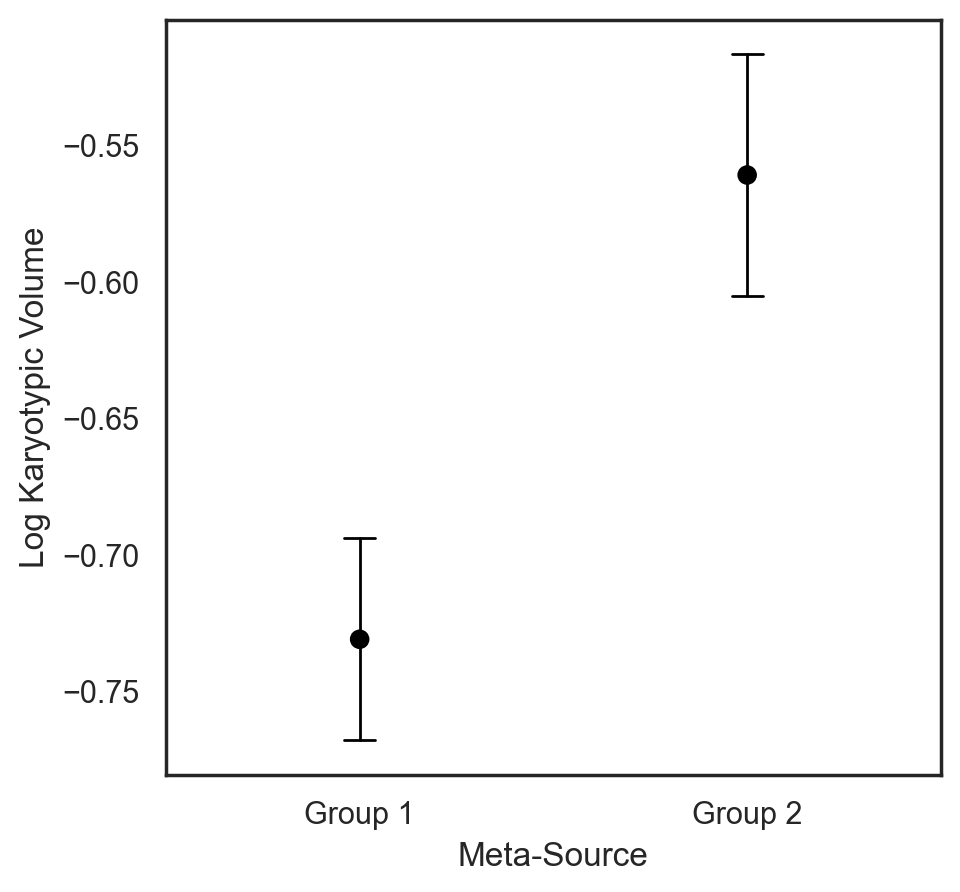

In [310]:
sns.set_style("white")
fig = plt.figure(figsize = (5,5))
ax = plt.gca()

sns.pointplot('Meta-Source', 'Log Karyotypic Volume',data=boxplot_data_goi, color='black', 
              dodge=True, join=False,
              scale=0.8, errwidth=1, capsize=0.08, ci='sd')

# SAVE FIGURE
figure_label = 'Karyotypic_Volume_Scatter_UM03'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/Karyotypic_Volume_Violin_UM03


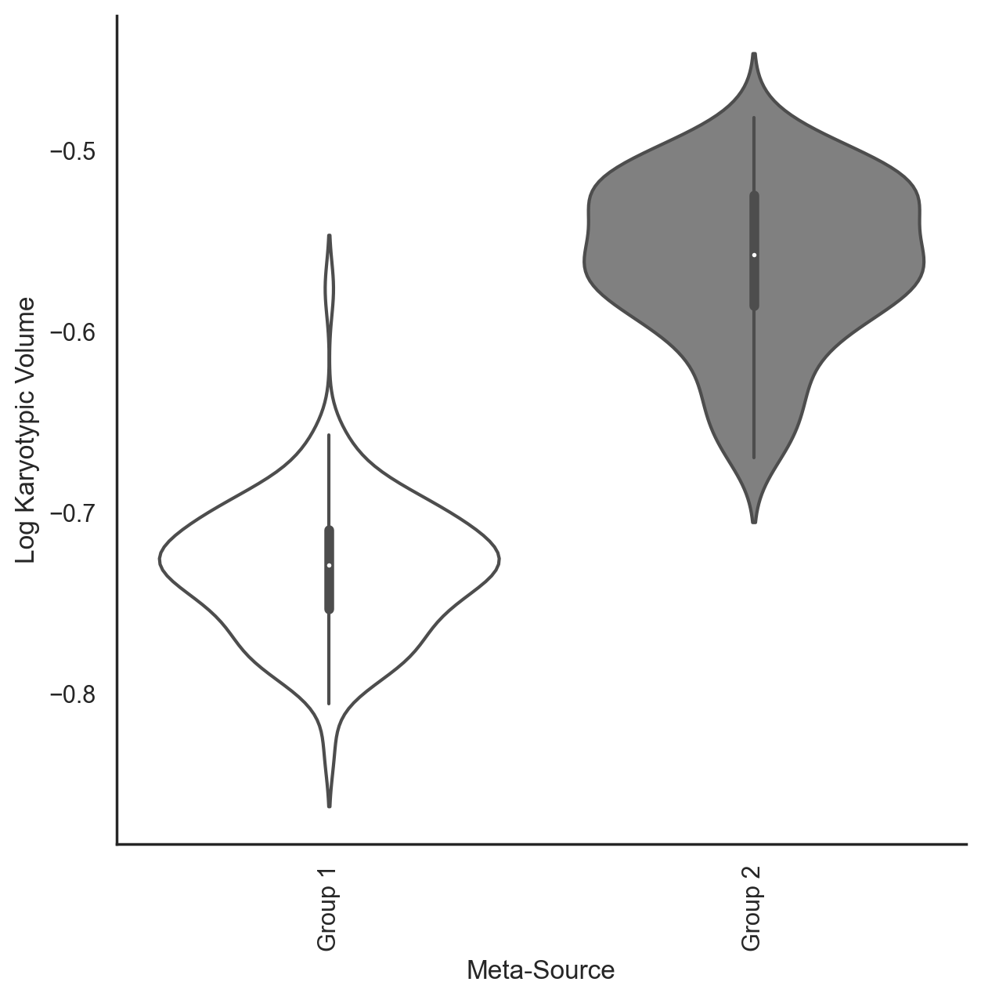

In [311]:
fig, ax = plt.subplots(figsize=(7,7))

ax = sns.violinplot(x='Meta-Source', y='Log Karyotypic Volume', data=boxplot_data_goi,
                    hue='Meta-Source',
                    palette={'Group 1': 'white', 'Group 2': 'gray'},
                    dodge=False,
                    scale='area',)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.get_legend().remove()

plt.xticks(rotation=90)

# SAVE FIGURE
figure_label = 'Karyotypic_Volume_Violin_UM03'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### SHANNON DIVERSITY INDEX

In [312]:
cnv_mat = pd.DataFrame()
current_list = [1,2,3,4,5,6]

for i in current_list:
    cnv_mat = cnv_mat.append(pd.read_csv('/workdir/uvmel_project/data/CNV_data/uvmel'+
                                           str(i)+'_cnv_data_075.csv', 
                                           index_col=0))

cnv_mat.index = DF_TUMOR.loc[DF_TUMOR.index.map(lambda x: x[2] in ['UM0'+str(x) for x in current_list
                                                                    ])].index.get_level_values('Patient')

In [313]:
#unique_kar_df = pd.DataFrame(cnv_mat.groupby(['Patient']+list(cnv_mat.columns)).size(), columns=['Counts'])
kar_df = cnv_mat.copy()

kar_df.reset_index(inplace=True)
kar_df['State'] = kar_df[kar_df.columns[1:-1]].apply(
                                       lambda x: ','.join(x.dropna().astype(str)), axis=1)

#unique_kar_df = unique_kar_df[['Patient', 'State', 'Counts']]

kar_df = kar_df[['Patient', 'State']]
kar_df.set_index('Patient', inplace=True)

In [314]:
sample_size = 700
sample_rounds= 20

sdi_df = pd.DataFrame()

for i in range(sample_rounds):
    sdi_list = []
    for patient in kar_df.index.unique():
        tmp_df = kar_df.loc[kar_df.index.get_level_values('Patient') == patient]
        tmp_df = tmp_df.sample(sample_size, replace=True)
        p_vect = tmp_df['State'].value_counts(normalize=True)
        sdi_list.append(-1*sum(list(map(lambda x: np.log(x)*x, p_vect))))
    
    sdi_df[str(i)] = sdi_list

sdi_df.index = kar_df.index.unique()
#sdi_df['Ave'] = sdi_df.mean(axis=1).values

In [315]:
sdi_boxplot_data = pd.DataFrame()
sdi_boxplot_data['Patient'] = [item for sublist in [[x]*sample_rounds for x in sdi_df.index] for item in sublist]
sdi_boxplot_data['SDI'] = [item for sublist in [sdi_df.iloc[x].values for x in range(len(sdi_df.index))]
                           for item in sublist]

/workdir/uvmel_project/figures/final_figures_10_27_20/Karyotypic_SDI_Scatter


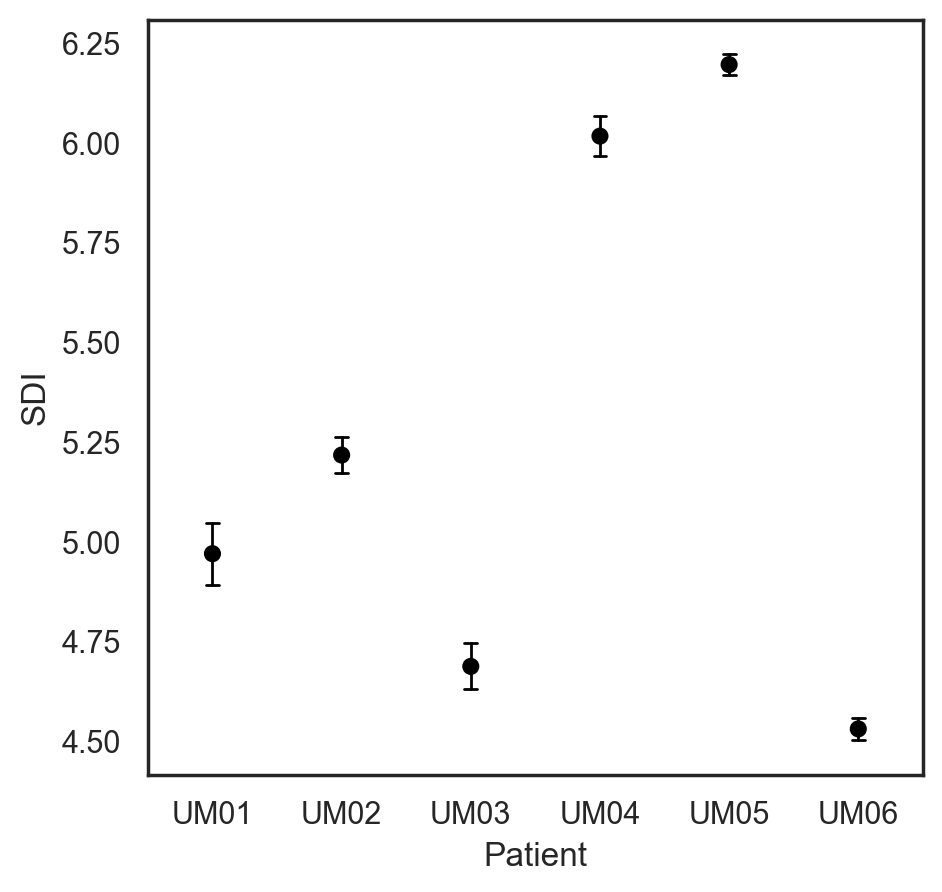

In [316]:
sns.set_style("white")
fig = plt.figure(figsize = (5,5))
ax = plt.gca()

sns.pointplot('Patient', 'SDI',data=sdi_boxplot_data, color='black', 
              dodge=True, join=False,
              scale=0.7, errwidth=1, capsize=0.1, ci='sd')

# SAVE FIGURE
figure_label = 'Karyotypic_SDI_Scatter'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

In [317]:
kar_df['Cell ID'] = DF_TUMOR.index.get_level_values('Cell ID')
kar_df.set_index('Cell ID', append=True, inplace=True)

In [318]:
kar_unique_df = pd.DataFrame(kar_df.groupby(['Patient','State']).size())
kar_unique_df.rename(columns={0:'Count'}, inplace=True)

In [319]:
kar_ds_df = kar_df[kar_df.reset_index().duplicated(['Patient','State'], keep=False).values == True]

In [320]:
kar_ds_df.head()

State
Patient Cell ID                                                   
UM01    1        0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...
        2        0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...
        3        0,0,0,0,0,0,0,0,0,0,0,-1,0,0,0,0,0,0,0,0,0,0,0...
        4        0,0,0,0,-1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0...
        6        0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...

In [321]:
sample_size = 300
sample_rounds= 50

sdi_ds_df = pd.DataFrame()

for i in range(sample_rounds):
    sdi_list = []
    for patient in kar_ds_df.index.get_level_values('Patient').unique():
        tmp_df = kar_ds_df.loc[kar_ds_df.index.get_level_values('Patient') == patient]
        tmp_df = tmp_df.sample(sample_size, replace=True)
        p_vect = tmp_df['State'].value_counts(normalize=True)
        sdi_list.append(-1*sum(list(map(lambda x: np.log(x)*x, p_vect))))
    
    sdi_ds_df[str(i)] = sdi_list

sdi_ds_df.index = kar_ds_df.index.get_level_values('Patient').unique()

/workdir/uvmel_project/figures/final_figures_10_27_20/Karyotypic_SDI_Scatter_DROP_SINGLETONS


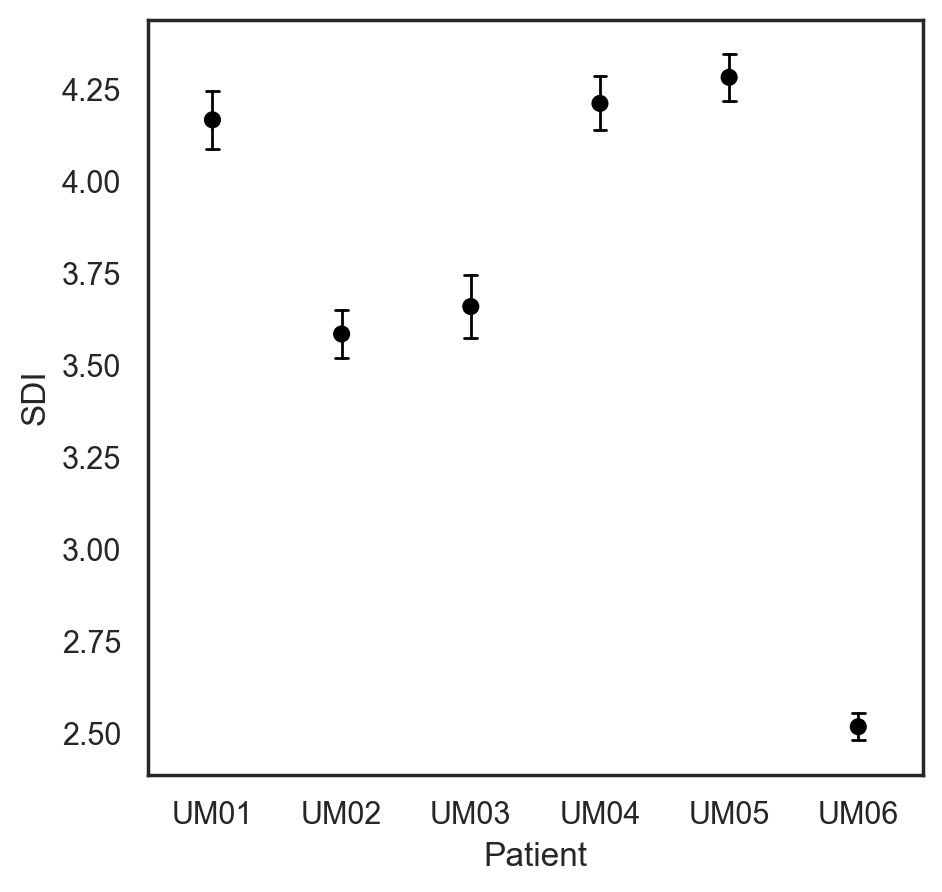

In [322]:
sdi_boxplot_ds_data = pd.DataFrame()
sdi_boxplot_ds_data['Patient'] = [item for sublist in [[x]*sample_rounds 
                                                       for x in sdi_ds_df.index] for item in sublist]
sdi_boxplot_ds_data['SDI'] = [item for sublist in [sdi_ds_df.iloc[x].values 
                                                   for x in range(len(sdi_ds_df.index))]
                              for item in sublist]

sns.set_style("white")
fig = plt.figure(figsize = (5,5))
ax = plt.gca()

sns.pointplot('Patient', 'SDI',data=sdi_boxplot_ds_data, color='black', 
              dodge=True, join=False,
              scale=0.7, errwidth=1, capsize=0.1, ci='sd')

# SAVE FIGURE
figure_label = 'Karyotypic_SDI_Scatter_DROP_SINGLETONS'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

/workdir/uvmel_project/figures/final_figures_10_27_20/Karyotypic_SDI_KDE_UM03


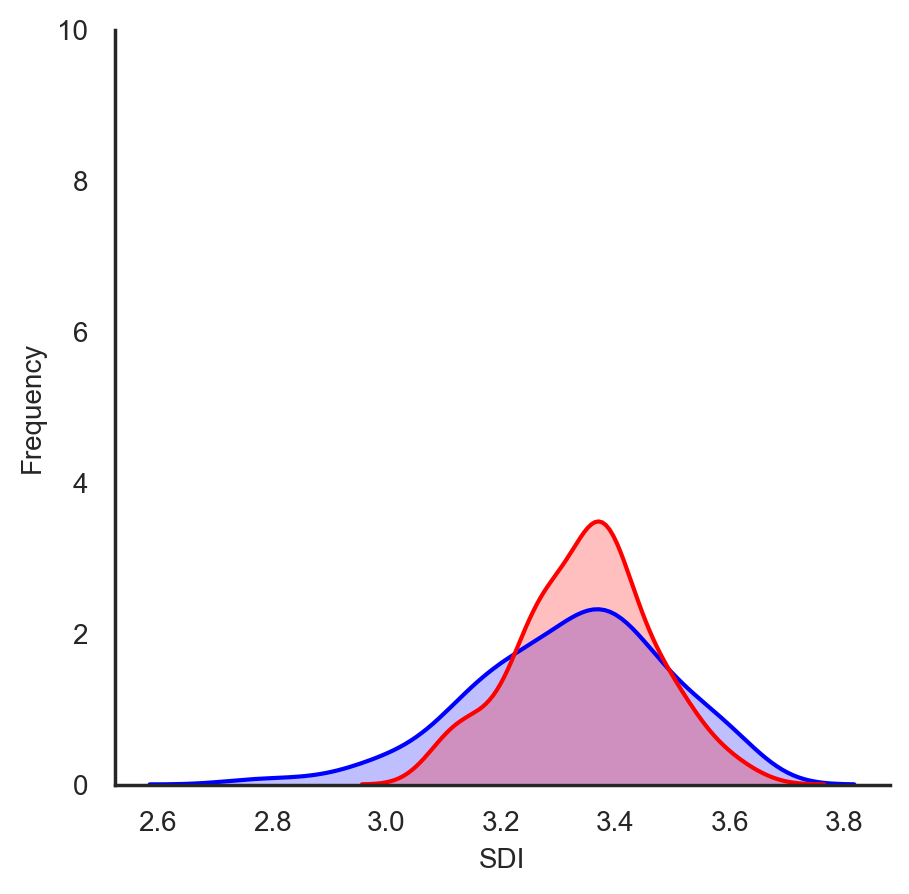

In [323]:
# SHANNON DIVERSITY WITHIN UM03 FOR GEP ASSIGNMENTS

kar_df_UM03 = kar_df.loc[kar_df.index.get_level_values('Patient') == 'UM03']
kar_df_UM03['Assignment'] = METADATA_TUMOR.loc[METADATA_TUMOR.index.get_level_values('Patient') == 
                                               'UM03'].Assignment.values

kar_df_UM03.set_index('Assignment', append=False, inplace=True)

sample_size = 50
sample_rounds= 100

sdi_df = pd.DataFrame()

for i in range(sample_rounds):
    sdi_list = []
    for gep_class in kar_df_UM03.index.unique():
        tmp_df = kar_df_UM03.loc[kar_df_UM03.index.get_level_values('Assignment') == gep_class]
        tmp_df = tmp_df.sample(sample_size, replace=True)
        p_vect = tmp_df['State'].value_counts(normalize=True)
        sdi_list.append(-1*sum(list(map(lambda x: np.log(x)*x, p_vect))))
    
    sdi_df[str(i)] = sdi_list

sdi_df.index = kar_df_UM03.index.unique()
#sdi_df['Ave'] = sdi_df.mean(axis=1).values

sdi_boxplot_data = pd.DataFrame()
sdi_boxplot_data['GEP'] = [item for sublist in [[x]*sample_rounds for x in sdi_df.index] for item in sublist]
sdi_boxplot_data['SDI'] = [item for sublist in [sdi_df.iloc[x].values for x in range(len(sdi_df.index))]
                           for item in sublist]

sns.set_style("white")
fig = plt.figure(figsize = (5,5))
ax = plt.gca()

sns.kdeplot(sdi_boxplot_data.loc[sdi_boxplot_data.GEP == 'Castle 1']['SDI'].values, shade=True, color="#0000FF")
sns.kdeplot(sdi_boxplot_data.loc[sdi_boxplot_data.GEP == 'Castle 2']['SDI'].values, shade=True, color="#FF0000")

ax.set_ylabel("Frequency",fontsize=10)
ax.set_xlabel("SDI",fontsize=10)
ax.tick_params(labelsize=10)
#ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
sns.despine()
plt.ylim((0,10))
#plt.xlim((-0.95,-0.4))

# SAVE FIGURE
figure_label = 'Karyotypic_SDI_KDE_UM03'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

In [324]:
# CLASS I vs. CLASS 2
print('Castle 1 vs. Castle 2')
print(stats.mannwhitneyu(sdi_boxplot_data.loc[sdi_boxplot_data.GEP == 'Castle 1']['SDI'].values,
                         sdi_boxplot_data.loc[sdi_boxplot_data.GEP == 'Castle 2']['SDI'].values))

Castle 1 vs. Castle 2
MannwhitneyuResult(statistic=4670.0, pvalue=0.21037707970935005)


/workdir/uvmel_project/figures/final_figures_10_27_20/Karyotypic_SDI_Barplot_UM03_median


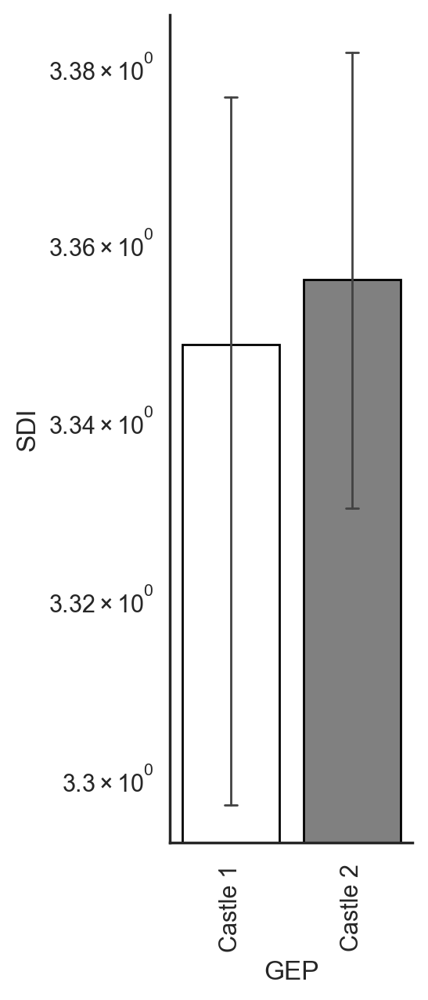

In [325]:
fig, ax = plt.subplots(figsize=(2,7))

ax = sns.barplot(x='GEP', y='SDI', data=sdi_boxplot_data,
                 hue='GEP',
                 edgecolor='black',
                 palette={'Castle 1': 'white', 'Castle 2': 'gray'},
                 dodge=False,
                 ci=95,
                 errwidth=1,
                 capsize=0.1,
                 estimator=median)
 
ax.set_yscale('log')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.get_legend().remove()

plt.xticks(rotation=90)

# SAVE FIGURE
figure_label = 'Karyotypic_SDI_Barplot_UM03_median'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

In [326]:
PHEN_VOL_UM01 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM01')
PHEN_VOL_UM02 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM02')
PHEN_VOL_UM03 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM03')
PHEN_VOL_UM04 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM04')
PHEN_VOL_UM05 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM05')
PHEN_VOL_UM06 = joblib.load('/workdir/uvmel_project/data/MSK_Phenotypic_Volume_UM06')

PHEN_VOL_LIST = [PHEN_VOL_UM01, PHEN_VOL_UM02, PHEN_VOL_UM03, PHEN_VOL_UM04, PHEN_VOL_UM05, PHEN_VOL_UM06]

In [327]:
phen_vol_data = pd.DataFrame()

phen_vol_data['Patient'] = ['UM01']*len(PHEN_VOL_LIST[0])+['UM02']*len(PHEN_VOL_LIST[1])+\
                           ['UM03']*len(PHEN_VOL_LIST[2])+['UM04']*len(PHEN_VOL_LIST[3])+\
                           ['UM05']*len(PHEN_VOL_LIST[4])+['UM06']*len(PHEN_VOL_LIST[5])

phen_vol_data['Log Phenotypic Volume'] = [x for l in PHEN_VOL_LIST for x in l]

/workdir/uvmel_project/figures/final_figures_10_27_20/Phenotypic_Volume_Scatter


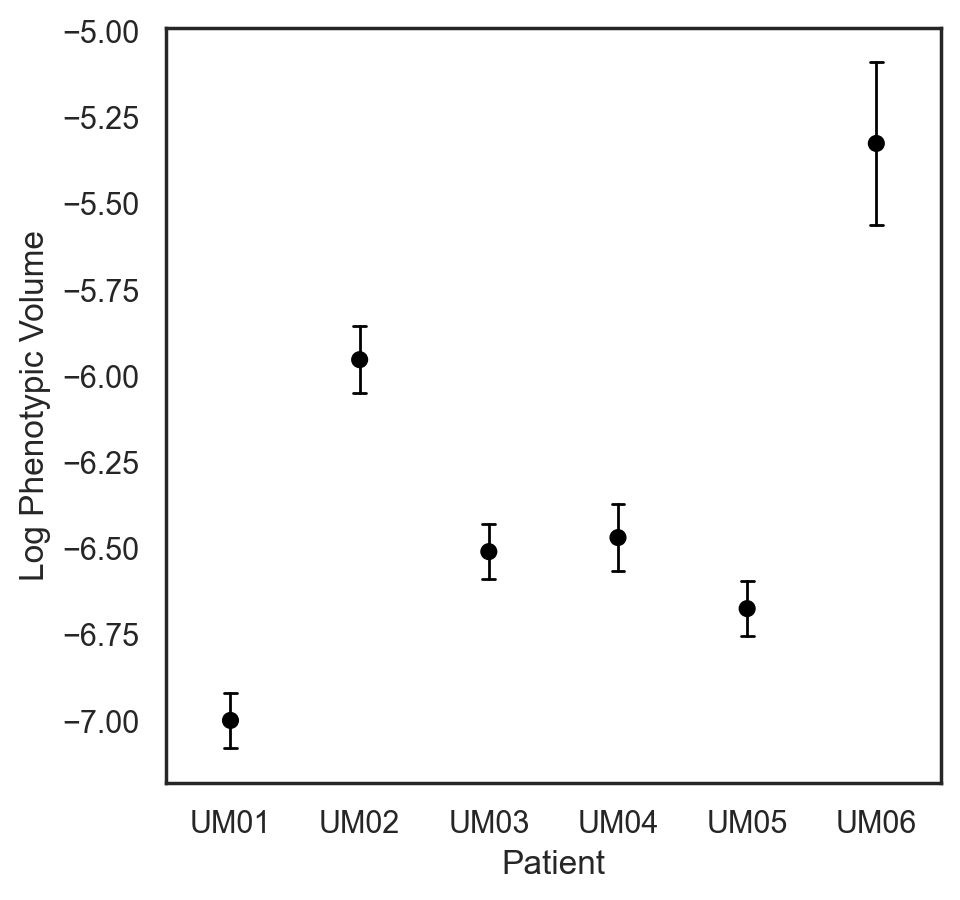

In [328]:
sns.set_style("white")
fig = plt.figure(figsize = (5,5))
ax = plt.gca()

sns.pointplot('Patient', 'Log Phenotypic Volume',data=phen_vol_data, color='black', 
              dodge=True, join=False,
              scale=0.7, errwidth=1, capsize=0.1, ci='sd')

# SAVE FIGURE
figure_label = 'Phenotypic_Volume_Scatter'
fn = '/workdir/uvmel_project/figures/final_figures_10_27_20/' + figure_label
    
d = os.path.dirname(fn)
if not os.path.exists(d):
    os.makedirs(d)
    
fig.savefig(fn + '.png', bbox_inches='tight',dpi=400)
fig.savefig(fn + '.pdf', bbox_inches='tight',dpi=400)
print(fn)

### PHENOTYPIC VOLUME HARBOUR

## RANK DEG PER ARCHETYPE

### VISUALIZE ARCHETYPES

In [329]:
FLATUI_ARCHETYPES = [
                 'E6E6FA', # not assgined
                 'FF66FF', # pink
                 'D1C756', # purple
                 '9ACD32', # Green
                 '00FFFF', # skye blue
                 'FF8800', # orange
                 '0000FF', # dark blue
                 'FFD700', # yellow
                 '20B2AA', # teal
    ]

# CONVERT HEX TO RGB (FLATUI_SAMPLE)
colors = np.zeros((len(FLATUI_ARCHETYPES),3))
for ind,hexcolor in enumerate(FLATUI_ARCHETYPES):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_ARCHETYPES = LinearSegmentedColormap.from_list('FLATUI_ARCHETYPES', colors, N=len(colors))

In [330]:
FLATUI_NEAREST_ARCHETYPES = [
                 'FF66FF', # pink
                 '6600CC', # purple
                 '9ACD32', # Green
                 '00FFFF', # skye blue
                 'FF8800', # orange
                 '0000FF', # dark blue
                 'FFD700', # yellow
                 '20B2AA', # teal
    ]

# CONVERT HEX TO RGB (FLATUI_SAMPLE)
colors = np.zeros((len(FLATUI_NEAREST_ARCHETYPES),3))
for ind,hexcolor in enumerate(FLATUI_NEAREST_ARCHETYPES):
    colors[ind,:] = tuple(hex(hexcolor).rgb)
colors = np.divide(colors,255)
CM_NEAREST_ARCHETYPES = LinearSegmentedColormap.from_list('FLATUI_NEAREST_ARCHETYPES', colors, N=len(colors))

findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_NEARESTArchetypes_Grey_INDF_TUMOR_Phenograph_Class_ForceDirected


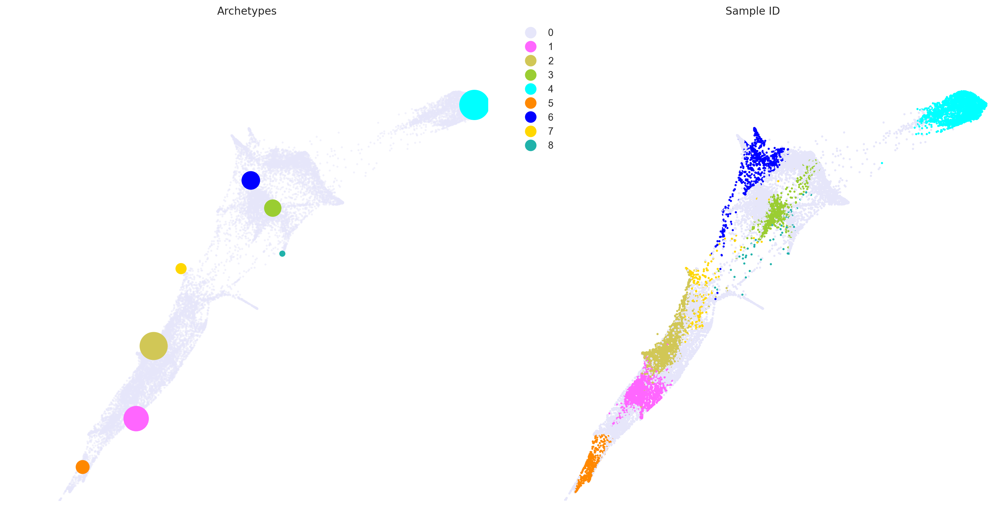

In [331]:
# Visuaulize distance to each archetype
# PLOT CATEGORICAL CLUSTER ASSIGNMENTS
# Note: Any rows assigned -1 were identified as outliers and should not be considered as a member of any community.
plt.figure(figsize = (20,10))
nrow = 1
ncol = 2
dot_size = 2
gs1 = gridspec.GridSpec(nrow, ncol)
gs1.update(wspace=0.05, hspace=0.1) # set the spacing between axes. 

cm = plt.cm.bwr 
dimtype = 'ForceDirected' 
meta = 'Phenograph_Class'
exec('DIM = DIMENSIONS_{}'.format(subset_type))
exec('QUERY= INDF_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))
x = DIM['{}0'.format(dimtype)]
y = DIM['{}1'.format(dimtype)]
axis_min = -ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10
axis_max = ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10

# MONOSOMY 3 SIGNATURE
ax = plt.subplot(gs1[0])
gene_sig = 'Monosomy 3 Up'
signature_genes = genesets[gene_sig].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
phase = zscore(np.nanmedian(QUERY[detected_genes],axis=1))
# Plot scatter map with phase score
mask = np.isnan(phase)
    
# Randomize/Sort Color Values before Plotting
color_values = np.array(phase)
i = np.random.permutation(len(color_values))
xx = np.array(x)[i]
yy = np.array(y)[i]
color_values = color_values[i]

plt.scatter(xx, yy, c = '#E6E6FA', cmap = CM_DIVERGING, s=dot_size, alpha =0.4)
plt.clim(-1.5,1.5)
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
plt.title('Monosomy 3', fontname='Helvetica', size=12, weight='normal')

# Cell Nearest to Each Archetype
for ii in np.unique(META['Archetype_Nearest_Cell'])[1:]:
    c=META['Archetype_Nearest_Cell']==ii
    cc=META['Archetype_Soft_Cluster']==ii
    plt.scatter(x[c.values],y[c.values],s= cc.sum()*0.5, color = '#'+FLATUI_ARCHETYPES[ii])
    #offset = 1000
    #plt.text(x[c]+offset,y[c]+offset,s = '{}'.format(ii), fontsize = 20)
    sns.despine()
    plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
    plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
    plt.title('Archetypes', fontname='Helvetica', size=12, weight='normal')
    plt.xlim(axis_min,axis_max)
    plt.ylim(axis_min,axis_max)
    plt.axis('off')

# Soft Cluster Around Each Archetype Defined by Multi-Scale Diffusion Distance
ax = plt.subplot(gs1[1])
seqc.plot.scatter.categorical(x, y, c=META['Archetype_Soft_Cluster'], 
                              cmap=CM_ARCHETYPES,legend_kwargs={'ncol': 1}, s=dot_size, ax=ax);
sns.despine()
plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
plt.title('Sample ID', fontname='Helvetica', size=12, weight='normal')
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
#ax.legend_.remove()

# SAVE FIGURE
figure_label = '_NEARESTArchetypes_Grey_INDF_{}_{}_{}'.format(subset_type,meta,dimtype) 
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=fig_dpi)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=fig_dpi)
print(fn)

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_NEARESTArchetypes_Grey_INDF_TUMOR_Phenograph_Class_ForceDirected


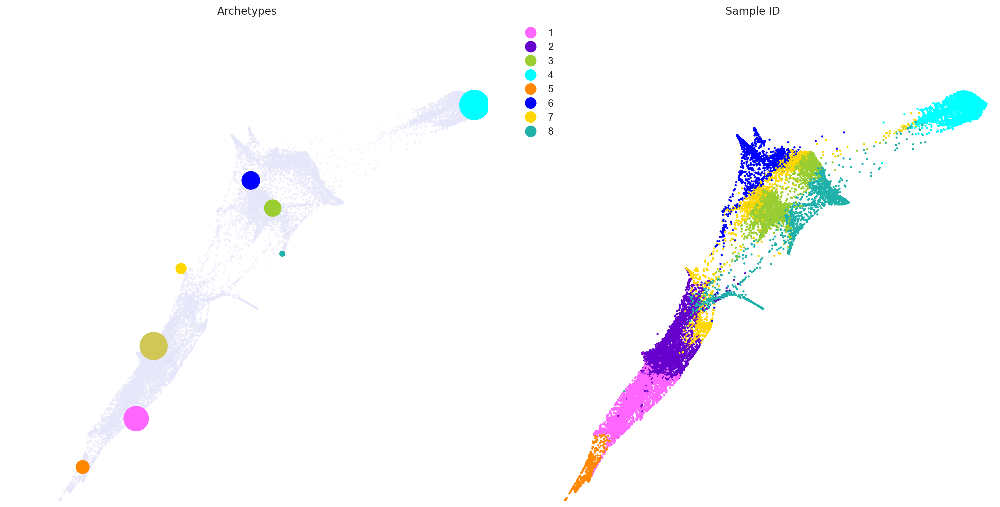

In [332]:
# Visuaulize distance to each archetype
# PLOT CATEGORICAL CLUSTER ASSIGNMENTS
# Note: Any rows assigned -1 were identified as outliers and should not be considered as a member of any community.
plt.figure(figsize = (20,10))
nrow = 1
ncol = 2
dot_size = 2
gs1 = gridspec.GridSpec(nrow, ncol)
gs1.update(wspace=0.05, hspace=0.1) # set the spacing between axes. 

cm = plt.cm.bwr 
dimtype = 'ForceDirected' 
meta = 'Phenograph_Class'
exec('DIM = DIMENSIONS_{}'.format(subset_type))
exec('QUERY= INDF_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))
x = DIM['{}0'.format(dimtype)]
y = DIM['{}1'.format(dimtype)]
axis_min = -ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10
axis_max = ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10

# MONOSOMY 3 SIGNATURE
ax = plt.subplot(gs1[0])
gene_sig = 'Monosomy 3 Up'
signature_genes = genesets[gene_sig].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
phase = zscore(np.nanmedian(QUERY[detected_genes],axis=1))
# Plot scatter map with phase score
mask = np.isnan(phase)
    
# Randomize/Sort Color Values before Plotting
color_values = np.array(phase)
i = np.random.permutation(len(color_values))
xx = np.array(x)[i]
yy = np.array(y)[i]
color_values = color_values[i]

plt.scatter(xx, yy, c = '#E6E6FA', cmap = CM_DIVERGING, s=dot_size, alpha =0.4)
plt.clim(-1.5,1.5)
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
plt.title('Monosomy 3', fontname='Helvetica', size=12, weight='normal')

# Cell Nearest to Each Archetype
for ii in np.unique(META['Archetype_Nearest_Cell'])[1:]:
    c=META['Archetype_Nearest_Cell']==ii
    cc=META['Archetype_Soft_Cluster']==ii
    plt.scatter(x[c.values],y[c.values],s= cc.sum()*0.5, color = '#'+FLATUI_ARCHETYPES[ii])
    #offset = 1000
    #plt.text(x[c]+offset,y[c]+offset,s = '{}'.format(ii), fontsize = 20)
    sns.despine()
    plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
    plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
    plt.title('Archetypes', fontname='Helvetica', size=12, weight='normal')
    plt.xlim(axis_min,axis_max)
    plt.ylim(axis_min,axis_max)
    plt.axis('off')

# Nearest Archetype Defined by Multi-Scale Diffusion Distance
ax = plt.subplot(gs1[1])
seqc.plot.scatter.categorical(x, y, c=META['Nearest_Archetype'], 
                              cmap=CM_NEAREST_ARCHETYPES,legend_kwargs={'ncol': 1}, s=dot_size, ax=ax);
sns.despine()
plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
plt.title('Sample ID', fontname='Helvetica', size=12, weight='normal')
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
#ax.legend_.remove()

# SAVE FIGURE
figure_label = '_NEARESTArchetypes_Grey_INDF_{}_{}_{}'.format(subset_type,meta,dimtype) 
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=fig_dpi)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=fig_dpi)
print(fn)

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_NEARESTArchetypes_Grey_INDF_TUMOR_Phenograph_Class_ForceDirected


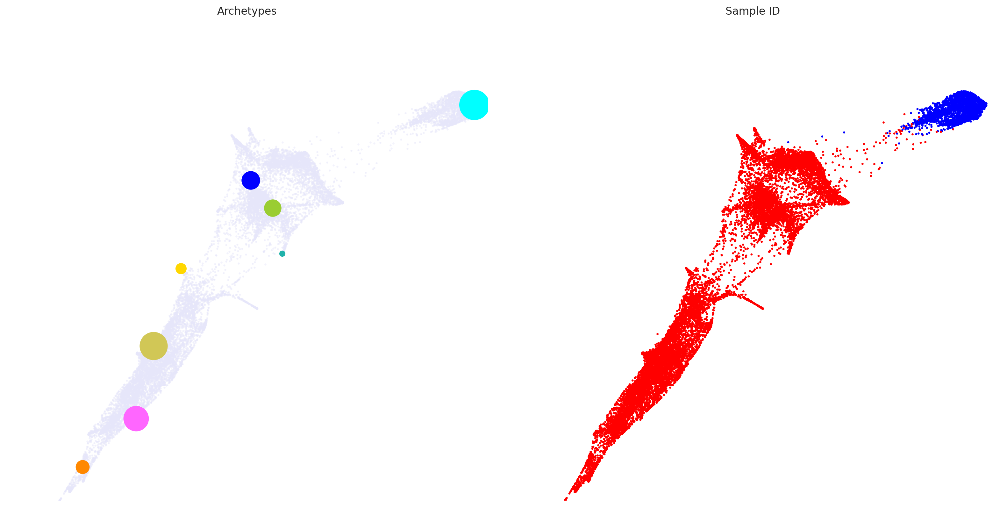

In [333]:
# Visuaulize distance to each archetype colored by GEP1 Probability
# PLOT CATEGORICAL CLUSTER ASSIGNMENTS
# Note: Any rows assigned -1 were identified as outliers and should not be considered as a member of any community.
plt.figure(figsize = (20,10))
nrow = 1
ncol = 2
dot_size = 2
gs1 = gridspec.GridSpec(nrow, ncol)
gs1.update(wspace=0.05, hspace=0.1) # set the spacing between axes. 

cm = plt.cm.bwr 
dimtype = 'ForceDirected' 
meta = 'Phenograph_Class'
exec('DIM = DIMENSIONS_{}'.format(subset_type))
exec('QUERY= INDF_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))
x = DIM['{}0'.format(dimtype)]
y = DIM['{}1'.format(dimtype)]
axis_min = -ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10
axis_max = ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10

# MONOSOMY 3 SIGNATURE
ax = plt.subplot(gs1[0])
gene_sig = 'Monosomy 3 Up'
signature_genes = genesets[gene_sig].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
phase = zscore(np.nanmedian(QUERY[detected_genes],axis=1))
# Plot scatter map with phase score
mask = np.isnan(phase)
    
# Randomize/Sort Color Values before Plotting
color_values = np.array(phase)
i = np.random.permutation(len(color_values))
xx = np.array(x)[i]
yy = np.array(y)[i]
color_values = color_values[i]

plt.scatter(xx, yy, c = '#E6E6FA', cmap = CM_DIVERGING, s=dot_size, alpha =0.4)
plt.clim(-1.5,1.5)
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
plt.title('Monosomy 3', fontname='Helvetica', size=12, weight='normal')

# Cell Nearest to Each Archetype
for ii in np.unique(META['Archetype_Nearest_Cell'])[1:]:
    c=META['Archetype_Nearest_Cell']==ii
    cc=META['Archetype_Soft_Cluster']==ii
    plt.scatter(x[c.values],y[c.values],s= cc.sum()*0.5, color = '#'+FLATUI_ARCHETYPES[ii])
    #offset = 1000
    #plt.text(x[c]+offset,y[c]+offset,s = '{}'.format(ii), fontsize = 20)
    sns.despine()
    plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
    plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
    plt.title('Archetypes', fontname='Helvetica', size=12, weight='normal')
    plt.xlim(axis_min,axis_max)
    plt.ylim(axis_min,axis_max)
    plt.axis('off')

# Nearest Archetype Defined by Multi-Scale Diffusion Distance
ax = plt.subplot(gs1[1])
seqc.plot.scatter.categorical(x, y, c=METADATA_TUMOR.Assignment, 
                              cmap=CM_CASTLE, legend=False, s=dot_size, ax=ax,);
sns.despine()
plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
plt.title('Sample ID', fontname='Helvetica', size=12, weight='normal')
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
#ax.legend_.remove()

# SAVE FIGURE
figure_label = '_NEARESTArchetypes_Grey_INDF_{}_{}_{}'.format(subset_type,meta,dimtype) 
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=fig_dpi)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=fig_dpi)
print(fn)

/workdir/uvmel_project/figures/UVMEL_MERGED_ARCHETYPES_11_09_20/UVMEL_MERGED_NEARESTArchetypes_Grey_INDF_TUMOR_Phenograph_Class_ForceDirected


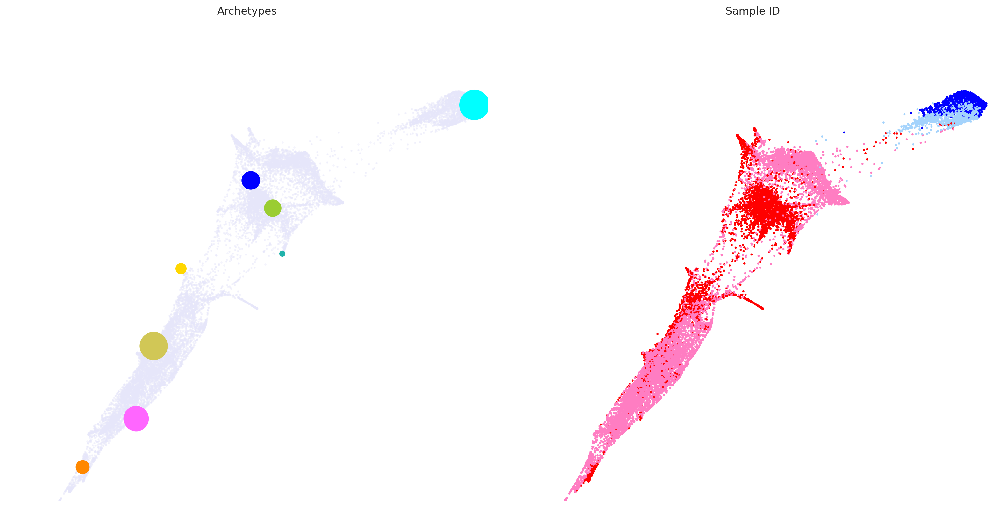

In [334]:
# Visuaulize distance to each archetype colored by GEP1 Probability
# PLOT CATEGORICAL CLUSTER ASSIGNMENTS
# Note: Any rows assigned -1 were identified as outliers and should not be considered as a member of any community.
plt.figure(figsize = (20,10))
nrow = 1
ncol = 2
dot_size = 2
gs1 = gridspec.GridSpec(nrow, ncol)
gs1.update(wspace=0.05, hspace=0.1) # set the spacing between axes. 

cm = plt.cm.bwr 
dimtype = 'ForceDirected' 
meta = 'Phenograph_Class'
exec('DIM = DIMENSIONS_{}'.format(subset_type))
exec('QUERY= INDF_{}'.format(subset_type))
exec('META = METADATA_{}'.format(subset_type))
x = DIM['{}0'.format(dimtype)]
y = DIM['{}1'.format(dimtype)]
axis_min = -ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10
axis_max = ceil(ceil(max(np.abs(x).max(),np.abs(y).max()))/10)*10

# MONOSOMY 3 SIGNATURE
ax = plt.subplot(gs1[0])
gene_sig = 'Monosomy 3 Up'
signature_genes = genesets[gene_sig].values
signature_genes = [x for x in signature_genes if str(x) != 'nan']
detected_genes = list(set(signature_genes).intersection(set(QUERY.columns)))
phase = zscore(np.nanmedian(QUERY[detected_genes],axis=1))
# Plot scatter map with phase score
mask = np.isnan(phase)
    
# Randomize/Sort Color Values before Plotting
color_values = np.array(phase)
i = np.random.permutation(len(color_values))
xx = np.array(x)[i]
yy = np.array(y)[i]
color_values = color_values[i]

plt.scatter(xx, yy, c = '#E6E6FA', cmap = CM_DIVERGING, s=dot_size, alpha =0.4)
plt.clim(-1.5,1.5)
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
plt.title('Monosomy 3', fontname='Helvetica', size=12, weight='normal')

# Cell Nearest to Each Archetype
for ii in np.unique(META['Archetype_Nearest_Cell'])[1:]:
    c=META['Archetype_Nearest_Cell']==ii
    cc=META['Archetype_Soft_Cluster']==ii
    plt.scatter(x[c.values],y[c.values],s= cc.sum()*0.5, color = '#'+FLATUI_ARCHETYPES[ii])
    #offset = 1000
    #plt.text(x[c]+offset,y[c]+offset,s = '{}'.format(ii), fontsize = 20)
    sns.despine()
    plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
    plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
    plt.title('Archetypes', fontname='Helvetica', size=12, weight='normal')
    plt.xlim(axis_min,axis_max)
    plt.ylim(axis_min,axis_max)
    plt.axis('off')

# Nearest Archetype Defined by Multi-Scale Diffusion Distance
ax = plt.subplot(gs1[1])
seqc.plot.scatter.categorical(x, y, c=METADATA_TUMOR.TCGA_Assignment, 
                              cmap=CM_TCGA, legend=False, s=dot_size, ax=ax,);
sns.despine()
plt.xlabel('tSNE-1', fontname='Helvetica', size=10, weight='normal')
plt.ylabel('tSNE-2', fontname='Helvetica', size=10, weight='normal')
plt.title('Sample ID', fontname='Helvetica', size=12, weight='normal')
plt.xlim(axis_min,axis_max)
plt.ylim(axis_min,axis_max)
plt.axis('off')
#ax.legend_.remove()

# SAVE FIGURE
figure_label = '_NEARESTArchetypes_Grey_INDF_{}_{}_{}'.format(subset_type,meta,dimtype) 
fn = FIG_output_stem + FN.replace(".h5", "") + figure_label 
plt.savefig(fn + '.png', bbox_inches='tight',dpi=fig_dpi)
plt.savefig(fn + '.pdf', bbox_inches='tight',dpi=fig_dpi)
print(fn)